In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

79


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [23]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [24]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [25]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [26]:
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1264194,North America,North America,NaN,4310.0,469.0,"+5,059",NaN,19458.0,NaN,2512341,146219.0,1101928.0,NaN,NaN
1,NaN,\n,NaN,NaN,608989,South America,South America,NaN,614.0,21.0,"+11,523",NaN,12091.0,NaN,1463160,61562.0,792609.0,NaN,NaN
2,NaN,\n,NaN,NaN,859934,Europe,Europe,NaN,8919.0,212.0,"+10,741",NaN,6568.0,NaN,2229009,183427.0,1185648.0,NaN,NaN
3,NaN,\n,NaN,NaN,582018,Asia,Asia,NaN,5880.0,127.0,"+18,397",NaN,15931.0,NaN,1659999,41285.0,1036696.0,NaN,NaN
4,NaN,\n,NaN,NaN,130709,Africa,Africa,NaN,87.0,3.0,66,NaN,515.0,NaN,254301,6796.0,116796.0,NaN,NaN


In [27]:
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,,NaN,NaN,582018,Asia,Total:,NaN,5880.0,127.0,"+18,397",NaN,15931.0,NaN,1659999,41285.0,1036696.0,NaN,NaN
226,NaN,,NaN,NaN,130709,Africa,Total:,NaN,87.0,3.0,66,NaN,515.0,NaN,254301,6796.0,116796.0,NaN,NaN
227,NaN,,NaN,NaN,394,Australia/Oceania,Total:,NaN,14.0,NaN,NaN,NaN,4.0,NaN,8960,124.0,8442.0,NaN,NaN
228,NaN,,NaN,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,NaN,NaN,NaN,162234,Europe,European Union,291.442673,5.0,2.0,NaN,NaN,3001.0,54881.338104,1222569,129765.0,576142.0,24435944.0,2745.800311


In [28]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1264194,North America,North America,NaN,4310.0,469.0,"+5,059",NaN,19458.0,NaN,2512341,146219.0,1101928.0,NaN,NaN
1,NaN,\n,NaN,NaN,608989,South America,South America,NaN,614.0,21.0,"+11,523",NaN,12091.0,NaN,1463160,61562.0,792609.0,NaN,NaN
2,NaN,\n,NaN,NaN,859934,Europe,Europe,NaN,8919.0,212.0,"+10,741",NaN,6568.0,NaN,2229009,183427.0,1185648.0,NaN,NaN
3,NaN,\n,NaN,NaN,582018,Asia,Asia,NaN,5880.0,127.0,"+18,397",NaN,15931.0,NaN,1659999,41285.0,1036696.0,NaN,NaN
4,NaN,\n,NaN,NaN,130709,Africa,Africa,NaN,87.0,3.0,66,NaN,515.0,NaN,254301,6796.0,116796.0,NaN,NaN


In [29]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
109,103.0,"1,536","35,835",7,268,Europe,Lithuania,28.0,0.0,0.0,0,"2,723,477",17.0,134070.0,1773,76.0,1429.0,365136.0,651.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


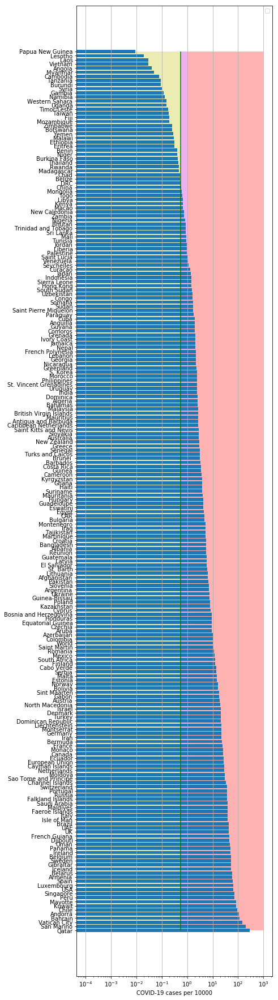

In [30]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


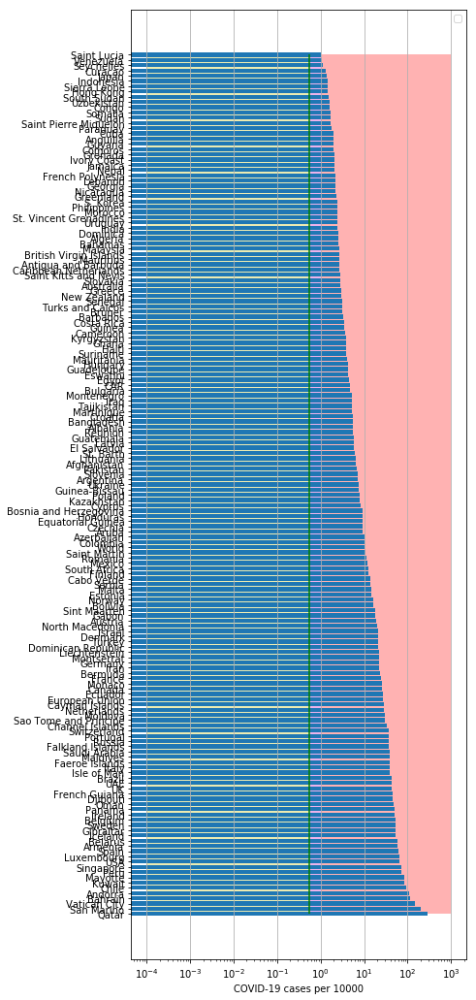

In [31]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

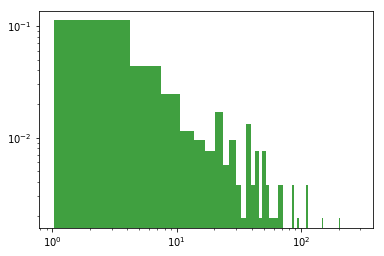

In [32]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [33]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
107 2020-06-11  289787       0  27136.0
108 2020-06-12  290289       0  27136.0
109 2020-06-13  290685       0  27136.0
110 2020-06-14  291008       0  27136.0
111 2020-06-15  291189       0  27136.0
GB
           date   cases  active    death
106 2020-06-11  291409       0  41279.0
107 2020-06-12  292950       0  41481.0
108 2020-06-13  294375       0  41662.0
109 2020-06-14  295889       0  41698.0
110 2020-06-15  296857       0  41736.0
IT
           date   cases  active    death
109 2020-06-11  236142   30637  34167.0
110 2020-06-12  236305   28997  34223.0
111 2020-06-13  236651   27485  34301.0
112 2020-06-14  236989   26274  34345.0
113 2020-06-15  237290   25909  34371.0
LT
          date   cases  active  death     tests
94 2020-06-11  1756.0     282   74.0  356062.0
95 2020-06-12  1763.0     262   75.0  360670.0
96 2020-06-13  1768.0     256   75.0  363528.0
97 2020-06-14  1773.0     268   76.0  365136.0
98 2020-06-15  1773.0     268

SB
          date  cases  active  death
93 2020-06-11  12102   502.0  252.0
94 2020-06-12  12175   575.0  252.0
95 2020-06-13  12251   650.0  253.0
96 2020-06-14  12310   545.0  254.0
97 2020-06-15  12367   601.0  255.0
AG
           date    cases   active  death
99  2020-06-11  27373.0  18276.0  765.0
100 2020-06-12  28764.0  19236.0  785.0
101 2020-06-13  30295.0  20397.0  815.0
102 2020-06-14  31577.0  21180.0  833.0
103 2020-06-15  32785.0  22040.0  854.0
CT
           date   cases  active  death
103 2020-06-11  2249.1    11.0  106.0
104 2020-06-12  2249.2     9.0  107.0
105 2020-06-13  2251.0    10.0  107.0
106 2020-06-14  2252.0    11.0  107.0
107 2020-06-15  2254.0     7.0  107.0
EG
           date  cases  active   death
97  2020-06-11  39726   27658  1377.0
98  2020-06-12  41303   28773  1422.0
99  2020-06-13  42980   29967  1484.0
100 2020-06-14  44598   31092  1575.0
101 2020-06-15  46289   32288  1672.0
SV
           date   cases  active  death
98  2020-06-11  1488.5    20.0

In [34]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [35]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.624867552018828
intercept: -1.1208911055674382
slope: [0.06453744]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


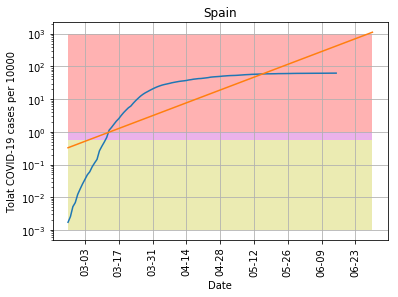

In [36]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-06-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [37]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.7613178391336414
intercept: -2.74104604938352
slope: [0.07738548]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


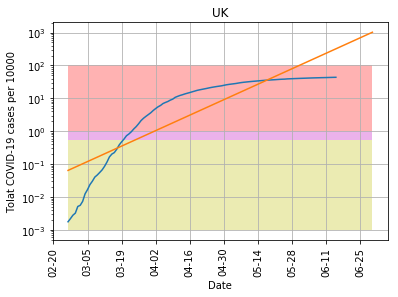

In [38]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-06-30', "pictures/coronaGB.png", model1, 'UK',100)

In [39]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.970934627512372
intercept: 1.6362248660988787
slope: [-0.04330609]


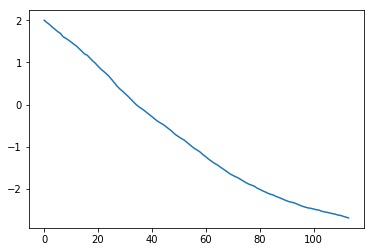

In [40]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


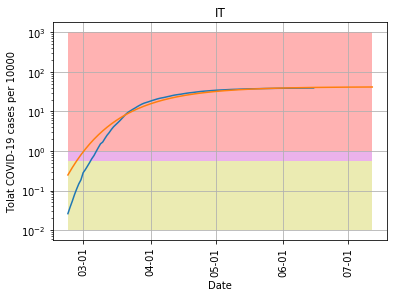

In [41]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [42]:
cs=y_pred11[-1]/10000.*populationIT

In [43]:
cs

250973.52467690568

In [44]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5457197912453942
intercept: -1.2266413977728696
slope: [0.04322399]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


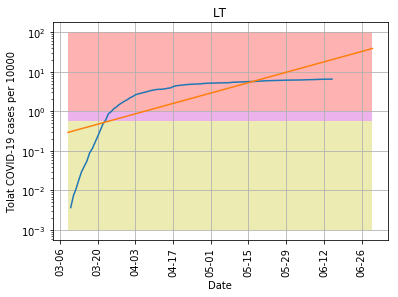

In [45]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-06-30', "pictures/coronaLT.png", model1, 'LT',100)

In [46]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7780929321229737
intercept: -4.53072538795689
slope: [0.08425927]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


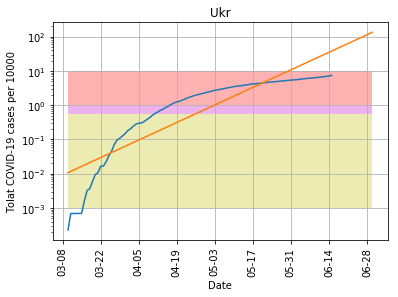

In [47]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-06-30', "pictures/coronaUkr.png", model11, 'Ukr',10)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


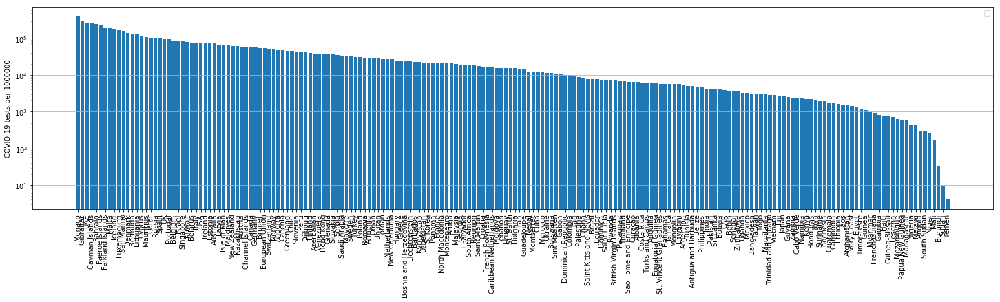

In [48]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [49]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7242798874547378
intercept: -2.187792808945821
slope: [0.07804851]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


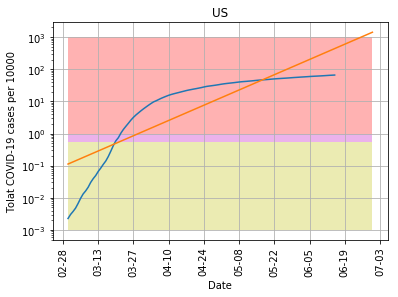

In [50]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-06-30', "pictures/coronaUS.png", model11, 'US',1000)

In [51]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.106141


(0, 0.15)

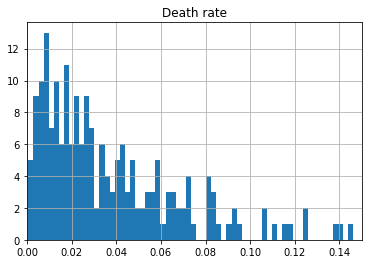

In [52]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

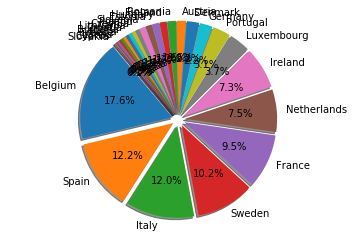

In [53]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [54]:
dfTTh.head()

,Country,Deathsper1Mpop
27,Belgium,834.0
12,Spain,580.0
13,Italy,568.0
30,Sweden,484.0
19,France,451.0


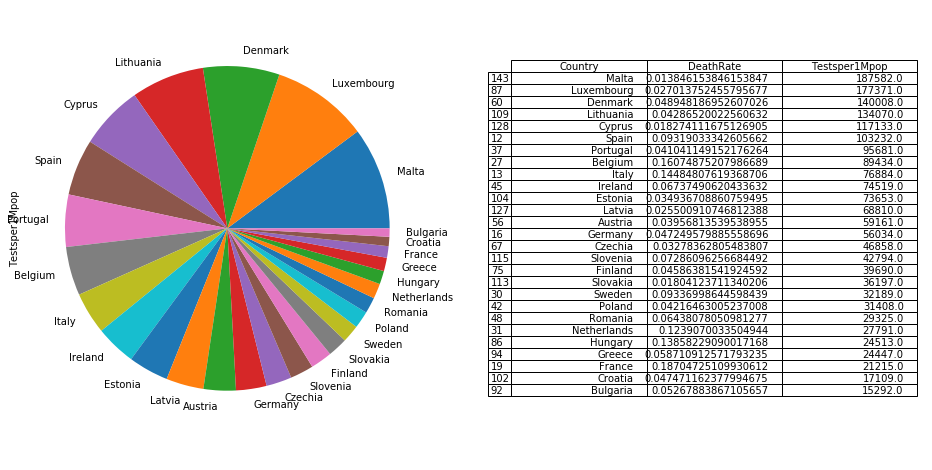

In [55]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

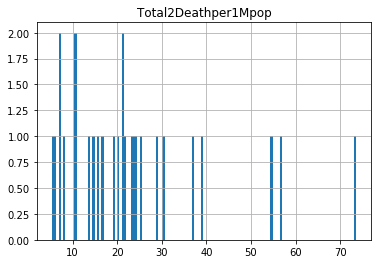

In [56]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [57]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
12,Spain,6228.0,580.0
13,Italy,3924.0,568.0
16,Germany,2245.0,106.0
19,France,2411.0,451.0
27,Belgium,5187.0,834.0


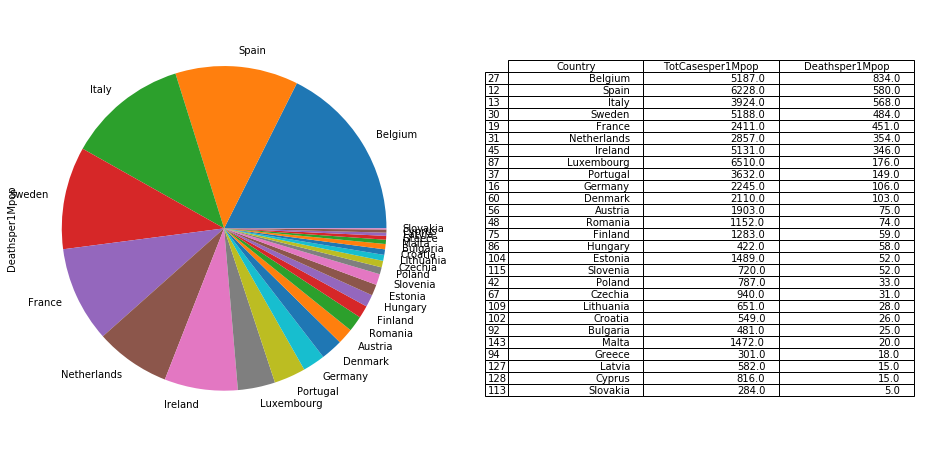

In [58]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [59]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,\n,0,0,1264194,North America,North America,0.0,4310.0,469.0,"+5,059",0,19458.0,0.0,2512341,146219.0,1101928.0,0.0,0.0
1,0.0,\n,0,0,608989,South America,South America,0.0,614.0,21.0,"+11,523",0,12091.0,0.0,1463160,61562.0,792609.0,0.0,0.0
2,0.0,\n,0,0,859934,Europe,Europe,0.0,8919.0,212.0,"+10,741",0,6568.0,0.0,2229009,183427.0,1185648.0,0.0,0.0
3,0.0,\n,0,0,582018,Asia,Asia,0.0,5880.0,127.0,"+18,397",0,15931.0,0.0,1659999,41285.0,1036696.0,0.0,0.0
4,0.0,\n,0,0,130709,Africa,Africa,0.0,87.0,3.0,66,0,515.0,0.0,254301,6796.0,116796.0,0.0,0.0


In [60]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
12,Spain,0.060330
13,Italy,0.051038
16,Germany,0.040065
19,France,0.113646
27,Belgium,0.057998


In [61]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.161173
      France             0.113646
 Netherlands             0.102803
     Ireland             0.068855
       Spain             0.060330
     Belgium             0.057998
       Italy             0.051038
     Germany             0.040065
     Romania             0.039284
    Portugal             0.037959
  Luxembourg             0.036703
     Finland             0.032326
     Austria             0.032166
     Croatia             0.032088
    Bulgaria             0.031454
      Poland             0.025057
     Estonia             0.020216
     Czechia             0.020061
     Hungary             0.017215
    Slovenia             0.016825
     Denmark             0.015071
      Greece             0.012312
      Latvia             0.008458
       Malta             0.007847
    Slovakia             0.007846
      Cyprus             0.006966
   Lithuania             0.004856


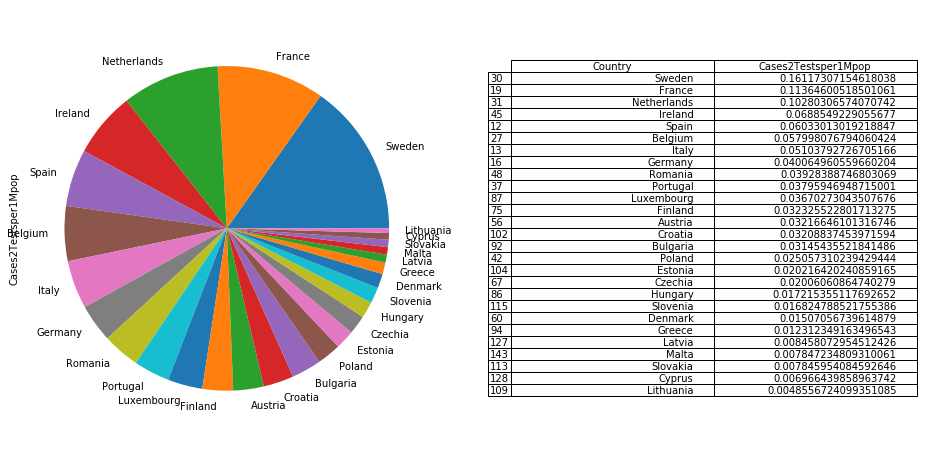

In [62]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [63]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
35,Singapore,0.000635,83560.000000
25,Qatar,0.000940,105185.000000
154,Réunion,0.002016,19217.000000
120,French Guiana,0.002262,929.000000
53,Bahrain,0.002419,250375.000000
76,Nepal,0.003059,12298.000000
145,Rwanda,0.003268,7271.000000
78,Uzbekistan,0.003590,22380.000000
125,Hong Kong,0.003594,36733.000000
103,Maldives,0.003874,65790.000000


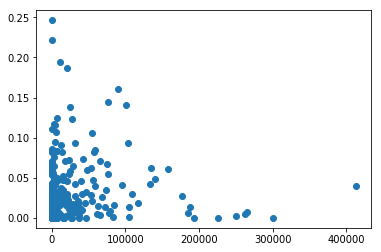

In [64]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


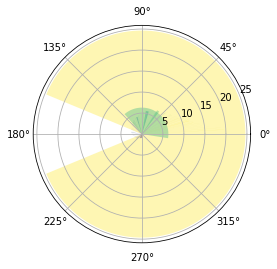

In [65]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

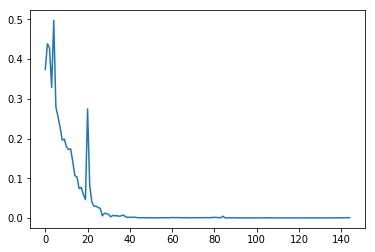

In [66]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [67]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


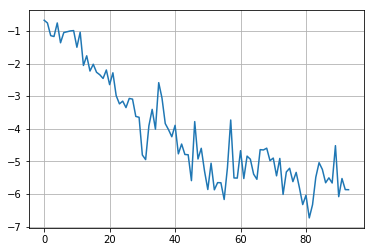

In [68]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

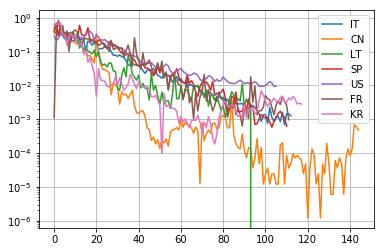

In [69]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

106 106
coefficient of determination: 0.8357304170883995
intercept: -9.585556881301486
slope: [-0.11376102]


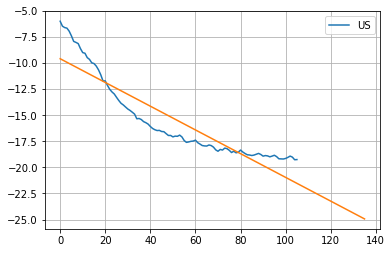

In [70]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

113 113
coefficient of determination: 0.9009190397956026
intercept: -10.00372729788819
slope: [-0.09656685]


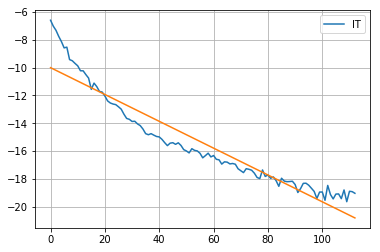

In [71]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [72]:
#model11.coef_

In [73]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

95 95
coefficient of determination: 0.9049544687809854
intercept: -15.228114424632315
slope: [-0.05989538]


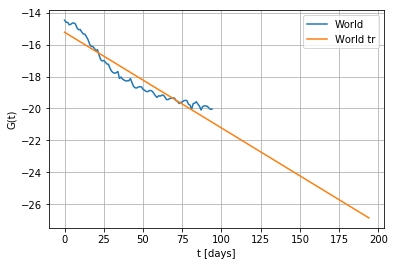

In [74]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

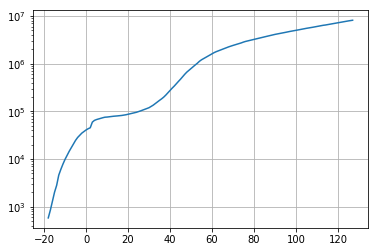

In [75]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [76]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 1.30823206e+07  2.27050746e+00 -1.16282318e+02  9.56777240e-03]


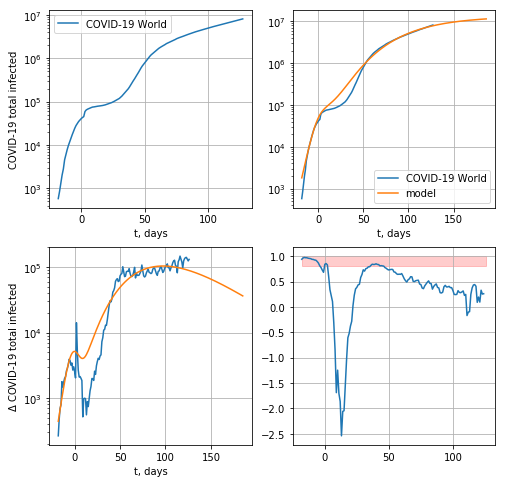

125842.80360071336


In [77]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

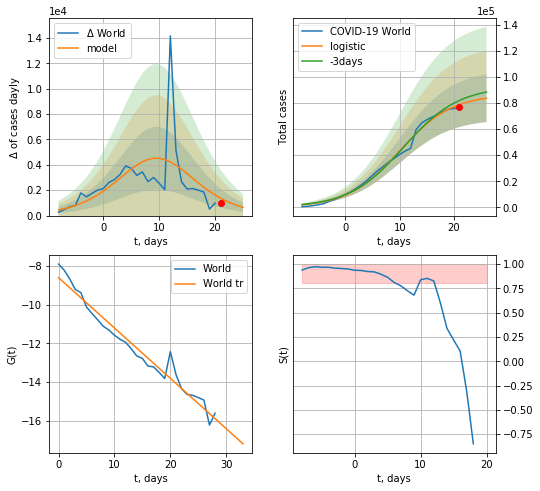

World data at: 2020-06-15
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +5 days
	 deltaDaycases:  651
	 total cases:  83561 ± 18200
	 total death:  4517 ± 2951
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


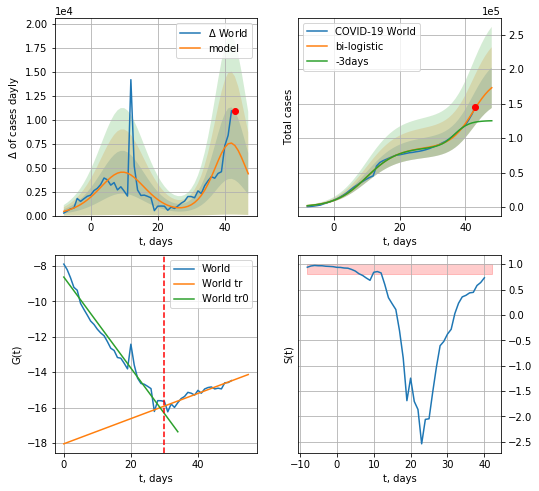

World data at: 2020-06-15
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +5 days
	 deltaDaycases:  4357
	 total cases:  172932 ± 29386
	 total death:  9348 ± 4765
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


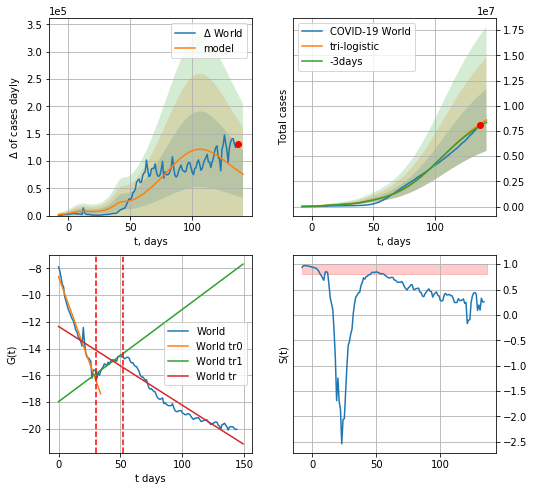

World data at: 2020-06-15
+3 day model MAPE: 0.02415939781644174
model: tri-logistic
coeffs:  [8.82010592e+06 5.19063886e-02 1.04638989e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.357495143400546
forecast at the end of period: +5 days
	 deltaDaycases:  75768
	 total cases:  8594653 ± 3072546
	 total death:  464628 ± 498306
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.900074
 intercept: -12.348495
 slope: -0.058878


In [78]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*12-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*12-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*12-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

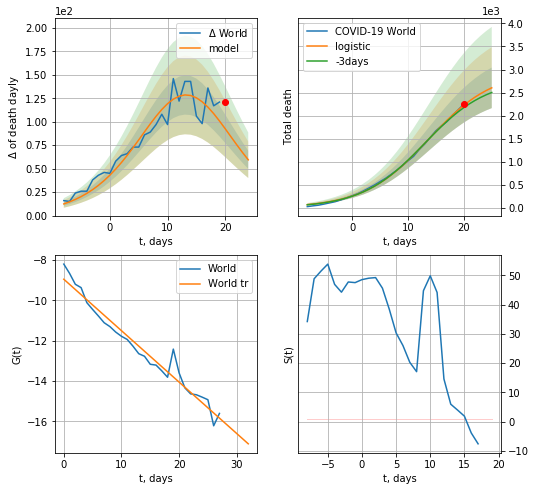

World data at: 2020-06-15
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +5 days
	 total death:  2602 ± 440
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


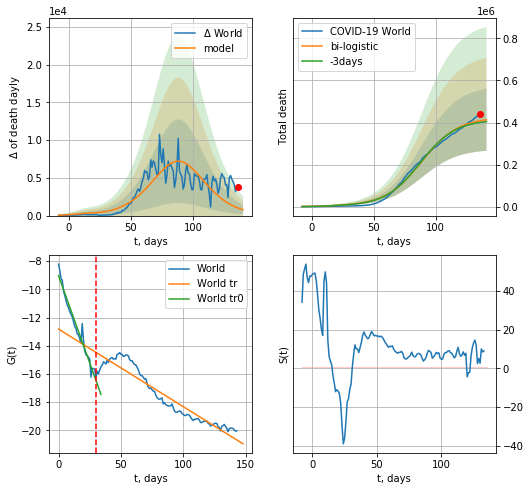

World data at: 2020-06-15
+3 day model MAPE: 0.020943759816184175
model: bi-logistic
coeffs:  [4.21376375e+05 6.84270218e-02 8.85388884e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.35657590365941016
forecast at the end of period: +5 days
	 deltaDaydeath:  778
	 total death:  413026 ± 147275
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.902405
 intercept: -12.817299
 slope: -0.054970


In [79]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*12-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*12-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [80]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


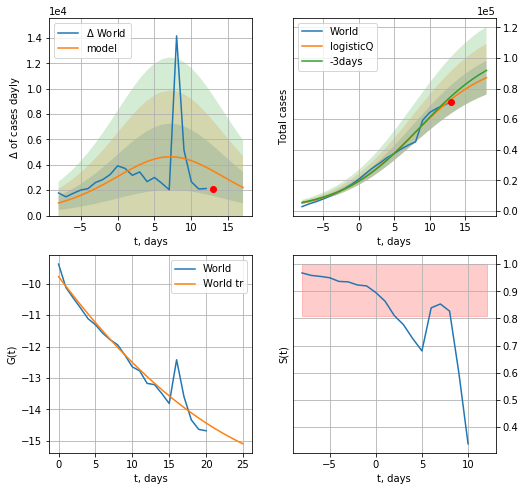

World data at: 2020-06-15
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +5 days
	 deltaDaycases: 2209
	 total cases: 87179 ± 11068
	 total death: 4712 ± 1794
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


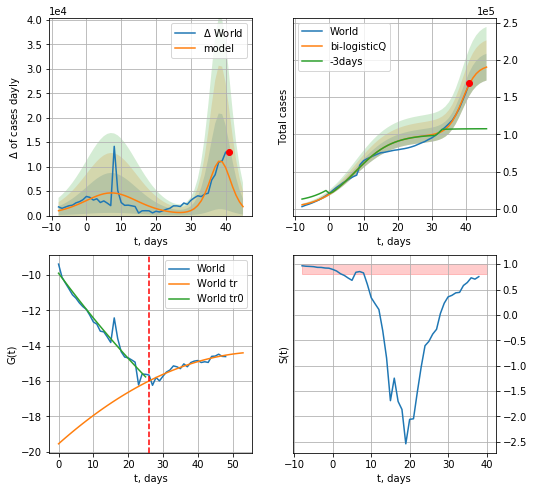

World data at: 2020-06-15
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +5 days
	 deltaDaycases: 1826
	 total cases: 190433 ± 18033
	 total death: 10294 ± 2924
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


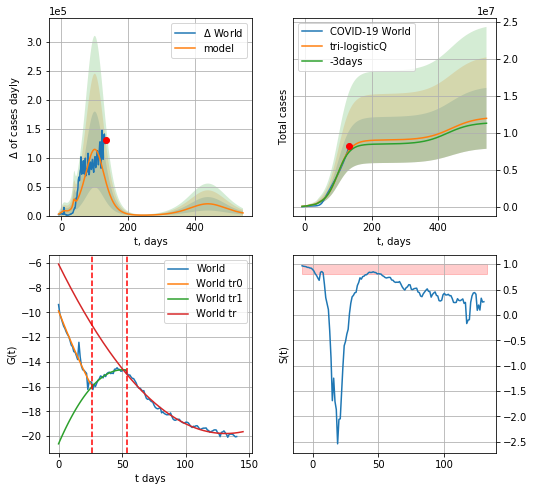

World data at: 2020-06-15
+3 day model MAPE: 0.031743
model: tri-logisticQ
coeffs: [ 8.80146957e+06  3.11321790e-07  1.00597122e+02 -1.67069943e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.345240
forecast at the end of period: +411 days
	 deltaDaycases: 4611
	 total cases: 11927153 ± 4117733
	 total death: 644784 ± 667816
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.987119
 intercept_: -6.105869061145407
 coeffs_: [ 0.         -0.20839634  0.00079338]


In [81]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*12-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*12-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


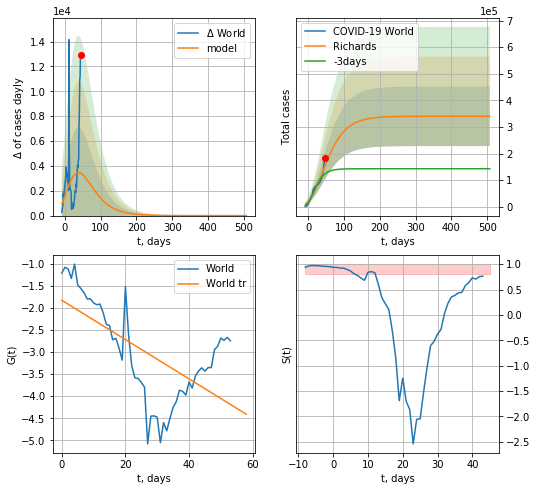

World data at: 2020-06-15
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +461 days
	 deltaDaycases: 0
	 total cases: 340077 ± 111979
	 total death: 18384 ± 18160
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


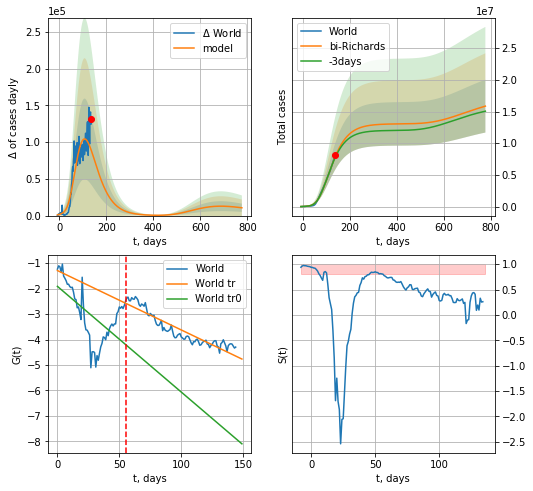

World data at: 2020-06-15
+3 day model MAPE: 0.019552
model: bi-Richards
coeffs: [ 1.27246579e+07  2.03622325e+00 -9.54302585e+01  1.08818166e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.262794
forecast at the end of period: +641 days
	 deltaDaycases: 10640
	 total cases: 15850368 ± 4165382
	 total death: 856874 ± 675544
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.357224
 intercept: -1.910978
 slope: -0.041538
trend coefficient of determination: 0.860521
 intercept: -1.289165
 slope: -0.023344


In [82]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

146


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


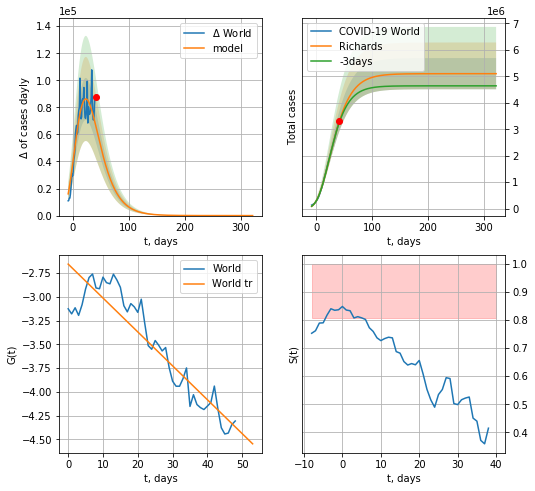

World data at: 2020-06-15
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +281 days
	 deltaDaycases: 0
	 total cases: 5102539 ± 589489
	 total death: 275844 ± 95603
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


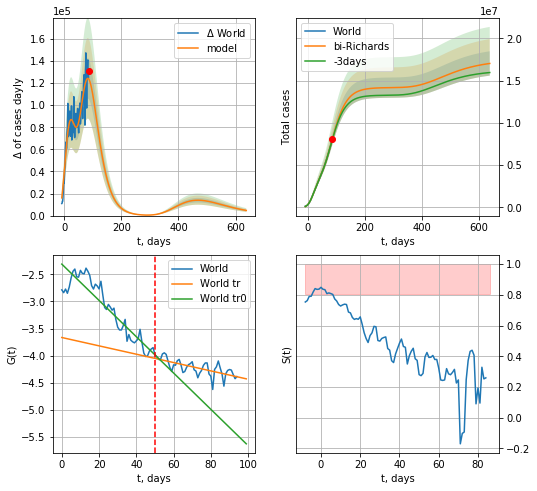

World data at: 2020-06-15
+3 day model MAPE: 0.006395
model: bi-Richards
coeffs: [ 9.06060732e+06  2.06077246e+00 -3.34207132e+01  1.64240292e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.084730
forecast at the end of period: +551 days
	 deltaDaycases: 4655
	 total cases: 17016508 ± 1441800
	 total death: 919916 ± 233832
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.841768
 intercept: -2.310308
 slope: -0.033497
trend coefficient of determination: 0.466868
 intercept: -3.664707
 slope: -0.007702


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


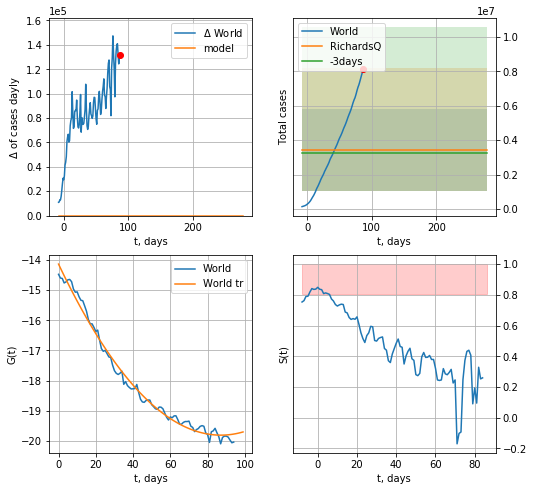

World data at: 2020-06-15
+3 day model MAPE: 0.045372
model: RichardsQ
coeffs: [ 3.41054523e+06  2.58941957e-01 -3.55056934e+02  3.09527772e+02
 -3.90557399e-01]
rational stdev: 0.700840
forecast at the end of period: +191 days
	 deltaDaycases: 0
	 total cases: 3410545 ± 2390246
	 total death: 184374 ± 387650
trend coefficient of determination: 0.989641
 intercept_: -14.140021509176087
 coeffs_: [ 0.         -0.13009863  0.00074686]


In [83]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,70*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-50)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


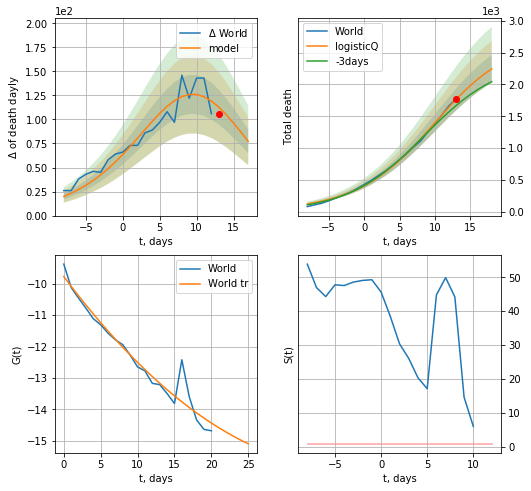

World data at: 2020-06-15
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +5 days
	 total death: 2245 ± 220
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


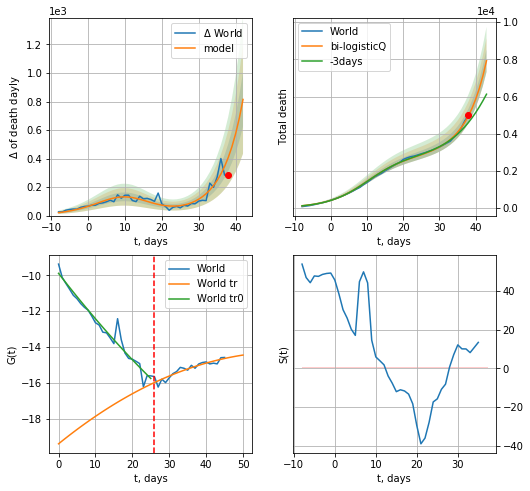

World data at: 2020-06-15
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +5 days
	 total death: 7922 ± 606
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


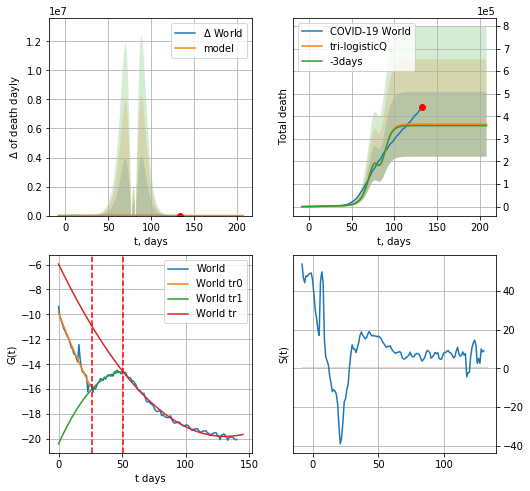

World data at: 2020-06-15
+3 day model MAPE: 0.018001
model: tri-logisticQ
coeffs: [-6.05966695e+06  8.45132440e-04 -1.98520680e+02  7.95793164e+01]
rational stdev: 0.393755
forecast at the end of period: +75 days
	 total death: 365044 ± 143738
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.989169
 intercept_: -5.968878892879465
 coeffs_: [ 0.         -0.21110844  0.00080625]


In [84]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*12-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*12-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


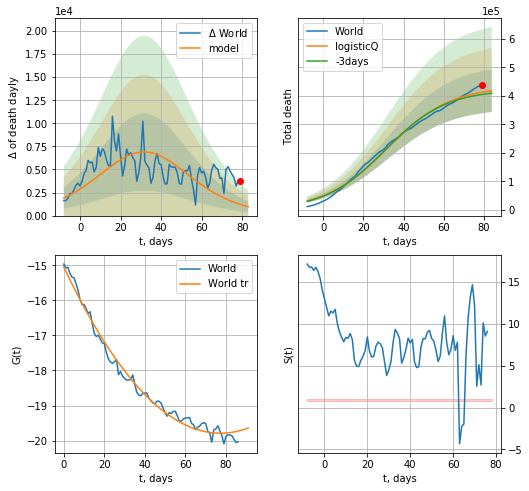

World data at: 2020-06-15
+3 day model MAPE: 0.020029
model: logisticQ
coeffs: [ 4.33531205e+05  4.62754014e-07  3.20656484e+01 -1.37561922e+05]
rational stdev: 0.178529
forecast at the end of period: +5 days
	 total death: 418228 ± 74665
trend coefficient of determination: 0.987120
 intercept_: -15.04437965445469
 coeffs_: [ 0.         -0.12280518  0.00079446]


In [85]:
x = forecastRRR("World",dfW[58:],d1,7*12-dT,1.0,False,cases='death')

In [86]:
#trend(dfSP,'SP',10)

In [87]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
107 2020-06-11  289787       0  27136.0
108 2020-06-12  290289       0  27136.0
109 2020-06-13  290685       0  27136.0
110 2020-06-14  291008       0  27136.0
111 2020-06-15  291189       0  27136.0


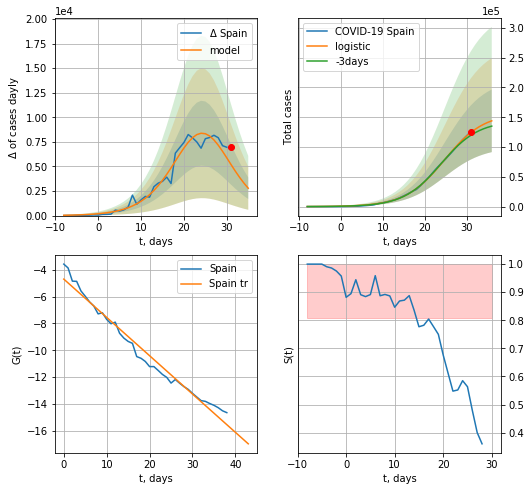

Spain data at: 2020-06-15
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +5 days
	 deltaDaycases:  2780
	 total cases:  143992 ± 52541
	 total death:  13418 ± 14688
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


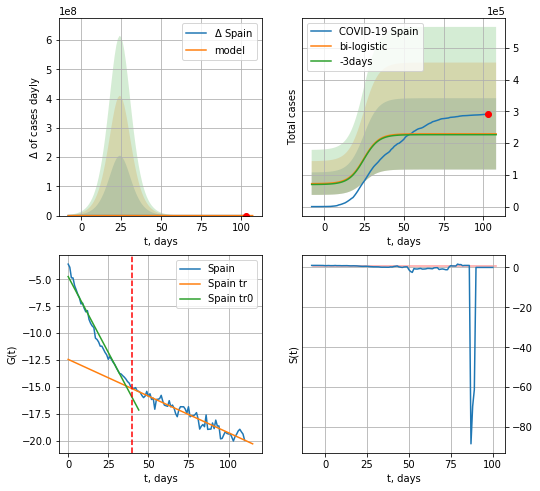

Spain data at: 2020-06-15
+3 day model MAPE: 0.011573556397426377
model: bi-logistic
coeffs:  [ 5.77850522e+04 -5.32654109e+00  1.40282102e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.49017498758025885
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  229188 ± 112342
	 total death:  21358 ± 31407
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.924284
 intercept: -12.440682
 slope: -0.068249


In [88]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*12-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*12-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

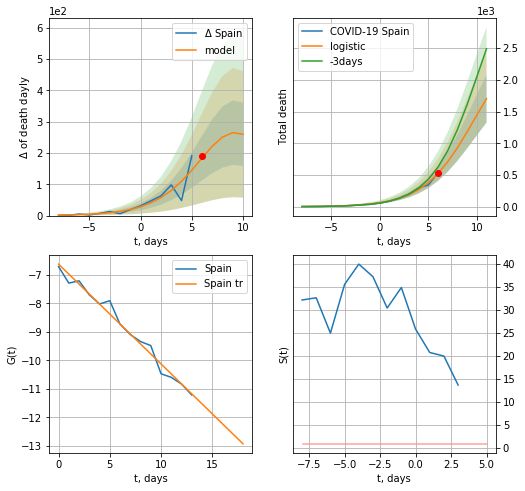

Spain data at: 2020-06-15
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +5 days
	 total death:  1703 ± 377
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide


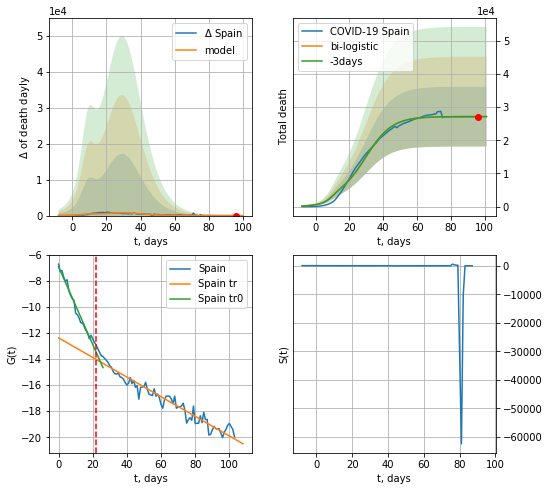

Spain data at: 2020-06-15
+3 day model MAPE: 4.1127831772588564e-05
model: bi-logistic
coeffs:  [2.44086364e+04 1.29509587e-01 2.96856756e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3322798100375852
forecast at the end of period: +5 days
	 deltaDaydeath:  0
	 total death:  27151 ± 9021
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.939564
 intercept: -12.367121
 slope: -0.075348


In [89]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*12-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*12-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


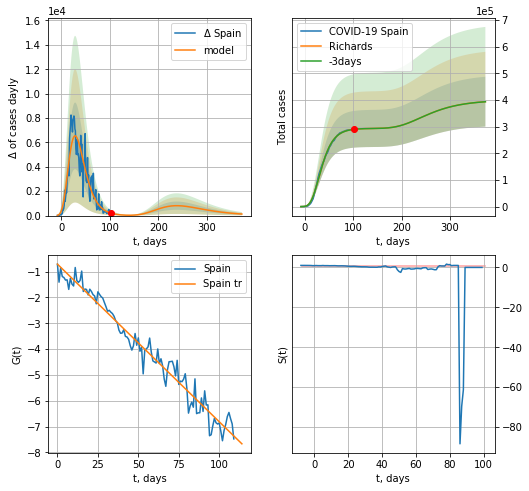

Spain data at: 2020-06-15
+3 day model MAPE: 0.000503
model: Richards
coeffs: [ 2.93591031e+05  8.40022761e+00 -5.21645983e+01  7.23489237e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.237598
forecast at the end of period: +271 days
	 deltaDaycases: 127
	 total cases: 393698 ± 93542
	 total death: 36688 ± 26151
trend coefficient of determination: 0.964930
 intercept: -0.712017
 slope: -0.060993


In [90]:
x = forecastRR('Spain',dfSP[1:],d1,7*50-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


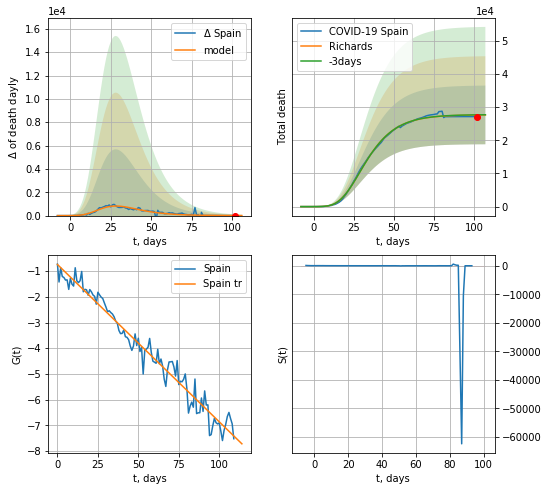

Spain data at: 2020-06-15
+3 day model MAPE: 0.001790
model: Richards
coeffs: [ 2.76809856e+04  7.35182098e+00 -2.71776853e+01  1.10113945e-02]
rational stdev: 0.320036
forecast at the end of period: +5 days
	 total death: 27632 ± 8843
trend coefficient of determination: 0.965324
 intercept: -0.741588
 slope: -0.061217


In [91]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


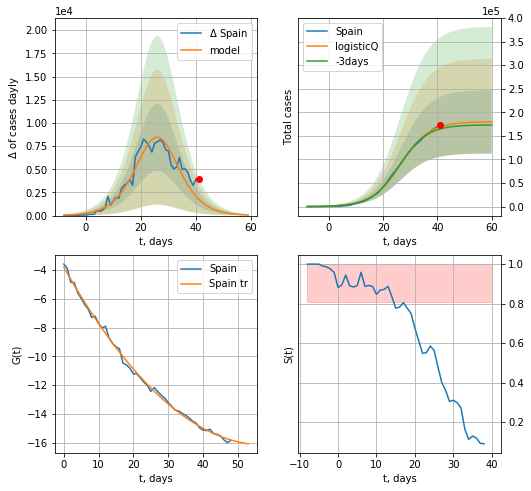

Spain data at: 2020-06-15
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +19 days
	 deltaDaycases: 66
	 total cases: 179624 ± 67165
	 total death: 16739 ± 18777
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


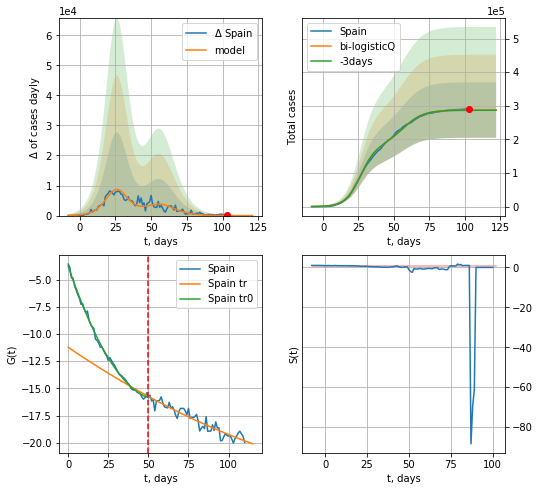

Spain data at: 2020-06-15
+3 day model MAPE: 0.002217
model: bi-logisticQ
coeffs: [ 1.07343956e+05  5.93176612e-07  5.64172328e+01 -2.32829067e+05]
rational stdev: 0.286930
forecast at the end of period: +19 days
	 deltaDaycases: 1
	 total cases: 287275 ± 82428
	 total death: 26771 ± 23044
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.890568
 intercept_: -11.227657733390874
 coeffs_: [ 0.         -0.10037335  0.00020205]


In [92]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


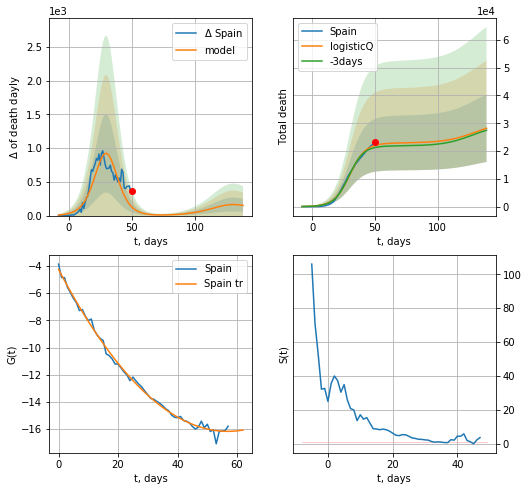

Spain data at: 2020-06-15
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +89 days
	 total death: 28209 ± 12153
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


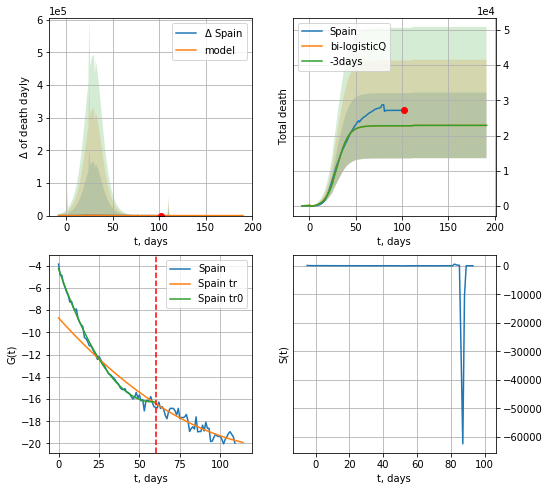

Spain data at: 2020-06-15
+3 day model MAPE: 0.000076
model: bi-logisticQ
coeffs: [-322.09312394   -4.24842548   25.35817051    1.61920894]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.406991
forecast at the end of period: +89 days
	 total death: 22879 ± 9311
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.844603
 intercept_: -8.70661475102919
 coeffs_: [ 0.         -0.16154124  0.00055485]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [93]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


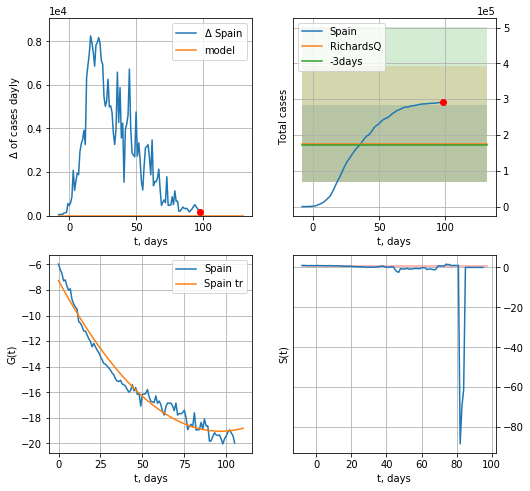

Spain data at: 2020-06-15
+3 day model MAPE: 0.019201
model: RichardsQ
coeffs: [ 1.76011037e+05  8.65815423e-01 -2.45406159e+03  1.96582898e+03
 -3.30884559e+00]
rational stdev: 0.616971
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 176011 ± 108593
	 total death: 16402 ± 30358
trend coefficient of determination: 0.970432
 intercept_: -7.261342538960708
 coeffs_: [ 0.         -0.24418274  0.00126496]


In [94]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

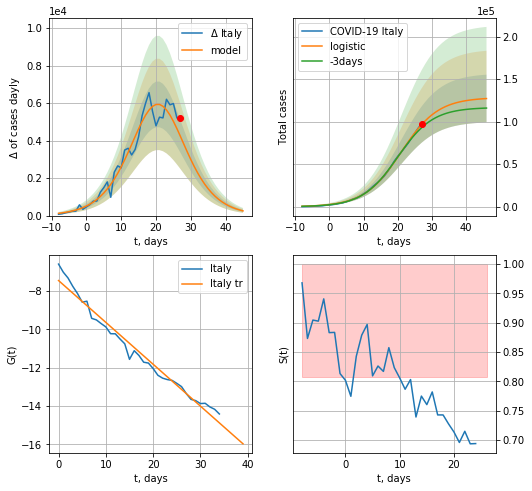

Italy data at: 2020-06-15
+3 day model MAPE: 0.04536229058229775
model: logistic
coeffs:  [1.28444604e+05 1.85121746e-01 2.10190970e+01]
rational stdev:  0.22074329651570546
forecast at the end of period: +19 days
	 deltaDaycases:  250
	 total cases:  127196 ± 28077
	 total death:  18424 ± 12200
trend coefficient of determination: 0.974900
 intercept: -7.448538
 slope: -0.218710


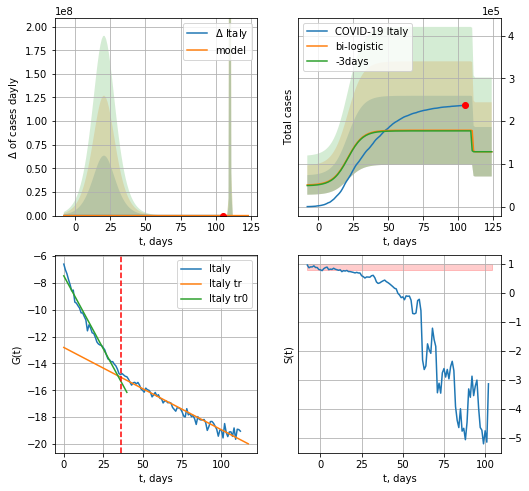

Italy data at: 2020-06-15
+3 day model MAPE: 0.008876923482286228
model: bi-logistic
coeffs:  [ 5.03306849e+04 -7.15167995e+00  1.10564188e+02] [1.28444604e+05 1.85121746e-01 2.10190970e+01]
rational stdev:  0.4503887009575107
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  128444 ± 57849
	 total death:  18604 ± 25137
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975991
 intercept: -7.466382
 slope: -0.217136
trend coefficient of determination: 0.962232
 intercept: -12.805971
 slope: -0.061399


In [95]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,14*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,14*7-dT,x,1.0,vL=vL)

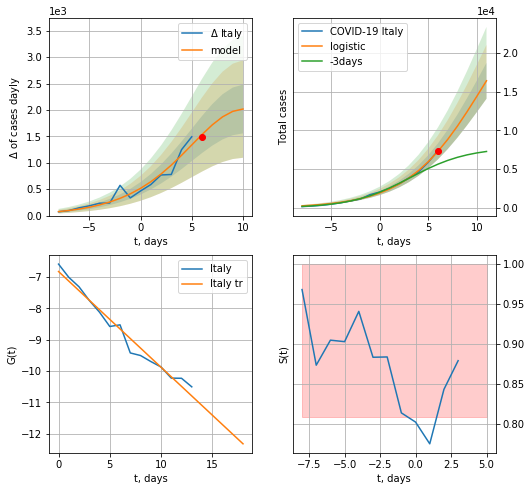

Italy data at: 2020-06-15
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +5 days
	 deltaDaycases:  2017
	 total cases:  16395 ± 2316
	 total death:  2374 ± 1006
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


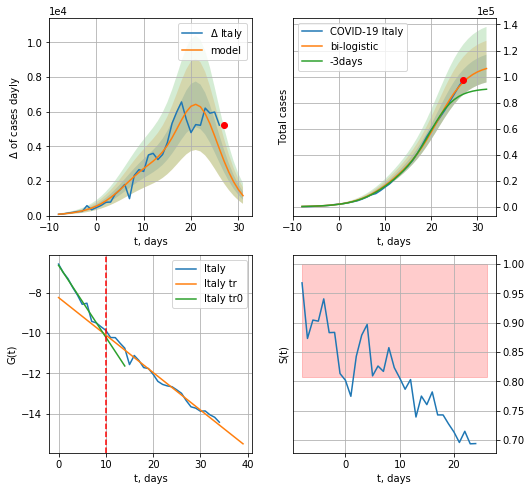

Italy data at: 2020-06-15
+3 day model MAPE: 0.12719416413980916
model: bi-logistic
coeffs:  [7.80633996e+04 3.07326084e-01 2.18190350e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.10039113205484494
forecast at the end of period: +5 days
	 deltaDaycases:  1150
	 total cases:  106168 ± 10658
	 total death:  15378 ± 4631
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


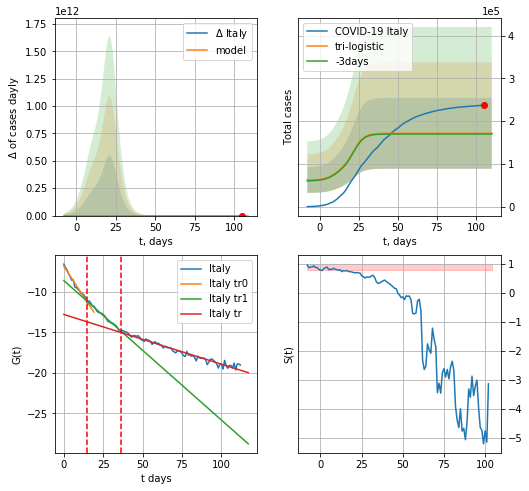

Italy data at: 2020-06-15
+3 day model MAPE: 0.010412394537686033
model: tri-logistic
coeffs:  [ 6.19883558e+04 -4.35075115e+00  1.16390627e+02] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.80633996e+04
 3.07326084e-01 2.18190350e+01]
forecast rational stdev:  0.48318952300315116
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  171562 ± 82896
	 total death:  24850 ± 36021
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.980760
 intercept: -8.621359
 slope: -0.172242
trend coefficient of determination: 0.962232
 intercept: -12.805971
 slope: -0.061399


In [96]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*12-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*12-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*12-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

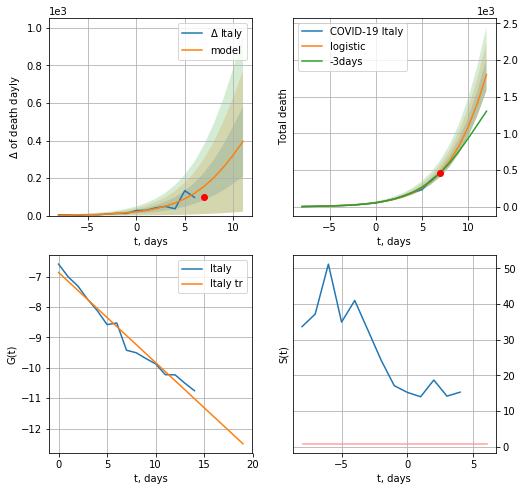

Italy data at: 2020-06-15
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +5 days
	 total death:  1803 ± 216
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


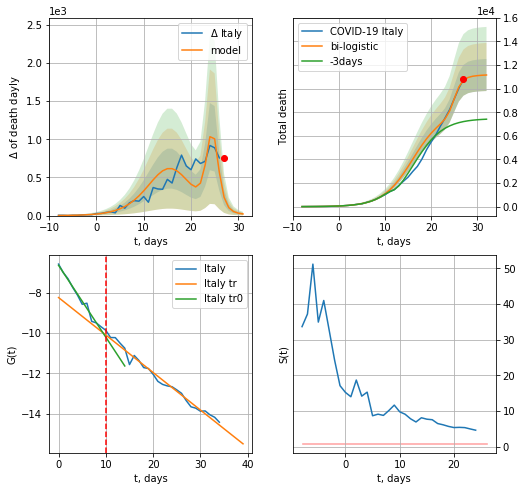

Italy data at: 2020-06-15
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +5 days
	 deltaDaydeath:  21
	 total death:  11154 ± 1358
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


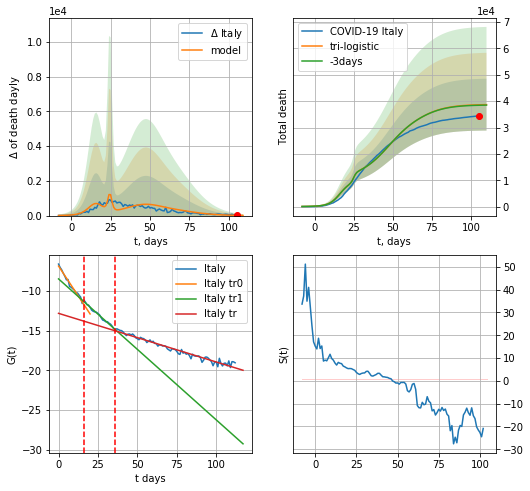

Italy data at: 2020-06-15
+3 day model MAPE: 0.004569279194727602
model: tri-logistic
coeffs:  [2.20536782e+04 1.10706261e-01 4.68377384e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.2540238553113344
forecast at the end of period: +5 days
	 deltaDaydeath:  10
	 total death:  38691 ± 9828
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.962232
 intercept: -12.805971
 slope: -0.061399


In [97]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*12-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*12-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*12-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


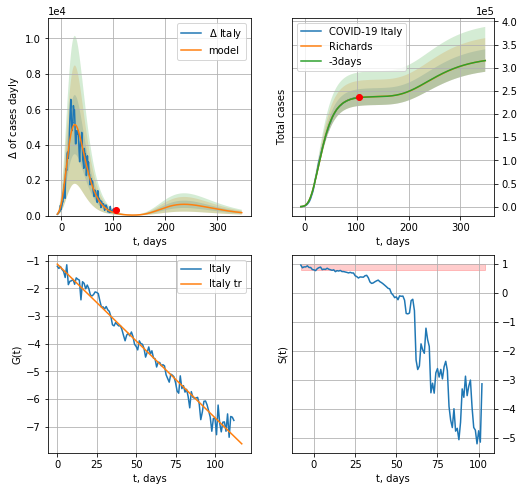

Italy data at: 2020-06-15
+3 day model MAPE: 0.000813
model: Richards
coeffs: [ 2.37867254e+05  7.21368149e+00 -5.55072860e+01  8.16559098e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.076794
forecast at the end of period: +243 days
	 deltaDaycases: 167
	 total cases: 315366 ± 24218
	 total death: 45680 ± 10523
trend coefficient of determination: 0.983125
 intercept: -1.125205
 slope: -0.055482


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


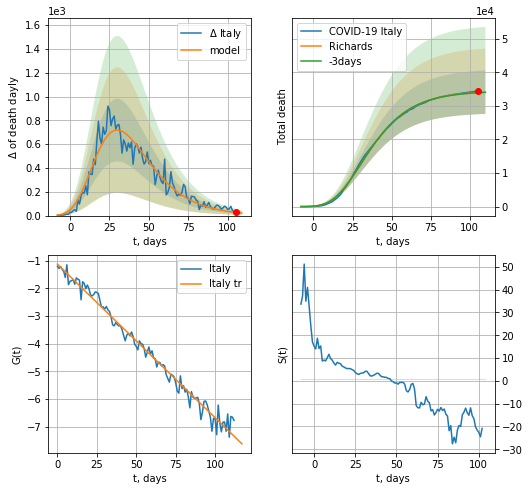

Italy data at: 2020-06-15
+3 day model MAPE: 0.001713
model: Richards
coeffs: [ 3.44504710e+04  6.97927863e+00 -5.40643966e+01  8.15685422e-03]
rational stdev: 0.190083
forecast at the end of period: +5 days
	 total death: 34081 ± 6478
trend coefficient of determination: 0.983125
 intercept: -1.125127
 slope: -0.055482


In [98]:
x = forecastRR('Italy',dfIT[:],d1,46*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


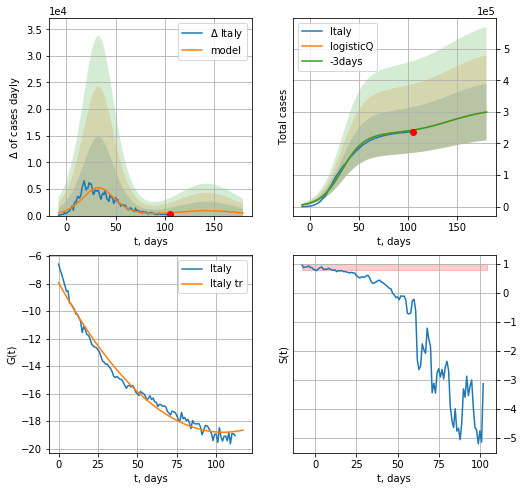

Italy data at: 2020-06-15
+3 day model MAPE: 0.002466
model: logisticQ
coeffs: [ 2.30748150e+05  3.24605336e-07  3.27543494e+01 -2.79135923e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.299280
forecast at the end of period: +75 days
	 deltaDaycases: 495
	 total cases: 299822 ± 89730
	 total death: 43428 ± 38991
trend coefficient of determination: 0.982804
 intercept_: -7.936476758913692
 coeffs_: [ 0.         -0.20831363  0.00099775]


In [99]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


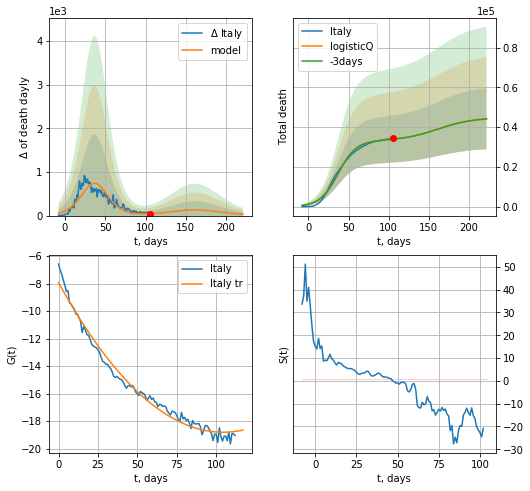

Italy data at: 2020-06-15
+3 day model MAPE: 0.004134
model: logisticQ
coeffs: [ 3.32120897e+04  3.06416644e-07  3.70464363e+01 -2.90268367e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348180
forecast at the end of period: +117 days
	 total death: 44240 ± 15403
trend coefficient of determination: 0.982804
 intercept_: -7.936476758913692
 coeffs_: [ 0.         -0.20831363  0.00099775]


In [100]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [101]:
dT

79

FR
           date     cases  active    death
117 2020-06-11  155561.0   54066  29346.0
118 2020-06-12  156287.0   54341  29374.0
119 2020-06-13  156813.0   54607  29398.0
120 2020-06-14  157220.0   54954  29407.0
121 2020-06-15  157372.0   54892  29436.0


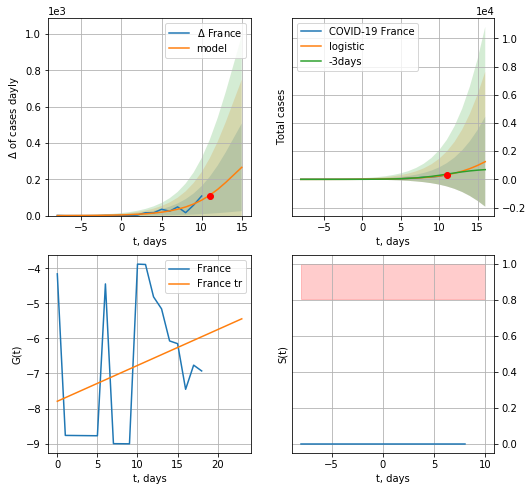

France data at: 2020-06-15
+3 day model MAPE: 0.04053337370546569
model: logistic
coeffs:  [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  2.5390562100826064
forecast at the end of period: +5 days
	 deltaDaycases:  266
	 total cases:  1254 ± 3184
	 total death:  234 ± 1782
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


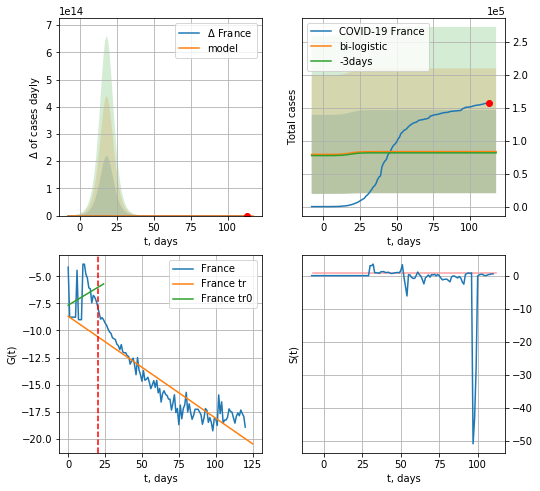

France data at: 2020-06-15
+3 day model MAPE: 0.022761204171091218
model: bi-logistic
coeffs:  [ 7.92857228e+04 -4.97184444e+00  1.31552644e+02] [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  0.7560731625003069
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  83459 ± 63101
	 total death:  15610 ± 35406
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.835061
 intercept: -8.686223
 slope: -0.094080


In [102]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,12*7-dT,1.0)
xx = forecast2('France',dfFR,d1,12*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [103]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

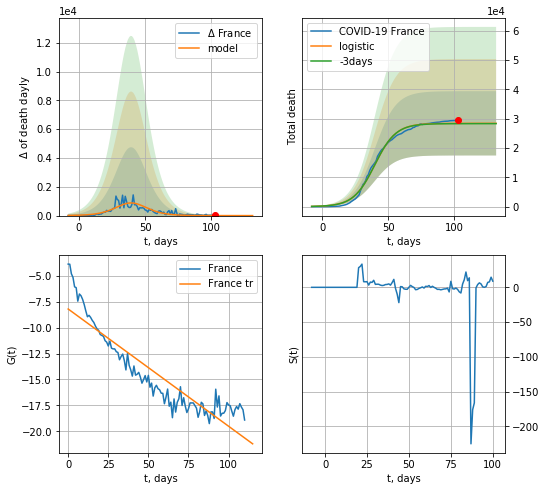

France data at: 2020-06-15
+3 day model MAPE: 0.0036111941767419118
model: logistic
coeffs:  [2.84207811e+04 1.24076178e-01 3.98779133e+01]
rational stdev:  0.3859218626343772
forecast at the end of period: +29 days
	 total death:  28420 ± 10968
trend coefficient of determination: 0.838056
 intercept: -8.208408
 slope: -0.112974


In [104]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


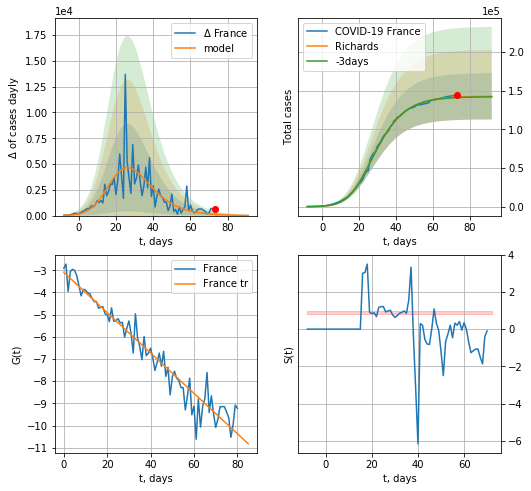

France data at: 2020-06-15
+3 day model MAPE: 0.005147
model: Richards
coeffs: [1.42848528e+05 3.23749564e-01 1.53796567e+01 3.15810253e-01]
rational stdev: 0.209496
forecast at the end of period: +19 days
	 deltaDaycases: 19
	 total cases: 142669 ± 29888
	 total death: 26685 ± 16771
trend coefficient of determination: 0.939070
 intercept: -3.090514
 slope: -0.090951


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


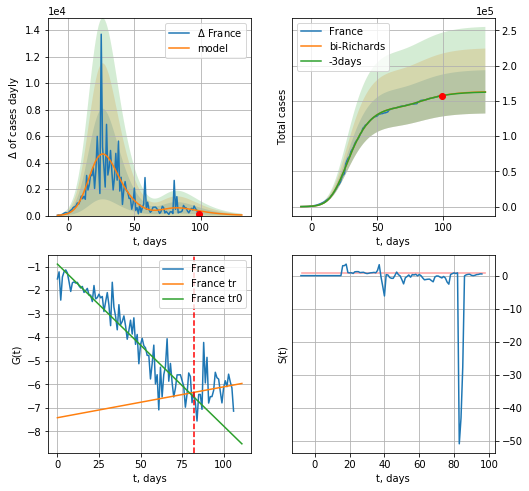

France data at: 2020-06-15
+3 day model MAPE: 0.000825
model: bi-Richards
coeffs: [2.05357945e+04 4.34028534e+00 2.76467619e+01 1.67195855e-02]
rational stdev: 0.188597
forecast at the end of period: +33 days
	 deltaDaycases: 46
	 total cases: 162759 ± 30695
	 total death: 30443 ± 17224
bi-Richards approximation splitting point: 82
trend coefficient of determination: 0.895045
 intercept: -0.895636
 slope: -0.068790
trend coefficient of determination: 0.018298
 intercept: -7.422042
 slope: 0.013111


In [105]:
vL = 82+14
x = forecastRR('France',dfFR[14:vL],d1,14*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


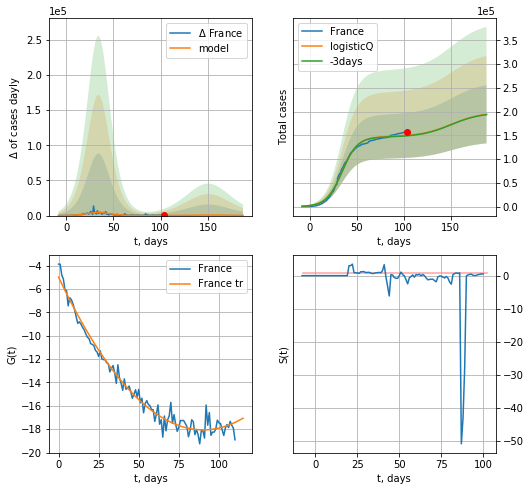

France data at: 2020-06-15
+3 day model MAPE: 0.006136
model: logisticQ
coeffs: [ 1.47201069e+05  4.02066920e-07  3.45698921e+01 -3.00893191e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.315404
forecast at the end of period: +85 days
	 deltaDaycases: 275
	 total cases: 194461 ± 61333
	 total death: 36373 ± 34416
trend coefficient of determination: 0.977660
 intercept_: -4.993689690887445
 coeffs_: [ 0.         -0.2899364   0.00160877]


In [106]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


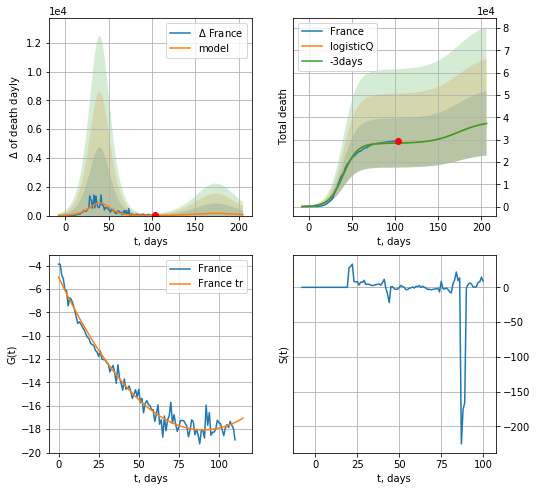

France data at: 2020-06-15
+3 day model MAPE: 0.003670
model: logisticQ
coeffs: [ 2.84206657e+04  4.56951282e-07  3.98784752e+01 -2.71415725e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.385986
forecast at the end of period: +103 days
	 total death: 37295 ± 14395
trend coefficient of determination: 0.977660
 intercept_: -4.993689690887445
 coeffs_: [ 0.         -0.2899364   0.00160877]


In [107]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [108]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [109]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
108 2020-06-11  186795    6344  8851.0
109 2020-06-12  187251    6788  8863.0
110 2020-06-13  187423    6656  8867.0
111 2020-06-14  187671    6601  8870.0
112 2020-06-15  188044    6059  8885.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


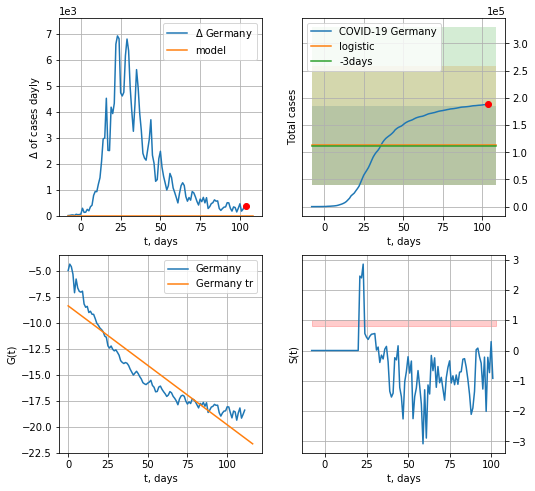

Germany data at: 2020-06-15
+3 day model MAPE: 0.01843739517402687
model: logistic
coeffs:  [ 1.12821708e+05 -4.52910189e+00  1.37053302e+02]
rational stdev:  0.6429626952899393
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  112821 ± 72540
	 total death:  5330 ± 10280
trend coefficient of determination: 0.859768
 intercept: -8.361834
 slope: -0.114109


In [110]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*12-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


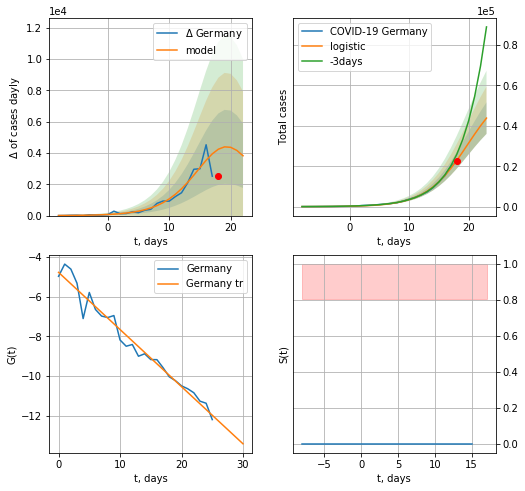

Germany data at: 2020-06-15
+3 day model MAPE: 0.18326880785963318
model: logistic
coeffs:  [6.15503822e+04 2.86340376e-01 1.98405527e+01]
rational stdev:  0.17812668621755098
forecast at the end of period: +5 days
	 deltaDaycases:  3820
	 total cases:  43818 ± 7805
	 total death:  2070 ± 1106
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


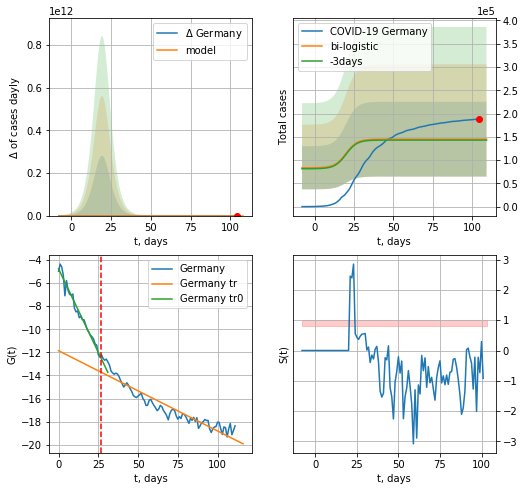

Germany data at: 2020-06-15
+3 day model MAPE: 0.0141825549814144
model: bi-logistic
coeffs:  [ 6.67088116e+04 -2.16592643e+00  1.21837683e+02] [6.15503822e+04 2.86340376e-01 1.98405527e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.5547060187050525
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  144936 ± 80397
	 total death:  6848 ± 11395
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.890346
 intercept: -11.857857
 slope: -0.069515


In [111]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,12*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*12-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
108 2020-06-11  186795    6344  8851.0
109 2020-06-12  187251    6788  8863.0
110 2020-06-13  187423    6656  8867.0
111 2020-06-14  187671    6601  8870.0
112 2020-06-15  188044    6059  8885.0


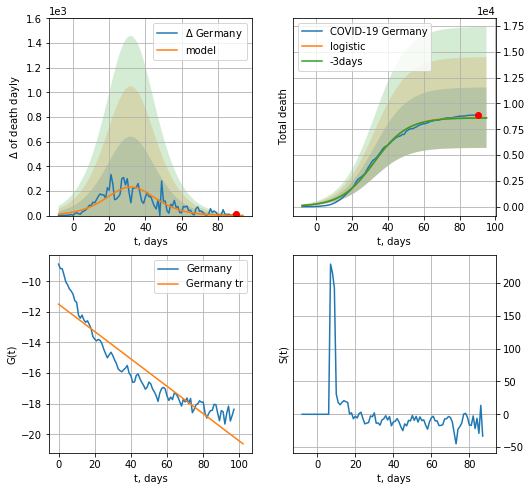

Germany data at: 2020-06-15
+3 day model MAPE: 0.004113211135022177
model: logistic
coeffs:  [8.63216147e+03 1.07527358e-01 3.23621034e+01]
rational stdev:  0.3400606416261487
forecast at the end of period: +5 days
	 total death:  8621 ± 2931
trend coefficient of determination: 0.869605
 intercept: -11.496482
 slope: -0.089478


In [112]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


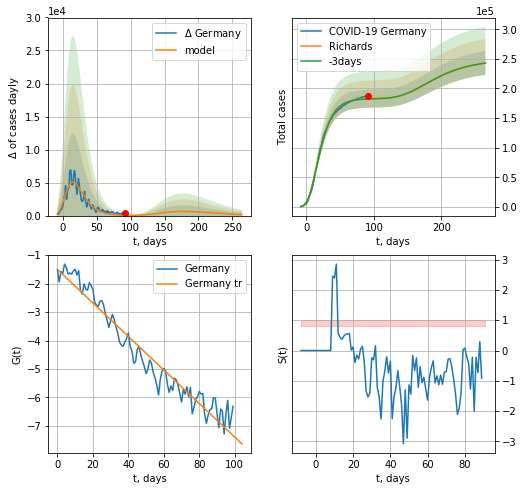

Germany data at: 2020-06-15
+3 day model MAPE: 0.002953
model: Richards
coeffs: [ 1.83344873e+05  1.07691019e+01 -5.05094912e+01  7.00047878e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.083398
forecast at the end of period: +173 days
	 deltaDaycases: 164
	 total cases: 243131 ± 20276
	 total death: 11487 ± 2873
trend coefficient of determination: 0.945422
 intercept: -1.501527
 slope: -0.058899


In [113]:
x = forecastRR('Germany',dfGR[12:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


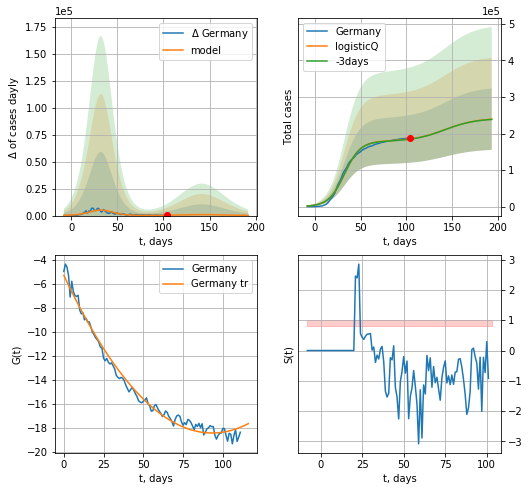

Germany data at: 2020-06-15
+3 day model MAPE: 0.003967
model: logisticQ
coeffs: [ 1.79106099e+05  3.05286201e-07  3.25888315e+01 -3.78089326e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.351473
forecast at the end of period: +89 days
	 deltaDaycases: 177
	 total cases: 239413 ± 84147
	 total death: 11312 ± 11927
trend coefficient of determination: 0.985661
 intercept_: -5.289433763934015
 coeffs_: [ 0.         -0.28169888  0.00150984]


In [114]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


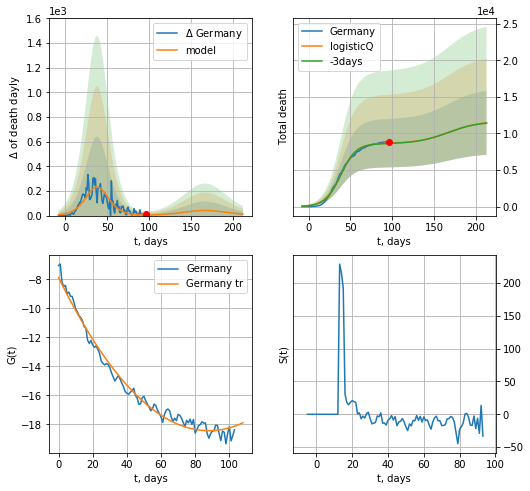

Germany data at: 2020-06-15
+3 day model MAPE: 0.004173
model: logisticQ
coeffs: [ 8.63037700e+03  6.36003038e-07  3.83589691e+01 -1.69236512e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.382035
forecast at the end of period: +117 days
	 total death: 11450 ± 4374
trend coefficient of determination: 0.983124
 intercept_: -7.8746467701202905
 coeffs_: [ 0.         -0.23992685  0.00136368]


In [115]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
102 2020-06-11  2089825  1157616  116035.0
103 2020-06-12  2117027  1158260  116831.0
104 2020-06-13  2142224  1170591  117527.0
105 2020-06-14  2162228  1174320  117858.0
106 2020-06-15  2182950  1174801  118283.0


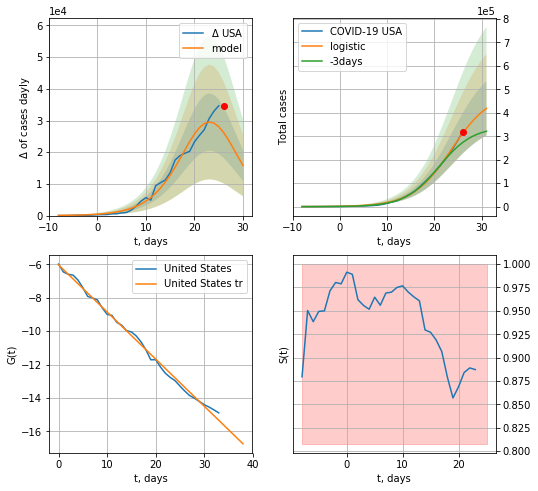

USA data at: 2020-06-15
+3 day model MAPE: 0.17962965715206392
model: logistic
coeffs:  [4.89025783e+05 2.41973857e-01 2.36121759e+01]
rational stdev:  0.2760702577358041
forecast at the end of period: +5 days
	 deltaDaycases:  15820
	 total cases:  418919 ± 115651
	 total death:  22699 ± 18799
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


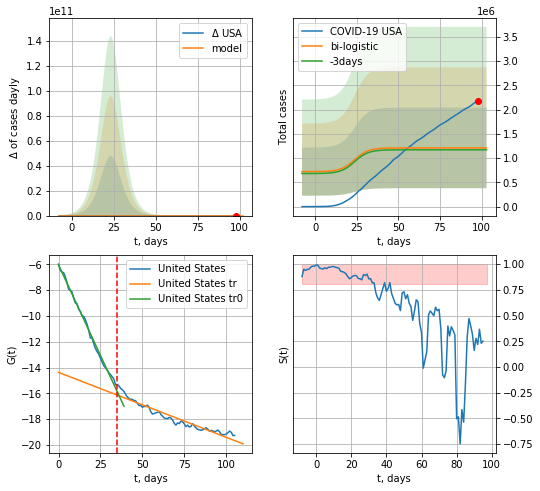

USA data at: 2020-06-15
+3 day model MAPE: 0.03381525230692588
model: bi-logistic
coeffs:  [ 5.76324447e+05 -7.74909132e+00  1.96615293e+02] [4.89025783e+05 2.41973857e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6867634180195822
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1209431 ± 830593
	 total death:  65532 ± 135014
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.923315
 intercept: -14.372416
 slope: -0.050301


In [116]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,12*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

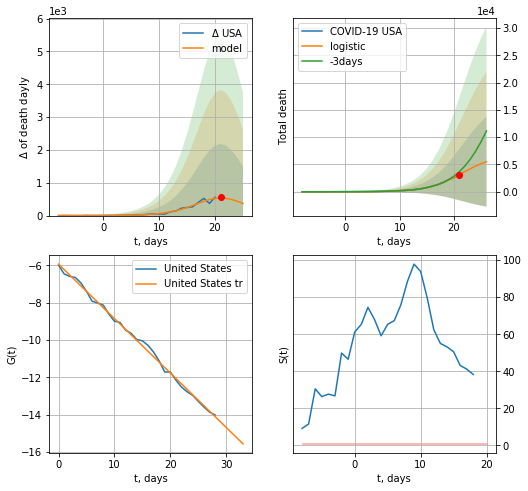

USA data at: 2020-06-15
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +5 days
	 total death:  5510 ± 8226
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


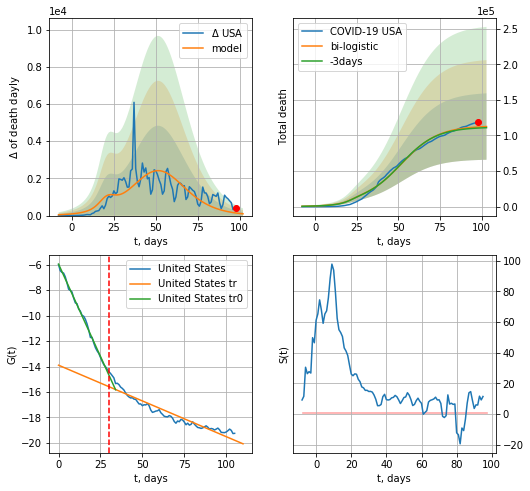

USA data at: 2020-06-15
+3 day model MAPE: 0.014074806785395933
model: bi-logistic
coeffs:  [1.06722387e+05 9.05633239e-02 5.18418879e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.4148200782391874
forecast at the end of period: +5 days
	 deltaDaydeath:  96
	 total death:  112528 ± 46679
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.905283
 intercept: -13.896531
 slope: -0.056180


In [117]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*12-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*12-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


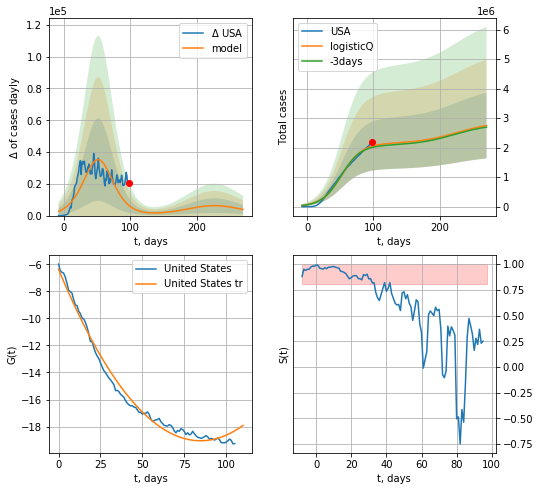

USA data at: 2020-06-15
+3 day model MAPE: 0.021185
model: logisticQ
coeffs: [ 2.13583977e+06  2.79108880e-07  5.21131002e+01 -2.35927785e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.405456
forecast at the end of period: +173 days
	 deltaDaycases: 3889
	 total cases: 2748934 ± 1114572
	 total death: 148950 ± 181178
trend coefficient of determination: 0.987004
 intercept_: -6.3674122826645885
 coeffs_: [ 0.         -0.29942933  0.0017683 ]


In [118]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


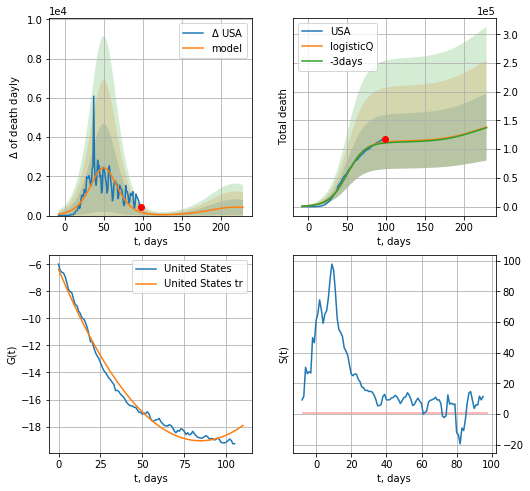

USA data at: 2020-06-15
+3 day model MAPE: 0.013531
model: logisticQ
coeffs: [ 1.13931232e+05  3.84297781e-07  5.02093686e+01 -2.22196700e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.420288
forecast at the end of period: +131 days
	 total death: 138440 ± 58184
trend coefficient of determination: 0.987004
 intercept_: -6.3674122826645885
 coeffs_: [ 0.         -0.29942933  0.0017683 ]


In [119]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


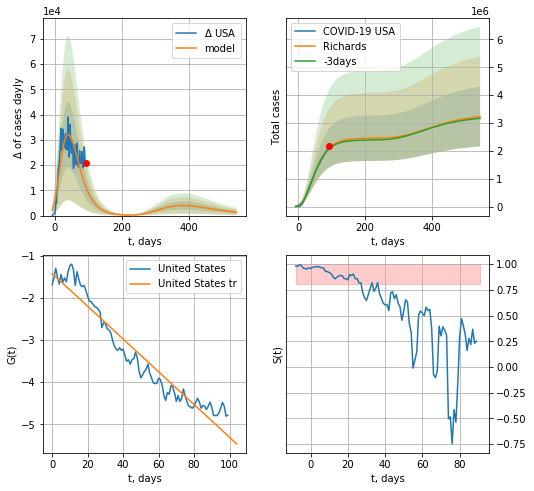

USA data at: 2020-06-15
+3 day model MAPE: 0.012889
model: Richards
coeffs: [ 2.45798020e+06  4.10186913e+00 -9.24648882e+01  8.70436792e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.331529
forecast at the end of period: +453 days
	 deltaDaycases: 1325
	 total cases: 3232699 ± 1071735
	 total death: 175163 ± 174215
trend coefficient of determination: 0.933034
 intercept: -1.413665
 slope: -0.038964


In [120]:
x = forecastRR('USA',dfUS[6:],d1,7*76-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


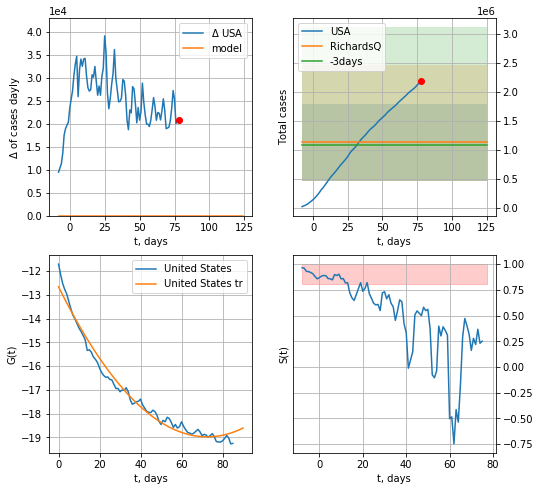

USA data at: 2020-06-15
+3 day model MAPE: 0.033800
model: RichardsQ
coeffs: [ 1.12895330e+06  5.83459889e-01 -2.03630515e+01 -3.58804932e+01
  1.16194669e-01]
rational stdev: 0.587709
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 1128953 ± 663496
	 total death: 61172 ± 107854
trend coefficient of determination: 0.980028
 intercept_: -12.665319595078275
 coeffs_: [ 0.         -0.17413704  0.00120124]


In [121]:
x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
106 2020-06-11  291409       0  41279.0
107 2020-06-12  292950       0  41481.0
108 2020-06-13  294375       0  41662.0
109 2020-06-14  295889       0  41698.0
110 2020-06-15  296857       0  41736.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


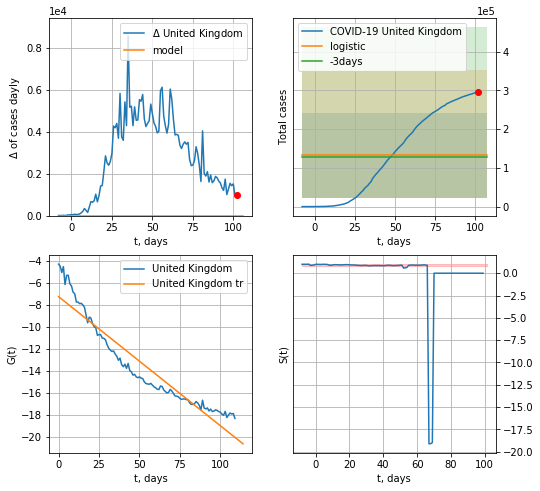

United Kingdom data at: 2020-06-15
+3 day model MAPE: 0.03562027075135451
model: logistic
coeffs:  [ 1.32116811e+05 -7.98145653e+00  2.09357614e+02]
rational stdev:  0.8380067228103445
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  132116 ± 110714
	 total death:  18574 ± 46695
trend coefficient of determination: 0.900873
 intercept: -7.268122
 slope: -0.117223


In [122]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*12-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


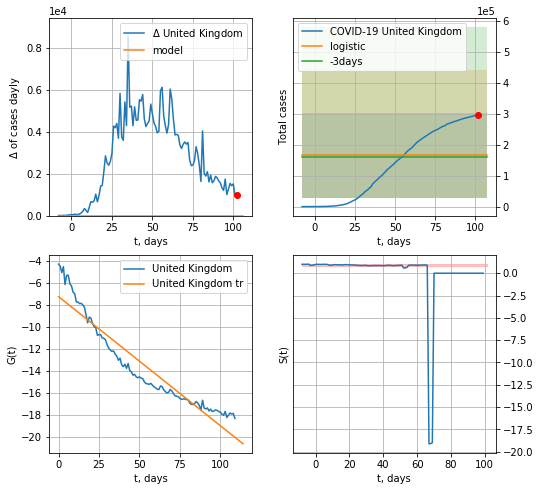

United Kingdom data at: 2020-06-15
+3 day model MAPE: 0.03562027075135451
model: logistic
coeffs:  [ 1.32116811e+05 -7.98145653e+00  2.09357614e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8380067228103445
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  165146 ± 138393
	 total death:  23218 ± 58370
trend coefficient of determination: 0.900873
 intercept: -7.268122
 slope: -0.117223


In [123]:
x = forecast('United Kingdom',dfGB[:],d1,12*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


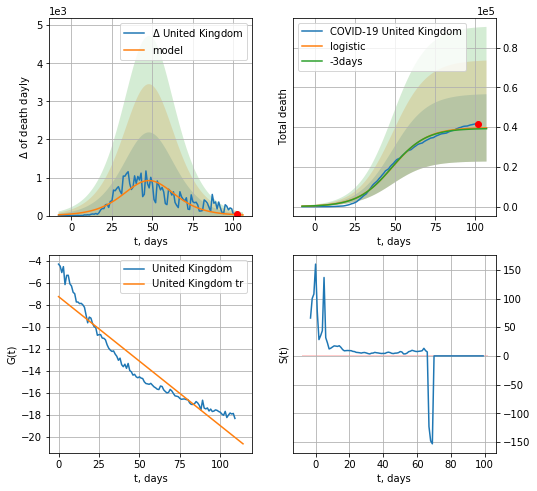

United Kingdom data at: 2020-06-15
+3 day model MAPE: 0.010261734335891334
model: logistic
coeffs:  [3.98324843e+04 9.23008989e-02 4.83412963e+01]
rational stdev:  0.42753820074574367
forecast at the end of period: +5 days
	 total death:  39655 ± 16954
trend coefficient of determination: 0.900873
 intercept: -7.268122
 slope: -0.117223


In [124]:
x = forecast('United Kingdom',dfGB[:],d1,12*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


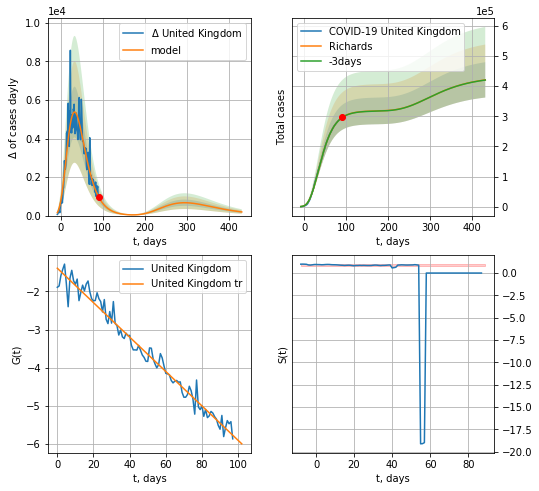

United Kingdom data at: 2020-06-15
+3 day model MAPE: 0.001167
model: Richards
coeffs: [ 3.17921272e+05  4.13785845e+00 -6.38001825e+01  1.11699438e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.139236
forecast at the end of period: +341 days
	 deltaDaycases: 189
	 total cases: 420511 ± 58550
	 total death: 59120 ± 24694
trend coefficient of determination: 0.973544
 intercept: -1.389544
 slope: -0.045175


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


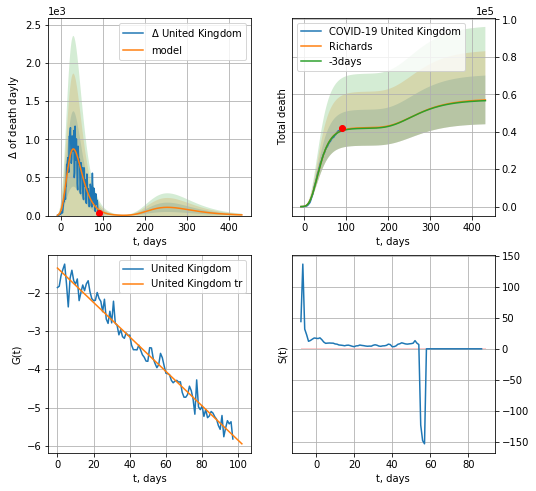

United Kingdom data at: 2020-06-15
+3 day model MAPE: 0.005806
model: Richards
coeffs: [ 4.21773830e+04  7.38920926e+00 -5.58492129e+01  7.64904750e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.228181
forecast at the end of period: +341 days
	 total death: 56972 ± 12999
trend coefficient of determination: 0.973230
 intercept: -1.359518
 slope: -0.044984


In [125]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


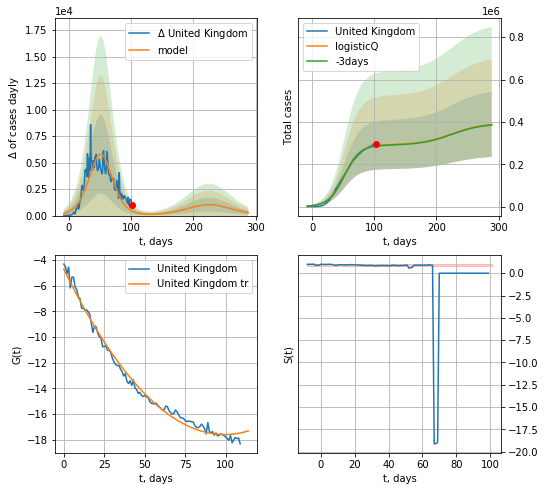

United Kingdom data at: 2020-06-15
+3 day model MAPE: 0.007684
model: logisticQ
coeffs: [ 2.91909836e+05  4.08019138e-07  5.17029718e+01 -1.94523150e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.395899
forecast at the end of period: +187 days
	 deltaDaycases: 284
	 total cases: 387750 ± 153509
	 total death: 54515 ± 64747
trend coefficient of determination: 0.991203
 intercept_: -4.70426591154415
 coeffs_: [ 0.         -0.25966424  0.00130682]


In [126]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


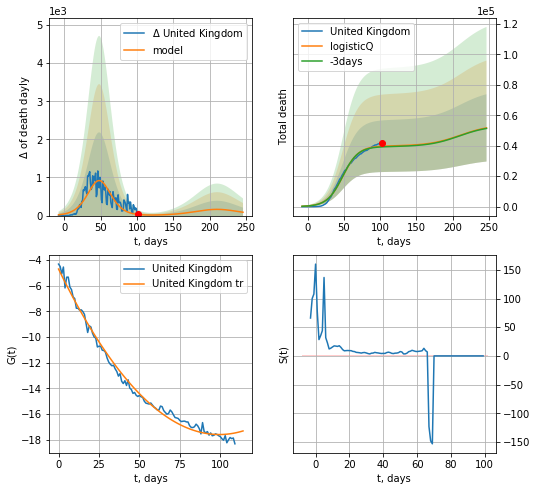

United Kingdom data at: 2020-06-15
+3 day model MAPE: 0.010341
model: logisticQ
coeffs: [ 3.98316534e+04  3.48284904e-07  4.83416859e+01 -2.64894675e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.427567
forecast at the end of period: +145 days
	 total death: 51731 ± 22118
trend coefficient of determination: 0.991203
 intercept_: -4.70426591154415
 coeffs_: [ 0.         -0.25966424  0.00130682]


In [127]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [128]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [129]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [130]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [131]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [132]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [133]:
dT

79

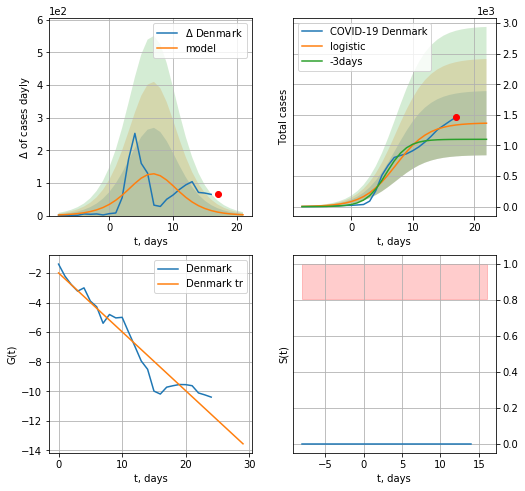

Denmark data at: 2020-06-15
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  1364 ± 524
	 total death:  66 ± 76
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


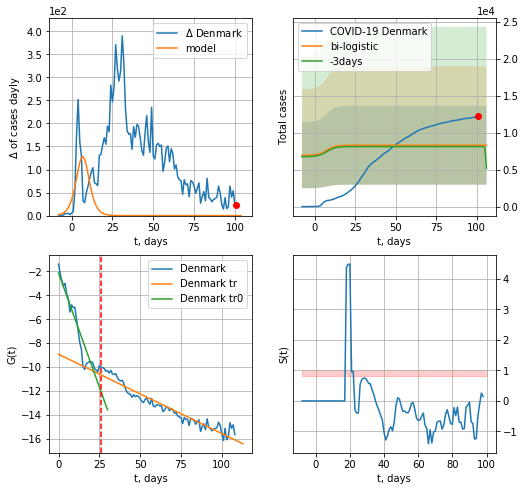

Denmark data at: 2020-06-15
+3 day model MAPE: 0.02261829069540497
model: bi-logistic
coeffs:  [ 5.56160305e+03 -3.75188227e+00  1.07612070e+02] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6423603491242817
forecast at the end of period: +5 days
	 deltaDaycases:  -12
	 total cases:  8308 ± 5337
	 total death:  406 ± 782
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.926116
 intercept: -8.928016
 slope: -0.066291


In [134]:
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*12-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,12*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


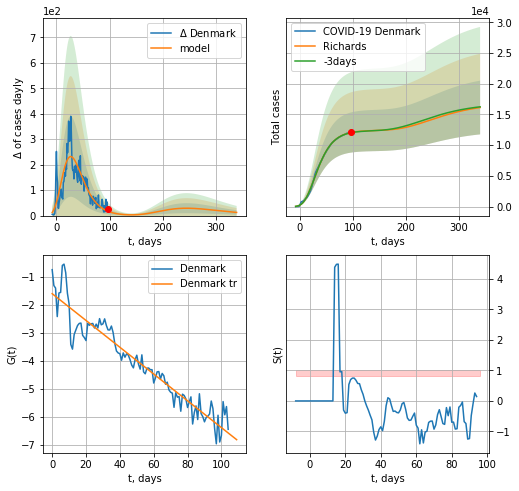

Denmark data at: 2020-06-15
+3 day model MAPE: 0.002628
model: Richards
coeffs: [ 1.24128338e+04  2.27109302e+00 -4.64761953e+01  2.26043475e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.270997
forecast at the end of period: +243 days
	 deltaDaycases: 12
	 total cases: 16133 ± 4372
	 total death: 789 ± 641
trend coefficient of determination: 0.910466
 intercept: -1.602189
 slope: -0.047818


In [135]:
x = forecastRR('Denmark',dfDK[4:],d1,46*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


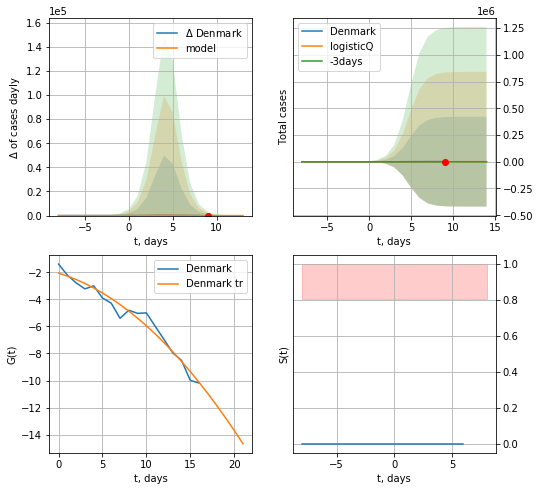

Denmark data at: 2020-06-15
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 862 ± 420247
	 total death: 42 ± 61395
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


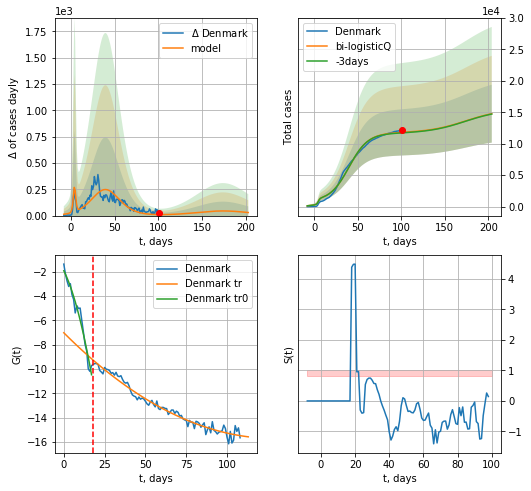

Denmark data at: 2020-06-15
+3 day model MAPE: 0.006351
model: bi-logisticQ
coeffs: [ 1.08525480e+04  2.70534461e-07  4.00356079e+01 -3.37079771e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311344
forecast at the end of period: +103 days
	 deltaDaycases: 29
	 total cases: 14769 ± 4598
	 total death: 722 ± 674
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.971370
 intercept_: -7.022368064595232
 coeffs_: [ 0.         -0.13425201  0.00051903]


In [136]:
x = forecastRRR('Denmark',dfDK[:18],d1,12*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date  cases  active  death
106 2020-06-11   8608     228  242.0
107 2020-06-12   8620     240  242.0
108 2020-06-13   8628     248  242.0
109 2020-06-14   8631     251  242.0
110 2020-06-15   8647     267  242.0


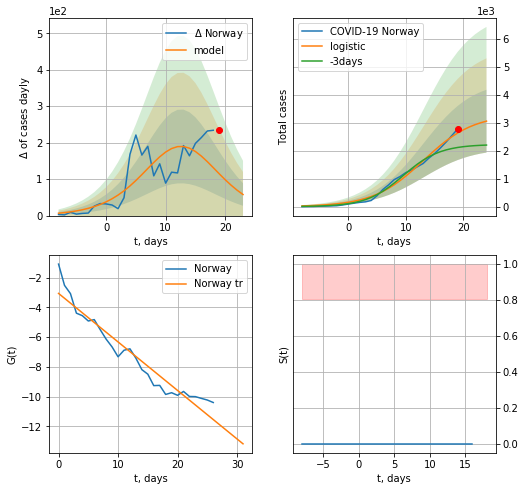

Norway data at: 2020-06-15
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +5 days
	 deltaDaycases:  57
	 total cases:  3052 ± 1121
	 total death:  85 ± 93
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


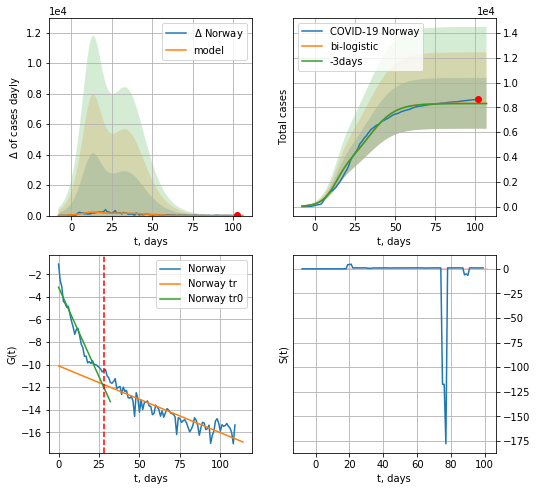

Norway data at: 2020-06-15
+3 day model MAPE: 0.003387772955898854
model: bi-logistic
coeffs:  [5.03496653e+03 1.25205769e-01 3.45712989e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.24638269794595888
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  8332 ± 2052
	 total death:  233 ± 172
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.827859
 intercept: -10.118428
 slope: -0.059210


In [137]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*12-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,12*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

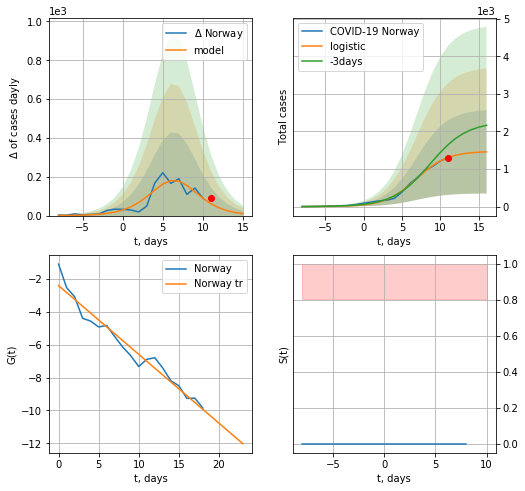

Norway data at: 2020-06-15
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +5 days
	 deltaDaycases:  9
	 total cases:  1458 ± 1108
	 total death:  40 ± 91
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


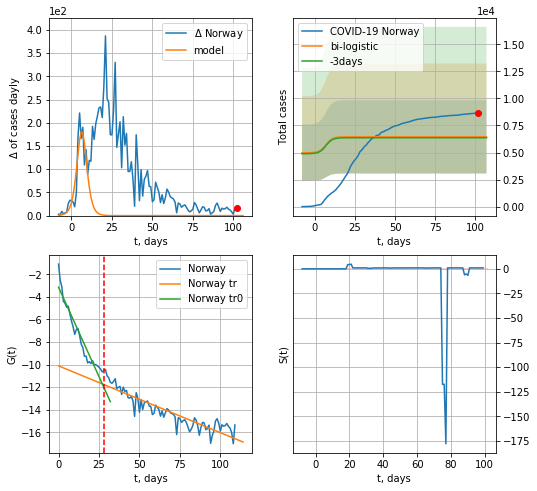

Norway data at: 2020-06-15
+3 day model MAPE: 0.013444938969555311
model: bi-logistic
coeffs:  [ 4.42235237e+03 -2.29438690e+00  1.23643424e+02] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5252752045708671
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  6449 ± 3387
	 total death:  180 ± 283
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.827859
 intercept: -10.118428
 slope: -0.059210


In [138]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*12-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


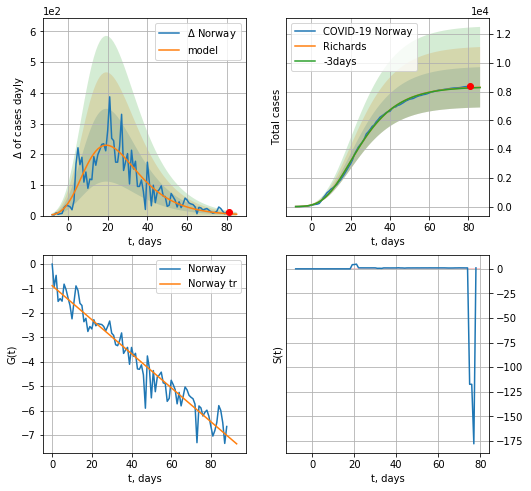

Norway data at: 2020-06-15
+3 day model MAPE: 0.001938
model: Richards
coeffs: [ 8.35144256e+03  6.60312441e+00 -3.98482814e+01  1.13741644e-02]
rational stdev: 0.168871
forecast at the end of period: +5 days
	 deltaDaycases: 4
	 total cases: 8293 ± 1400
	 total death: 232 ± 117
trend coefficient of determination: 0.941185
 intercept: -0.895025
 slope: -0.069489


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


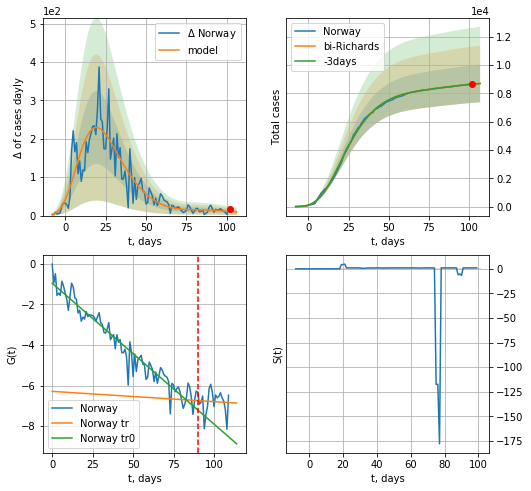

Norway data at: 2020-06-15
+3 day model MAPE: 0.000295
model: bi-Richards
coeffs: [5.41907914e+02 2.66547210e+00 2.10688858e+01 2.06719507e-02]
rational stdev: 0.153061
forecast at the end of period: +5 days
	 deltaDaycases: 9
	 total cases: 8694 ± 1330
	 total death: 243 ± 111
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.939936
 intercept: -0.964119
 slope: -0.069357
trend coefficient of determination: 0.002605
 intercept: -6.288334
 slope: -0.005045


In [139]:
vL = 90
x = forecastRR('Norway',dfNG[:vL],d1,12*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,12*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


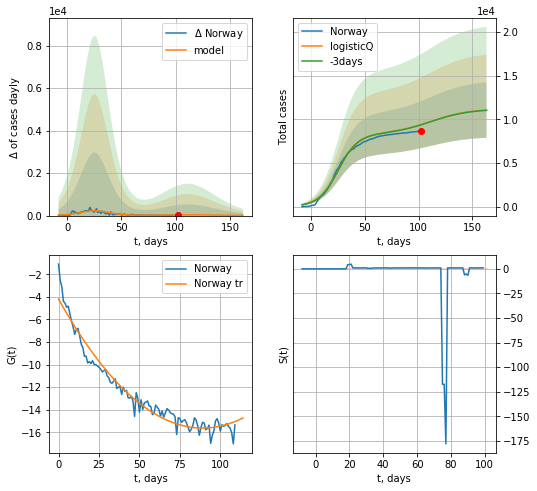

Norway data at: 2020-06-15
+3 day model MAPE: 0.001804
model: logisticQ
coeffs: [ 8.29258619e+03  3.42648399e-07  2.55704302e+01 -3.21014620e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.287049
forecast at the end of period: +61 days
	 deltaDaycases: 8
	 total cases: 11069 ± 3177
	 total death: 309 ± 266
trend coefficient of determination: 0.957266
 intercept_: -4.20051419865338
 coeffs_: [ 0.         -0.25671677  0.00144148]


In [140]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


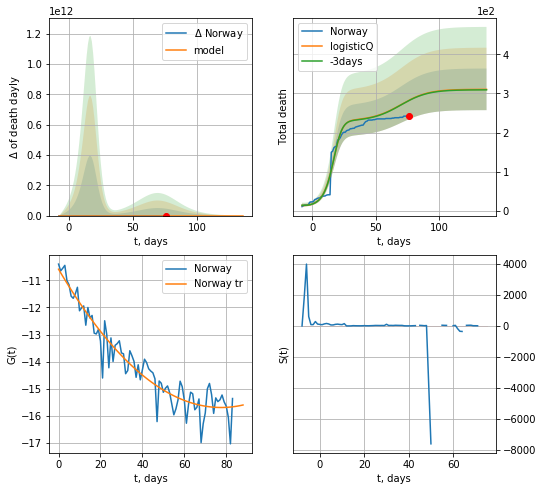

Norway data at: 2020-06-15
+3 day model MAPE: 0.002642
model: logisticQ
coeffs: [ 2.29335900e+02  5.42592779e-03  1.58312863e+01 -2.93082390e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.171167
forecast at the end of period: +61 days
	 total death: 310 ± 53
trend coefficient of determination: 0.912675
 intercept_: -10.588778014759885
 coeffs_: [ 0.         -0.1314879   0.00084758]


In [141]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

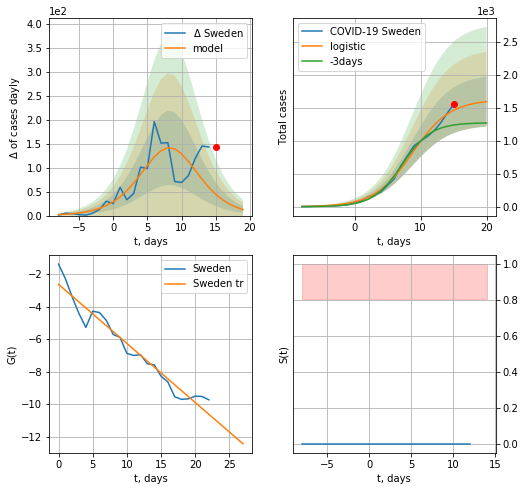

Sweden data at: 2020-06-15
+3 day model MAPE: 0.2037446768613992
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.23715803800431418
forecast at the end of period: +5 days
	 deltaDaycases:  12
	 total cases:  1592 ± 377
	 total death:  148 ± 105
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132


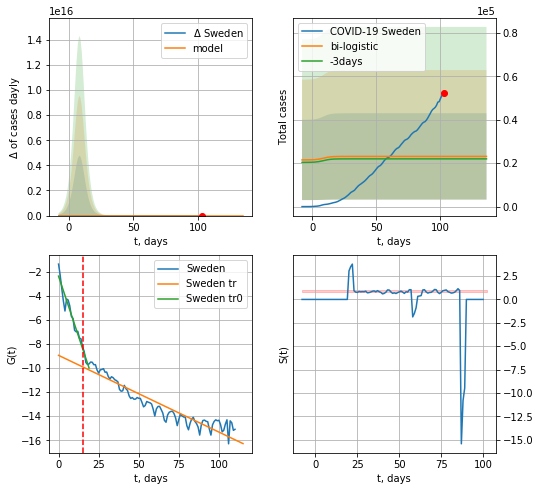

Sweden data at: 2020-06-15
+3 day model MAPE: 0.05137552470905548
model: bi-logistic
coeffs:  [ 1.71914562e+04 -7.12371567e+00  1.86097210e+02] [1.62331286e+03 3.49719159e-01 8.72648648e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8598915213143854
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  23112 ± 19874
	 total death:  2158 ± 5566
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.908377
 intercept: -2.385275
 slope: -0.400494
trend coefficient of determination: 0.886852
 intercept: -8.953890
 slope: -0.063657


In [142]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,7*12-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
           date  cases  active   death
107 2020-06-11  48288       0  4814.0
108 2020-06-12  49684       0  4854.0
109 2020-06-13  50931       0  4874.0
110 2020-06-14  51614       0  4874.0
111 2020-06-15  52383       0  4891.0


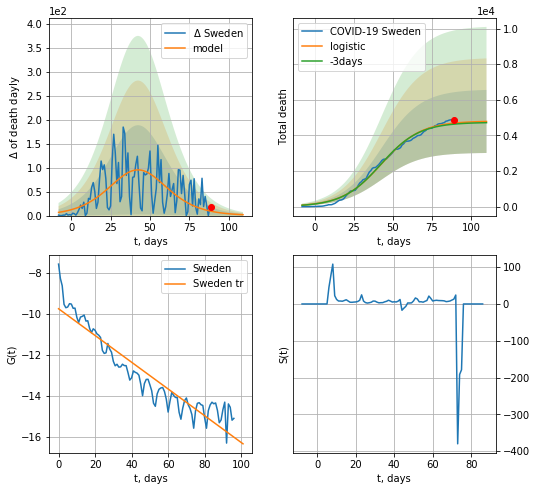

Sweden data at: 2020-06-15
+3 day model MAPE: 0.012388265650766455
model: logistic
coeffs:  [4.80509941e+03 7.95495573e-02 4.28660341e+01]
rational stdev:  0.3701532797958167
forecast at the end of period: +21 days
	 total death:  4782 ± 1770
trend coefficient of determination: 0.882169
 intercept: -9.753163
 slope: -0.065086


In [143]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


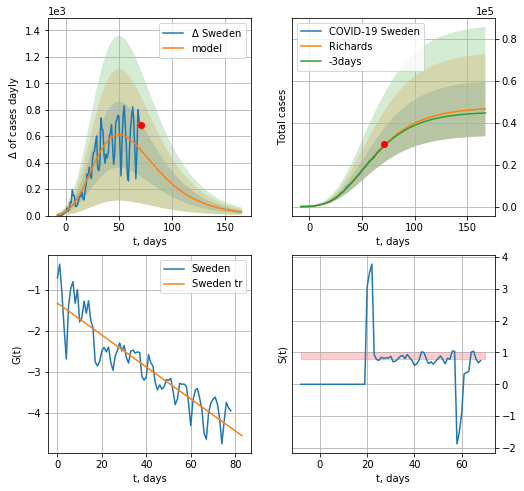

Sweden data at: 2020-06-15
+3 day model MAPE: 0.010517
model: Richards
coeffs: [ 4.73307988e+04  2.03831360e+00 -6.40325124e+01  1.73598705e-02]
rational stdev: 0.279833
forecast at the end of period: +96 days
	 deltaDaycases: 27
	 total cases: 46569 ± 13031
	 total death: 4348 ± 3650
trend coefficient of determination: 0.828153
 intercept: -1.321880
 slope: -0.038966


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


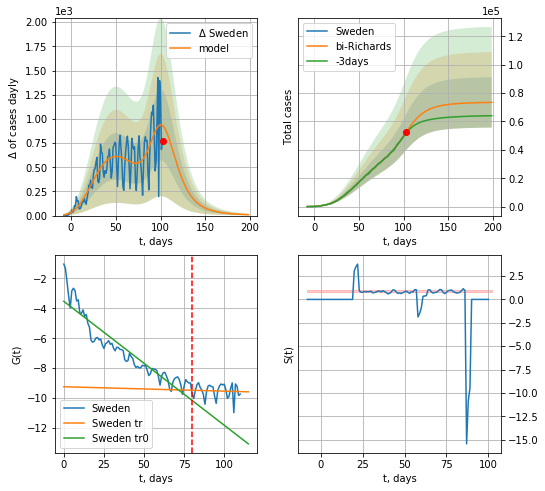

Sweden data at: 2020-06-15
+3 day model MAPE: 0.014405
model: bi-Richards
coeffs: [2.63672027e+04 1.79011387e-01 9.51415130e+01 5.06776019e-01]
rational stdev: 0.241378
forecast at the end of period: +96 days
	 deltaDaycases: 9
	 total cases: 73447 ± 17728
	 total death: 6857 ± 4965
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.871239
 intercept: -3.531009
 slope: -0.082802
trend coefficient of determination: 0.003132
 intercept: -9.239647
 slope: -0.002941


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


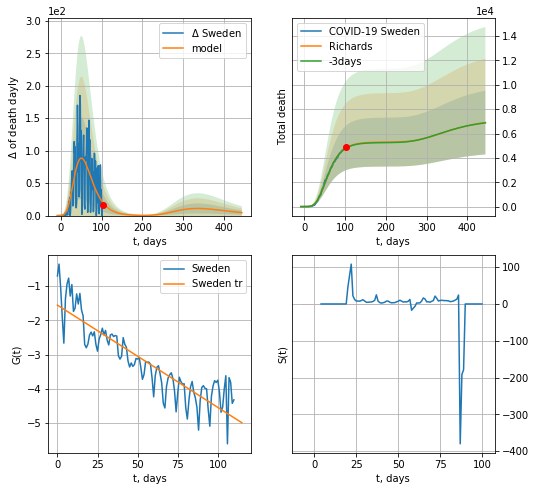

Sweden data at: 2020-06-15
+3 day model MAPE: 0.004737
model: Richards
coeffs: [ 5.30372735e+03  5.01851093e+00 -5.20559977e+01  9.08756370e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.379178
forecast at the end of period: +341 days
	 total death: 6903 ± 2617
trend coefficient of determination: 0.792938
 intercept: -1.551990
 slope: -0.029891


In [144]:
vL = 80
x = forecastRR('Sweden',dfSW[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Sweden',dfSW[:],d1,60*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs,cases='death')
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


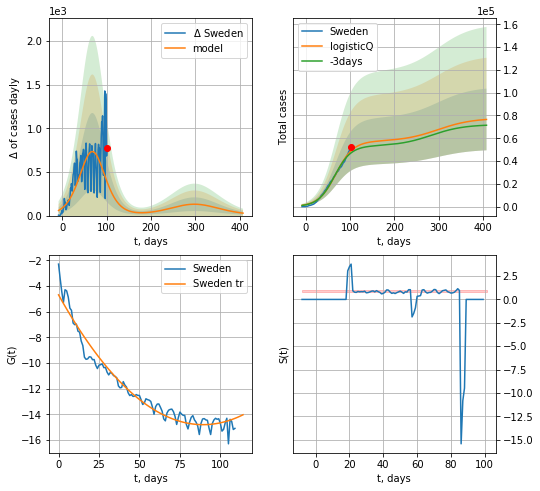

Sweden data at: 2020-06-15
+3 day model MAPE: 0.038073
model: logisticQ
coeffs: [ 5.73335705e+04  3.10968840e-07  6.84109160e+01 -1.64124618e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354029
forecast at the end of period: +306 days
	 deltaDaycases: 27
	 total cases: 76497 ± 27082
	 total death: 7142 ± 7585
trend coefficient of determination: 0.958605
 intercept_: -4.679336949241537
 coeffs_: [ 0.         -0.22654141  0.00126791]


In [145]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


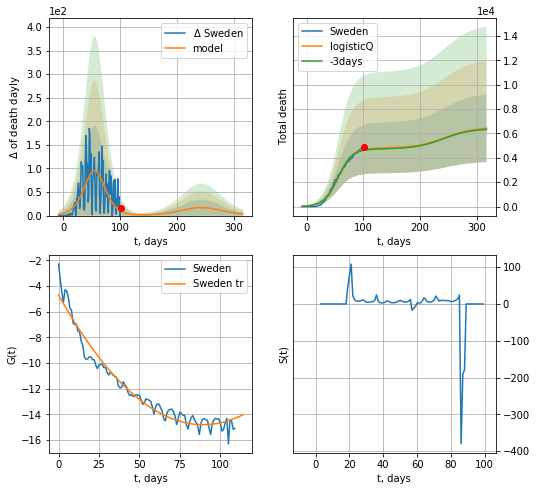

Sweden data at: 2020-06-15
+3 day model MAPE: 0.012500
model: logisticQ
coeffs: [ 4.79912008e+03  4.16989373e-07  5.58265470e+01 -1.91507553e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.432406
forecast at the end of period: +215 days
	 total death: 6415 ± 2773
trend coefficient of determination: 0.958605
 intercept_: -4.679336949241537
 coeffs_: [ 0.         -0.22654141  0.00126791]


In [146]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
141 2020-06-11  83064.0      65  4634.0
142 2020-06-12  83075.0      74  4634.0
143 2020-06-13  83132.0     129  4634.0
144 2020-06-14  83181.0     177  4634.0
145 2020-06-15  83221.0     210  4634.0


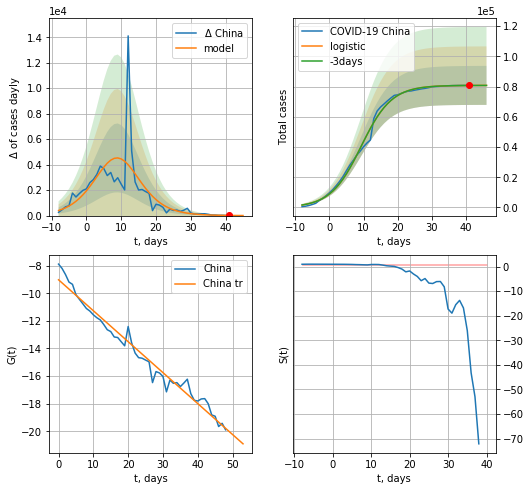

China data at: 2020-06-15
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  80788 ± 12903
	 total death:  4498 ± 2155
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


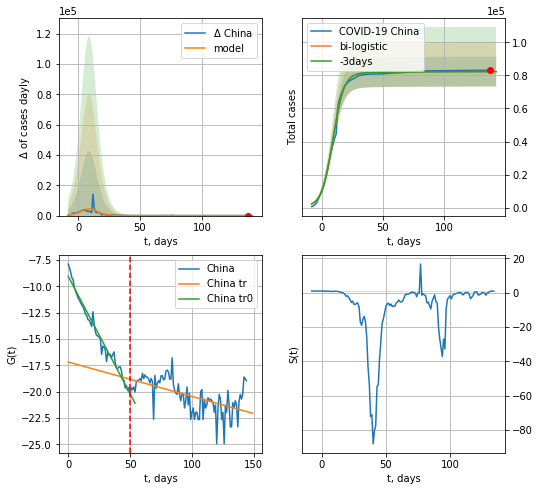

China data at: 2020-06-15
+3 day model MAPE: 0.00032580415041845055
model: bi-logistic
coeffs:  [1.56118429e+03 3.04173068e-02 1.38187327e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.10958148280004357
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  82340 ± 9022
	 total death:  4584 ± 1506
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.319182
 intercept: -17.184361
 slope: -0.032664


In [147]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*12-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [148]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

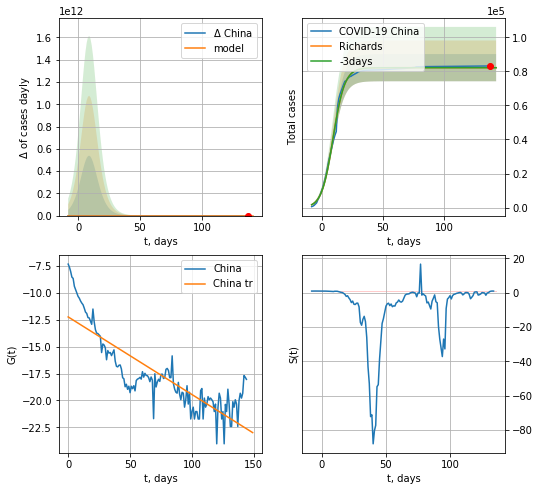

China data at: 2020-06-15
+3 day model MAPE: 0.000354
model: Richards
coeffs: [8.21999014e+04 2.28343302e-01 8.92030782e+00 9.17923332e-01]
rational stdev: 0.097120
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 82199 ± 7983
	 total death: 4577 ± 1333
trend coefficient of determination: 0.718787
 intercept: -12.240097
 slope: -0.072105


In [149]:
x = forecastRR('China',dfCN[:],d1,12*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

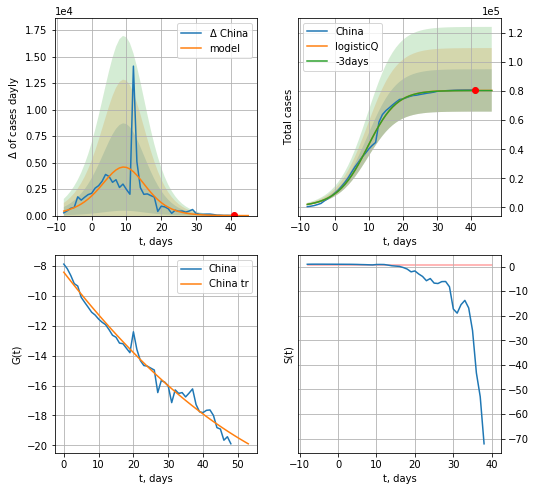

China data at: 2020-06-15
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 80413 ± 14556
	 total death: 4477 ± 2431
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


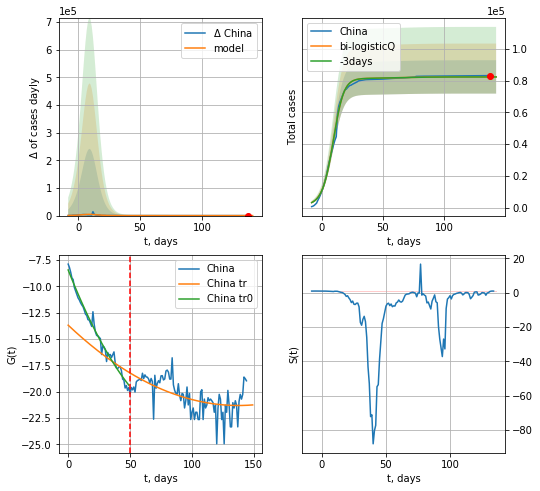

China data at: 2020-06-15
+3 day model MAPE: 0.000406
model: bi-logisticQ
coeffs: [ 1.95537102e+03  4.99729136e-04  2.48155135e+01 -3.63436159e-02]
rational stdev: 0.127583
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 82372 ± 10509
	 total death: 4586 ± 1755
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.348639
 intercept_: -13.685951233663896
 coeffs_: [ 0.         -0.11106353  0.00040413]


In [150]:
x = forecastRRR('China',dfCN[:50],d1,7*12-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)

In [151]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
117 2020-06-11  12003  1057.0  277.0
118 2020-06-12  12051  1083.0  277.0
119 2020-06-13  12085  1090.0  277.0
120 2020-06-14  12121  1114.0  277.0
121 2020-06-15  12155  1117.0  278.0


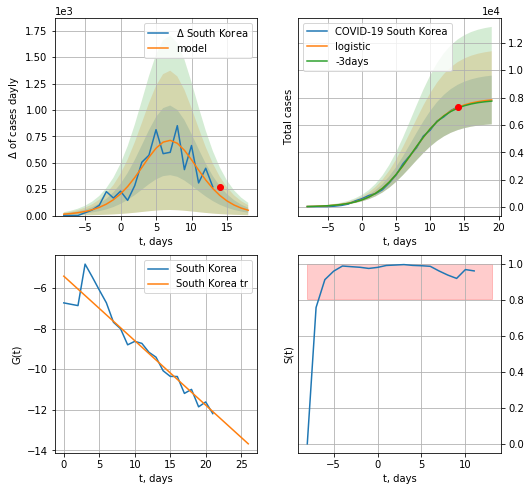

South Korea data at: 2020-06-15
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +5 days
	 deltaDaycases:  50
	 total cases:  7821 ± 1780
	 total death:  178 ± 121
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


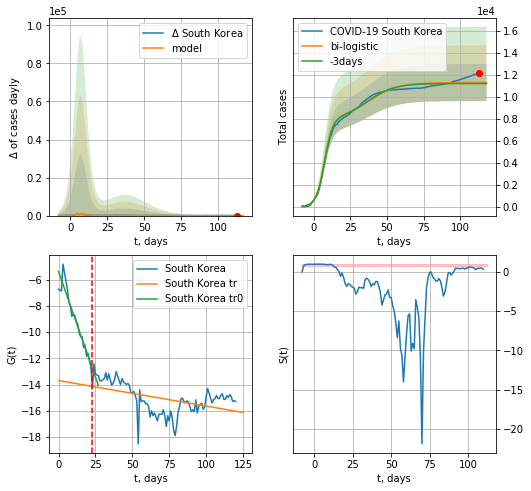

South Korea data at: 2020-06-15
+3 day model MAPE: 0.007859941360160655
model: bi-logistic
coeffs:  [3.37683442e+03 9.97028288e-02 3.75746293e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.14911751776483315
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  11316 ± 1687
	 total death:  258 ± 115
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.225696
 intercept: -13.693284
 slope: -0.019415


In [152]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*12-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,12*7-dT,x,1.0,vL=23)

In [153]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

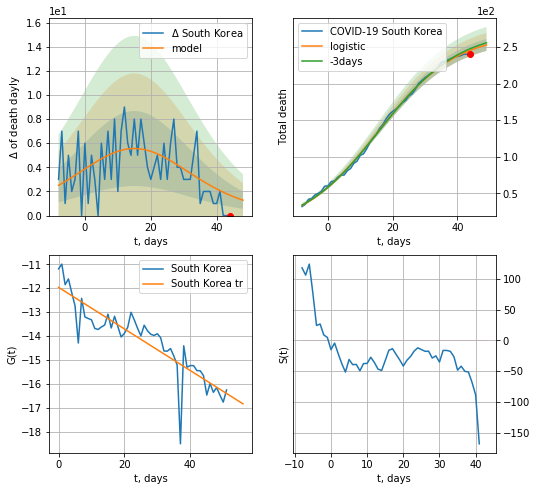

South Korea data at: 2020-06-15
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +5 days
	 total death:  252 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


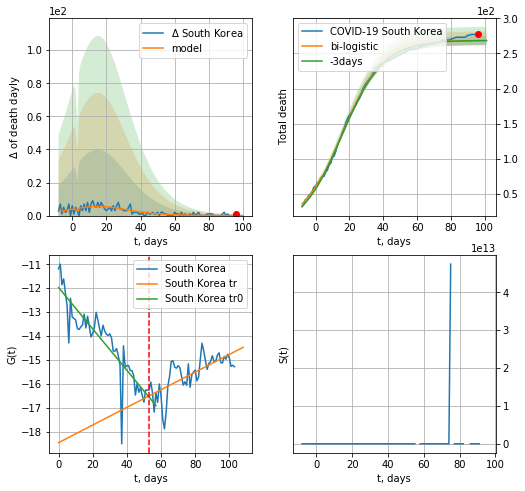

South Korea data at: 2020-06-15
+3 day model MAPE: 0.0
model: bi-logistic
coeffs:  [ 1.99732668 -4.03926095  3.3824321 ] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.02416841576954069
forecast at the end of period: +5 days
	 deltaDaydeath:  0
	 total death:  268 ± 6
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.507539
 intercept: -18.460373
 slope: 0.036887


In [154]:
x = forecast('South Korea',dfKR[17:70],d1,12*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,12*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


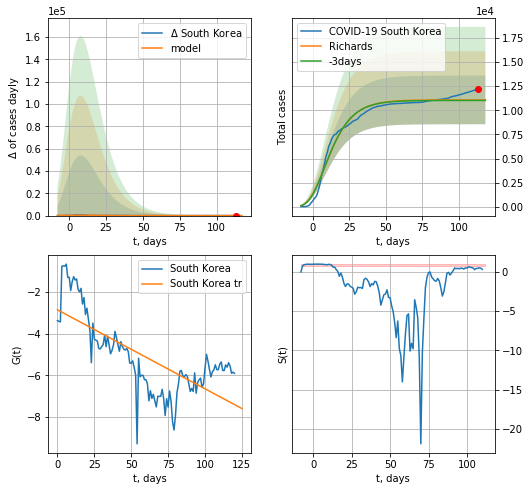

South Korea data at: 2020-06-15
+3 day model MAPE: 0.005140
model: Richards
coeffs: [ 1.10725895e+04  3.01047773e+01 -5.36410337e+01  3.10413928e-03]
rational stdev: 0.227402
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 11072 ± 2517
	 total death: 253 ± 172
trend coefficient of determination: 0.515783
 intercept: -2.860993
 slope: -0.037847


In [155]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


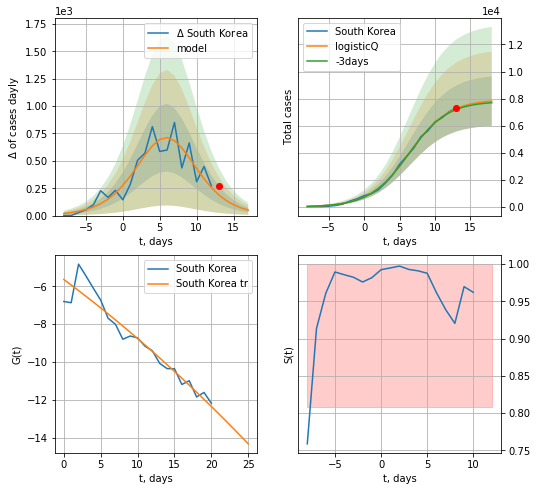

South Korea data at: 2020-06-15
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +5 days
	 deltaDaycases: 50
	 total cases: 7818 ± 1825
	 total death: 178 ± 124
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


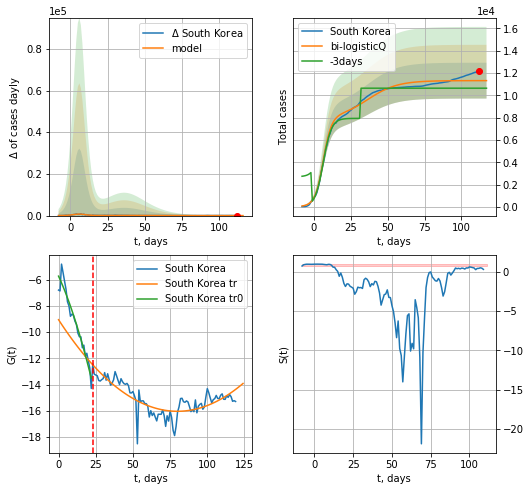

South Korea data at: 2020-06-15
+3 day model MAPE: 0.063594
model: bi-logisticQ
coeffs: [ 3.38146366e+03  1.21293293e-07  3.65444229e+01 -8.21638975e+05]
rational stdev: 0.141795
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 11316 ± 1604
	 total death: 258 ± 109
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.658180
 intercept_: -9.058698730695555
 coeffs_: [ 0.         -0.17447279  0.00109127]


In [156]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,12*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,12*7-dT,x,1.0,vL=vL)

In [157]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


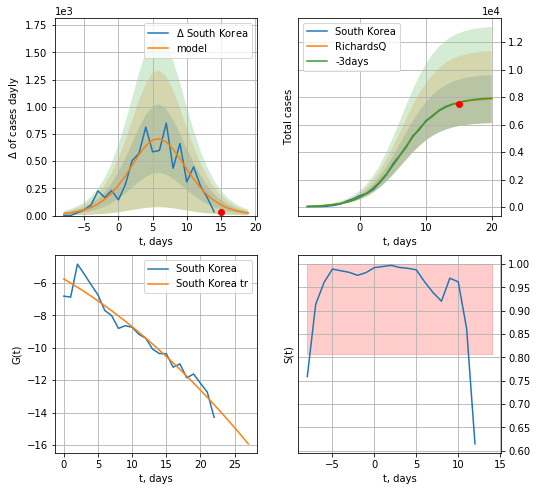

South Korea data at: 2020-06-15
+3 day model MAPE: 0.006079
model: RichardsQ
coeffs: [ 7.90607495e+03  3.14377481e-03 -1.32150046e+02  5.22462480e+00
  7.59593205e-01]
rational stdev: 0.222738
forecast at the end of period: +5 days
	 deltaDaycases: 23
	 total cases: 7857 ± 1750
	 total death: 179 ± 119
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:446: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:446: RuntimeWarning: overflow encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


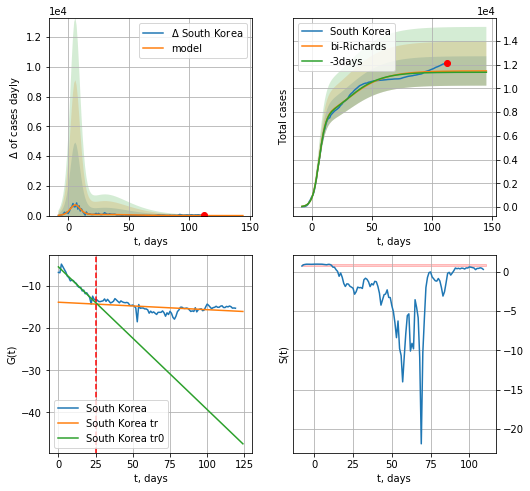

South Korea data at: 2020-06-15
+3 day model MAPE: 0.008806
model: bi-Richards
coeffs: [ 3.57309614e+03  1.10577917e-01 -1.22260345e+02 -2.26503852e+03
  2.16796715e-04]
rational stdev: 0.107948
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 11475 ± 1238
	 total death: 262 ± 84
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936460
 intercept: -5.478818
 slope: -0.338423
trend coefficient of determination: 0.186863
 intercept: -13.864688
 slope: -0.017678


In [158]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,12*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


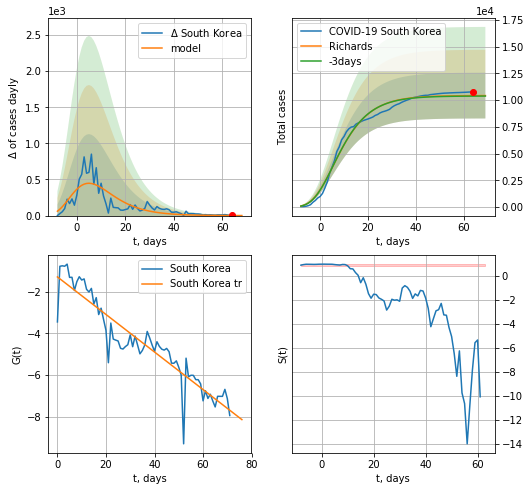

South Korea data at: 2020-06-15
+3 day model MAPE: 0.004451
model: Richards
coeffs: [ 1.04318163e+04  3.06447185e+01 -4.21690973e+01  3.81700530e-03]
rational stdev: 0.205493
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 10425 ± 2142
	 total death: 238 ± 146
trend coefficient of determination: 0.863609
 intercept: -1.289365
 slope: -0.090003


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


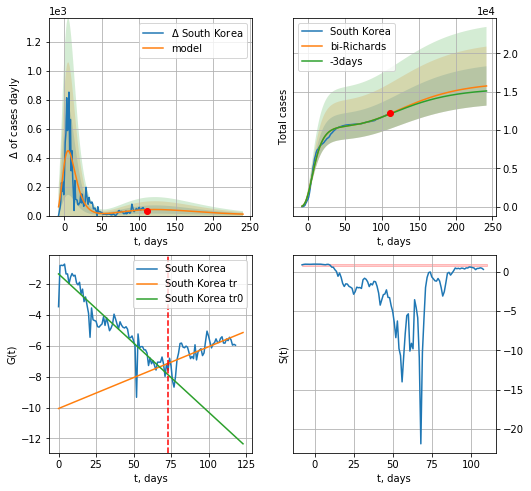

South Korea data at: 2020-06-15
+3 day model MAPE: 0.003320
model: bi-Richards
coeffs: [ 5.84202464e+03  2.25632146e+00 -1.19735851e+02  8.68763547e-03]
rational stdev: 0.162845
forecast at the end of period: +131 days
	 deltaDaycases: 10
	 total cases: 15740 ± 2563
	 total death: 359 ± 175
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.865759
 intercept: -1.341133
 slope: -0.089486
trend coefficient of determination: 0.489860
 intercept: -10.060097
 slope: 0.040009


In [159]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,12*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,30*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [160]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


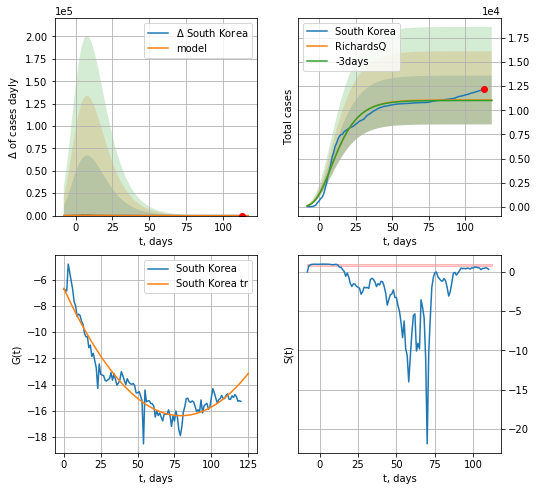

South Korea data at: 2020-06-15
+3 day model MAPE: 0.005162
model: RichardsQ
coeffs: [ 1.10669085e+04  1.21374274e-01 -8.34433235e+01 -2.93363252e+03
  2.53186082e-04]
rational stdev: 0.227932
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 11066 ± 2522
	 total death: 253 ± 173
trend coefficient of determination: 0.909424
 intercept_: -6.675973963440645
 coeffs_: [ 0.         -0.24430959  0.00154005]


In [161]:
x = forecastQR('South Korea',dfKR[:],d1,12*7-dT,1.0)

SG
           date    cases  active  death
140 2020-06-11  39387.5   12076   25.0
141 2020-06-12  39850.0   11785   25.0
142 2020-06-13  40197.0   11363   26.0
143 2020-06-14  40604.0   10989   26.0
144 2020-06-15  40969.0   10577   26.0


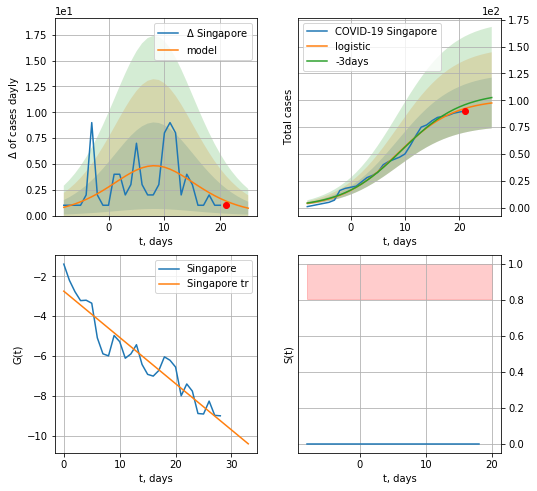

Singapore data at: 2020-06-15
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  97 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


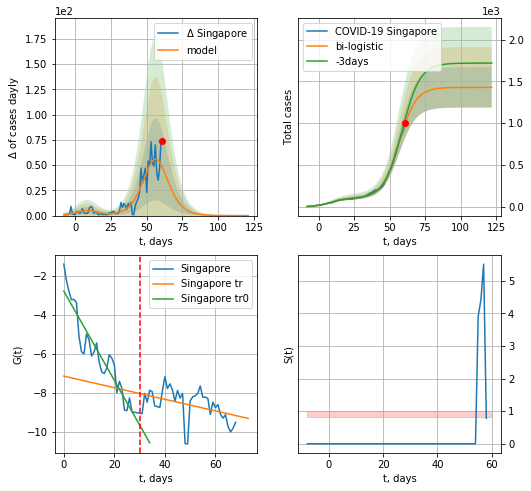

Singapore data at: 2020-06-15
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +61 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


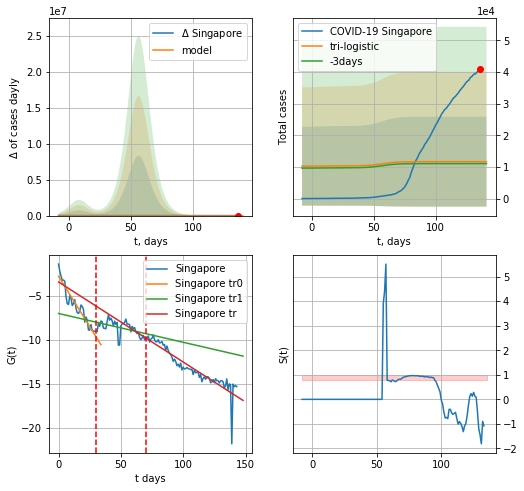

Singapore data at: 2020-06-15
+3 day model MAPE: 0.055303348705970354
model: tri-logistic
coeffs:  [ 1.02340985e+04 -7.11057112e+00  1.78800469e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  1.2172814964678722
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  11662 ± 14196
	 total death:  7 ± 25
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.835289
 intercept: -3.422014
 slope: -0.091148


In [162]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*12-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


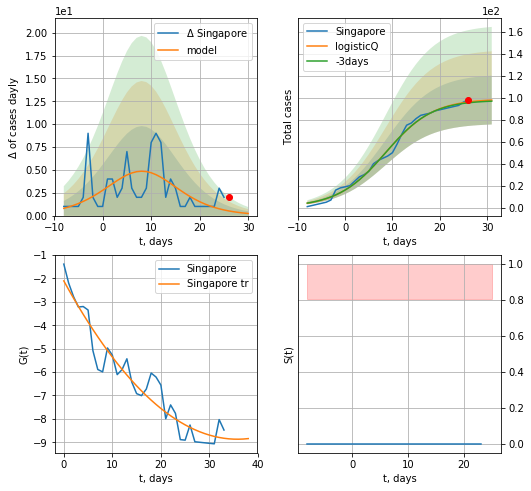

Singapore data at: 2020-06-15
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 97 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


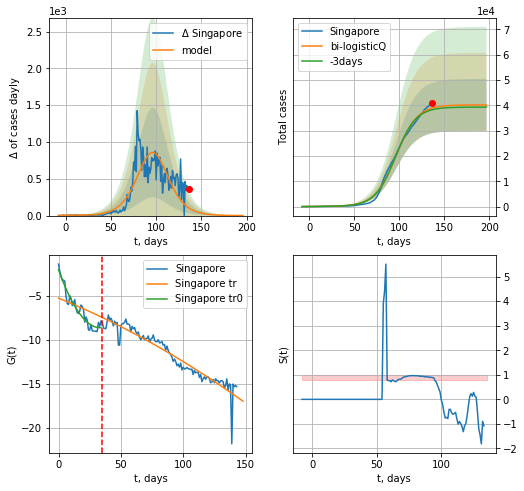

Singapore data at: 2020-06-15
+3 day model MAPE: 0.017545
model: bi-logisticQ
coeffs: [ 4.00509837e+04  4.39012675e-07  9.65699031e+01 -1.95115447e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.255595
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 40143 ± 10260
	 total death: 25 ± 19
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.906464
 intercept_: -5.260913724228764
 coeffs_: [ 0.         -0.05747732 -0.00014764]


In [163]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*12-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [164]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

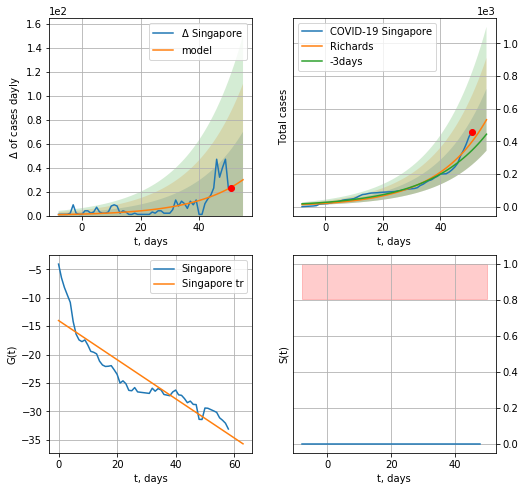

Singapore data at: 2020-06-15
+3 day model MAPE: 0.162175
model: Richards
coeffs: [9.30440928e+03 5.77261259e-02 1.05546035e+02 4.91744477e+00]
rational stdev: 0.355378
forecast at the end of period: +5 days
	 deltaDaycases: 29
	 total cases: 532 ± 189
	 total death: 0 ± 0
trend coefficient of determination: 0.813965
 intercept: -14.017324
 slope: -0.343928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


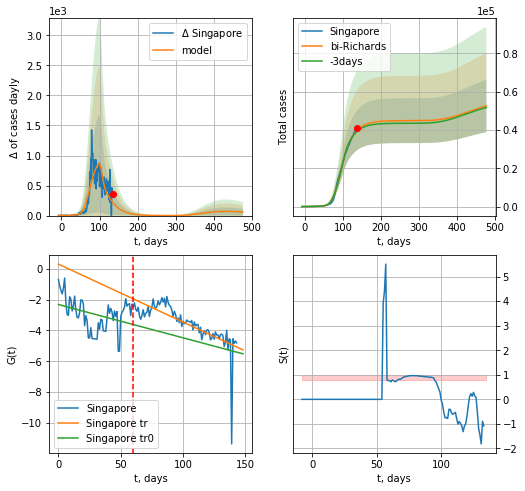

Singapore data at: 2020-06-15
+3 day model MAPE: 0.014368
model: bi-Richards
coeffs: [ 3.56013776e+04  5.76474591e+00 -1.88747387e+01  7.52446176e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.260739
forecast at the end of period: +341 days
	 deltaDaycases: 58
	 total cases: 52666 ± 13732
	 total death: 33 ± 25
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.125053
 intercept: -2.318156
 slope: -0.021592
trend coefficient of determination: 0.544652
 intercept: 0.304758
 slope: -0.037589


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


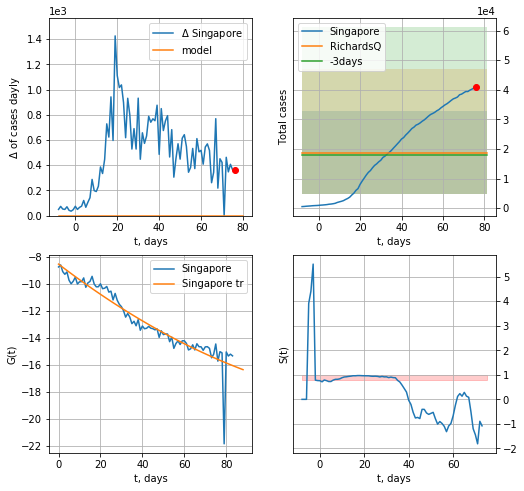

Singapore data at: 2020-06-15
+3 day model MAPE: 0.044405
model: RichardsQ
coeffs: [ 1.87730883e+04  1.45150130e+01 -3.16291218e+03  2.81123746e+03
 -5.97644507e+00]
rational stdev: 0.753594
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 18773 ± 14147
	 total death: 11 ± 24
trend coefficient of determination: 0.883949
 intercept_: -8.544928173051069
 coeffs_: [ 0.         -0.11858794  0.00033821]


In [165]:
vL = 60
x = forecastRR('Singapore',dfSG[:vL],d1,12*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[60:],d1,12*7-dT,1.0)

ES
          date   cases  active  death
91 2020-06-11  1965.5     199   69.0
92 2020-06-12  1970.0     198   69.0
93 2020-06-13  1973.0     199   69.0
94 2020-06-14  1973.0     199   69.0
95 2020-06-15  1975.0     178   69.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


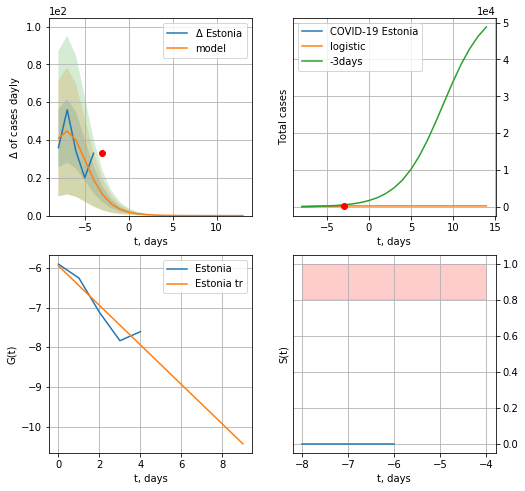

Estonia data at: 2020-06-15
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


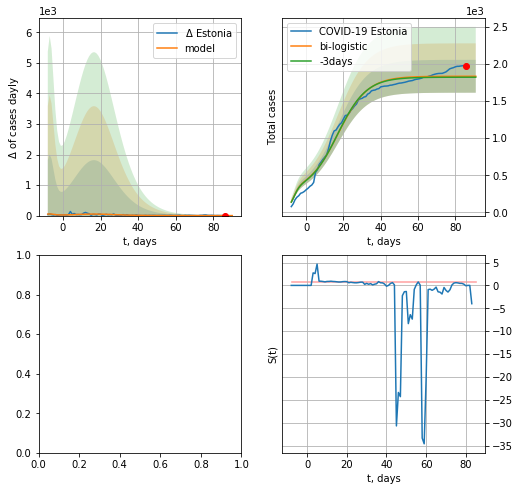

In [166]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,12*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

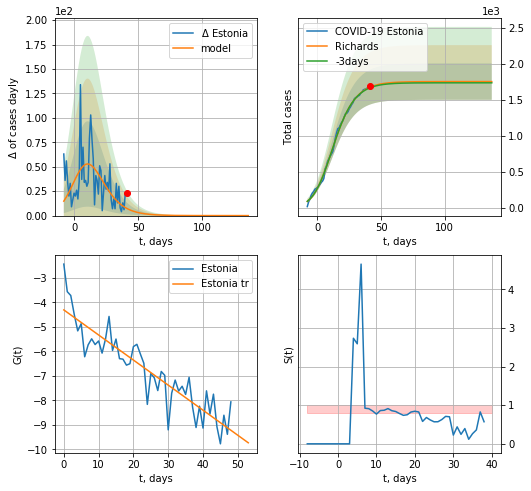

Estonia data at: 2020-06-15
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +96 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 61 ± 26
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

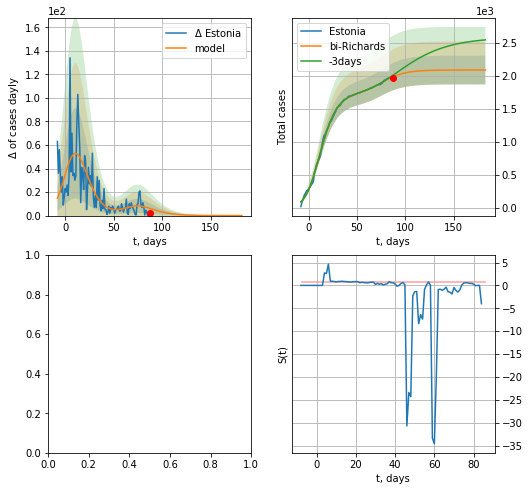

In [167]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*25-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


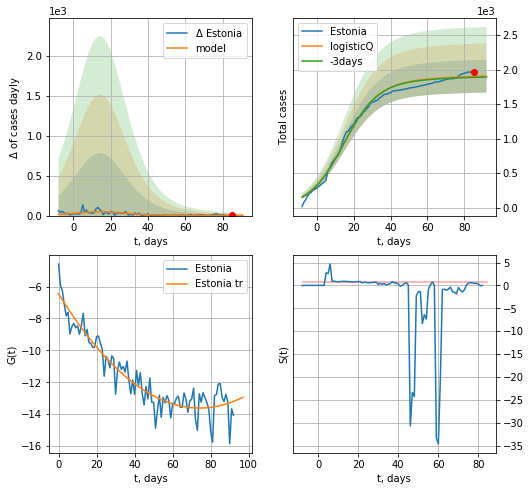

Estonia data at: 2020-06-13
+3 day model MAPE: 0.006513
model: logisticQ
coeffs: [ 1.83827172e+03  3.94566752e-07  1.46514981e+01 -2.68230535e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.124839
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1906 ± 237
	 total death: 66 ± 24
trend coefficient of determination: 0.878617
 intercept_: -6.4528260315886525
 coeffs_: [ 0.         -0.19320328  0.00130242]


In [166]:
x = forecastRRR('Estonia',dfES[:],d1,7*12-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
96  2020-06-11  1096.0     251   27.0
97  2020-06-12  1096.5     251   27.0
98  2020-06-13  1097.0     224   28.0
99  2020-06-14  1097.0     224   28.0
100 2020-06-15  1098.0     195   28.0


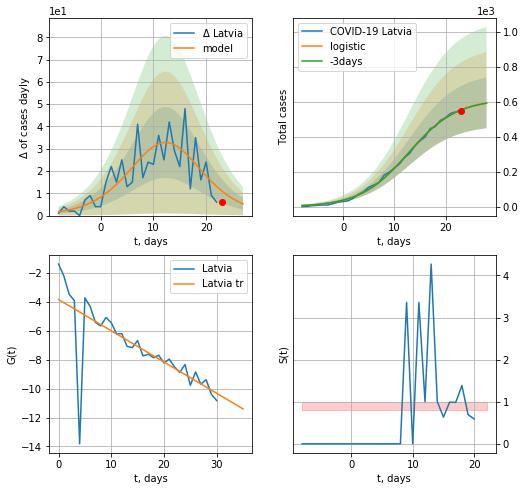

Latvia data at: 2020-06-15
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  593 ± 144
	 total death:  15 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


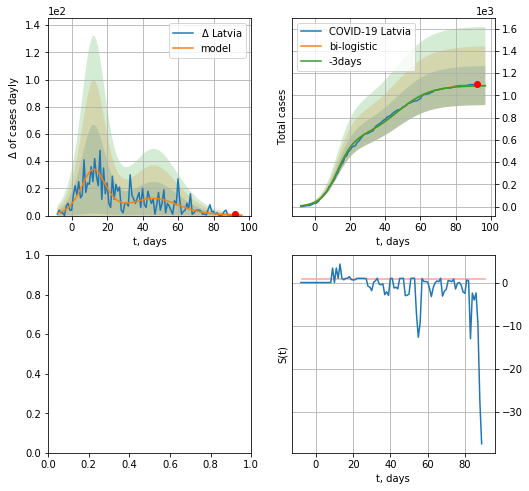

In [168]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,12*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,12*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


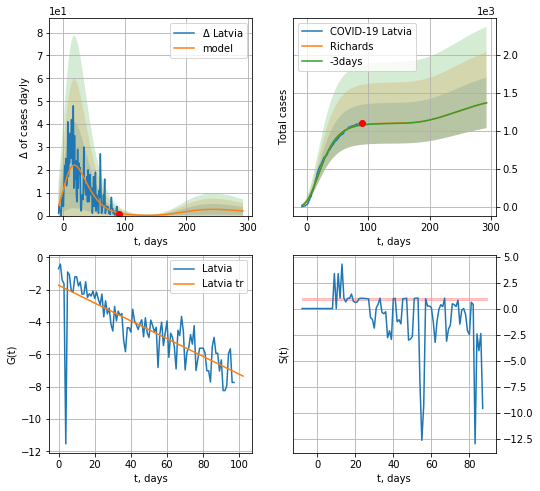

Latvia data at: 2020-06-13
+3 day model MAPE: 0.003105
model: Richards
coeffs: [ 1.09923877e+03  9.78974694e+00 -7.68477653e+01  5.58518726e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.243669
forecast at the end of period: +203 days
	 deltaDaycases: 2
	 total cases: 1366 ± 333
	 total death: 34 ± 24
trend coefficient of determination: 0.602671
 intercept: -1.722873
 slope: -0.055052


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


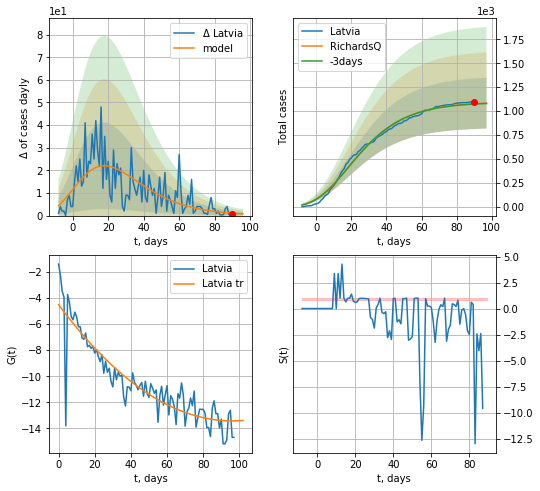

Latvia data at: 2020-06-13
+3 day model MAPE: 0.003272
model: RichardsQ
coeffs: [ 1.09556871e+03  3.20822164e-02 -1.23115196e+02 -2.23665875e+03
  7.10375694e-04]
rational stdev: 0.245370
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1082 ± 265
	 total death: 27 ± 19
trend coefficient of determination: 0.808910
 intercept_: -4.506495234706096
 coeffs_: [ 0.         -0.18603763  0.00096988]


In [169]:
x = forecastRR('Latvia',dfLV[:],d1,7*40-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*12-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


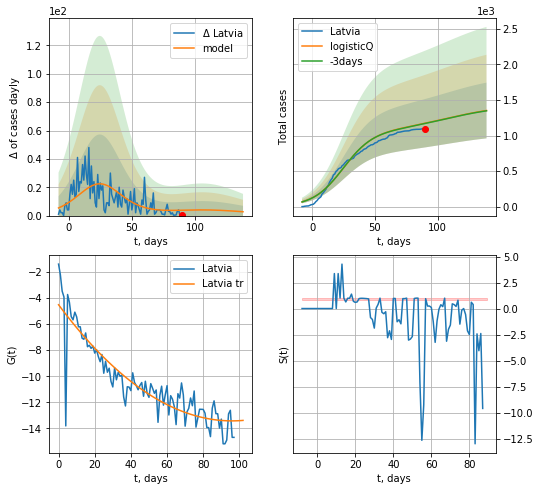

Latvia data at: 2020-06-13
+3 day model MAPE: 0.003554
model: logisticQ
coeffs: [ 1.05937560e+03  2.32947529e-07  2.48744635e+01 -3.56306225e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.289742
forecast at the end of period: +49 days
	 deltaDaycases: 2
	 total cases: 1352 ± 391
	 total death: 34 ± 29
trend coefficient of determination: 0.808910
 intercept_: -4.506495234706096
 coeffs_: [ 0.         -0.18603763  0.00096988]


In [170]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


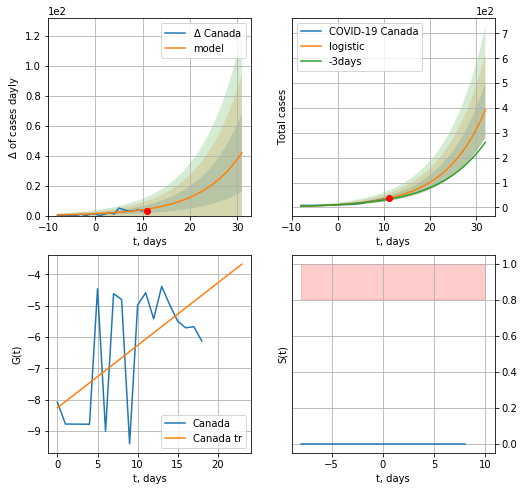

Canada data at: 2020-06-15
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  32 ± 27
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


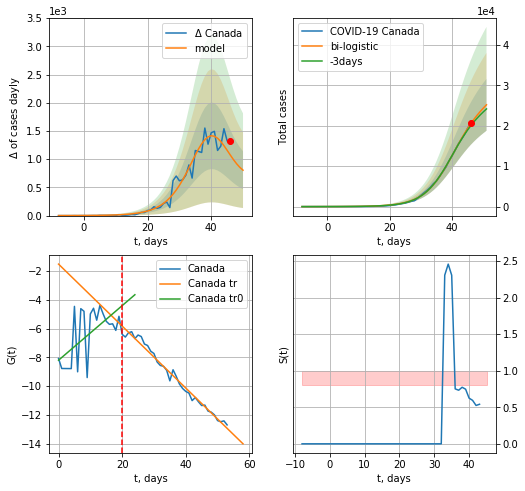

Canada data at: 2020-06-15
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +5 days
	 deltaDaycases:  805
	 total cases:  25178 ± 6418
	 total death:  2076 ± 1587
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:305: RuntimeWarning: overflow encountered in exp


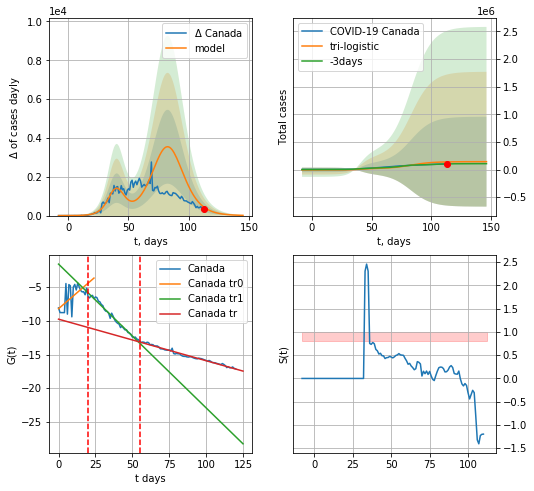

Canada data at: 2020-06-15
+3 day model MAPE: 0.3528174261495728
model: tri-logistic
coeffs:  [-7.31359406e+03 -3.08602048e+00  2.66079390e+02] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  5.732888946668574
forecast at the end of period: +33 days
	 deltaDaycases:  11
	 total cases:  141943 ± 813745
	 total death:  11703 ± 201275
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.984216
 intercept: -9.750241
 slope: -0.061703


In [169]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,12*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date    cases  active   death
117 2020-06-11  97530.0   31878  7994.0
118 2020-06-12  97943.0   31371  8049.0
119 2020-06-13  98410.0   30949  8107.0
120 2020-06-14  98787.0   30369  8146.0
121 2020-06-15  99147.0   29930  8175.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


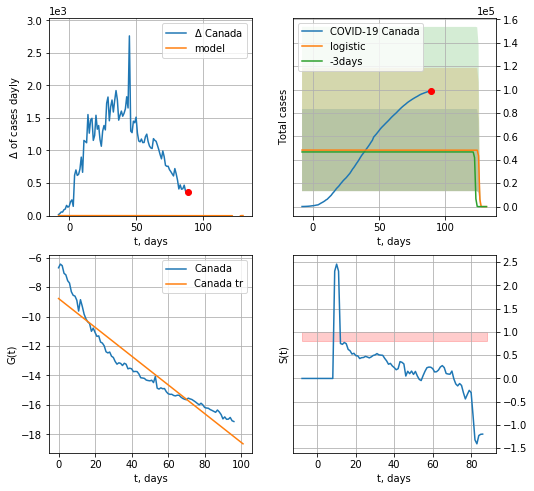

Canada data at: 2020-06-15
+3 day model MAPE: 0.03410564799232818
model: logistic
coeffs:  [ 4.83181837e+04 -4.07746586e+00  1.25535103e+02]
rational stdev:  0.7263339506147238
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.903102
 intercept: -8.779548
 slope: -0.097578


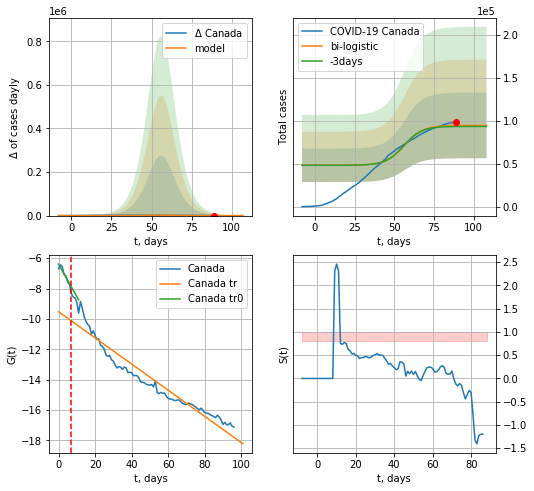

Canada data at: 2020-06-15
+3 day model MAPE: 0.012494723779178494
model: bi-logistic
coeffs:  [4.64729225e+04 1.71557681e-01 5.64412982e+01] [ 4.83181837e+04 -4.07746586e+00  1.25535103e+02]
rational stdev:  0.4039584937397636
forecast at the end of period: +19 days
	 deltaDaycases:  1
	 total cases:  94784 ± 38288
	 total death:  7815 ± 9470
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.922603
 intercept: -9.527503
 slope: -0.086132


In [170]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31-24,cases='cases')

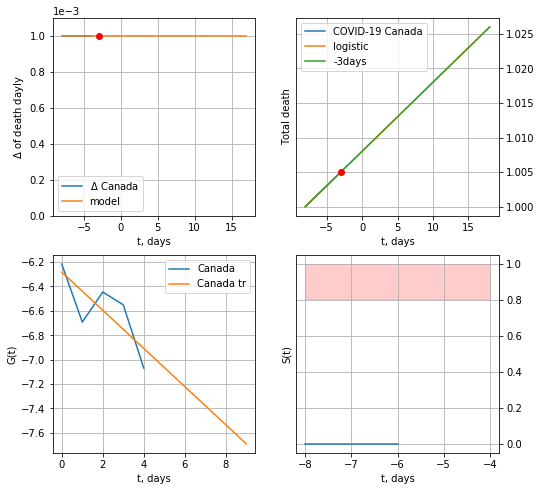

Canada data at: 2020-06-15
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


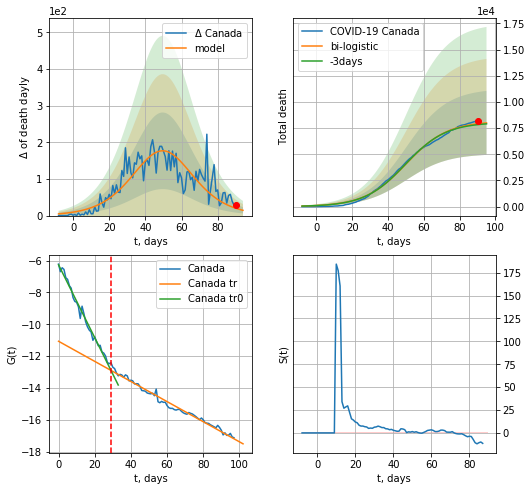

Canada data at: 2020-06-15
+3 day model MAPE: 0.01091807762846586
model: bi-logistic
coeffs:  [8.16052147e+03 8.66800188e-02 5.00654410e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.38223722594298076
forecast at the end of period: +5 days
	 deltaDaydeath:  14
	 total death:  7998 ± 3057
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.982992
 intercept: -11.061993
 slope: -0.063137


In [171]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,12*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


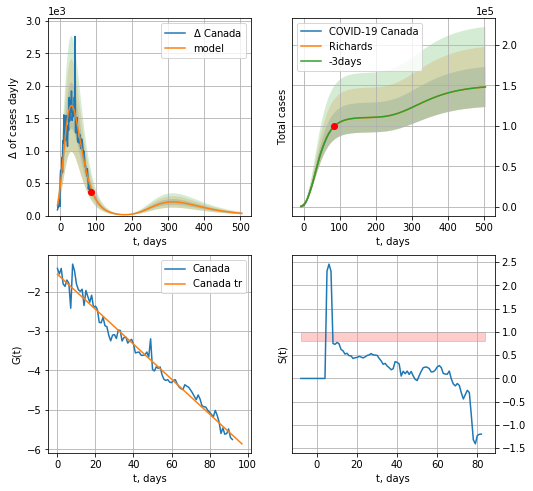

Canada data at: 2020-06-15
+3 day model MAPE: 0.000433
model: Richards
coeffs: [ 1.10288389e+05  3.63227699e+00 -7.47541059e+01  1.15789759e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.167290
forecast at the end of period: +420 days
	 deltaDaycases: 34
	 total cases: 147813 ± 24727
	 total death: 12187 ± 6116
trend coefficient of determination: 0.977409
 intercept: -1.561157
 slope: -0.044326


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


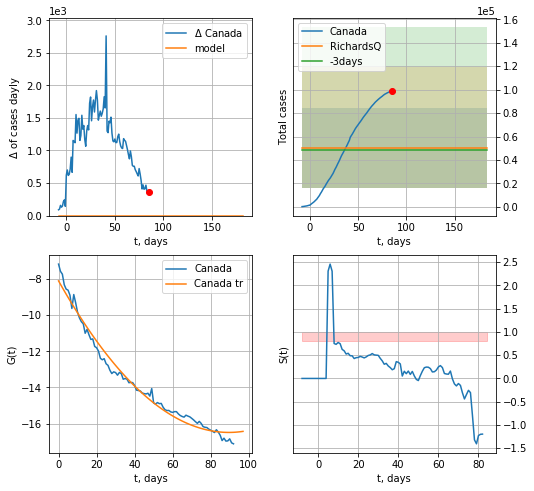

Canada data at: 2020-06-15
+3 day model MAPE: 0.032724
model: RichardsQ
coeffs: [ 5.03684788e+04 -1.47785338e+00 -7.89597453e+01 -4.41234664e+01
 -7.19876059e-02]
rational stdev: 0.682311
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 50368 ± 34366
	 total death: 4153 ± 8500
trend coefficient of determination: 0.981017
 intercept_: -8.104567621624762
 coeffs_: [ 0.         -0.18732467  0.00104591]


In [172]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


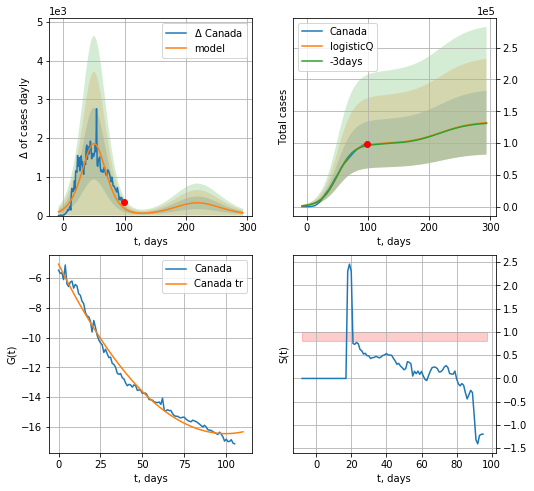

Canada data at: 2020-06-15
+3 day model MAPE: 0.007517
model: logisticQ
coeffs: [ 9.89470786e+04  4.35412242e-07  5.02204492e+01 -1.72225953e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.380257
forecast at the end of period: +196 days
	 deltaDaycases: 70
	 total cases: 132045 ± 50211
	 total death: 10887 ± 12419
trend coefficient of determination: 0.987449
 intercept_: -5.082805461977225
 coeffs_: [ 0.         -0.2279175   0.00114352]


In [173]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
101 2020-06-11  35910   12404  1504.0
102 2020-06-12  36180   12475  1505.0
103 2020-06-13  36463   12513  1512.0
104 2020-06-14  36690   12504  1517.0
105 2020-06-15  37036   12664  1520.0


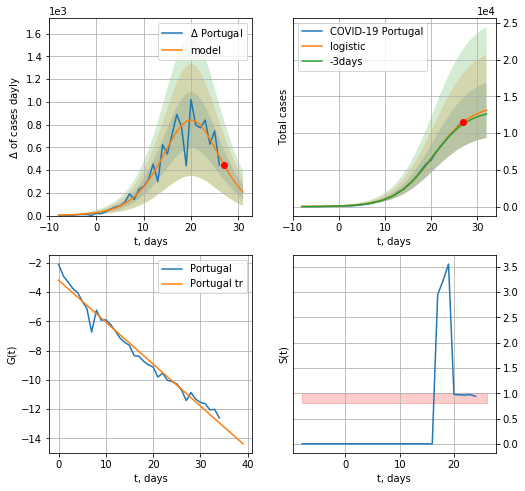

Portugal data at: 2020-06-15
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +5 days
	 deltaDaycases:  207
	 total cases:  13124 ± 3780
	 total death:  538 ± 464
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


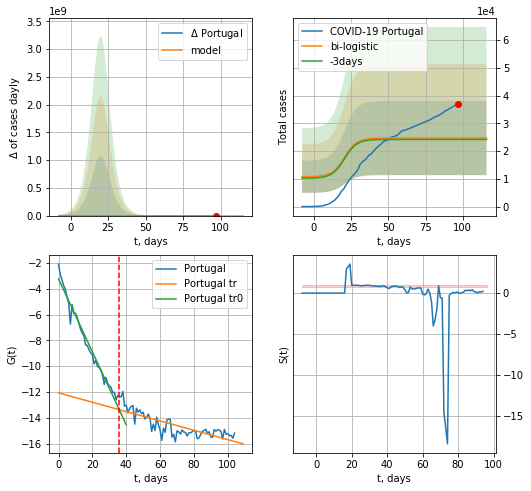

Portugal data at: 2020-06-15
+3 day model MAPE: 0.02132037885314587
model: bi-logistic
coeffs:  [8615.98364865  -26.01794837  541.97617894] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5401916438658959
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  24713 ± 13350
	 total death:  1014 ± 1643
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.630313
 intercept: -12.073100
 slope: -0.036245


In [174]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,12*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


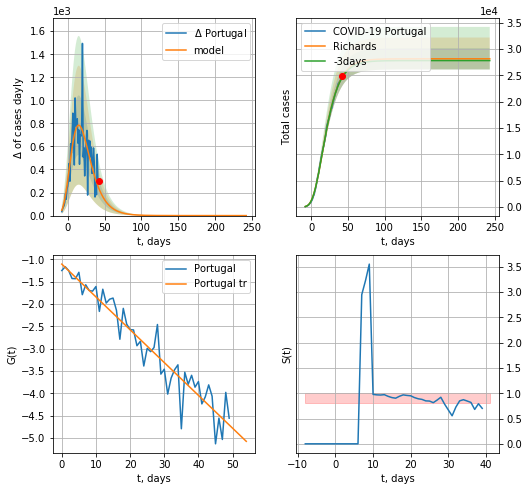

Portugal data at: 2020-06-15
+3 day model MAPE: 0.006186
model: Richards
coeffs: [ 2.81616178e+04  5.39214197e+00 -4.03941749e+01  1.41510332e-02]
rational stdev: 0.071740
forecast at the end of period: +201 days
	 deltaDaycases: 0
	 total cases: 28161 ± 2020
	 total death: 1155 ± 248
trend coefficient of determination: 0.913504
 intercept: -1.105984
 slope: -0.073555


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


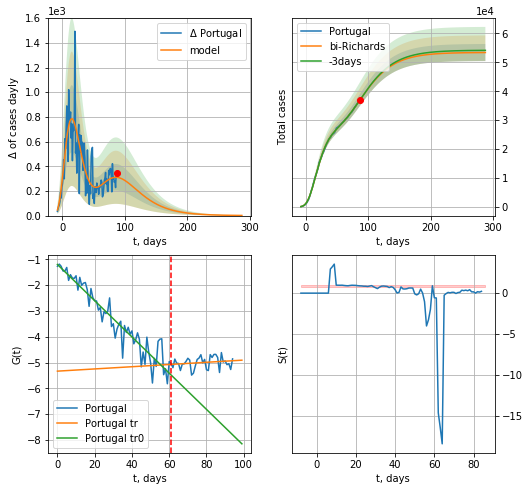

Portugal data at: 2020-06-15
+3 day model MAPE: 0.000996
model: bi-Richards
coeffs: [ 2.52655324e+04  1.85675937e+00 -3.52246694e+01  1.76226168e-02]
rational stdev: 0.055337
forecast at the end of period: +201 days
	 deltaDaycases: 1
	 total cases: 53390 ± 2954
	 total death: 2191 ± 363
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.904351
 intercept: -1.196336
 slope: -0.070265
trend coefficient of determination: 0.034869
 intercept: -5.334213
 slope: 0.004294


In [175]:
vL=61+10
x = forecastRR('Portugal',dfPT[10:vL-10],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[10:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


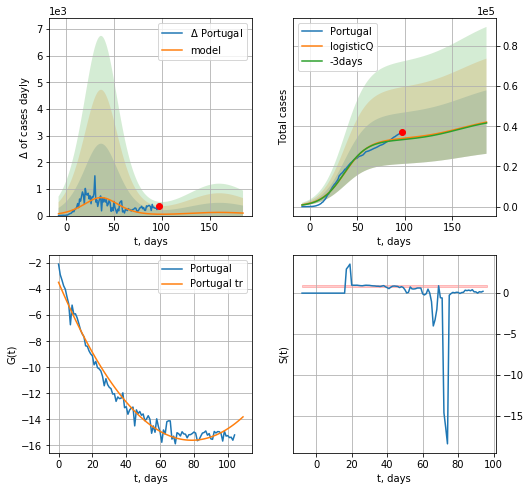

Portugal data at: 2020-06-15
+3 day model MAPE: 0.019057
model: logisticQ
coeffs: [ 3.33778152e+04  2.12539054e-07  3.68638087e+01 -3.79424032e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.375275
forecast at the end of period: +89 days
	 deltaDaycases: 94
	 total cases: 42083 ± 15792
	 total death: 1727 ± 1944
trend coefficient of determination: 0.977806
 intercept_: -3.479078119823779
 coeffs_: [ 0.         -0.30791182  0.00195591]


In [176]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

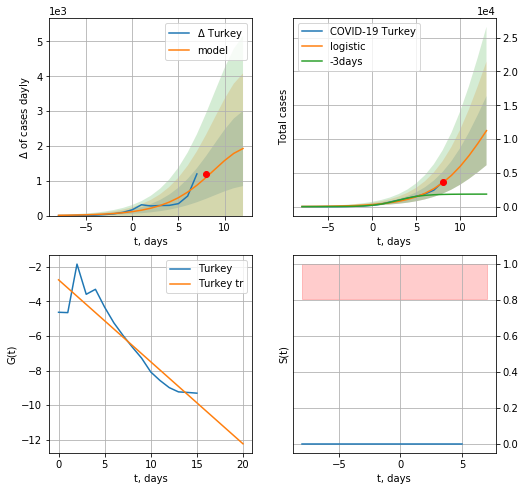

Turkey data at: 2020-06-15
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +5 days
	 deltaDaycases:  1924
	 total cases:  11240 ± 5116
	 total death:  301 ± 411
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


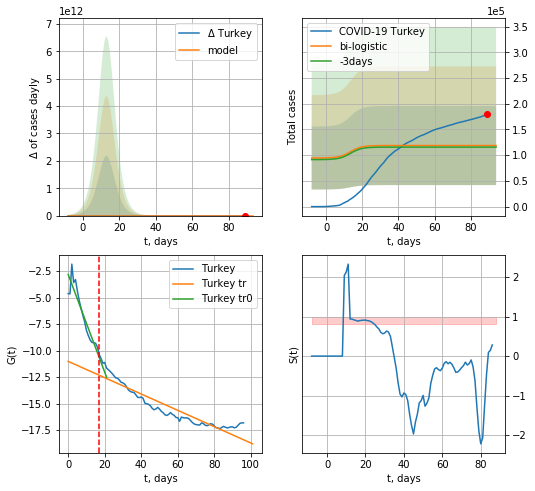

Turkey data at: 2020-06-15
+3 day model MAPE: 0.02676392692005193
model: bi-logistic
coeffs:  [ 7.55749874e+04 -3.41362505e+00  1.02340766e+02] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6475200310143212
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  118735 ± 76883
	 total death:  3185 ± 6187
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.861286
 intercept: -11.019393
 slope: -0.077084


In [177]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*12-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,12*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


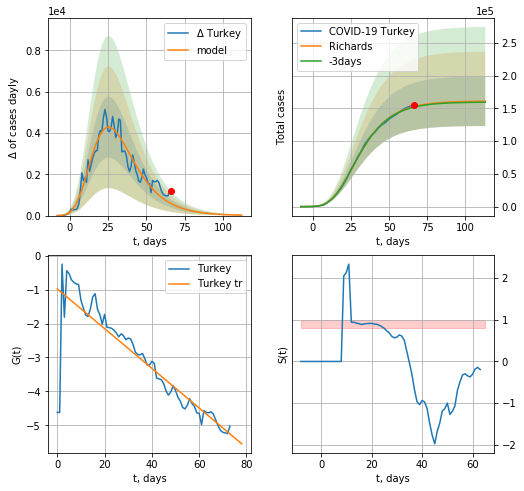

Turkey data at: 2020-06-15
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234317e+05  5.77708690e+00 -3.44331101e+01  1.25674474e-02]
rational stdev: 0.235071
forecast at the end of period: +47 days
	 deltaDaycases: 21
	 total cases: 160946 ± 37833
	 total death: 4318 ± 3045
trend coefficient of determination: 0.775257
 intercept: -0.978832
 slope: -0.058549


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


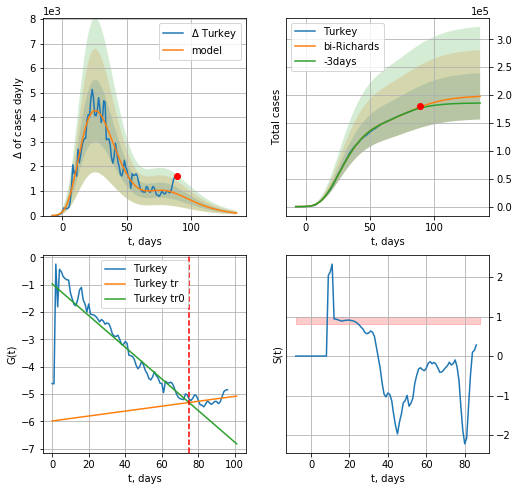

Turkey data at: 2020-06-15
+3 day model MAPE: 0.012731
model: bi-Richards
coeffs: [3.81801682e+04 6.08583114e+00 2.85985187e+00 9.52585894e-03]
rational stdev: 0.209925
forecast at the end of period: +47 days
	 deltaDaycases: 105
	 total cases: 197619 ± 41485
	 total death: 5302 ± 3339
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.777133
 intercept: -0.967769
 slope: -0.057954
trend coefficient of determination: 0.106910
 intercept: -5.983839
 slope: 0.009009


In [178]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


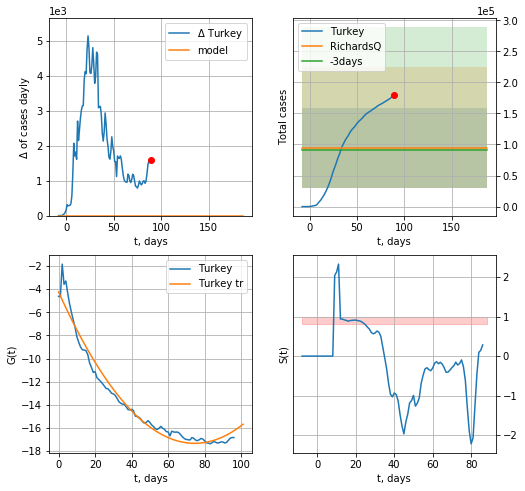

Turkey data at: 2020-06-15
+3 day model MAPE: 0.028855
model: RichardsQ
coeffs: [ 9.44055005e+04  2.85506874e+00 -9.32561952e+02  7.77409600e+02
 -1.59743899e+00]
rational stdev: 0.688072
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 94405 ± 64957
	 total death: 2532 ± 5226
trend coefficient of determination: 0.970230
 intercept_: -4.23747634676913
 coeffs_: [ 0.         -0.3511738   0.00235557]


In [179]:
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


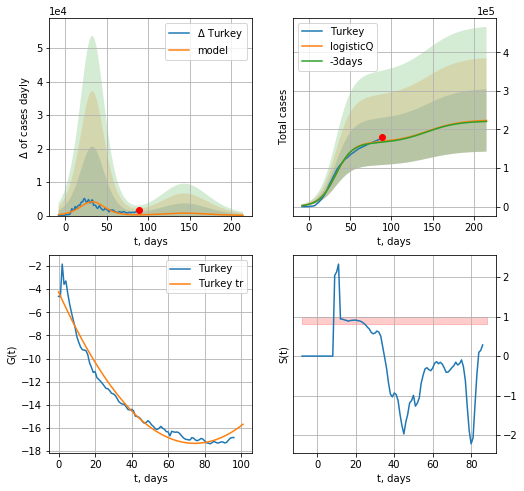

Turkey data at: 2020-06-15
+3 day model MAPE: 0.012335
model: logisticQ
coeffs: [ 1.66167253e+05  2.87634097e-07  3.30072755e+01 -3.44486089e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361849
forecast at the end of period: +126 days
	 deltaDaycases: 81
	 total cases: 223369 ± 80826
	 total death: 5993 ± 6505
trend coefficient of determination: 0.970230
 intercept_: -4.23747634676913
 coeffs_: [ 0.         -0.3511738   0.00235557]


In [180]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [181]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.025500910746812388

In [182]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

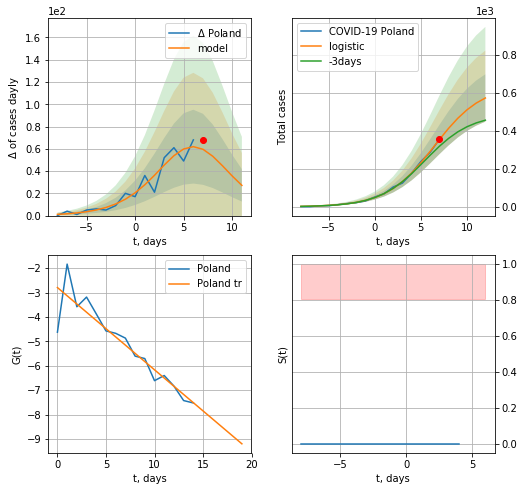

Poland data at: 2020-06-15
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +5 days
	 deltaDaycases:  27
	 total cases:  573 ± 124
	 total death:  24 ± 15
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


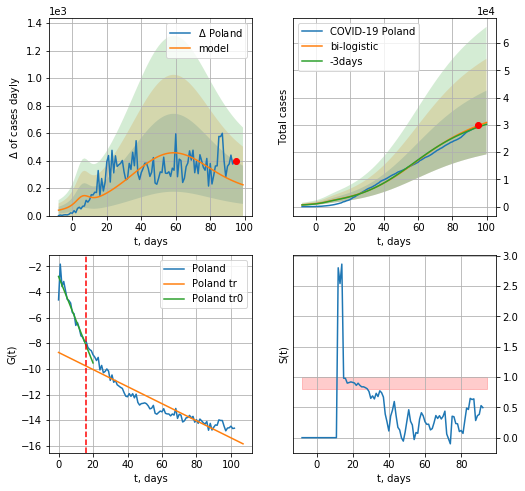

Poland data at: 2020-06-15
+3 day model MAPE: 0.019399822157451167
model: bi-logistic
coeffs:  [3.05939216e+04 5.78468819e-02 5.81548428e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3788867471399104
forecast at the end of period: +5 days
	 deltaDaycases:  223
	 total cases:  30881 ± 11700
	 total death:  1302 ± 1479
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.863500
 intercept: -8.719814
 slope: -0.066548


In [183]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*12-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


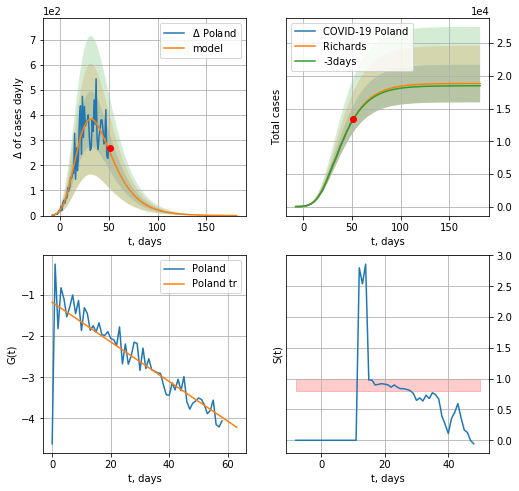

Poland data at: 2020-06-15
+3 day model MAPE: 0.005819
model: Richards
coeffs: [ 1.88418055e+04  3.45583442e+00 -4.15713344e+01  1.61921023e-02]
rational stdev: 0.153201
forecast at the end of period: +131 days
	 deltaDaycases: 0
	 total cases: 18837 ± 2885
	 total death: 794 ± 364
trend coefficient of determination: 0.708781
 intercept: -1.177313
 slope: -0.048172


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


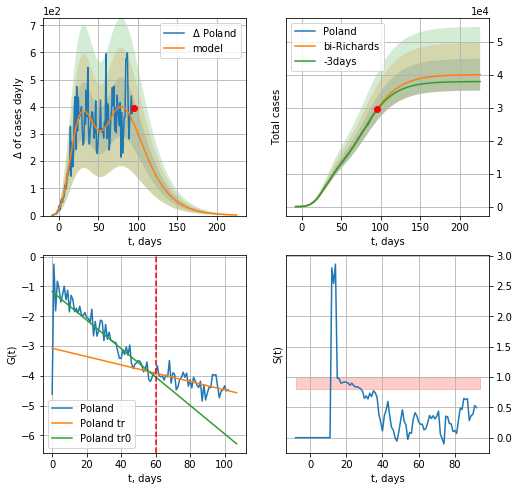

Poland data at: 2020-06-15
+3 day model MAPE: 0.009478
model: bi-Richards
coeffs: [ 2.13116238e+04  3.08013639e+00 -1.26155007e+01  1.41910308e-02]
rational stdev: 0.120664
forecast at the end of period: +131 days
	 deltaDaycases: 1
	 total cases: 40108 ± 4839
	 total death: 1691 ± 612
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.714807
 intercept: -1.173511
 slope: -0.047753
trend coefficient of determination: 0.363380
 intercept: -3.073645
 slope: -0.013965


In [184]:
vL = 60
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


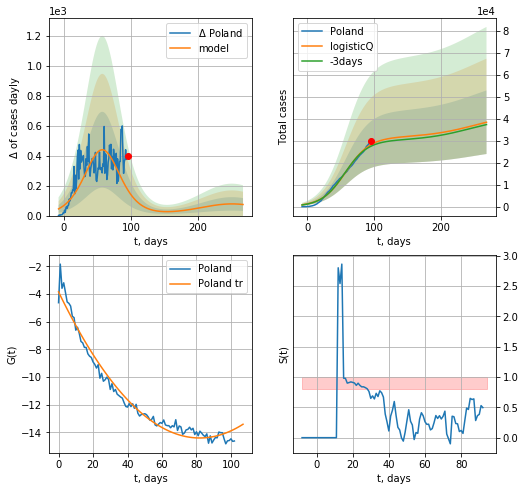

Poland data at: 2020-06-15
+3 day model MAPE: 0.026327
model: logisticQ
coeffs: [ 3.14929101e+04  3.16873056e-07  5.75890411e+01 -1.75663757e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.376536
forecast at the end of period: +173 days
	 deltaDaycases: 74
	 total cases: 38372 ± 14448
	 total death: 1617 ± 1826
trend coefficient of determination: 0.973166
 intercept_: -3.840532965175303
 coeffs_: [ 0.         -0.25798505  0.00157505]


In [185]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
110 2020-06-11  18701.0    3113  300.0
111 2020-06-12  18876.0    3257  300.0
112 2020-06-13  19008.0    3348  300.0
113 2020-06-14  19055.0    3380  300.0
114 2020-06-15  19338.0    3598  302.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


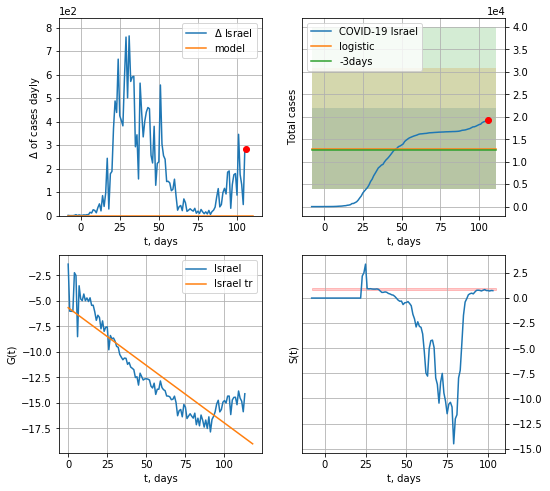

Israel data at: 2020-06-15
+3 day model MAPE: 0.023524062013591255
model: logistic
coeffs:  [ 1.02977310e+04 -4.55054330e+00  1.27885097e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7029386624500861
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  12872 ± 9048
	 total death:  201 ± 423
trend coefficient of determination: 0.800017
 intercept: -5.659891
 slope: -0.113080


In [186]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


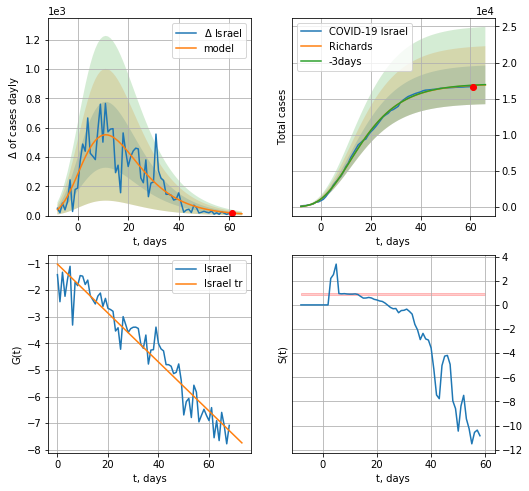

Israel data at: 2020-06-15
+3 day model MAPE: 0.001944
model: Richards
coeffs: [ 1.70515699e+04  6.43111297e+00 -3.67763089e+01  1.37701544e-02]
rational stdev: 0.158199
forecast at the end of period: +5 days
	 deltaDaycases: 12
	 total cases: 16914 ± 2675
	 total death: 264 ± 125
trend coefficient of determination: 0.925544
 intercept: -1.027514
 slope: -0.091953


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


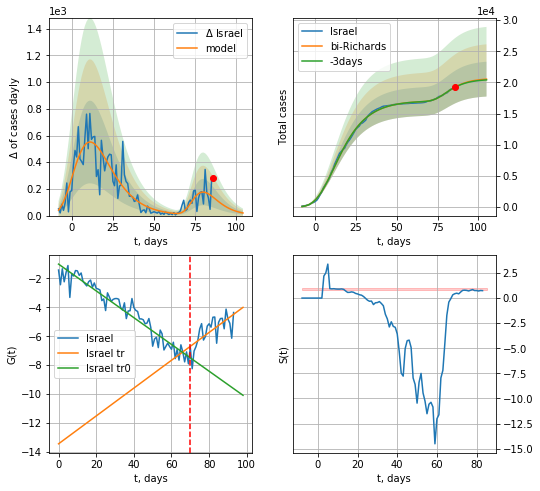

Israel data at: 2020-06-15
+3 day model MAPE: 0.001684
model: bi-Richards
coeffs: [3.61702324e+03 9.64444547e+00 4.74100526e+01 1.35584736e-02]
rational stdev: 0.136174
forecast at the end of period: +19 days
	 deltaDaycases: 19
	 total cases: 20523 ± 2794
	 total death: 320 ± 130
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.928399
 intercept: -1.011267
 slope: -0.092593
trend coefficient of determination: 0.476284
 intercept: -13.439724
 slope: 0.096296


In [187]:
x = forecastRR('Israel',dfIS[20:90],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


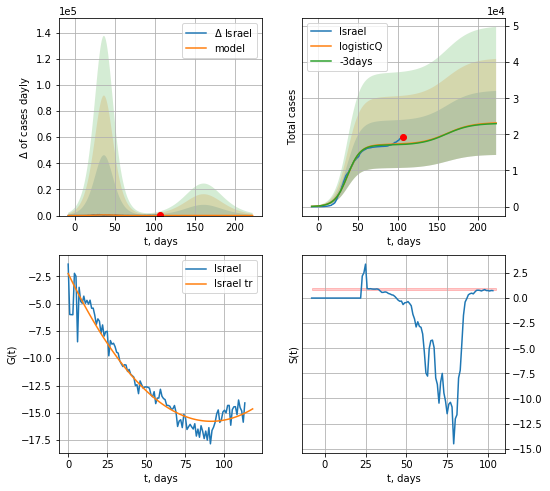

Israel data at: 2020-06-15
+3 day model MAPE: 0.009676
model: logisticQ
coeffs: [ 1.72041592e+04  4.27516220e-07  3.70251413e+01 -2.89856716e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.382615
forecast at the end of period: +117 days
	 deltaDaycases: 8
	 total cases: 23169 ± 8864
	 total death: 361 ± 414
trend coefficient of determination: 0.941591
 intercept_: -2.2512621740635677
 coeffs_: [ 0.         -0.29568978  0.00161604]


In [188]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


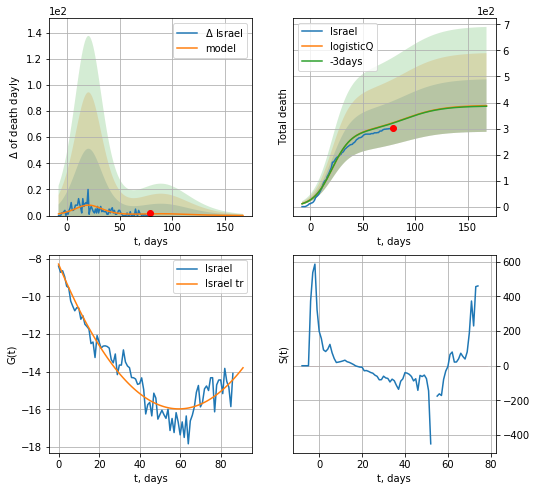

Israel data at: 2020-06-15
+3 day model MAPE: 0.003651
model: logisticQ
coeffs: [ 2.87795348e+02  4.18439526e-07  2.07317006e+01 -2.62279276e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.259085
forecast at the end of period: +89 days
	 total death: 388 ± 100
trend coefficient of determination: 0.914257
 intercept_: -8.27946725411657
 coeffs_: [ 0.         -0.25949257  0.00218572]


In [189]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


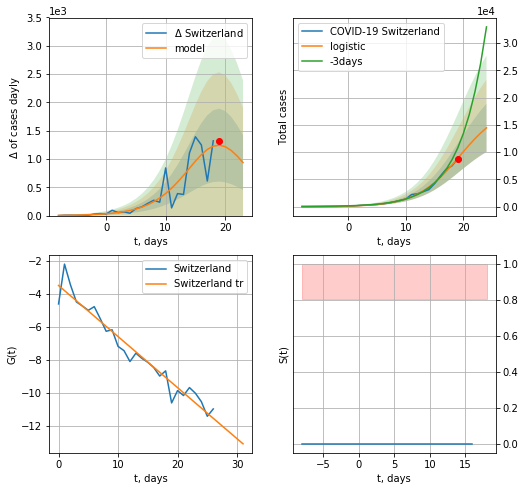

Switzerland data at: 2020-06-15
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +5 days
	 deltaDaycases:  936
	 total cases:  14462 ± 4426
	 total death:  900 ± 826
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


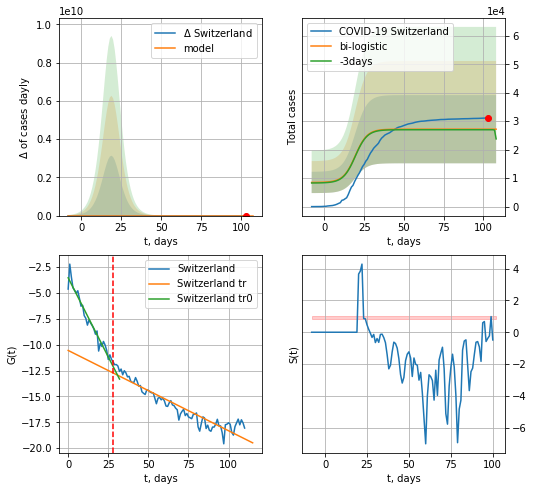

Switzerland data at: 2020-06-15
+3 day model MAPE: 0.007166177254325964
model: bi-logistic
coeffs:  [6785.12443468  -10.82263114  122.25302532] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.44037417983108434
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  27187 ± 11972
	 total death:  1693 ± 2236
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.887676
 intercept: -10.555702
 slope: -0.077606


In [190]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*12-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*12-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


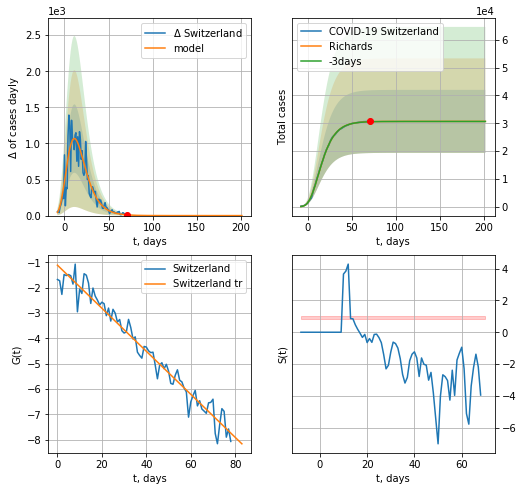

Switzerland data at: 2020-06-15
+3 day model MAPE: 0.000776
model: Richards
coeffs: [ 3.06754807e+04  7.58660005e+00 -3.42591676e+01  1.25593386e-02]
rational stdev: 0.369085
forecast at the end of period: +131 days
	 deltaDaycases: 0
	 total cases: 30675 ± 11321
	 total death: 1910 ± 2114
trend coefficient of determination: 0.961563
 intercept: -1.106763
 slope: -0.084972


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


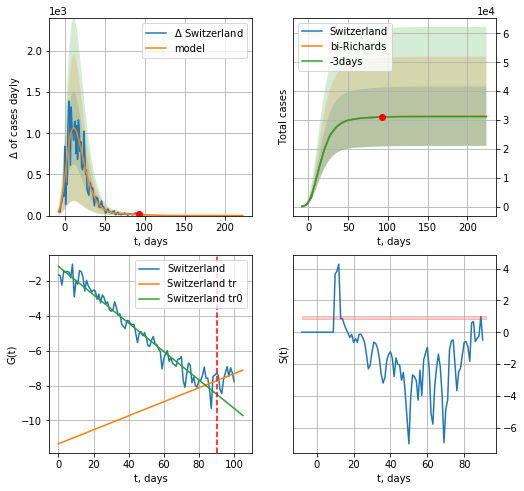

Switzerland data at: 2020-06-15
+3 day model MAPE: 0.001507
model: bi-Richards
coeffs: [ 6.80209345e+02  7.76920453e+00 -1.66409406e+01  6.76781974e-03]
rational stdev: 0.328269
forecast at the end of period: +131 days
	 deltaDaycases: 0
	 total cases: 31355 ± 10292
	 total death: 1952 ± 1922
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.959346
 intercept: -1.147567
 slope: -0.081641
trend coefficient of determination: 0.077774
 intercept: -11.349245
 slope: 0.040321


In [191]:
iL = 10
vL = 90 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


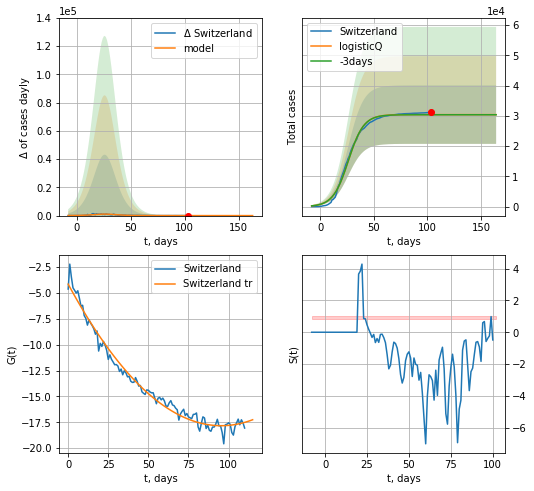

Switzerland data at: 2020-06-15
+3 day model MAPE: 0.001500
model: logisticQ
coeffs: [ 3.04137504e+04  5.76866221e-07  2.62501235e+01 -2.42186627e+05]
rational stdev: 0.317801
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 30413 ± 9665
	 total death: 1894 ± 1805
trend coefficient of determination: 0.981559
 intercept_: -4.150754948705979
 coeffs_: [ 0.         -0.28664973  0.00150208]


In [192]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [193]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
93 2020-06-11  29070.0   15316  870.0
94 2020-06-12  29753.0   15316  870.0
95 2020-06-13  30506.0   15650  880.0
96 2020-06-14  31154.0   16183  889.0
97 2020-06-15  32476.0   17036  912.0


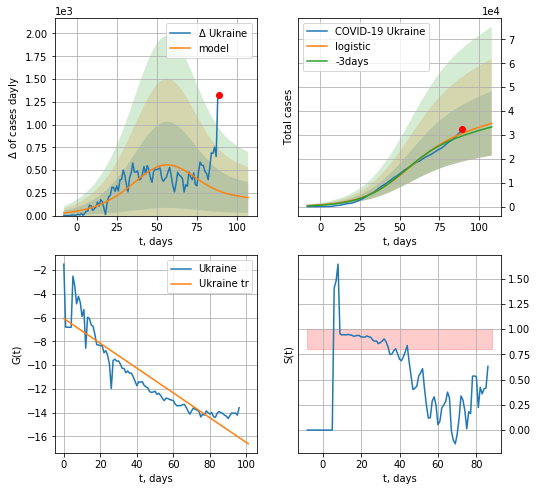

Ukraine data at: 2020-06-15
+3 day model MAPE: 0.03631476025715995
model: logistic
coeffs:  [3.23809459e+04 6.73295893e-02 5.62646681e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3860014799925394
forecast at the end of period: +19 days
	 deltaDaycases:  197
	 total cases:  34851 ± 13452
	 total death:  978 ± 1132
trend coefficient of determination: 0.842271
 intercept: -6.087543
 slope: -0.104390


In [194]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


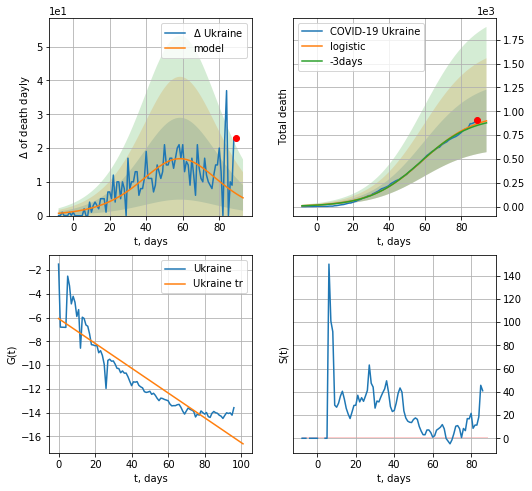

Ukraine data at: 2020-06-15
+3 day model MAPE: 0.020947384954798393
model: logistic
coeffs:  [9.80267581e+02 6.87441891e-02 5.90054271e+01]
rational stdev:  0.36529375606975945
forecast at the end of period: +5 days
	 total death:  899 ± 328
trend coefficient of determination: 0.842271
 intercept: -6.087543
 slope: -0.104390


In [195]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


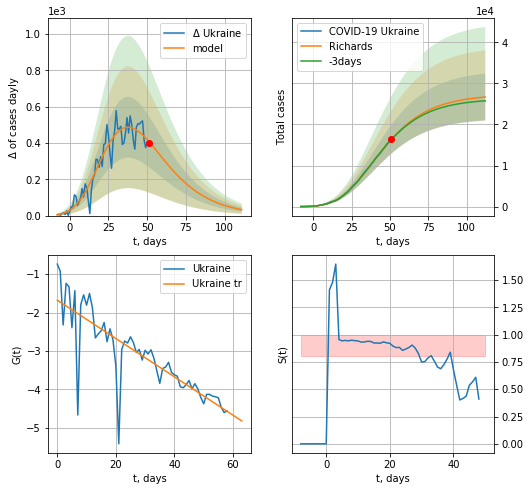

Ukraine data at: 2020-06-15
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152280e+04  5.78390520e-01 -1.00505543e+01  8.74755420e-02]
rational stdev: 0.213278
forecast at the end of period: +61 days
	 deltaDaycases: 32
	 total cases: 26673 ± 5688
	 total death: 749 ± 479
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


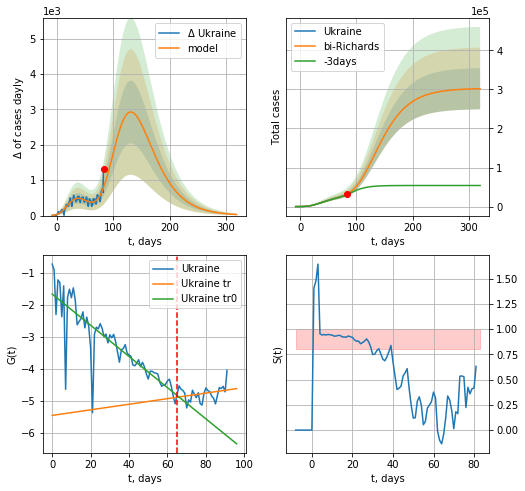

Ukraine data at: 2020-06-15
+3 day model MAPE: 0.024262
model: bi-Richards
coeffs: [2.75277556e+05 3.64170202e-01 4.86715706e+01 8.22339543e-02]
rational stdev: 0.174733
forecast at the end of period: +236 days
	 deltaDaycases: 29
	 total cases: 301604 ± 52700
	 total death: 8469 ± 4439
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.727494
 intercept: -1.665909
 slope: -0.048771
trend coefficient of determination: 0.084877
 intercept: -5.459983
 slope: 0.008726


In [196]:
vL = 65+5
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*20-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*45-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


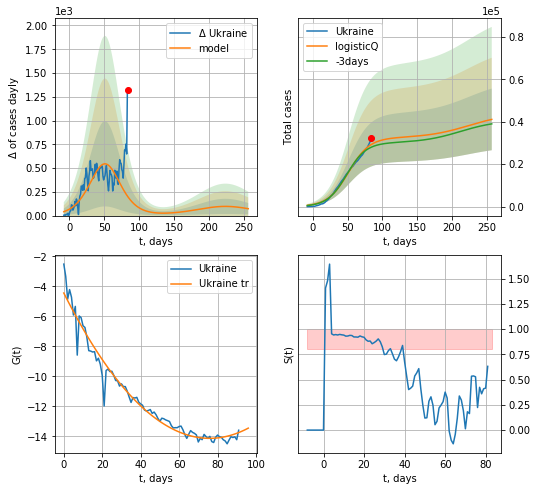

Ukraine data at: 2020-06-15
+3 day model MAPE: 0.046587
model: logisticQ
coeffs: [ 3.24525564e+04  4.19390198e-07  5.13496528e+01 -1.59765647e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.353546
forecast at the end of period: +173 days
	 deltaDaycases: 72
	 total cases: 41116 ± 14536
	 total death: 1154 ± 1223
trend coefficient of determination: 0.963865
 intercept_: -4.442196155580516
 coeffs_: [ 0.         -0.25525048  0.00168167]


In [197]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*36-dT,addpred=True,xcoef=koreaCoeffs)

In [198]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

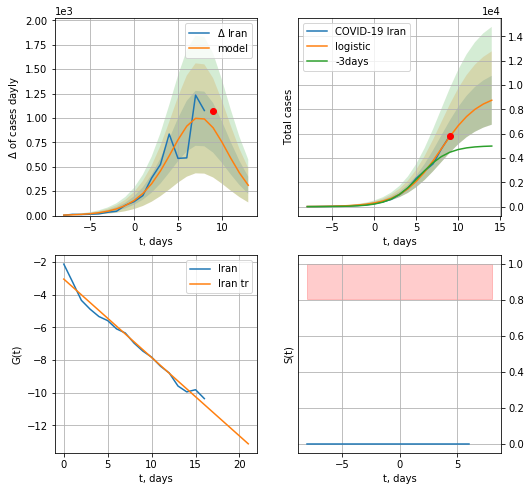

Iran data at: 2020-06-15
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +5 days
	 deltaDaycases:  310
	 total cases:  8741 ± 2008
	 total death:  412 ± 283
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


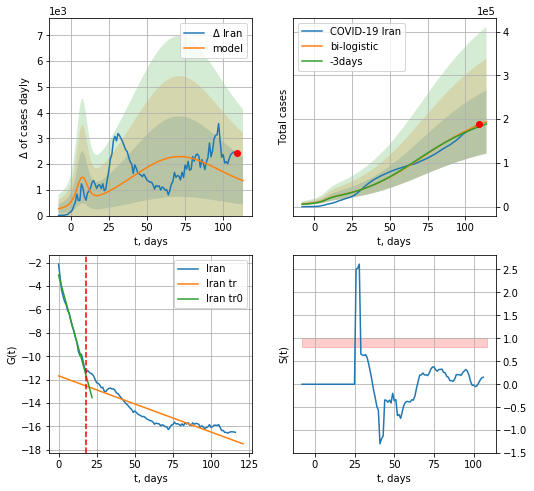

Iran data at: 2020-06-15
+3 day model MAPE: 0.022554818803604045
model: bi-logistic
coeffs:  [1.96679416e+05 4.47375411e-02 6.99670424e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37373371214481393
forecast at the end of period: +5 days
	 deltaDaycases:  1356
	 total cases:  193725 ± 72401
	 total death:  9131 ± 10237
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.810322
 intercept: -11.674554
 slope: -0.048028


In [199]:
x = forecast('Iran',dfIN[:18],d1,7*12-dT)
xx = forecast2('Iran',dfIN[:],d1,12*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


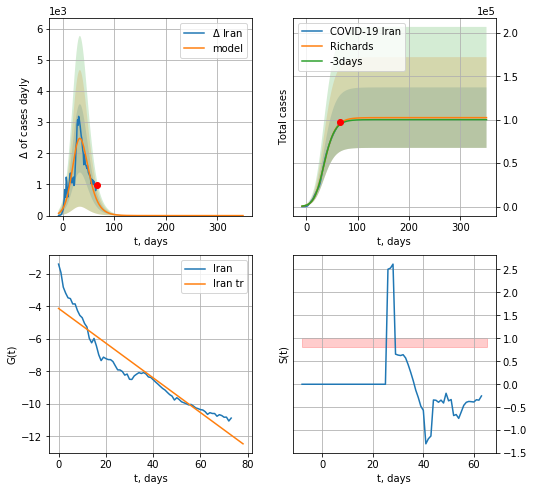

Iran data at: 2020-06-15
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +285 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 4830 ± 4925
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


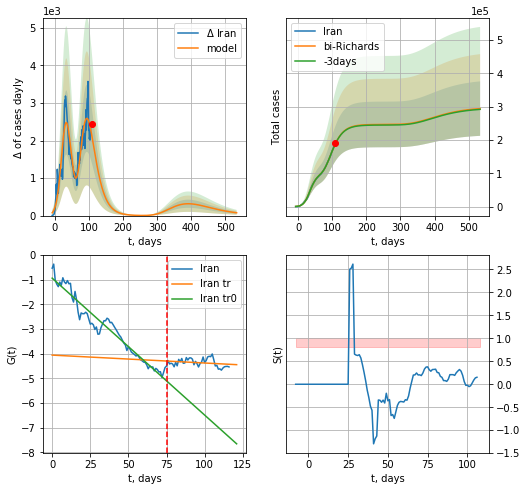

Iran data at: 2020-06-15
+3 day model MAPE: 0.001591
model: bi-Richards
coeffs: [1.44140434e+05 3.10688184e+00 8.35425396e+00 1.55054675e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.277853
forecast at the end of period: +425 days
	 deltaDaycases: 75
	 total cases: 294093 ± 81714
	 total death: 13862 ± 11554
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949239
 intercept: -0.939248
 slope: -0.055520
trend coefficient of determination: 0.057370
 intercept: -4.059926
 slope: -0.003203


In [200]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,52*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,72*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


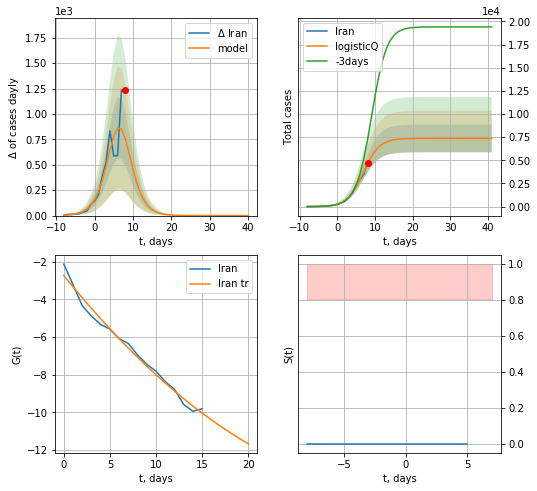

Iran data at: 2020-06-15
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 347 ± 211
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


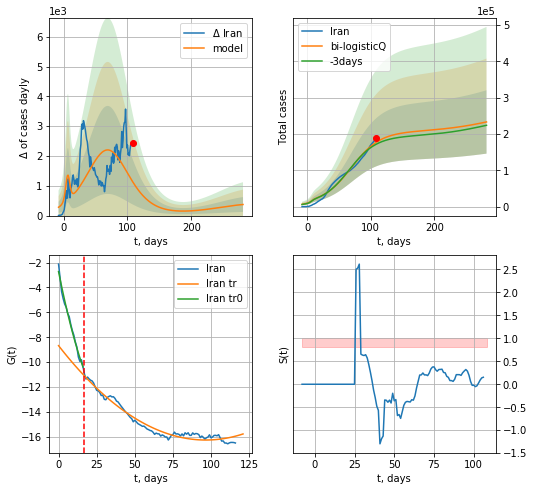

Iran data at: 2020-06-15
+3 day model MAPE: 0.032067
model: bi-logisticQ
coeffs: [ 1.98372412e+05  1.37603495e-07  6.92986365e+01 -3.21662252e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374173
forecast at the end of period: +173 days
	 deltaDaycases: 372
	 total cases: 233140 ± 87235
	 total death: 10989 ± 12335
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.963278
 intercept_: -8.676154833640984
 coeffs_: [ 0.         -0.15725612  0.00081448]


In [201]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active   death
103 2020-06-11  502436.0  234754  6532.0
104 2020-06-12  511423.0  235338  6715.0
105 2020-06-13  520129.0  238659  6829.0
106 2020-06-14  528964.0  241966  6948.0
107 2020-06-15  537210.0  243868  7284.0


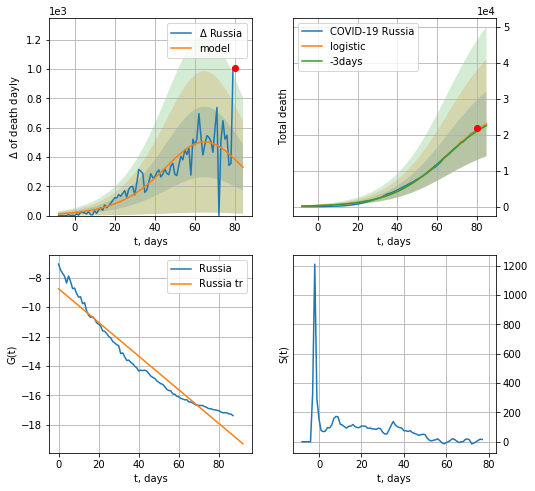

Russia data at: 2020-06-15
+3 day model MAPE: 0.01625696991155937
model: logistic
coeffs:  [2.87509767e+04 6.99755387e-02 6.52641087e+01]
rational stdev:  0.39129574165231745
forecast at the end of period: +5 days
	 total death:  22976 ± 8990
trend coefficient of determination: 0.942595
 intercept: -8.749115
 slope: -0.114549


In [371]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,12*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


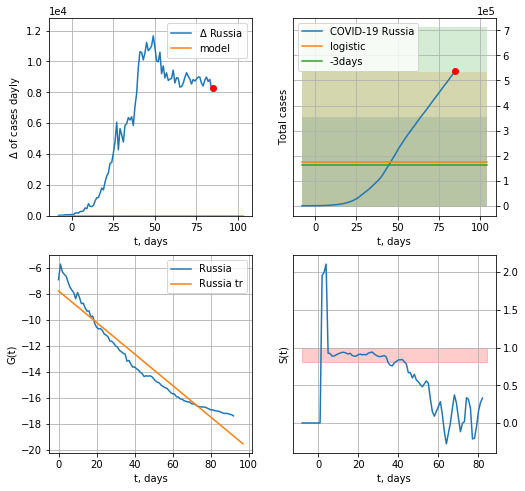

Russia data at: 2020-06-15
+3 day model MAPE: 0.07076364102382485
model: logistic
coeffs:  [ 1.75983617e+05 -5.24233366e+00  1.40827861e+02]
rational stdev:  1.018873668809479
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  175983 ± 179305
	 total death:  2350 ± 7183
trend coefficient of determination: 0.940368
 intercept: -7.767075
 slope: -0.121107


In [372]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


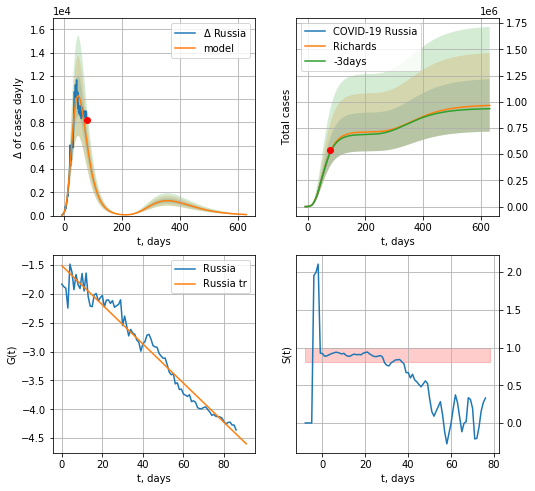

Russia data at: 2020-06-15
+3 day model MAPE: 0.011497
model: Richards
coeffs: [ 7.13196461e+05  2.86567541e+00 -5.96379686e+01  1.37791226e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.258714
forecast at the end of period: +551 days
	 deltaDaycases: 86
	 total cases: 965237 ± 249720
	 total death: 12889 ± 10003
trend coefficient of determination: 0.964684
 intercept: -1.511822
 slope: -0.033914


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


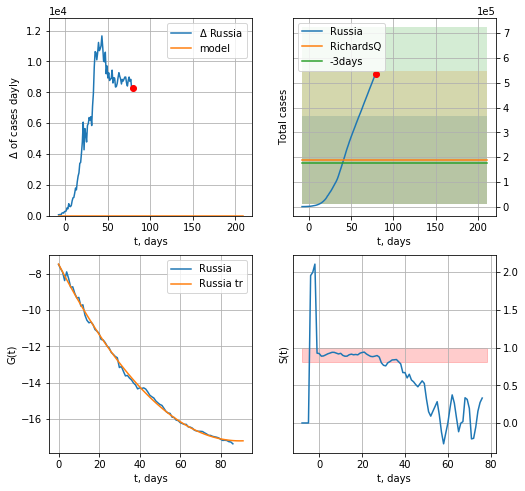

Russia data at: 2020-06-15
+3 day model MAPE: 0.068361
model: RichardsQ
coeffs: [ 1.87974864e+05  1.08385591e+01 -1.87867274e+03  1.59023260e+03
 -4.09779908e+00]
rational stdev: 0.952978
forecast at the end of period: +131 days
	 deltaDaycases: 0
	 total cases: 187974 ± 179135
	 total death: 2510 ± 7175
trend coefficient of determination: 0.998141
 intercept_: -7.457334440711709
 coeffs_: [ 0.         -0.21791153  0.00121752]


In [373]:
x = forecastRR('Russia',dfRS[20:],d1,90*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


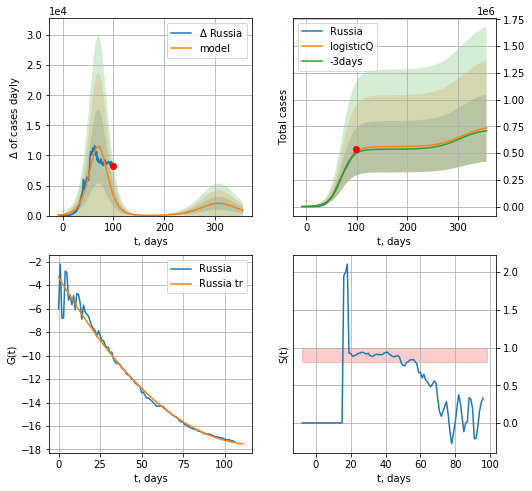

Russia data at: 2020-06-15
+3 day model MAPE: 0.027777
model: logisticQ
coeffs: [ 5.59494269e+05  7.54186747e-07  7.05154157e+01 -1.08944860e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.428767
forecast at the end of period: +257 days
	 deltaDaycases: 866
	 total cases: 734269 ± 314830
	 total death: 9805 ± 12612
trend coefficient of determination: 0.979190
 intercept_: -3.3119321889836044
 coeffs_: [ 0.         -0.24030129  0.00101167]


In [374]:
x = forecastRRR('Russia',dfRS[:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
141 2020-06-11  17292.0     989  920.0
142 2020-06-12  17332.0     917  922.0
143 2020-06-13  17382.0     878  924.0
144 2020-06-14  17429.0     861  925.0
145 2020-06-15  17502.0     891  925.0


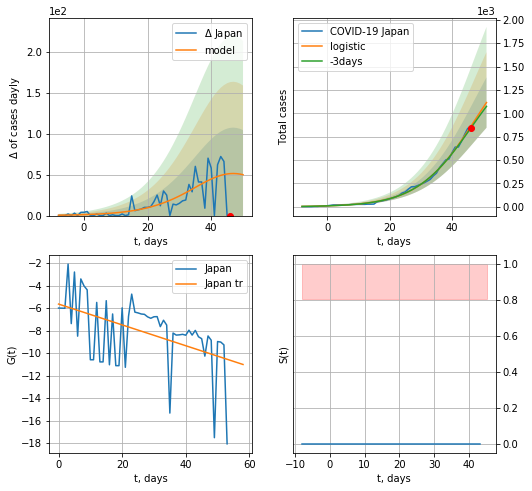

Japan data at: 2020-06-15
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +5 days
	 deltaDaycases:  49
	 total cases:  1115 ± 269
	 total death:  58 ± 42
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


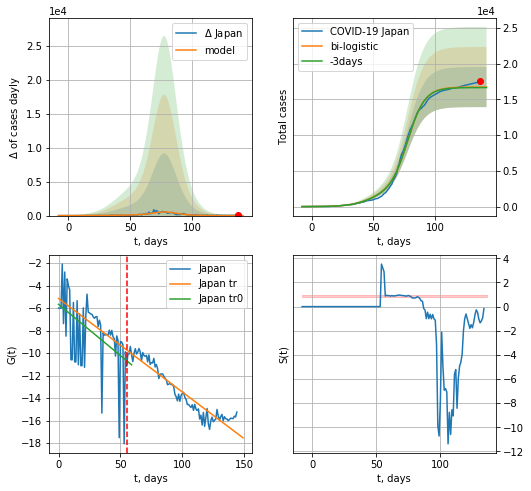

Japan data at: 2020-06-15
+3 day model MAPE: 0.00439666222274546
model: bi-logistic
coeffs:  [1.48547501e+04 1.42325520e-01 7.79144639e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.16770535168463896
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  16719 ± 2803
	 total death:  883 ± 444
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.901603
 intercept: -5.149707
 slope: -0.083137


In [206]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*12-dT)
    xx = forecast2('Japan',dfJP[:],d1,12*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

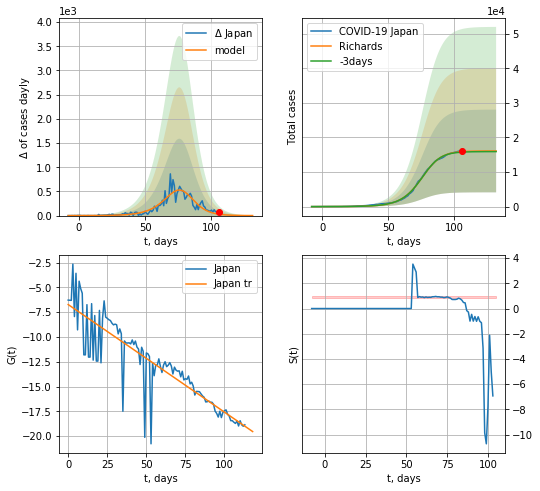

Japan data at: 2020-06-15
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043526e+04 1.05070375e-01 7.85362634e+01 1.40112813e+00]
rational stdev: 0.743333
forecast at the end of period: +26 days
	 deltaDaycases: 0
	 total cases: 16099 ± 11967
	 total death: 850 ± 1895
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


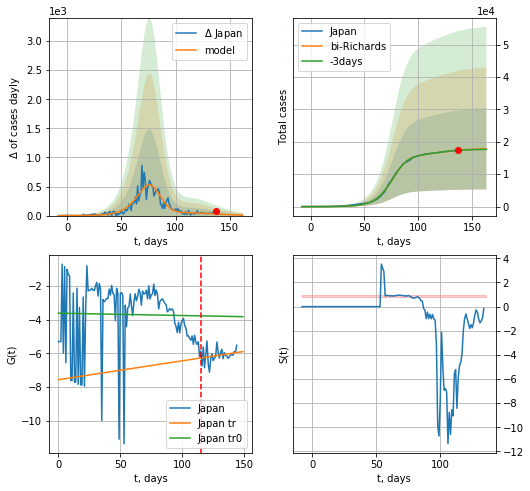

Japan data at: 2020-06-15
+3 day model MAPE: 0.003748
model: bi-Richards
coeffs: [1.86230331e+03 1.20957789e+01 3.23766871e+01 5.01751451e-03]
rational stdev: 0.702886
forecast at the end of period: +26 days
	 deltaDaycases: 7
	 total cases: 17837 ± 12537
	 total death: 942 ± 1986
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.000510
 intercept: -3.624787
 slope: -0.001383
trend coefficient of determination: 0.058481
 intercept: -7.567161
 slope: 0.011176


In [207]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,15*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,15*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


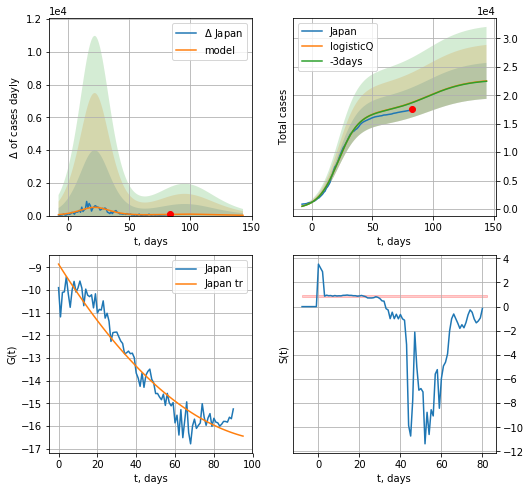

Japan data at: 2020-06-15
+3 day model MAPE: 0.002402
model: logisticQ
coeffs: [ 1.68802951e+04  1.40901463e-06  2.19936412e+01 -8.42127672e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.140473
forecast at the end of period: +61 days
	 deltaDaycases: 18
	 total cases: 22539 ± 3166
	 total death: 1191 ± 501
trend coefficient of determination: 0.929928
 intercept_: -8.852346758345256
 coeffs_: [ 0.         -0.1367359   0.00059758]


In [208]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


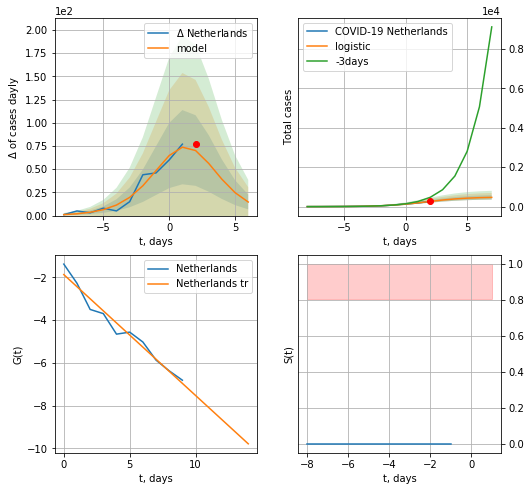

Netherlands data at: 2020-06-15
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +5 days
	 deltaDaycases:  14
	 total cases:  469 ± 111
	 total death:  58 ± 41
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


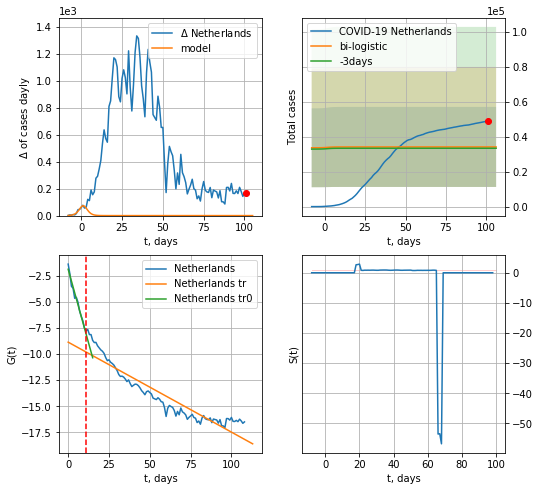

Netherlands data at: 2020-06-15
+3 day model MAPE: 0.02242228412163773
model: bi-logistic
coeffs:  [ 2.69316892e+04 -5.44701847e+00  1.61215272e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6704782541137833
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  34152 ± 22898
	 total death:  4231 ± 8510
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.875736
 intercept: -8.857883
 slope: -0.086125


In [209]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,12*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
           date  cases  active   death
105 2020-06-11  48251       0  6044.0
106 2020-06-12  48461       0  6053.0
107 2020-06-13  48640       0  6057.0
108 2020-06-14  48783       0  6059.0
109 2020-06-15  48948       0  6065.0


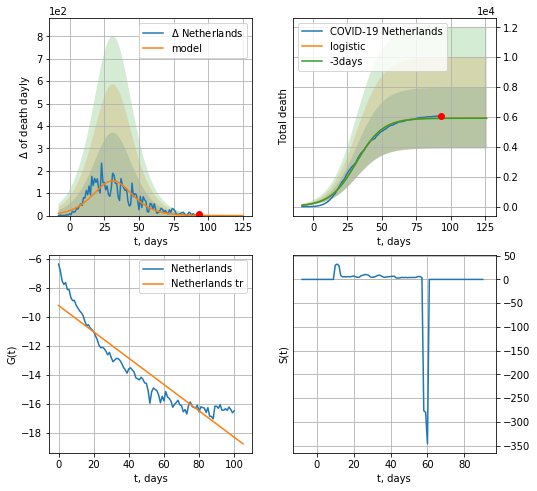

Netherlands data at: 2020-06-15
+3 day model MAPE: 0.0028684866698833055
model: logistic
coeffs:  [5.93005729e+03 1.04564337e-01 3.15330651e+01]
rational stdev:  0.3424960805581683
forecast at the end of period: +33 days
	 total death:  5929 ± 2030
trend coefficient of determination: 0.873183
 intercept: -9.231608
 slope: -0.090809


In [210]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


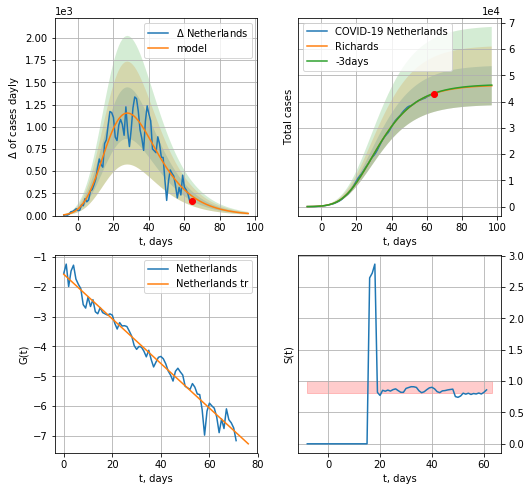

Netherlands data at: 2020-06-15
+3 day model MAPE: 0.002842
model: Richards
coeffs: [4.63365786e+04 4.92236139e-01 2.02382698e+00 1.47660483e-01]
rational stdev: 0.162270
forecast at the end of period: +33 days
	 deltaDaycases: 23
	 total cases: 46022 ± 7468
	 total death: 5702 ± 2775
trend coefficient of determination: 0.973735
 intercept: -1.579499
 slope: -0.074799


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


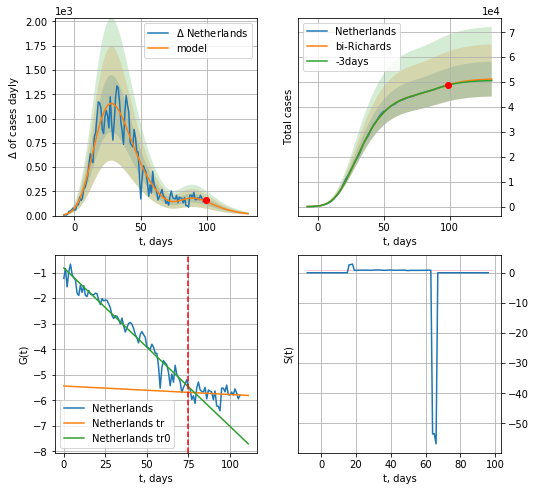

Netherlands data at: 2020-06-15
+3 day model MAPE: 0.002654
model: bi-Richards
coeffs: [5.13172509e+03 7.56786728e+00 3.28122162e+01 1.02018425e-02]
rational stdev: 0.136288
forecast at the end of period: +33 days
	 deltaDaycases: 20
	 total cases: 51211 ± 6979
	 total death: 6345 ± 2594
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.960476
 intercept: -0.820207
 slope: -0.062009
trend coefficient of determination: 0.014707
 intercept: -5.441090
 slope: -0.003305


In [211]:
vL = 75
x = forecastRR('Netherlands',dfNL[2:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[2:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


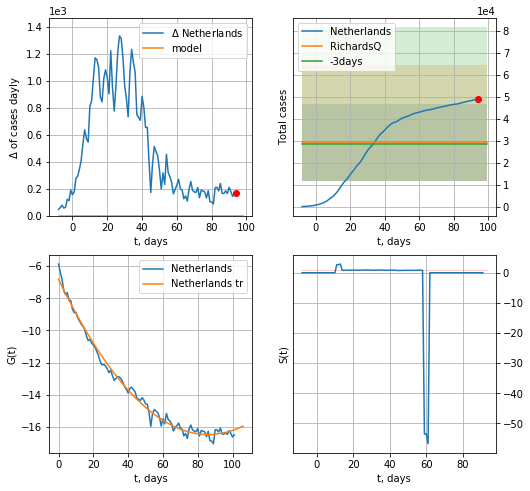

Netherlands data at: 2020-06-15
+3 day model MAPE: 0.020481
model: RichardsQ
coeffs: [ 2.92334951e+04  4.40809235e-01 -1.23983894e+03  1.03776227e+03
 -1.52962874e+00]
rational stdev: 0.598993
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 29233 ± 17510
	 total death: 3622 ± 6508
trend coefficient of determination: 0.990077
 intercept_: -6.818587665094022
 coeffs_: [ 0.         -0.22444069  0.00130464]


In [212]:
x = forecastQR('Netherlands',dfNL[7:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


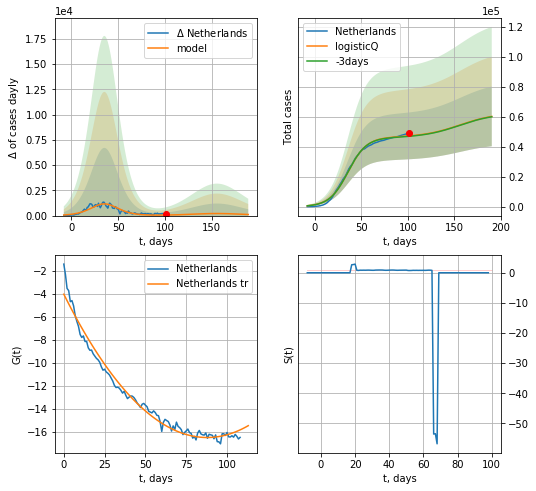

Netherlands data at: 2020-06-15
+3 day model MAPE: 0.006173
model: logisticQ
coeffs: [ 4.62885375e+04  3.89766617e-07  3.57848150e+01 -2.56666974e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.330879
forecast at the end of period: +89 days
	 deltaDaycases: 108
	 total cases: 60177 ± 19911
	 total death: 7456 ± 7401
trend coefficient of determination: 0.978821
 intercept_: -4.008706326605788
 coeffs_: [ 0.         -0.28464155  0.0016215 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


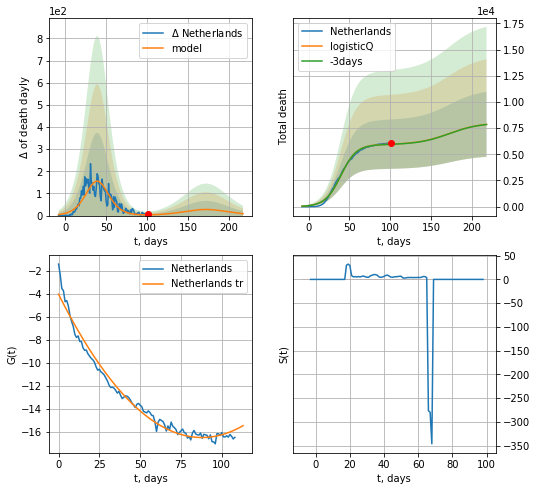

Netherlands data at: 2020-06-15
+3 day model MAPE: 0.002912
model: logisticQ
coeffs: [ 5.92836519e+03  4.86256266e-07  3.95288606e+01 -2.15447222e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.395046
forecast at the end of period: +117 days
	 total death: 7854 ± 3103
trend coefficient of determination: 0.978821
 intercept_: -4.008706326605788
 coeffs_: [ 0.         -0.28464155  0.0016215 ]


In [213]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [214]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


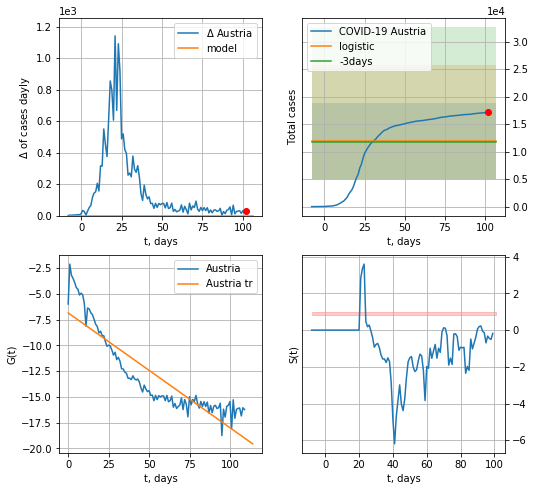

Austria data at: 2020-06-15
+3 day model MAPE: 0.014636789782501334
model: logistic
coeffs:  [ 1.12598379e+04 -3.43615405e+00  1.20378107e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.5770708194047839
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  11963 ± 6903
	 total death:  473 ± 818
trend coefficient of determination: 0.801448
 intercept: -6.859865
 slope: -0.111414


In [215]:
x = forecast('Austria',dfAT[:],d1,7*12-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

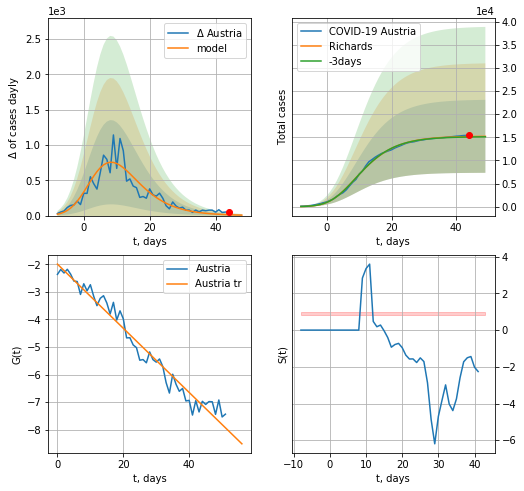

Austria data at: 2020-06-15
+3 day model MAPE: 0.006824
model: Richards
coeffs: [ 1.52413256e+04  8.30508829e-01 -3.03588001e+00  1.76502169e-01]
rational stdev: 0.518621
forecast at the end of period: +5 days
	 deltaDaycases: 6
	 total cases: 15199 ± 7882
	 total death: 601 ± 935
trend coefficient of determination: 0.965129
 intercept: -1.995756
 slope: -0.116348


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


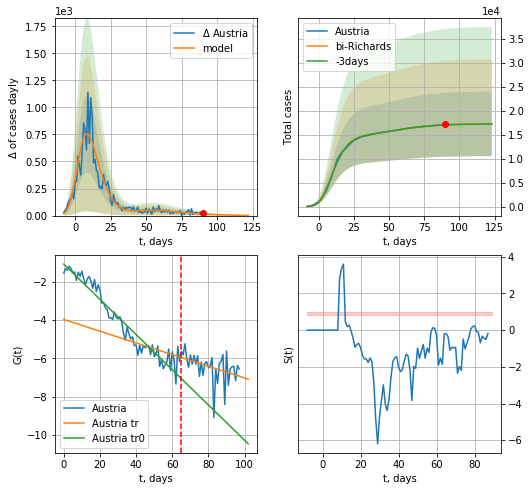

Austria data at: 2020-06-15
+3 day model MAPE: 0.001757
model: bi-Richards
coeffs: [ 2.07359455e+03  9.22967278e+00 -2.49311492e+01  6.67063748e-03]
rational stdev: 0.389486
forecast at the end of period: +33 days
	 deltaDaycases: 2
	 total cases: 17280 ± 6730
	 total death: 683 ± 798
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.933081
 intercept: -1.067050
 slope: -0.092191
trend coefficient of determination: 0.147158
 intercept: -3.967331
 slope: -0.030599


In [216]:
vL=65+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


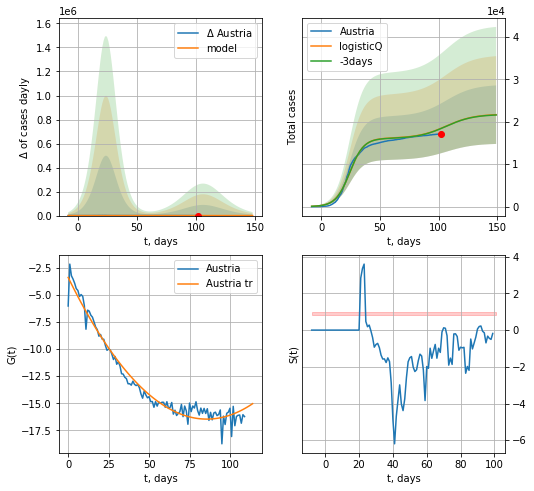

Austria data at: 2020-06-15
+3 day model MAPE: 0.001810
model: logisticQ
coeffs: [ 1.61119922e+04  4.60994300e-07  2.44332478e+01 -3.64043937e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.318182
forecast at the end of period: +47 days
	 deltaDaycases: 13
	 total cases: 21664 ± 6893
	 total death: 857 ± 818
trend coefficient of determination: 0.967494
 intercept_: -3.3569463253137553
 coeffs_: [ 0.         -0.30602606  0.00178546]


In [217]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


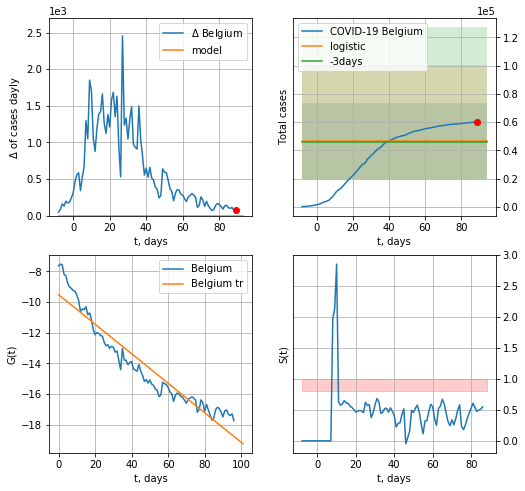

Belgium data at: 2020-06-15
+3 day model MAPE: 0.019542400447729025
model: logistic
coeffs:  [ 3.73468469e+04 -7.61044085e+00  2.50291640e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.576189817739147
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  46683 ± 26898
	 total death:  7504 ± 12971
trend coefficient of determination: 0.911016
 intercept: -9.524252
 slope: -0.096279


In [218]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
           date  cases  active   death
102 2020-06-11  59711   33622  9636.0
103 2020-06-12  59819   33675  9646.0
104 2020-06-13  59918   33721  9650.0
105 2020-06-14  60029   33785  9655.0
106 2020-06-15  60100   33829  9661.0


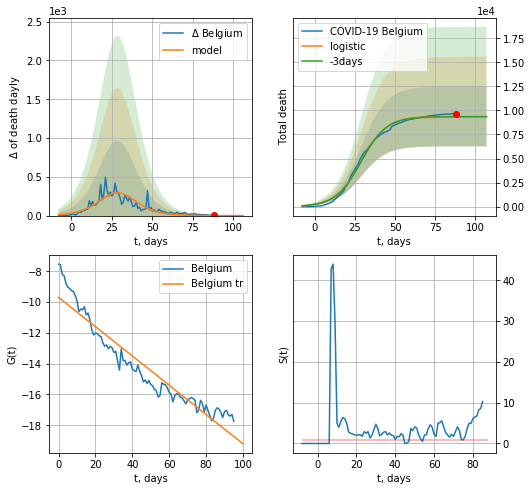

Belgium data at: 2020-06-15
+3 day model MAPE: 0.003501075692222578
model: logistic
coeffs:  [9.37177791e+03 1.25973497e-01 2.88464162e+01]
rational stdev:  0.33116538303768156
forecast at the end of period: +19 days
	 total death:  9371 ± 3103
trend coefficient of determination: 0.910841
 intercept: -9.698682
 slope: -0.095045


In [219]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,14*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


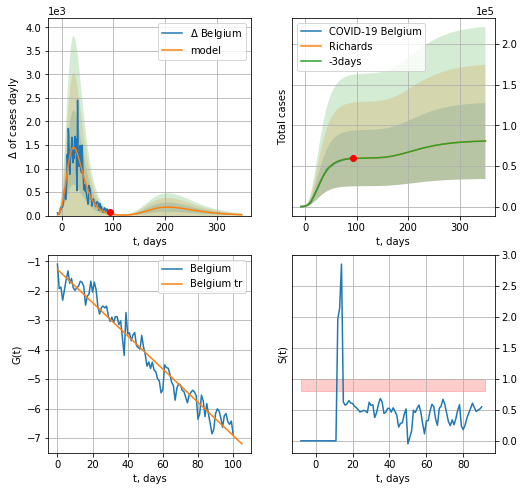

Belgium data at: 2020-06-15
+3 day model MAPE: 0.001965
model: Richards
coeffs: [ 5.98885044e+04  5.53931272e+00 -4.30886624e+01  1.19366628e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.578739
forecast at the end of period: +257 days
	 deltaDaycases: 18
	 total cases: 80773 ± 46746
	 total death: 12984 ± 22543
trend coefficient of determination: 0.958847
 intercept: -1.275975
 slope: -0.056404


In [220]:
x = forecastRR('Belgium',dfBG[5:],d1,48*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


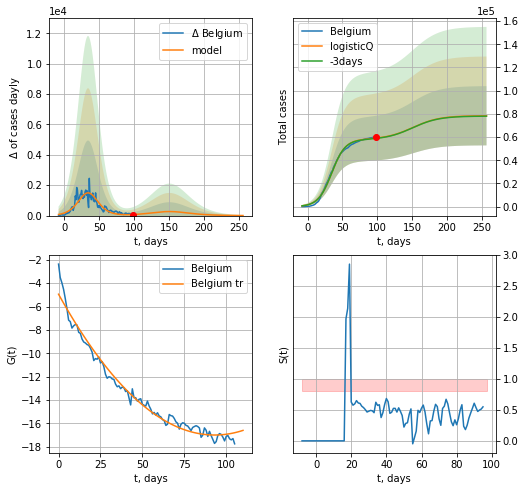

Belgium data at: 2020-06-15
+3 day model MAPE: 0.004286
model: logisticQ
coeffs: [ 5.79304085e+04  4.25283471e-07  3.46565772e+01 -2.42836509e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.326054
forecast at the end of period: +159 days
	 deltaDaycases: 4
	 total cases: 78364 ± 25551
	 total death: 12597 ± 12321
trend coefficient of determination: 0.978032
 intercept_: -4.943772337250014
 coeffs_: [ 0.         -0.25878325  0.00138959]


In [221]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [222]:
dfBZ.tail()

,date,cases,active,death
107,2020-06-11,805649.0,367899,41058.0
108,2020-06-12,829902.0,360391,41901.0
109,2020-06-13,850796.0,370493,42791.0
110,2020-06-14,867882.0,370925,43389.0
111,2020-06-15,891556.0,382664,44118.0


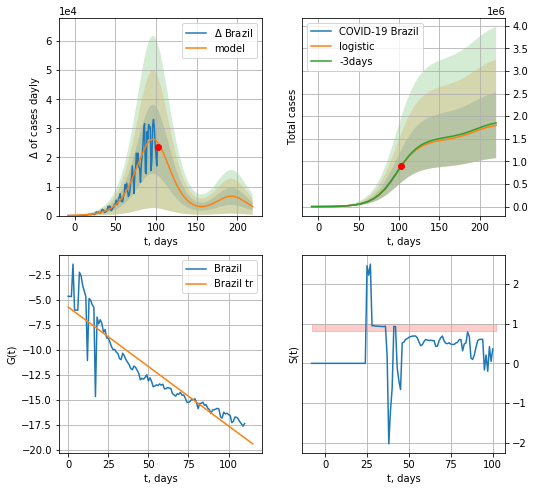

Brazil data at: 2020-06-15
+3 day model MAPE: 0.008398194559894784
model: logistic
coeffs:  [1.47778990e+06 7.10209035e-02 9.67968014e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.40382047470498056
forecast at the end of period: +117 days
	 deltaDaycases:  3120
	 total cases:  1797897 ± 726027
	 total death:  88967 ± 107780
trend coefficient of determination: 0.864994
 intercept: -5.706837
 slope: -0.118742


In [223]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


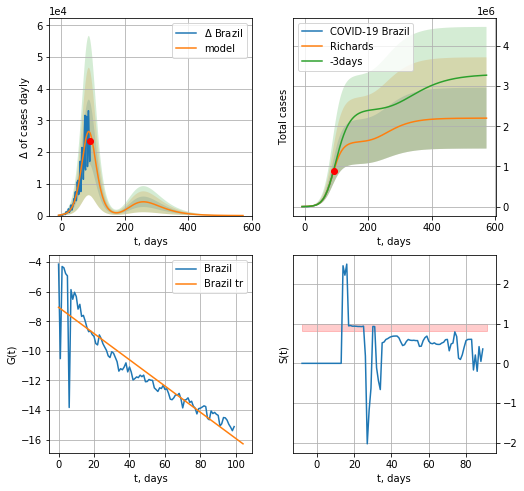

Brazil data at: 2020-06-15
+3 day model MAPE: 0.026534
model: Richards
coeffs: [1.61605850e+06 7.43928045e-02 8.46459368e+01 8.39106489e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.343839
forecast at the end of period: +481 days
	 deltaDaycases: 15
	 total cases: 2201023 ± 756797
	 total death: 108916 ± 112348
trend coefficient of determination: 0.835783
 intercept: -7.049266
 slope: -0.088856


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


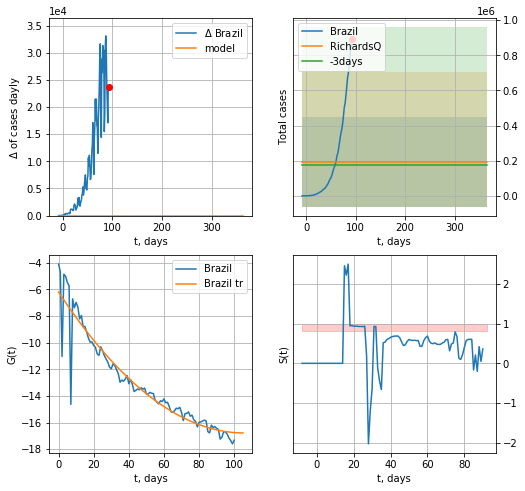

Brazil data at: 2020-06-15
+3 day model MAPE: 0.117685
model: RichardsQ
coeffs: [ 1.94444098e+05  1.10677523e+01 -1.60004505e+03  1.37021825e+03
 -3.74597021e+00]
rational stdev: 1.315419
forecast at the end of period: +271 days
	 deltaDaycases: 0
	 total cases: 194444 ± 255775
	 total death: 9621 ± 37966
trend coefficient of determination: 0.903864
 intercept_: -6.19717975098398
 coeffs_: [ 0.         -0.20013666  0.0009455 ]


In [224]:
x = forecastRR('Brazil',dfBZ[11:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


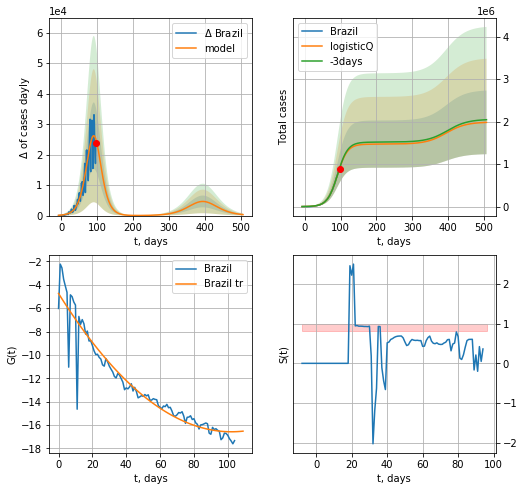

Brazil data at: 2020-06-15
+3 day model MAPE: 0.008182
model: logisticQ
coeffs: [ 1.46929245e+06  5.76013397e-06  9.06318459e+01 -1.22999715e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.377846
forecast at the end of period: +411 days
	 deltaDaycases: 322
	 total cases: 1980634 ± 748375
	 total death: 98010 ± 111098
trend coefficient of determination: 0.911083
 intercept_: -4.738674545939416
 coeffs_: [ 0.         -0.23159629  0.00113325]


In [225]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [226]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date   cases  active  death
117 2020-06-11  7289.0     406  102.0
118 2020-06-12  7294.0     389  102.0
119 2020-06-13  7320.0     403  102.0
120 2020-06-14  7335.0     382  102.0
121 2020-06-15  7347.0     392  102.0


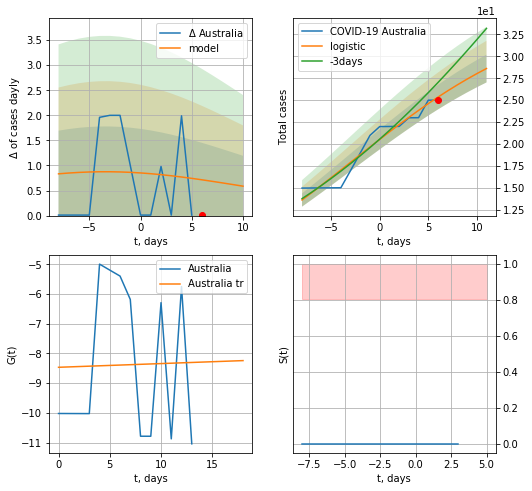

Australia data at: 2020-06-15
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  28 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


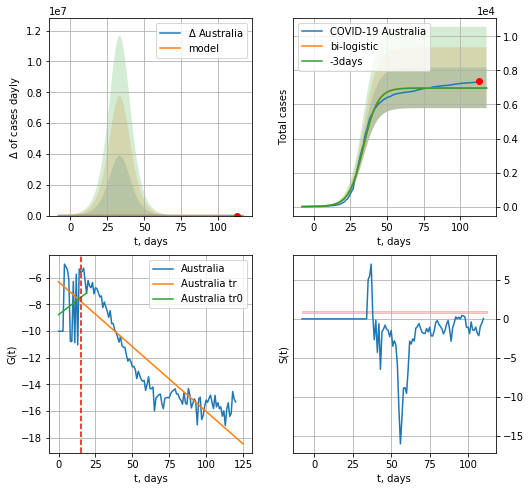

Australia data at: 2020-06-15
+3 day model MAPE: 0.002730471425070183
model: bi-logistic
coeffs:  [6.94234090e+03 2.03357207e-01 3.38991086e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.1704918734273724
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  6978 ± 1189
	 total death:  96 ± 49
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.801559
 intercept: -6.319572
 slope: -0.097130


In [227]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,12*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,12*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


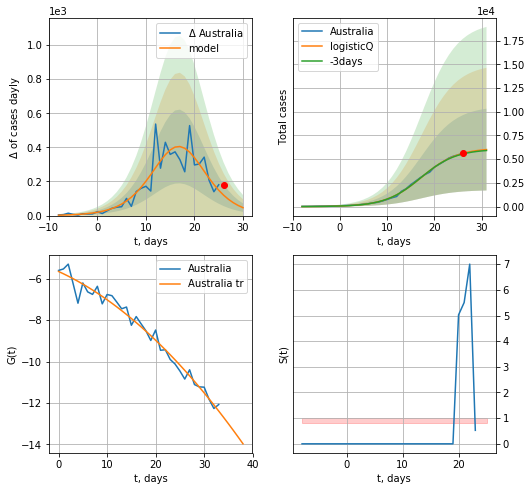

Australia data at: 2020-06-15
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +5 days
	 deltaDaycases: 46
	 total cases: 6009 ± 4307
	 total death: 83 ± 178
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


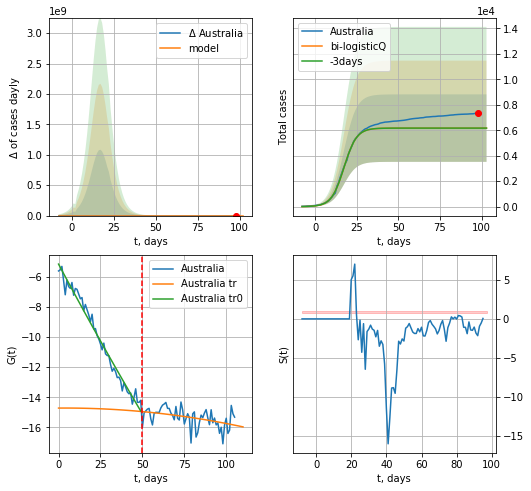

Australia data at: 2020-06-15
+3 day model MAPE: 0.000000
model: bi-logisticQ
coeffs: [-8.84351861 -1.29397111 22.53081865  2.49588759]
rational stdev: 0.429432
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 6168 ± 2648
	 total death: 85 ± 109
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.175060
 intercept_: -14.715025926690327
 coeffs_: [ 0.          0.00088386 -0.00011131]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [228]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,12*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,12*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

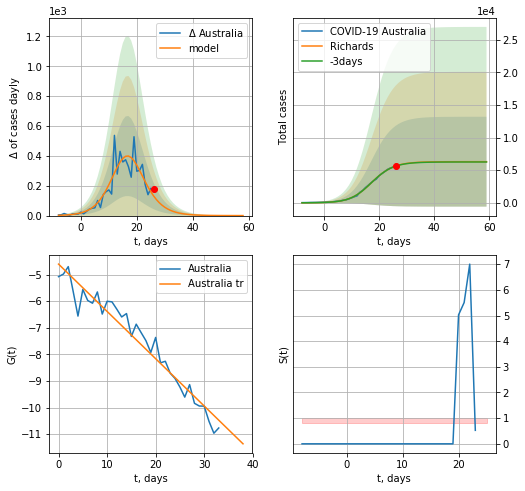

Australia data at: 2020-06-15
+3 day model MAPE: 0.004139
model: Richards
coeffs: [6.29844024e+03 2.85463605e-01 1.64695760e+01 8.48736456e-01]
rational stdev: 1.092498
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 6298 ± 6880
	 total death: 87 ± 285
trend coefficient of determination: 0.945167
 intercept: -4.606318
 slope: -0.177832


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


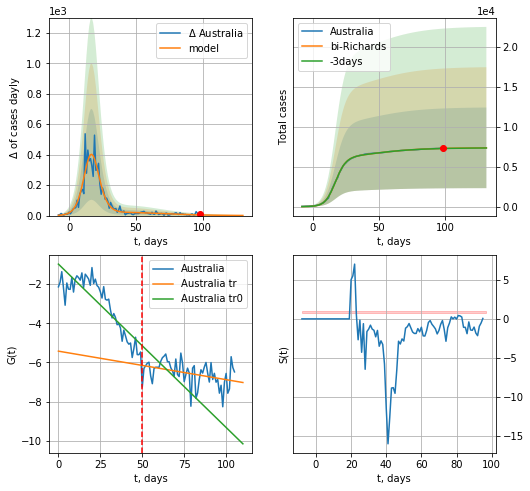

Australia data at: 2020-06-15
+3 day model MAPE: 0.001814
model: bi-Richards
coeffs: [ 1.09077326e+03  6.76009679e+00 -5.33818343e+01  7.21078934e-03]
rational stdev: 0.685635
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 7370 ± 5053
	 total death: 102 ± 209
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.755187
 intercept: -0.973618
 slope: -0.083477
trend coefficient of determination: 0.142183
 intercept: -5.421269
 slope: -0.014565


In [229]:
x = forecastRR('Australia',dfAS[15:50],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[15:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=50)

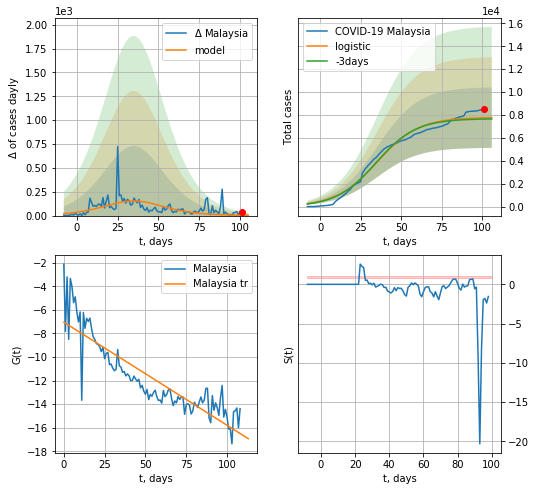

Malaysia data at: 2020-06-15
+3 day model MAPE: 0.014900081057286798
model: logistic
coeffs:  [7.80039024e+03 7.82792614e-02 3.52171204e+01]
rational stdev:  0.3396160409655864
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  7769 ± 2638
	 total death:  110 ± 112
trend coefficient of determination: 0.771775
 intercept: -7.046307
 slope: -0.087418


In [230]:
x = forecast('Malaysia',dfML[:],d1,12*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

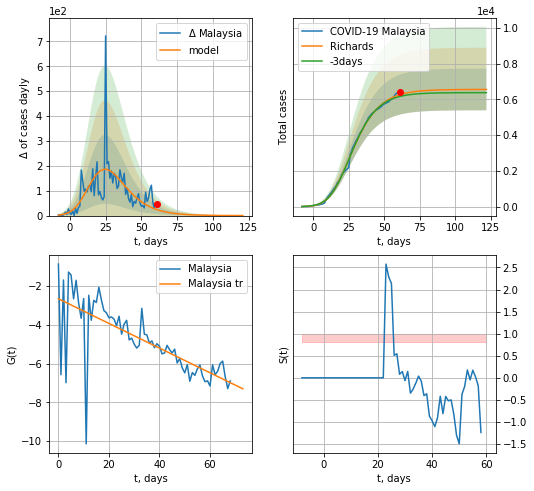

Malaysia data at: 2020-06-15
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55738118e+03 3.88579492e-01 7.38231986e+00 2.20014246e-01]
rational stdev: 0.177891
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 6555 ± 1166
	 total death: 93 ± 49
trend coefficient of determination: 0.508698
 intercept: -2.652901
 slope: -0.063638


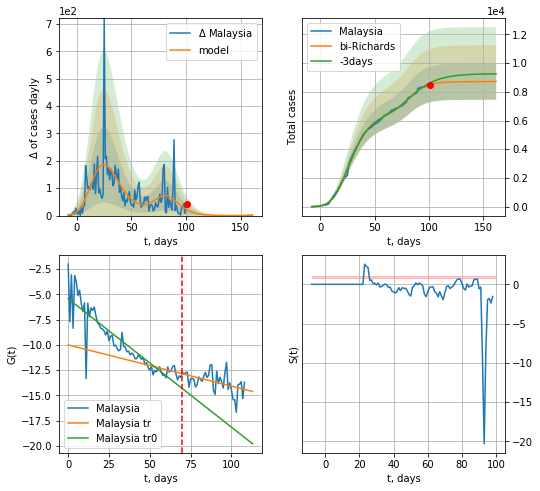

Malaysia data at: 2020-06-15
+3 day model MAPE: 0.014126
model: bi-Richards
coeffs: [2.14671771e+03 1.35125632e-01 8.13037505e+01 9.24318175e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.145264
forecast at the end of period: +61 days
	 deltaDaycases: 2
	 total cases: 8720 ± 1266
	 total death: 124 ± 54
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.795222
 intercept: -5.432880
 slope: -0.127072
trend coefficient of determination: 0.207269
 intercept: -9.998757
 slope: -0.040835


In [231]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d1,20*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


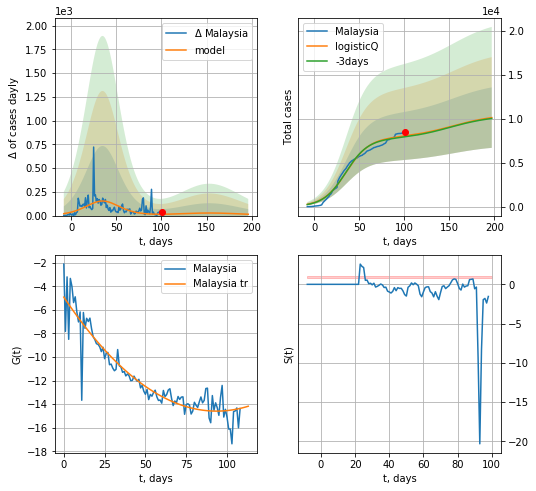

Malaysia data at: 2020-06-15
+3 day model MAPE: 0.013471
model: logisticQ
coeffs: [ 7.80039568e+03  1.84666172e-07  3.52185629e+01 -4.23718357e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339665
forecast at the end of period: +96 days
	 deltaDaycases: 14
	 total cases: 10140 ± 3444
	 total death: 144 ± 146
trend coefficient of determination: 0.869292
 intercept_: -4.920033444990104
 coeffs_: [ 0.         -0.2066519   0.00110404]


In [232]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date    cases  active  death
104 2020-06-11  1504.54       0   22.0
105 2020-06-12  1504.55       0   22.0
106 2020-06-13  1504.56       0   22.0
107 2020-06-14  1504.57       0   22.0
108 2020-06-15  1506.00       2   22.0


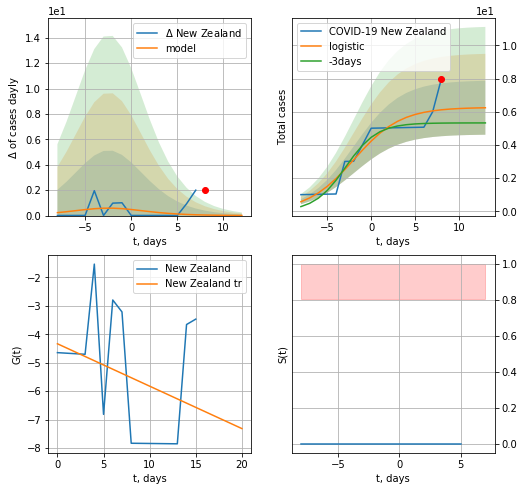

New Zealand data at: 2020-06-15
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


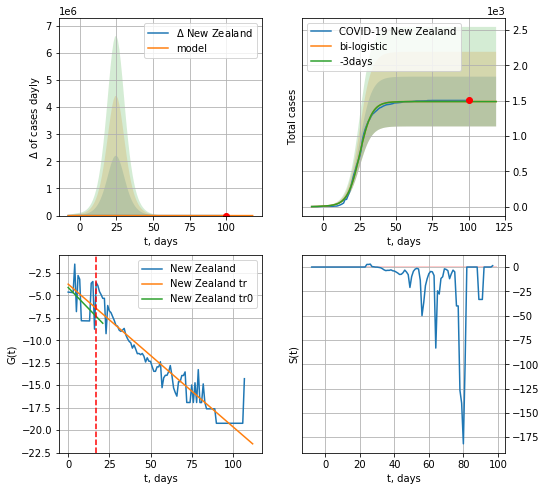

New Zealand data at: 2020-06-15
+3 day model MAPE: 0.0005602388770921251
model: bi-logistic
coeffs:  [1.48310562e+03 2.41840861e-01 2.51194616e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.23660364175464138
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  1489 ± 352
	 total death:  21 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.911728
 intercept: -3.762289
 slope: -0.158571


In [234]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,12*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,14*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

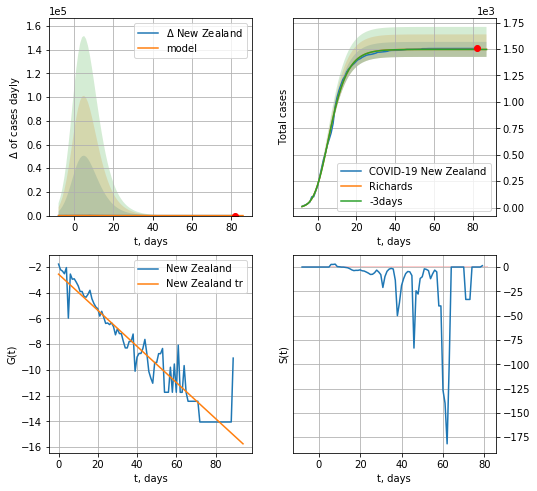

New Zealand data at: 2020-06-15
+3 day model MAPE: 0.000361
model: Richards
coeffs: [ 1.49637834e+03  6.26141066e-01 -1.48910615e+00  2.90609628e-01]
rational stdev: 0.047389
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 1496 ± 70
	 total death: 21 ± 2
trend coefficient of determination: 0.919600
 intercept: -2.567595
 slope: -0.140151


In [235]:
x = forecastRR('New Zealand',dfZL[18:],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


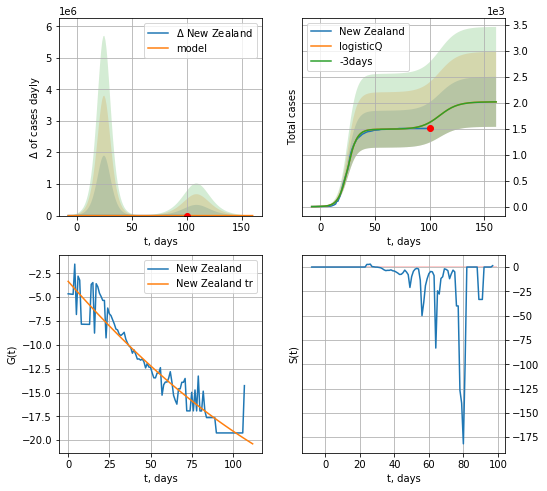

New Zealand data at: 2020-06-15
+3 day model MAPE: 0.000396
model: logisticQ
coeffs: [ 1.48964693e+03  2.26292639e-06  2.50728806e+01 -1.05816376e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.238448
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 2016 ± 480
	 total death: 29 ± 20
trend coefficient of determination: 0.921905
 intercept_: -3.3379702629102663
 coeffs_: [ 0.         -0.19703395  0.00040076]


In [236]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
104 2020-06-11  51816.0   24880  293.0
105 2020-06-12  52520.0   24462  298.0
106 2020-06-13  53241.0   23827  303.0
107 2020-06-14  53973.0   23562  308.0
108 2020-06-15  54680.0   23948  312.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


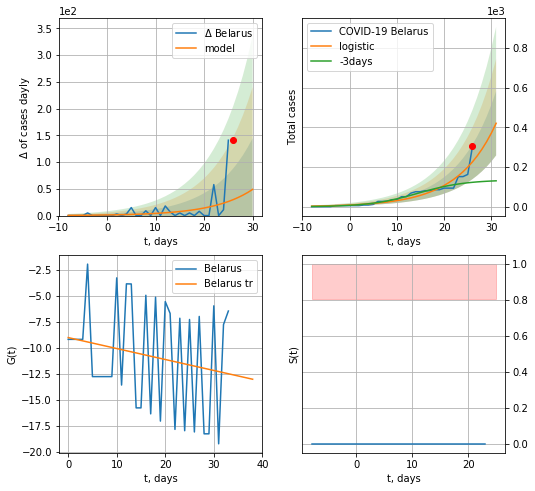

Belarus data at: 2020-06-15
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +5 days
	 deltaDaycases:  49
	 total cases:  420 ± 161
	 total death:  2 ± 2
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


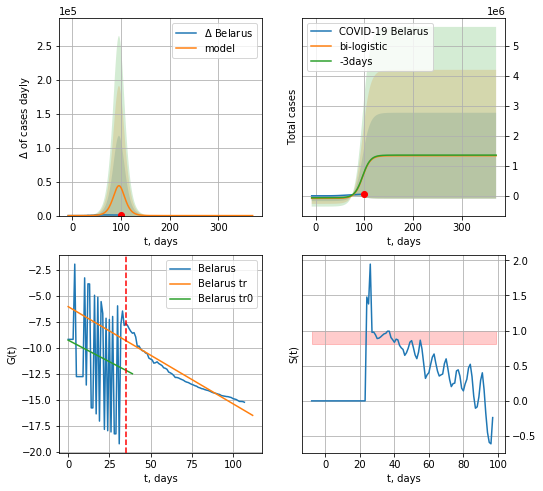

Belarus data at: 2020-06-15
+3 day model MAPE: 0.022971501390341185
model: bi-logistic
coeffs:  [-8.56058300e+04  4.20032301e+01 -9.74658469e+02] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  1.0703425283319674
forecast at the end of period: +271 days
	 deltaDaycases:  0
	 total cases:  1336373 ± 1430377
	 total death:  7625 ± 24484
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.921209
 intercept: -6.064803
 slope: -0.093353


In [237]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*12-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
104 2020-06-11  51816.0   24880  293.0
105 2020-06-12  52520.0   24462  298.0
106 2020-06-13  53241.0   23827  303.0
107 2020-06-14  53973.0   23562  308.0
108 2020-06-15  54680.0   23948  312.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


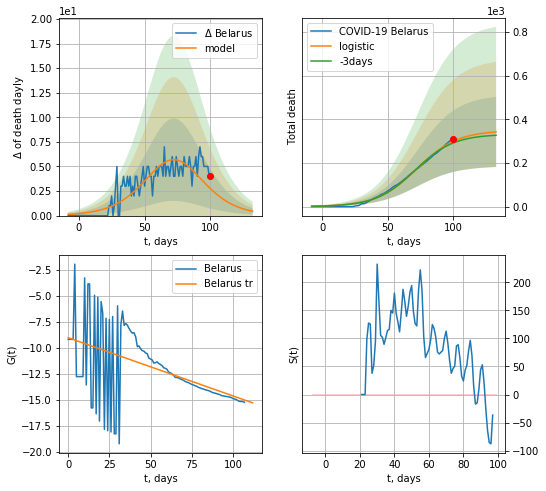

Belarus data at: 2020-06-15
+3 day model MAPE: 0.026398325893356858
model: logistic
coeffs:  [3.48868289e+02 6.52461836e-02 7.26168900e+01]
rational stdev:  0.4693173484951381
forecast at the end of period: +33 days
	 total death:  342 ± 160
trend coefficient of determination: 0.245606
 intercept: -9.053316
 slope: -0.055937


In [238]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


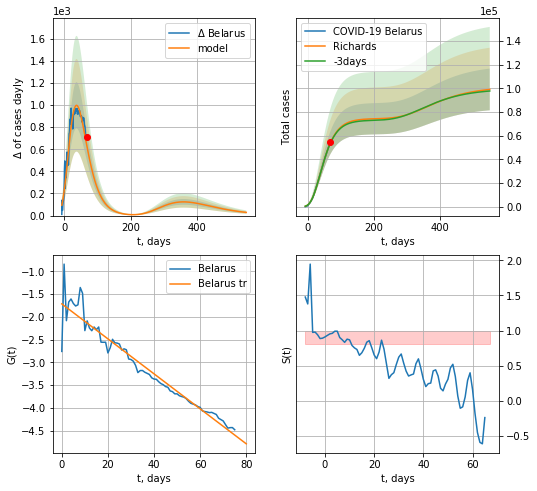

Belarus data at: 2020-06-15
+3 day model MAPE: 0.005629
model: Richards
coeffs: [ 7.44968951e+04  3.00173014e+00 -8.33437673e+01  1.22077742e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.177621
forecast at the end of period: +481 days
	 deltaDaycases: 28
	 total cases: 99099 ± 17602
	 total death: 565 ± 301
trend coefficient of determination: 0.935666
 intercept: -1.712812
 slope: -0.038471


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


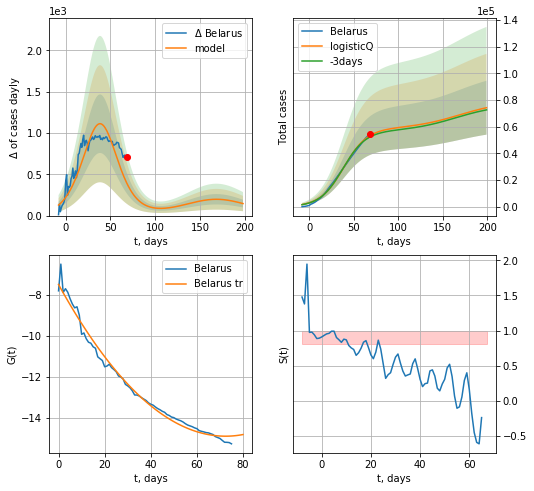

Belarus data at: 2020-06-15
+3 day model MAPE: 0.019229
model: logisticQ
coeffs: [ 5.84764425e+04  8.27157168e-07  3.87297709e+01 -9.14663107e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.271773
forecast at the end of period: +131 days
	 deltaDaycases: 145
	 total cases: 74203 ± 20166
	 total death: 423 ± 344
trend coefficient of determination: 0.986539
 intercept_: -7.479411968742214
 coeffs_: [ 0.         -0.20447094  0.00141129]


In [239]:
x = forecastRR('Belarus',dfBR[32:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


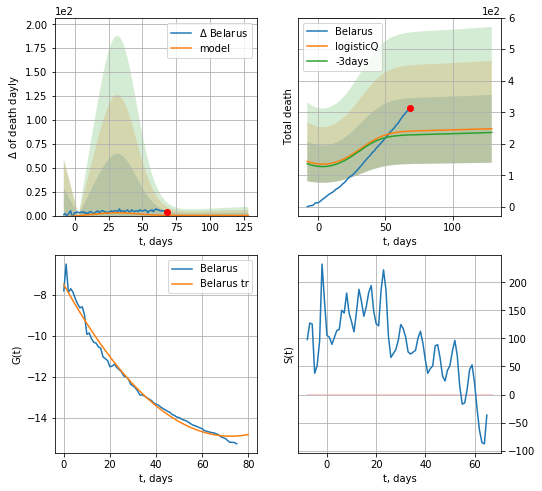

Belarus data at: 2020-06-15
+3 day model MAPE: 0.052261
model: logisticQ
coeffs: [ 2.03170755e+02  1.30087187e-03  8.07883638e+00 -1.34216973e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.434138
forecast at the end of period: +61 days
	 total death: 247 ± 107
trend coefficient of determination: 0.986539
 intercept_: -7.479411968742214
 coeffs_: [ 0.         -0.20447094  0.00141129]


In [240]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

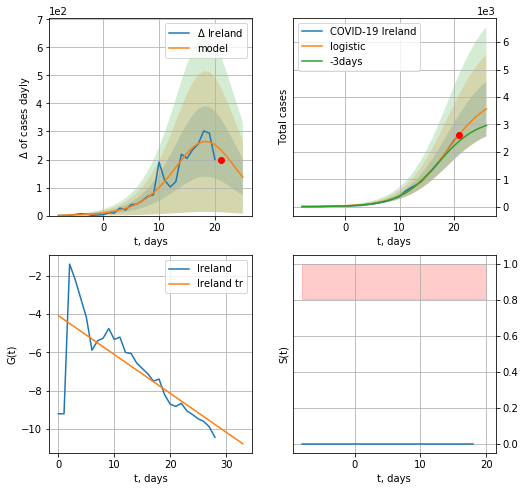

Ireland data at: 2020-06-15
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +5 days
	 deltaDaycases:  136
	 total cases:  3564 ± 997
	 total death:  240 ± 201
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


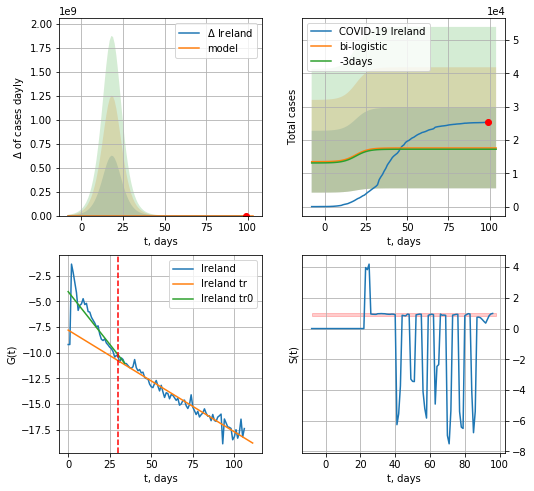

Ireland data at: 2020-06-15
+3 day model MAPE: 0.021524077038249375
model: bi-logistic
coeffs:  [ 1.07881159e+04 -9.56331820e+00  2.42418229e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.688360290176613
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  17612 ± 12123
	 total death:  1186 ± 2449
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.951021
 intercept: -7.807167
 slope: -0.098992


In [241]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,12*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


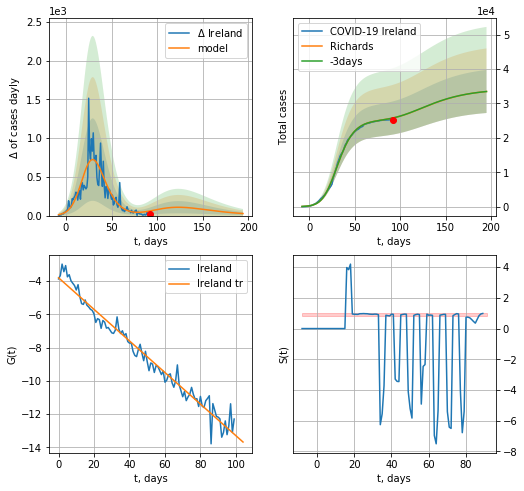

Ireland data at: 2020-06-15
+3 day model MAPE: 0.000074
model: Richards
coeffs: [2.51800687e+04 1.94818504e-01 2.26443210e+01 4.97237108e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.186843
forecast at the end of period: +103 days
	 deltaDaycases: 26
	 total cases: 33478 ± 6255
	 total death: 2255 ± 1263
trend coefficient of determination: 0.968796
 intercept: -3.798614
 slope: -0.094932


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


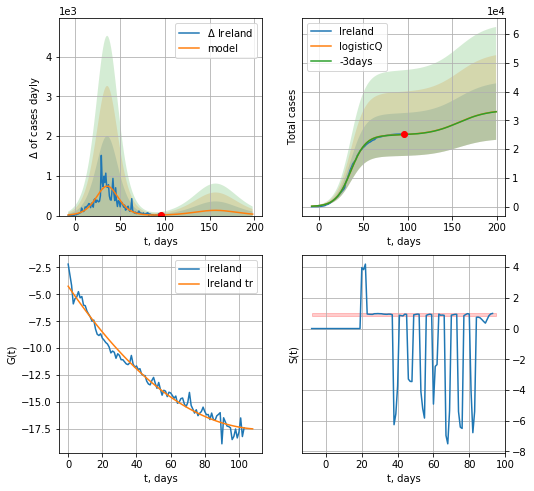

Ireland data at: 2020-06-15
+3 day model MAPE: 0.001994
model: logisticQ
coeffs: [ 2.48889168e+04  9.93870495e-07  3.60172462e+01 -1.19787834e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.297174
forecast at the end of period: +103 days
	 deltaDaycases: 37
	 total cases: 33045 ± 9820
	 total death: 2226 ± 1984
trend coefficient of determination: 0.978297
 intercept_: -4.247820730107609
 coeffs_: [ 0.         -0.23245465  0.00101762]


In [242]:
ivL = 0
vL = 85 + ivL
x = forecastRR('Ireland',dfIR[7:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Ireland',dfIR[7:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

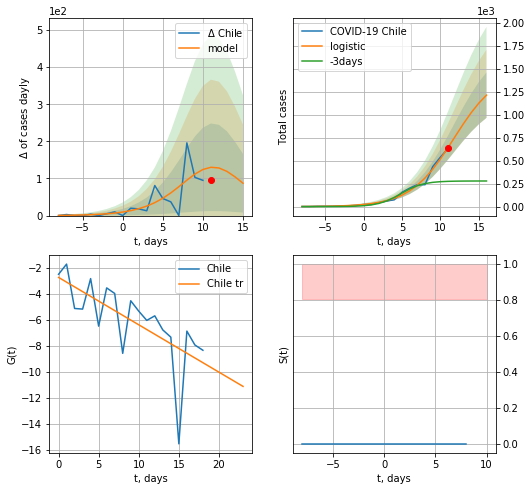

Chile data at: 2020-06-15
+3 day model MAPE: 1.792944169915196
model: logistic
coeffs:  [1.48337612e+03 3.52807696e-01 1.17654757e+01]
rational stdev:  0.20396784879776983
forecast at the end of period: +5 days
	 deltaDaycases:  87
	 total cases:  1211 ± 247
	 total death:  22 ± 13
trend coefficient of determination: 0.458420
 intercept: -2.731631
 slope: -0.364960


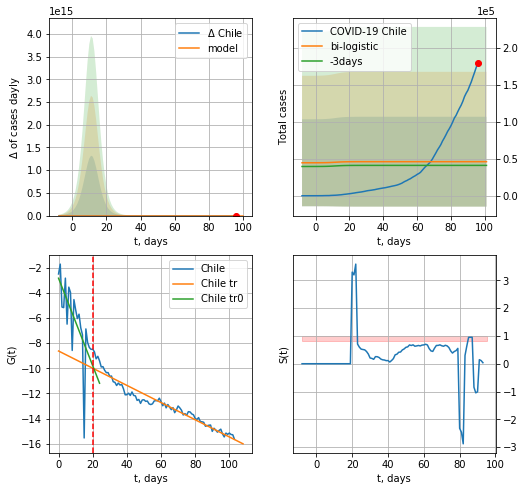

Chile data at: 2020-06-15
+3 day model MAPE: 0.12216581360435365
model: bi-logistic
coeffs:  [ 3.56951306e+04 -8.23366145e+00  2.09615402e+02] [1.48337612e+03 3.52807696e-01 1.17654757e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3190375398108252
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  46102 ± 60810
	 total death:  863 ± 3414
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.470301
 intercept: -2.832141
 slope: -0.348208
trend coefficient of determination: 0.933748
 intercept: -8.626142
 slope: -0.068414


In [243]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,7*12-dT)
xx = forecast2('Chile',dfCL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


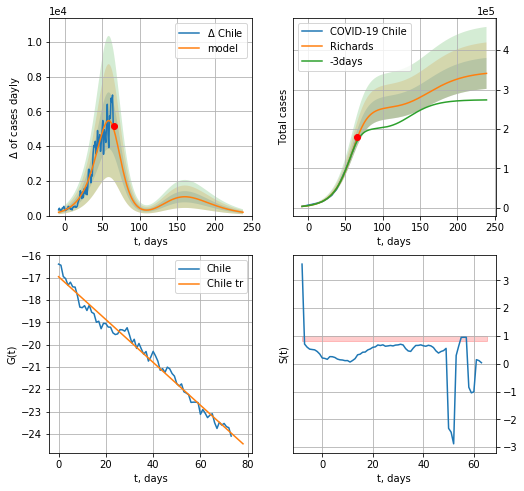

Chile data at: 2020-06-15
+3 day model MAPE: 0.051911
model: Richards
coeffs: [2.54335161e+05 6.12693049e-02 6.44219885e+01 1.69876236e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.115416
forecast at the end of period: +173 days
	 deltaDaycases: 192
	 total cases: 340977 ± 39354
	 total death: 6388 ± 2211
trend coefficient of determination: 0.984179
 intercept: -16.955756
 slope: -0.096055


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


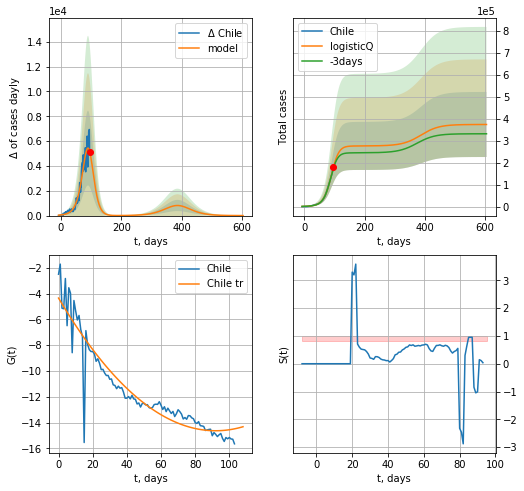

Chile data at: 2020-06-15
+3 day model MAPE: 0.027233
model: logisticQ
coeffs: [ 2.75948213e+05  1.80336620e-04  8.86544263e+01 -3.46997079e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.396107
forecast at the end of period: +509 days
	 deltaDaycases: 1
	 total cases: 373626 ± 147996
	 total death: 7000 ± 8318
trend coefficient of determination: 0.883471
 intercept_: -4.3426942120461955
 coeffs_: [ 0.         -0.22384849  0.00121696]


In [244]:
vL = 19+10
x = forecastRR('Chile',dfCL[30:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Chile',dfCL[10:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

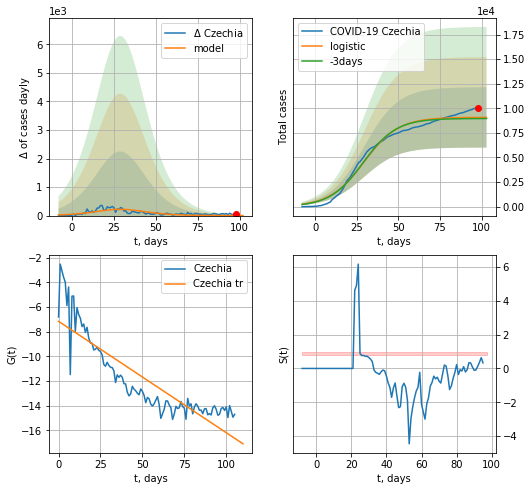

Czechia data at: 2020-06-15
+3 day model MAPE: 0.012554867610158142
model: logistic
coeffs:  [9.07836362e+03 9.67296971e-02 2.92693063e+01]
rational stdev:  0.33816749794351647
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  9071 ± 3067
	 total death:  297 ± 301
trend coefficient of determination: 0.757933
 intercept: -7.163517
 slope: -0.090175


In [245]:
x = forecast('Czechia',dfCH[:],d1,12*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


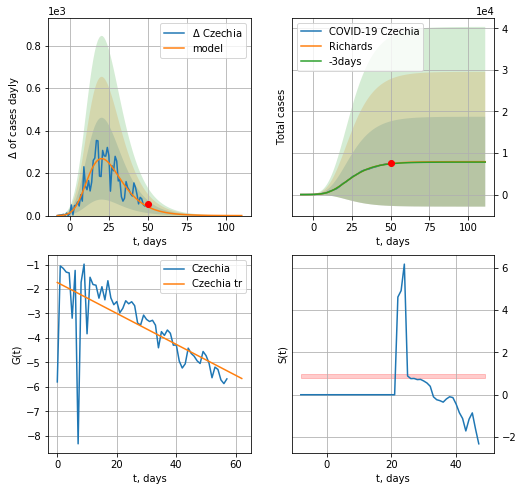

Czechia data at: 2020-06-15
+3 day model MAPE: 0.007369
model: Richards
coeffs: [ 7.90689533e+03  1.12645119e+00 -4.69210858e+00  8.53971991e-02]
rational stdev: 1.366945
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 7905 ± 10806
	 total death: 259 ± 1062
trend coefficient of determination: 0.470375
 intercept: -1.735202
 slope: -0.063324


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


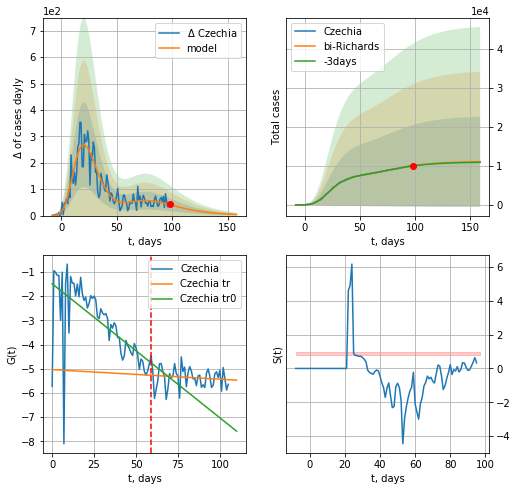

Czechia data at: 2020-06-15
+3 day model MAPE: 0.003952
model: bi-Richards
coeffs: [ 3.26623682e+03  2.50354107e+00 -9.87810813e+00  1.80044230e-02]
rational stdev: 1.040780
forecast at the end of period: +61 days
	 deltaDaycases: 4
	 total cases: 11084 ± 11536
	 total death: 363 ± 1133
bi-Richards approximation splitting point: 59
trend coefficient of determination: 0.405304
 intercept: -1.492454
 slope: -0.055348
trend coefficient of determination: 0.016506
 intercept: -5.037059
 slope: -0.003950


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


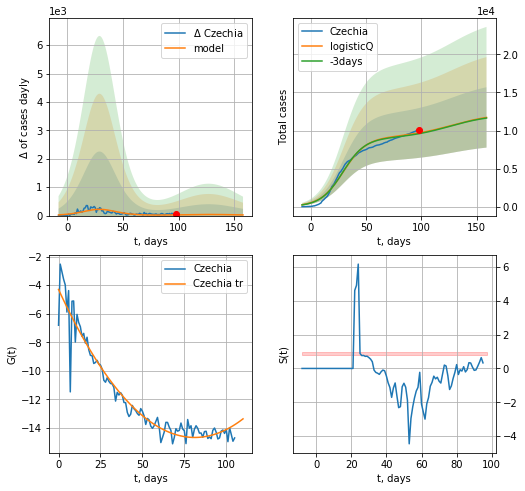

Czechia data at: 2020-06-15
+3 day model MAPE: 0.009882
model: logisticQ
coeffs: [ 9.07839011e+03  1.87363456e-07  2.92703247e+01 -5.16078858e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338210
forecast at the end of period: +61 days
	 deltaDaycases: 23
	 total cases: 11720 ± 3964
	 total death: 384 ± 389
trend coefficient of determination: 0.930141
 intercept_: -4.305492687951081
 coeffs_: [ 0.         -0.25506646  0.00157042]


In [246]:
vL= 59
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

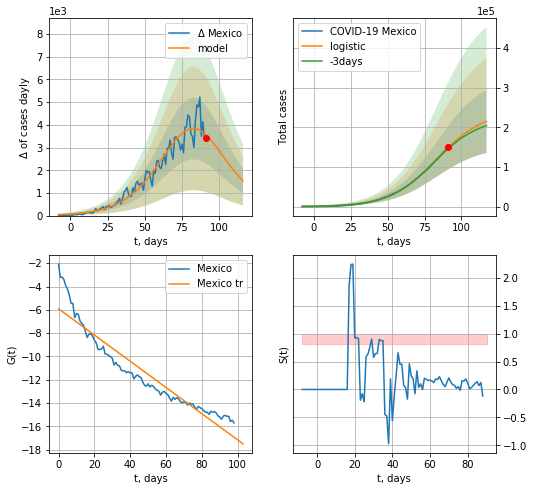

Mexico data at: 2020-06-15
+3 day model MAPE: 0.019939655528403592
model: logistic
coeffs:  [2.35657503e+05 6.48719337e-02 8.28591704e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.36953173570458825
forecast at the end of period: +26 days
	 deltaDaycases:  1537
	 total cases:  214858 ± 79396
	 total death:  25137 ± 27866
trend coefficient of determination: 0.899321
 intercept: -5.913300
 slope: -0.112415


In [247]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


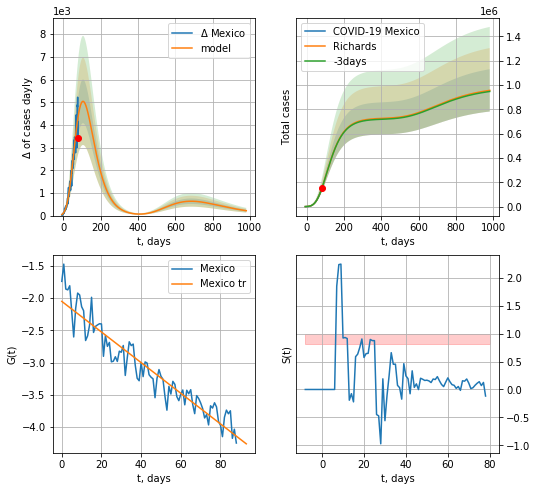

Mexico data at: 2020-06-15
+3 day model MAPE: 0.001136
model: Richards
coeffs: [ 7.27353465e+05  4.89661362e-01 -6.24488623e+01  3.92119851e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.181948
forecast at the end of period: +901 days
	 deltaDaycases: 215
	 total cases: 955701 ± 173887
	 total death: 111811 ± 61031
trend coefficient of determination: 0.901564
 intercept: -2.049577
 slope: -0.023768


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


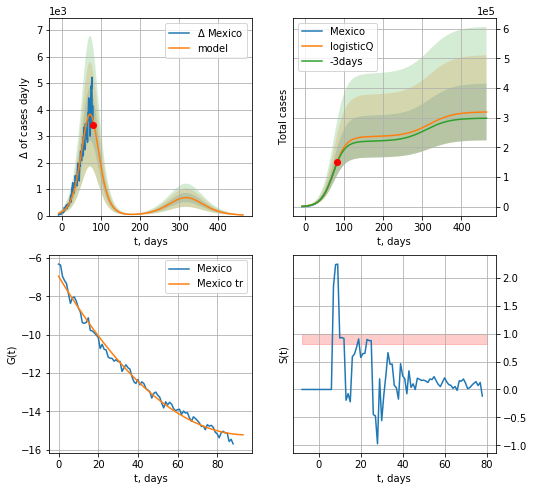

Mexico data at: 2020-06-15
+3 day model MAPE: 0.019974
model: logisticQ
coeffs: [ 2.36019901e+05  2.02060424e-06  7.29096449e+01 -3.20121358e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.299688
forecast at the end of period: +383 days
	 deltaDaycases: 23
	 total cases: 318902 ± 95571
	 total death: 37309 ± 33543
trend coefficient of determination: 0.990390
 intercept_: -6.954501973617022
 coeffs_: [ 0.         -0.1734593   0.00090814]


In [248]:
x = forecastRR('Mexico',dfMX[10:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date   cases  active  death     tests
94 2020-06-11  1756.0     282   74.0  356062.0
95 2020-06-12  1763.0     262   75.0  360670.0
96 2020-06-13  1768.0     256   75.0  363528.0
97 2020-06-14  1773.0     268   76.0  365136.0
98 2020-06-15  1776.0     259   76.0  369546.0


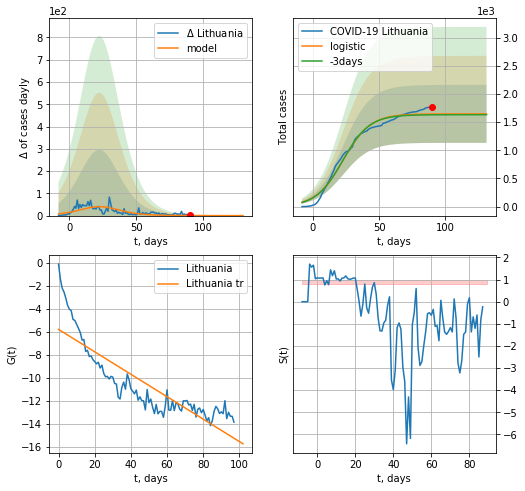

Lithuania data at: 2020-06-15
+3 day model MAPE: 0.009188587212179055
model: logistic
coeffs:  [1.64844278e+03 9.74315039e-02 2.29363868e+01]
rational stdev:  0.3124413301494323
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1648 ± 515
	 total death:  70 ± 65
trend coefficient of determination: 0.744920
 intercept: -5.787467
 slope: -0.097630


In [364]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [365]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [366]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


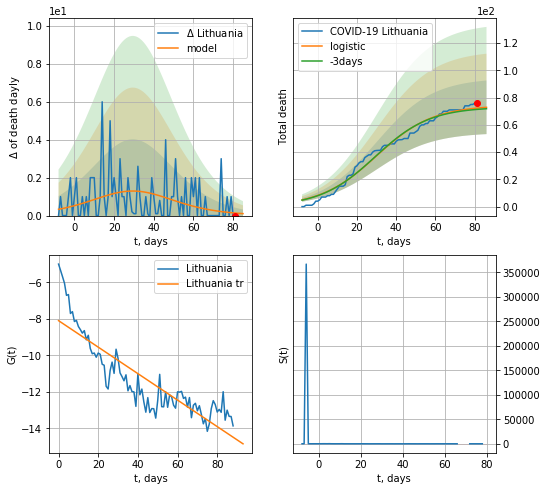

Lithuania data at: 2020-06-15
+3 day model MAPE: 0.01374852097810622
model: logistic
coeffs:  [7.43860754e+01 6.96206642e-02 2.99116942e+01]
rational stdev:  0.26986920476250303
forecast at the end of period: +5 days
	 total death:  72 ± 19
trend coefficient of determination: 0.755934
 intercept: -8.101184
 slope: -0.072554


In [367]:
x = forecast('Lithuania',dfLT[9:],d1,7*12-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


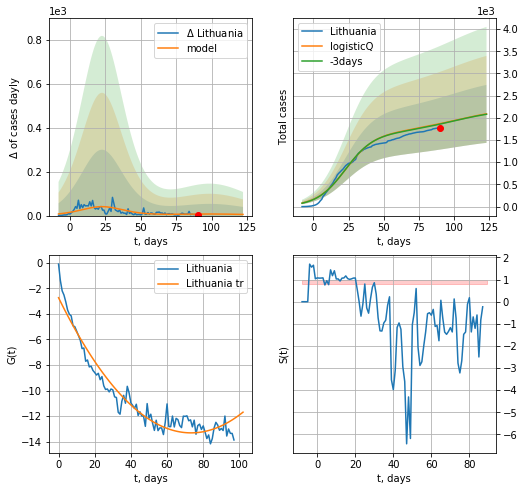

Lithuania data at: 2020-06-15
+3 day model MAPE: 0.004789
model: logisticQ
coeffs: [ 1.64844164e+03  2.19794748e-07  2.29372326e+01 -4.43125340e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312468
forecast at the end of period: +33 days
	 deltaDaycases: 5
	 total cases: 2089 ± 652
	 total death: 89 ± 83
trend coefficient of determination: 0.938626
 intercept_: -2.7342733326901385
 coeffs_: [ 0.         -0.28846229  0.00196738]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


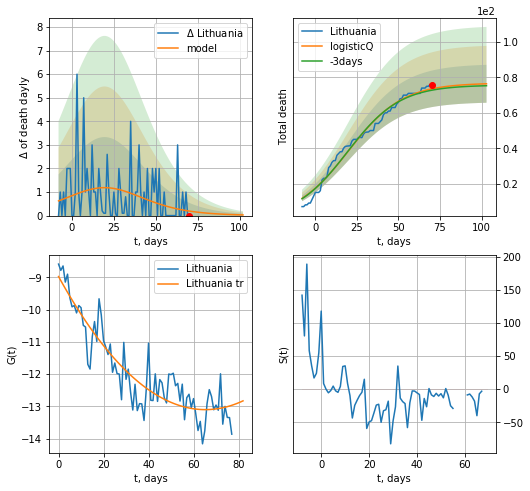

Lithuania data at: 2020-06-15
+3 day model MAPE: 0.010725
model: logisticQ
coeffs: [ 7.68705204e+01  4.23498745e-07  1.98939828e+01 -1.45642852e+05]
rational stdev: 0.140233
forecast at the end of period: +33 days
	 total death: 76 ± 10
trend coefficient of determination: 0.824095
 intercept_: -8.975772175751764
 coeffs_: [ 0.         -0.12655859  0.00096989]


In [368]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


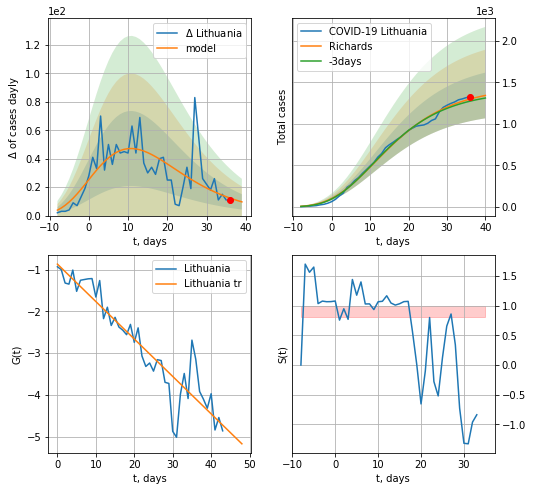

Lithuania data at: 2020-06-15
+3 day model MAPE: 0.021066
model: Richards
coeffs: [ 1.45212959e+03  9.67658542e+00 -4.16678055e+01  9.16998413e-03]
rational stdev: 0.205046
forecast at the end of period: +4 days
	 deltaDaycases: 9
	 total cases: 1343 ± 275
	 total death: 57 ± 35
trend coefficient of determination: 0.866665
 intercept: -0.867769
 slope: -0.089640


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


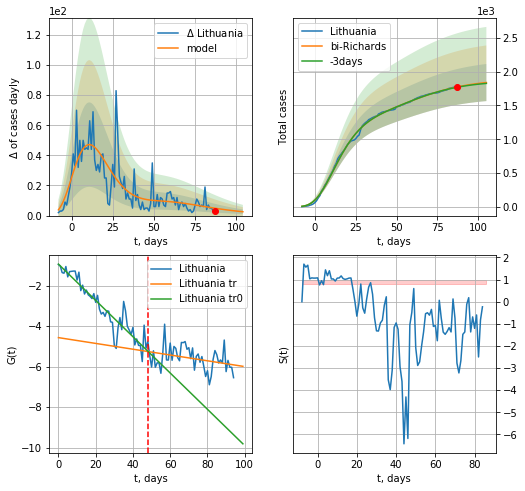

Lithuania data at: 2020-06-15
+3 day model MAPE: 0.002902
model: bi-Richards
coeffs: [ 4.43098380e+02  2.22286377e+00 -1.80430622e+01  2.13758996e-02]
rational stdev: 0.149213
forecast at the end of period: +18 days
	 deltaDaycases: 2
	 total cases: 1838 ± 274
	 total death: 78 ± 34
bi-Richards approximation splitting point: 48
trend coefficient of determination: 0.874425
 intercept: -0.930109
 slope: -0.089729
trend coefficient of determination: 0.112475
 intercept: -4.563709
 slope: -0.014324


In [369]:
vL = 48
x = forecastRR('Lithuania',dfLT[3:vL],d1,12*7-1-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[3:],d1,14*7-1-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


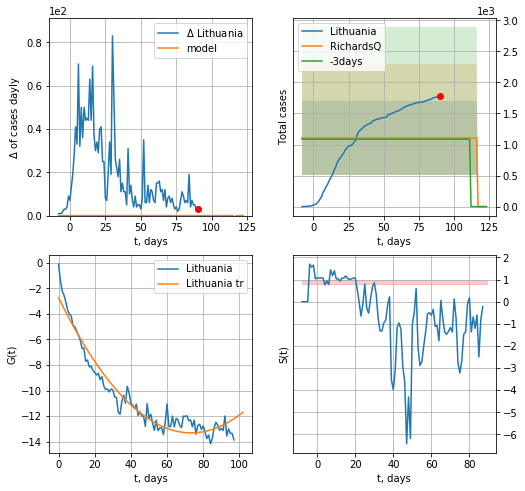

Lithuania data at: 2020-06-15
+3 day model MAPE: 0.019169
model: RichardsQ
coeffs: [ 1.10640505e+03 -1.88088931e+00 -1.47208121e+02  1.16326331e+02
  2.06315128e-01]
rational stdev: 0.538729
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 0 ± 0
	 total death: 0 ± 0
trend coefficient of determination: 0.938626
 intercept_: -2.7342733326901385
 coeffs_: [ 0.         -0.28846229  0.00196738]


In [370]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
96  2020-06-11  4052.0      32  110.0
97  2020-06-12  4055.0      27  110.0
98  2020-06-13  4063.0      31  110.0
99  2020-06-14  4070.0      31  110.0
100 2020-06-15  4072.0      31  110.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


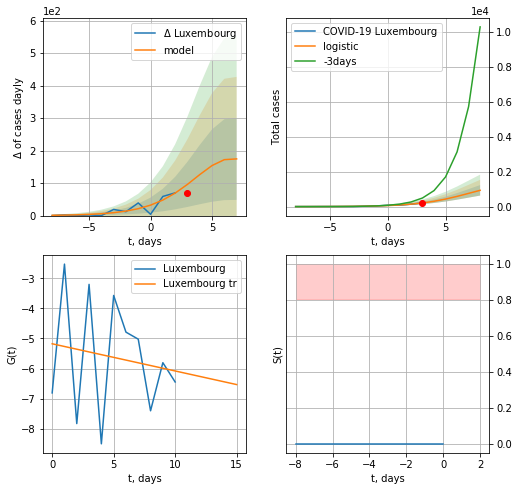

Luxembourg data at: 2020-06-15
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +5 days
	 deltaDaycases:  174
	 total cases:  932 ± 299
	 total death:  25 ± 24
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


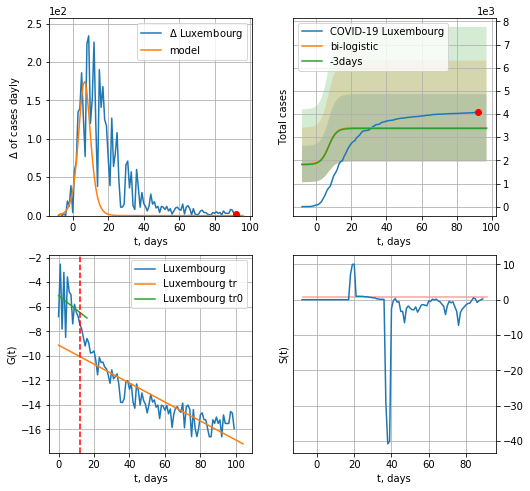

Luxembourg data at: 2020-06-15
+3 day model MAPE: 0.008845392591909203
model: bi-logistic
coeffs:  [1638.21581331   -6.40388312  239.93156685] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.4261639365872069
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  3405 ± 1451
	 total death:  92 ± 117
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.793698
 intercept: -9.134678
 slope: -0.077289


In [250]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,12*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,12*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


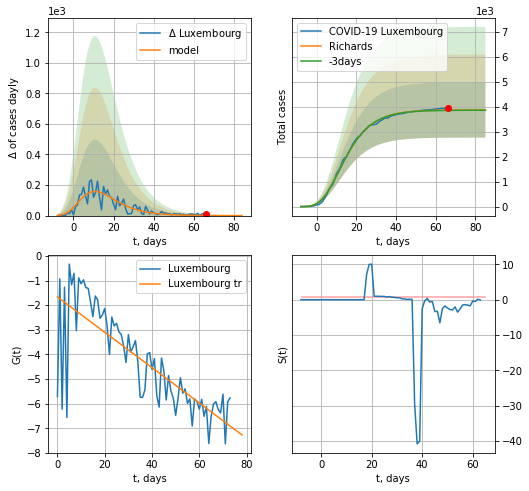

Luxembourg data at: 2020-06-15
+3 day model MAPE: 0.003345
model: Richards
coeffs: [ 3.88162927e+03  1.99569941e+01 -3.56216724e+01  5.55736951e-03]
rational stdev: 0.285969
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 3880 ± 1109
	 total death: 104 ± 89
trend coefficient of determination: 0.626779
 intercept: -1.663811
 slope: -0.071855


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


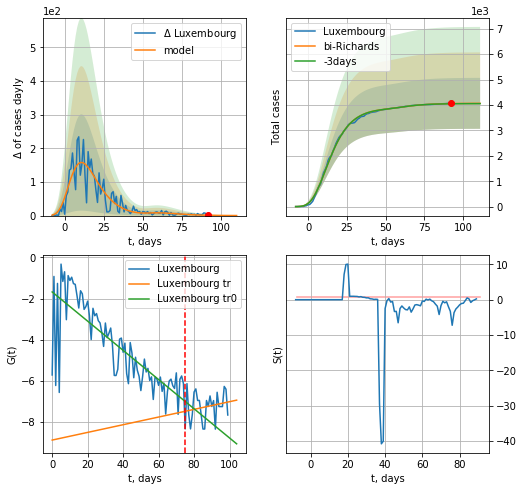

Luxembourg data at: 2020-06-15
+3 day model MAPE: 0.001968
model: bi-Richards
coeffs: [1.85380671e+02 2.08062162e+01 6.96609132e+00 4.62731743e-03]
rational stdev: 0.246689
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 4065 ± 1002
	 total death: 109 ± 80
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.628317
 intercept: -1.680887
 slope: -0.070908
trend coefficient of determination: 0.038300
 intercept: -8.873646
 slope: 0.018639


In [251]:
vL = 75
x = forecastRR("Luxembourg",dfLX[:vL],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[:],d1,14*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


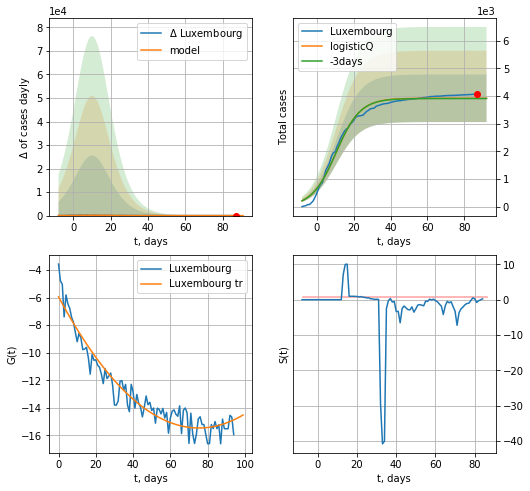

Luxembourg data at: 2020-06-15
+3 day model MAPE: 0.002502
model: logisticQ
coeffs: [ 3.91737838e+03  5.17266914e-07  1.04864147e+01 -2.94699164e+05]
rational stdev: 0.219158
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 3917 ± 858
	 total death: 105 ± 69
trend coefficient of determination: 0.926776
 intercept_: -5.946918008601553
 coeffs_: [ 0.         -0.25263367  0.00167728]


In [252]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,12*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
103 2020-06-11  44440.5  18858.5  3720.0
104 2020-06-12  45778.0  19271.0  3828.0
105 2020-06-13  46356.0  19617.0  3874.0
106 2020-06-14  46751.0  19791.0  3896.0
107 2020-06-15  47322.0  20044.0  3929.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


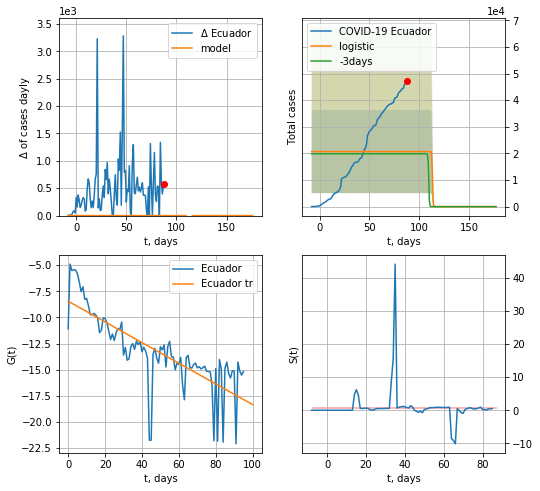

Ecuador data at: 2020-06-15
+3 day model MAPE: 0.04198722696598659
model: logistic
coeffs:  [ 2.06885573e+04 -3.75590016e+00  1.13152873e+02]
rational stdev:  0.7550447461970745
forecast at the end of period: +89 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.603033
 intercept: -8.447335
 slope: -0.098948


In [253]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


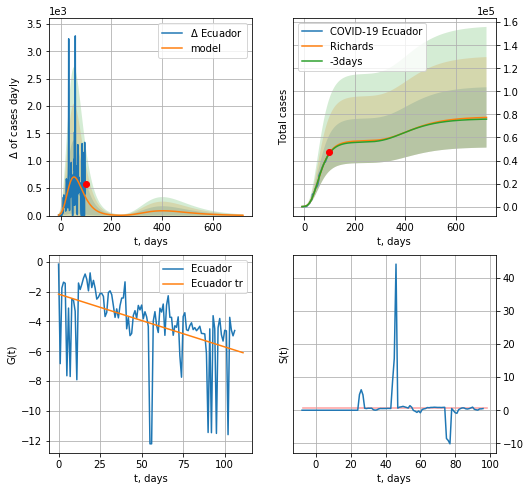

Ecuador data at: 2020-06-15
+3 day model MAPE: 0.008281
model: Richards
coeffs: [ 5.71689681e+04  1.93949121e+00 -6.62514900e+01  1.74475648e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.338340
forecast at the end of period: +621 days
	 deltaDaycases: 5
	 total cases: 77367 ± 26176
	 total death: 6423 ± 6519
trend coefficient of determination: 0.207270
 intercept: -2.165840
 slope: -0.035365


In [254]:
x = forecastRR("Ecuador",dfED[:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


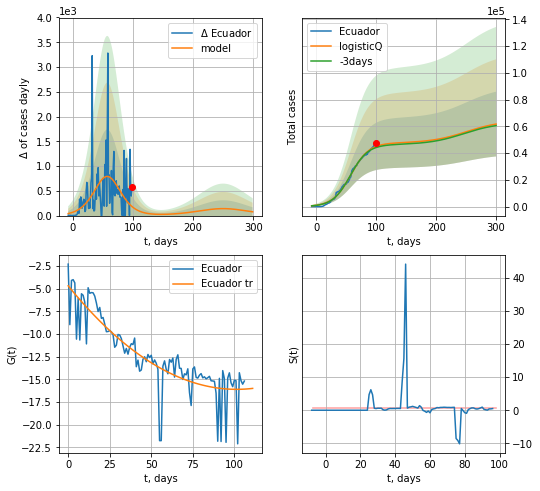

Ecuador data at: 2020-06-15
+3 day model MAPE: 0.018060
model: logisticQ
coeffs: [ 4.75347378e+04  5.07816864e-07  5.74472562e+01 -1.30973901e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392274
forecast at the end of period: +201 days
	 deltaDaycases: 76
	 total cases: 61681 ± 24195
	 total death: 5121 ± 6026
trend coefficient of determination: 0.731242
 intercept_: -4.6894492988746626
 coeffs_: [ 0.         -0.22502872  0.00111001]


In [255]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
107 2020-06-11  7064.0     539  325.0
108 2020-06-12  7073.0     548  325.0
109 2020-06-13  7087.0     562  325.0
110 2020-06-14  7104.0     578  326.0
111 2020-06-15  7108.0     582  326.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


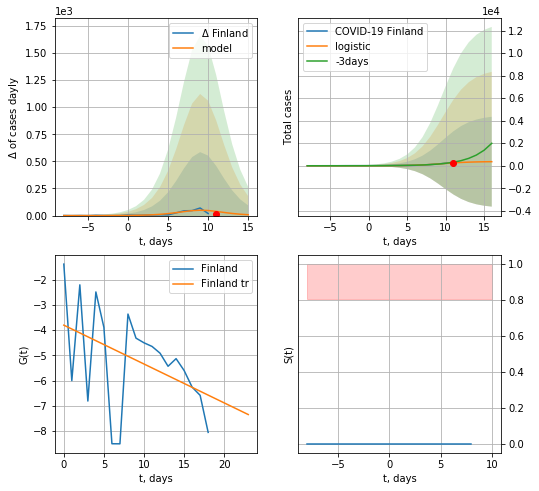

Finland data at: 2020-06-15
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +5 days
	 deltaDaycases:  7
	 total cases:  361 ± 3986
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


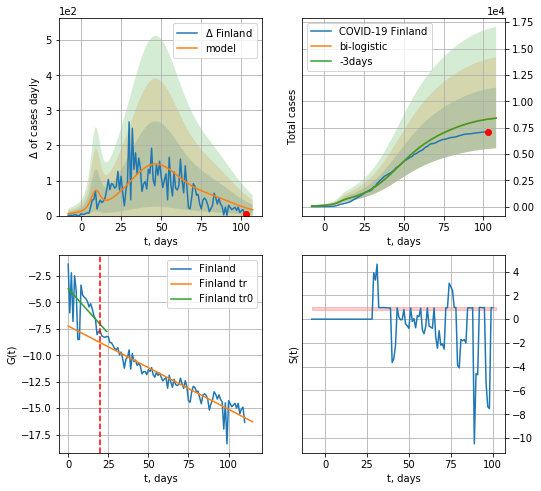

Finland data at: 2020-06-15
+3 day model MAPE: 0.003467116316939713
model: bi-logistic
coeffs:  [6.59995243e+03 8.56955524e-02 4.61670683e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3421710460290349
forecast at the end of period: +5 days
	 deltaDaycases:  16
	 total cases:  8415 ± 2879
	 total death:  385 ± 395
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.898051
 intercept: -7.234308
 slope: -0.078790


In [256]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*12-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


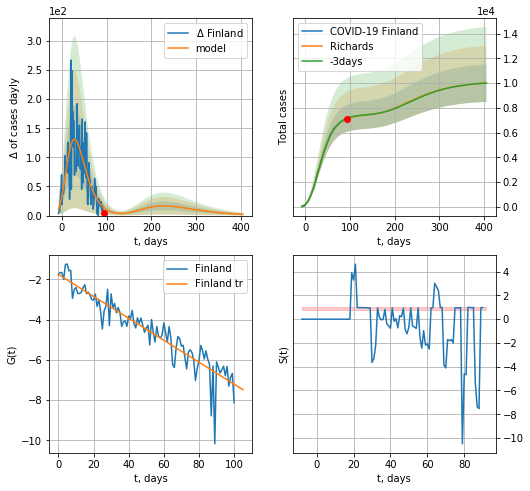

Finland data at: 2020-06-15
+3 day model MAPE: 0.001112
model: Richards
coeffs: [ 7.43664960e+03  6.87609802e-01 -2.45288026e+01  7.22011154e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.151415
forecast at the end of period: +313 days
	 deltaDaycases: 2
	 total cases: 10001 ± 1514
	 total death: 458 ± 208
trend coefficient of determination: 0.865902
 intercept: -1.758412
 slope: -0.054493


In [257]:
x = forecastRR("Finland",dfFI[10:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


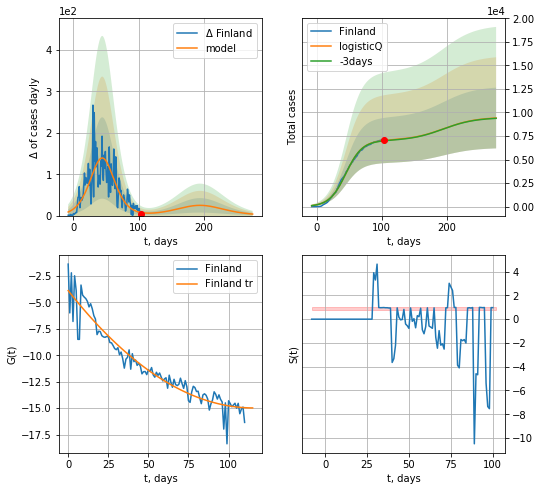

Finland data at: 2020-06-15
+3 day model MAPE: 0.003758
model: logisticQ
coeffs: [ 7.02037792e+03  4.07030204e-07  4.46730838e+01 -1.94596617e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342754
forecast at the end of period: +173 days
	 deltaDaycases: 3
	 total cases: 9413 ± 3226
	 total death: 431 ± 443
trend coefficient of determination: 0.918291
 intercept_: -3.8907217283428803
 coeffs_: [ 0.         -0.19214797  0.00083218]


In [258]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
          date  cases  active  death
93 2020-06-11   3086  1230.0  168.0
94 2020-06-12   3191  1303.0  172.0
95 2020-06-13   3266  1371.0  172.0
96 2020-06-14   3290  1386.0  174.0
97 2020-06-15   3341  1381.0  176.0


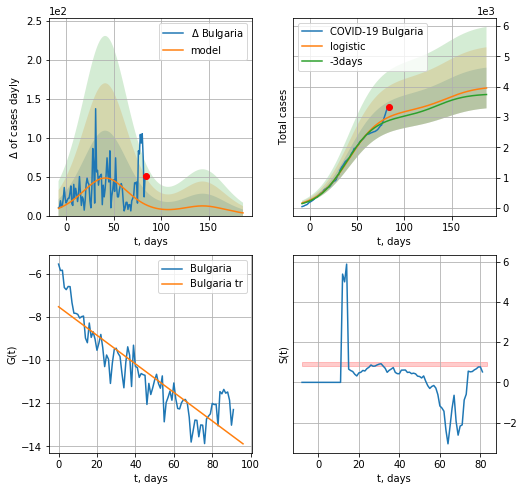

Bulgaria data at: 2020-06-15
+3 day model MAPE: 0.04047581260799877
model: logistic
coeffs:  [3.21305166e+03 5.98642495e-02 4.14457558e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.16986748955085063
forecast at the end of period: +103 days
	 deltaDaycases:  3
	 total cases:  3955 ± 671
	 total death:  208 ± 105
trend coefficient of determination: 0.802992
 intercept: -7.534479
 slope: -0.066127


In [259]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


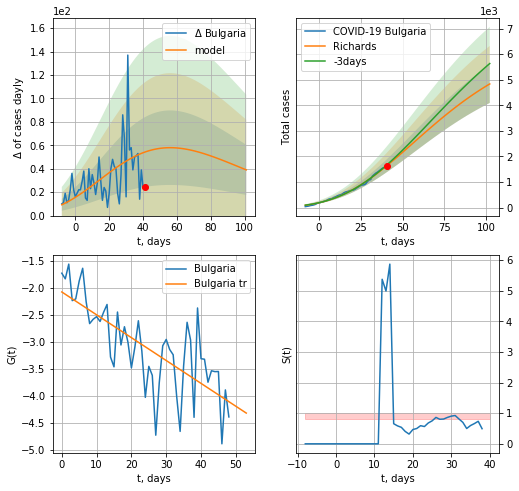

Bulgaria data at: 2020-06-15
+3 day model MAPE: 0.021566
model: Richards
coeffs: [ 6.82239698e+03  9.82140376e-01 -1.03460331e+02  2.37912148e-02]
rational stdev: 0.153653
forecast at the end of period: +61 days
	 deltaDaycases: 39
	 total cases: 4835 ± 743
	 total death: 254 ± 117
trend coefficient of determination: 0.552954
 intercept: -2.070769
 slope: -0.042350


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp


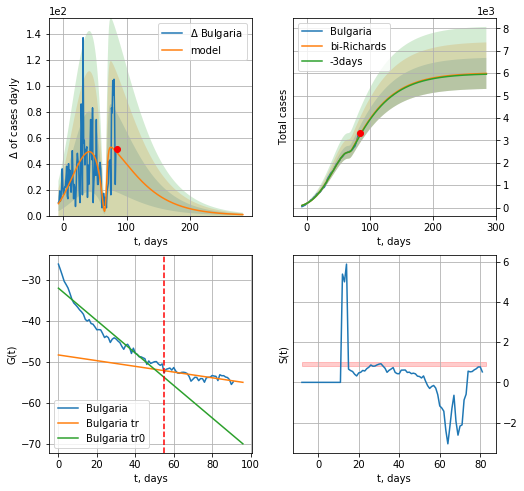

Bulgaria data at: 2020-06-15
+3 day model MAPE: 0.010383
model: bi-Richards
coeffs: [-7.99326358e+02  1.06860482e-01  6.81260796e+01  6.25037047e+00]
rational stdev: 0.115636
forecast at the end of period: +201 days
	 deltaDaycases: 0
	 total cases: 5990 ± 692
	 total death: 315 ± 109
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.919134
 intercept: -32.066255
 slope: -0.395112
trend coefficient of determination: 0.543332
 intercept: -48.344725
 slope: -0.069446


In [260]:
vL = 60
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,20*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,40*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


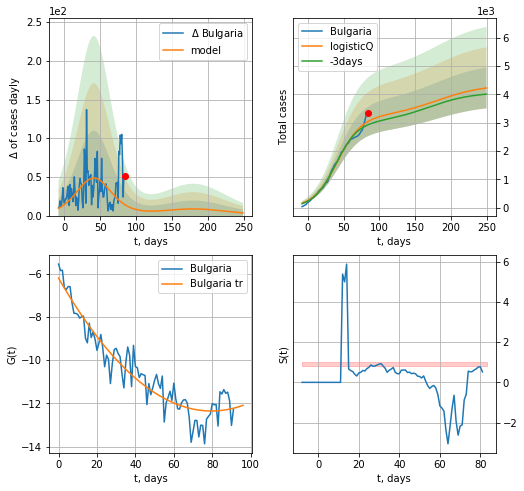

Bulgaria data at: 2020-06-15
+3 day model MAPE: 0.040403
model: logisticQ
coeffs: [ 3.21251596e+03  4.66789229e-07  4.14406830e+01 -1.28197359e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.170005
forecast at the end of period: +166 days
	 deltaDaycases: 3
	 total cases: 4224 ± 718
	 total death: 222 ± 113
trend coefficient of determination: 0.900753
 intercept_: -6.208949350572942
 coeffs_: [ 0.         -0.1545001   0.00097116]


In [261]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
105 2020-06-11  3129.0    84.0   58.0
106 2020-06-12  3134.0    89.0   58.0
107 2020-06-13  3135.0    90.0   58.0
108 2020-06-14  3135.0    90.0   58.0
109 2020-06-15  3135.0    84.0   58.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


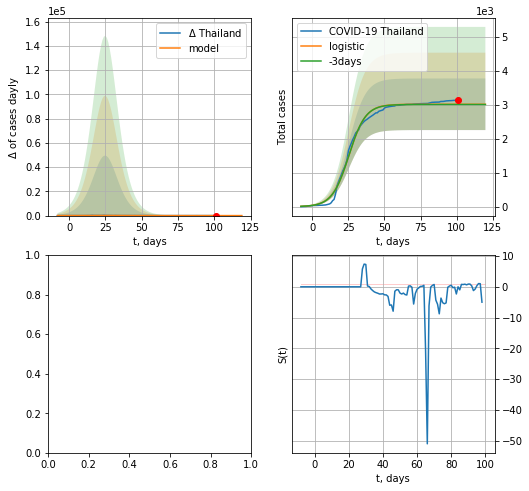

In [262]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,14*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [263]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


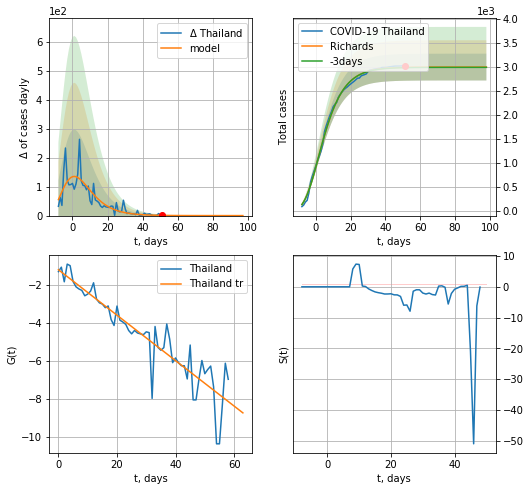

Thailand data at: 2020-06-15
+3 day model MAPE: 0.001961
model: Richards
coeffs: [ 2.99626186e+03  1.57389308e+01 -3.79335147e+01  7.82164356e-03]
rational stdev: 0.093313
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 55 ± 15
trend coefficient of determination: 0.845848
 intercept: -1.208266
 slope: -0.119672


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

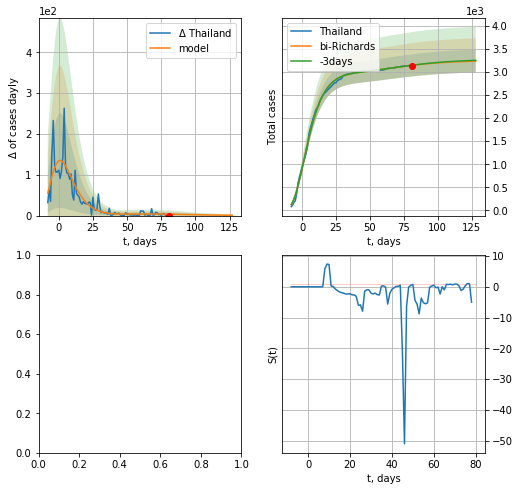

In [264]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


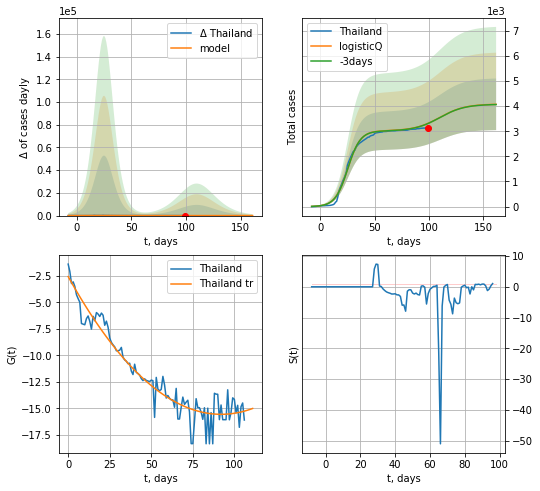

Thailand data at: 2020-06-13
+3 day model MAPE: 0.001654
model: logisticQ
coeffs: [ 3.01437328e+03  6.85733766e-07  2.52675646e+01 -2.52167129e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.252183
forecast at the end of period: +63 days
	 deltaDaycases: 1
	 total cases: 4070 ± 1026
	 total death: 75 ± 56
trend coefficient of determination: 0.926528
 intercept_: -2.5602917166318697
 coeffs_: [ 0.         -0.28244632  0.00153433]


In [286]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

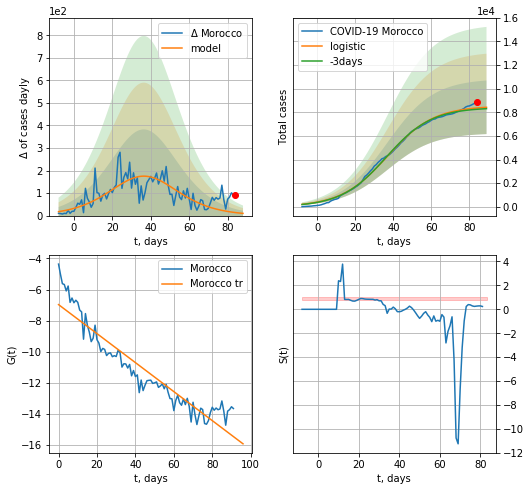

Morocco data at: 2020-06-15
+3 day model MAPE: 0.013519442275704126
model: logistic
coeffs:  [8.53597110e+03 8.20770262e-02 3.68383394e+01]
rational stdev:  0.2691806989691154
forecast at the end of period: +5 days
	 deltaDaycases:  9
	 total cases:  8419 ± 2266
	 total death:  200 ± 161
trend coefficient of determination: 0.884803
 intercept: -6.969331
 slope: -0.093394


In [265]:
x = forecast("Morocco",dfMR[5:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


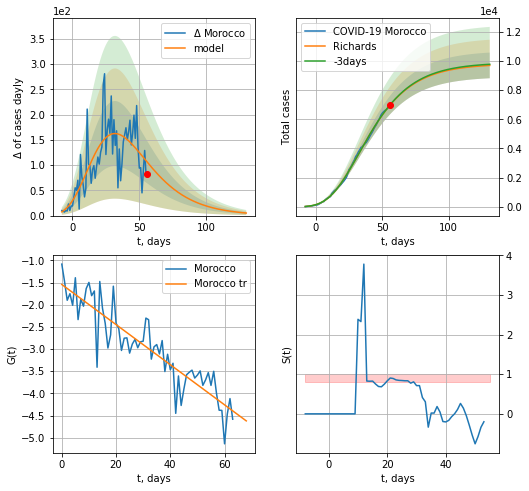

Morocco data at: 2020-06-15
+3 day model MAPE: 0.002852
model: Richards
coeffs: [ 9.80082879e+03  2.81104179e+00 -5.85537911e+01  1.61651724e-02]
rational stdev: 0.090720
forecast at the end of period: +75 days
	 deltaDaycases: 5
	 total cases: 9691 ± 879
	 total death: 231 ± 62
trend coefficient of determination: 0.815684
 intercept: -1.542965
 slope: -0.045264


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


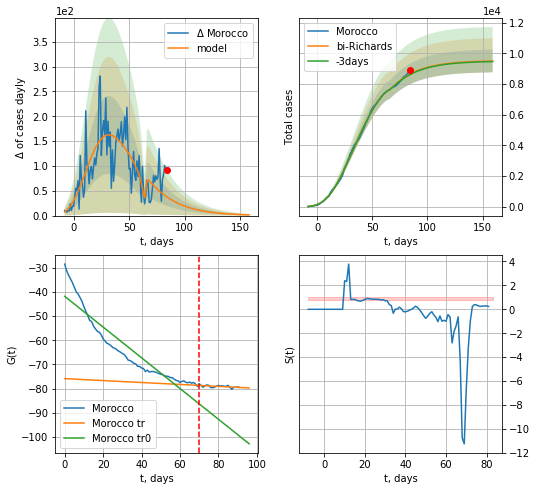

Morocco data at: 2020-06-15
+3 day model MAPE: 0.004519
model: bi-Richards
coeffs: [-2.64467094e+02  2.60782811e-01  6.54265676e+01  8.24005945e+00]
rational stdev: 0.077827
forecast at the end of period: +75 days
	 deltaDaycases: 1
	 total cases: 9505 ± 739
	 total death: 226 ± 52
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874953
 intercept: -41.799692
 slope: -0.635494
trend coefficient of determination: 0.267462
 intercept: -75.849493
 slope: -0.040074


In [266]:
vL = 70 + 5
x = forecastRR("Morocco",dfMR[5:vL-5],d1,22*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


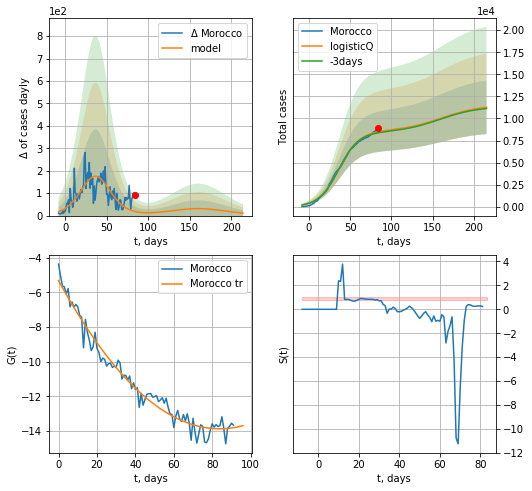

Morocco data at: 2020-06-15
+3 day model MAPE: 0.013252
model: logisticQ
coeffs: [ 8.53538429e+03  6.15856772e-07  3.68373591e+01 -1.33204210e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.269315
forecast at the end of period: +131 days
	 deltaDaycases: 10
	 total cases: 11269 ± 3035
	 total death: 268 ± 216
trend coefficient of determination: 0.969609
 intercept_: -5.308288200349012
 coeffs_: [ 0.         -0.2041363   0.00121699]


In [267]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

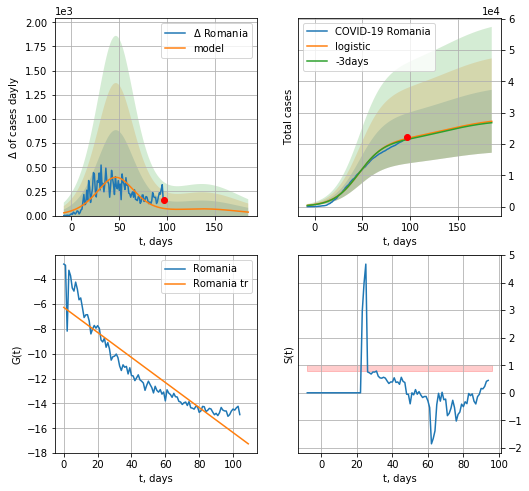

Romania data at: 2020-06-15
+3 day model MAPE: 0.01603809049268034
model: logistic
coeffs:  [2.10176036e+04 7.39091995e-02 4.66620430e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.36879084956006614
forecast at the end of period: +89 days
	 deltaDaycases:  36
	 total cases:  27237 ± 10044
	 total death:  1753 ± 1939
trend coefficient of determination: 0.852379
 intercept: -6.282900
 slope: -0.100602


In [268]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


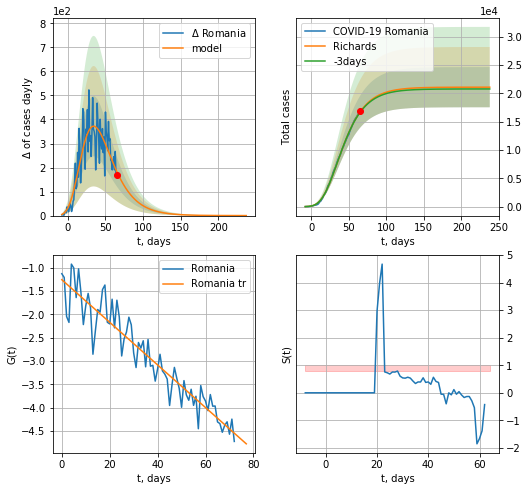

Romania data at: 2020-06-15
+3 day model MAPE: 0.005850
model: Richards
coeffs: [ 2.10984931e+04  4.16077879e+00 -5.77105071e+01  1.15870983e-02]
rational stdev: 0.168180
forecast at the end of period: +173 days
	 deltaDaycases: 0
	 total cases: 21097 ± 3548
	 total death: 1358 ± 685
trend coefficient of determination: 0.890440
 intercept: -1.255986
 slope: -0.045756


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


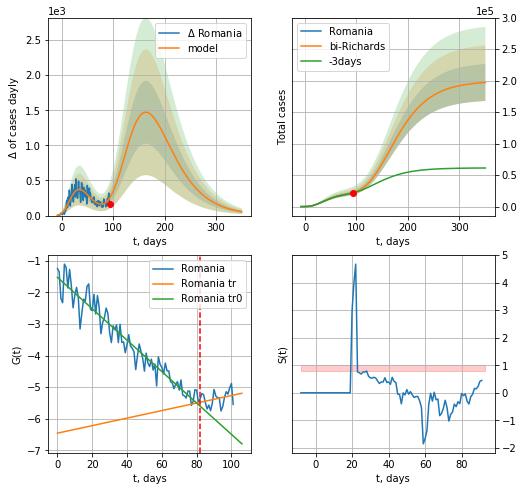

Romania data at: 2020-06-15
+3 day model MAPE: 0.009840
model: bi-Richards
coeffs: [1.78304996e+05 3.54480430e-01 4.62185945e+01 6.52663725e-02]
rational stdev: 0.149177
forecast at the end of period: +257 days
	 deltaDaycases: 54
	 total cases: 197053 ± 29395
	 total death: 12686 ± 5677
bi-Richards approximation splitting point: 82
trend coefficient of determination: 0.928384
 intercept: -1.521048
 slope: -0.049745
trend coefficient of determination: 0.083412
 intercept: -6.456665
 slope: 0.011920


In [269]:
vL = 82+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,48*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


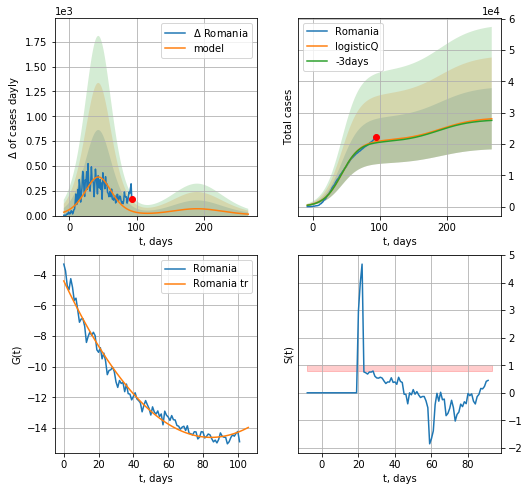

Romania data at: 2020-06-15
+3 day model MAPE: 0.017794
model: logisticQ
coeffs: [ 2.10304225e+04  2.95542172e-07  4.36835134e+01 -2.49359478e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348409
forecast at the end of period: +173 days
	 deltaDaycases: 14
	 total cases: 28067 ± 9779
	 total death: 1807 ± 1888
trend coefficient of determination: 0.983566
 intercept_: -4.39843436574126
 coeffs_: [ 0.         -0.24134584  0.00142506]


In [270]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [271]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
124 2020-06-11  1207023  164487  129158.0
125 2020-06-12  1211816  164100  129345.0
126 2020-06-13  1216062  163115  129525.0
127 2020-06-14  1219443  162792  129627.0
128 2020-06-15  1222569  162234  129765.0


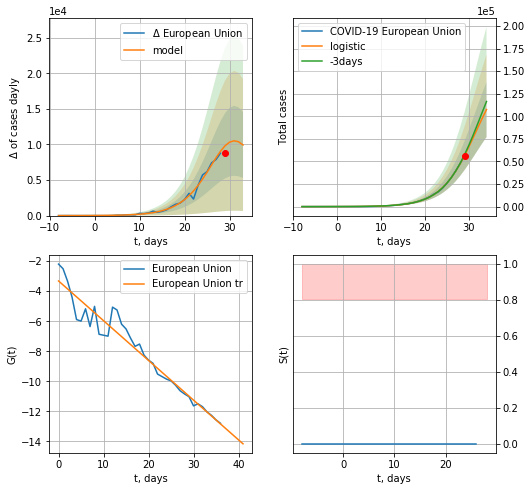

European Union data at: 2020-06-15
+3 day model MAPE: 0.026537291805373914
model: logistic
coeffs:  [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142507641165
forecast at the end of period: +5 days
	 deltaDaycases:  9926
	 total cases:  107480 ± 30503
	 total death:  11408 ± 9712
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


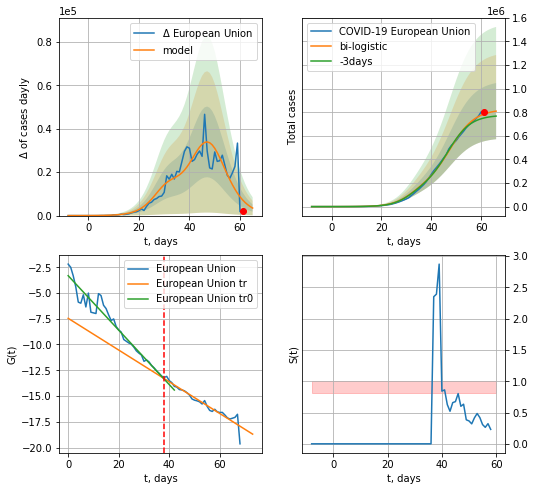

European Union data at: 2020-06-15
+3 day model MAPE: 0.046518861456193536
model: bi-logistic
coeffs:  [6.59401208e+05 2.01830792e-01 4.76685424e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888577461115
forecast at the end of period: +5 days
	 deltaDaycases:  3461
	 total cases:  809281 ± 238000
	 total death:  85898 ± 75784
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


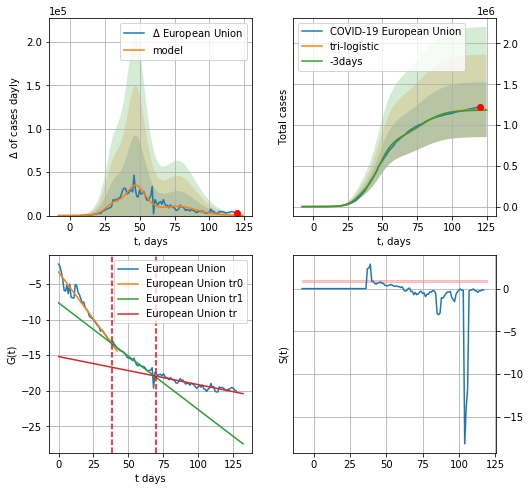

European Union data at: 2020-06-15
+3 day model MAPE: 0.006941950678002709
model: tri-logistic
coeffs:  [3.66761987e+05 1.14095775e-01 7.85547193e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01 6.59401208e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.283567448255887
forecast at the end of period: +5 days
	 deltaDaycases:  219
	 total cases:  1190158 ± 337490
	 total death:  126324 ± 107464
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.823749
 intercept: -15.200348
 slope: -0.039520


In [272]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,12*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,12*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


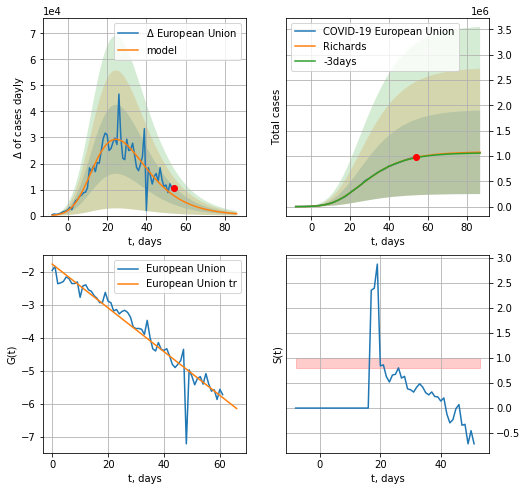

European Union data at: 2020-06-15
+3 day model MAPE: 0.007559
model: Richards
coeffs: [ 1.08235898e+06  8.91256786e-01 -6.99260106e+00  8.61059421e-02]
rational stdev: 0.768581
forecast at the end of period: +33 days
	 deltaDaycases: 731
	 total cases: 1073140 ± 824795
	 total death: 113904 ± 262633
trend coefficient of determination: 0.920526
 intercept: -1.769267
 slope: -0.066303


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


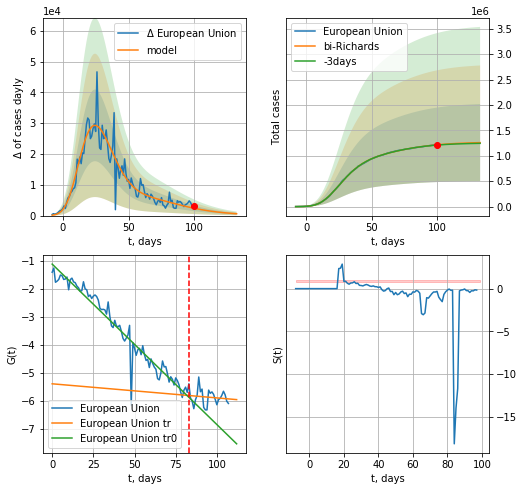

European Union data at: 2020-06-15
+3 day model MAPE: 0.004342
model: bi-Richards
coeffs: [ 1.89738246e+05  5.42338426e+00 -2.14766323e+01  8.87991518e-03]
rational stdev: 0.602686
forecast at the end of period: +33 days
	 deltaDaycases: 600
	 total cases: 1259680 ± 759192
	 total death: 133704 ± 241744
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.943360
 intercept: -1.109470
 slope: -0.057386
trend coefficient of determination: 0.016811
 intercept: -5.390264
 slope: -0.005046


In [273]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


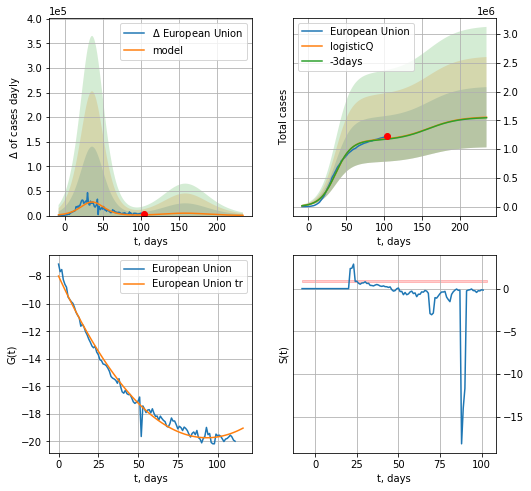

European Union data at: 2020-06-15
+3 day model MAPE: 0.006352
model: logisticQ
coeffs: [ 1.15505565e+06  2.95055081e-07  3.64056626e+01 -3.23310232e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.336936
forecast at the end of period: +131 days
	 deltaDaycases: 489
	 total cases: 1553911 ± 523568
	 total death: 164934 ± 166716
trend coefficient of determination: 0.987659
 intercept_: -7.991230292571206
 coeffs_: [ 0.         -0.25179752  0.00135   ]


In [274]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/numpy/lib/function_base.py:1269: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


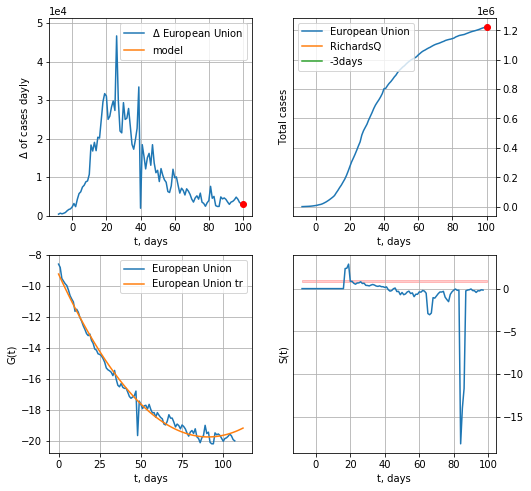

European Union data at: 2020-06-15
+3 day model MAPE: nan
model: RichardsQ
coeffs: [ 7.12807523e+05  5.02743572e+00 -1.37694698e+03  1.17229384e+03
 -2.45741060e+00]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: 0.625700
forecast at the end of period: +19 days


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:115: RuntimeWarning: invalid value encountered in double_scalars


ValueError: cannot convert float NaN to integer

In [275]:
x = forecastQR("European Union",dfEU[20:],d1,14*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [299]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [300]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [301]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [302]:
#dfIC[:]

IC
           date   cases  active  death
102 2020-06-11  1807.4       3   10.0
103 2020-06-12  1807.5       3   10.0
104 2020-06-13  1808.0       4   10.0
105 2020-06-14  1810.0       4   10.0
106 2020-06-15  1810.0       4   10.0


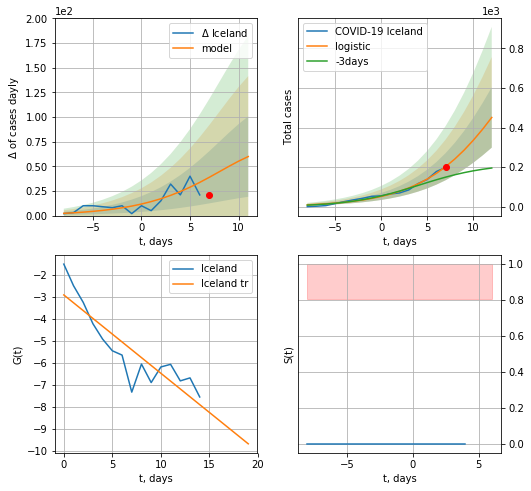

Iceland data at: 2020-06-15
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +5 days
	 deltaDaycases:  59
	 total cases:  450 ± 152
	 total death:  2 ± 2
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


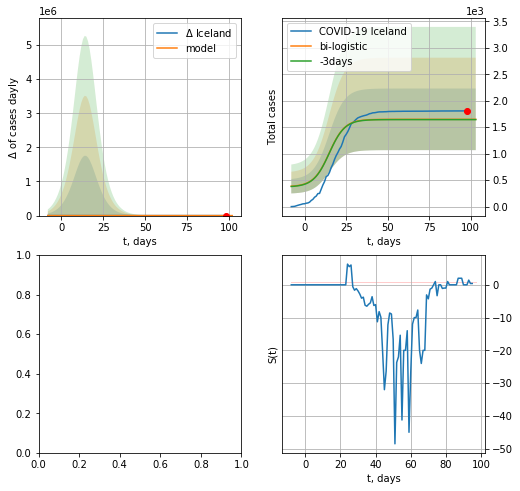

In [276]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,12*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


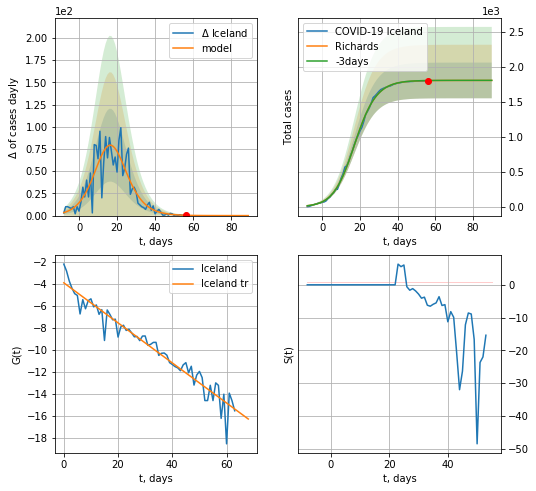

Iceland data at: 2020-06-14
+3 day model MAPE: 0.000574
model: Richards
coeffs: [1.80664071e+03 1.96329707e-01 1.60140797e+01 8.56236679e-01]
rational stdev: 0.141183
forecast at the end of period: +34 days
	 deltaDaycases: 0
	 total cases: 1806 ± 255
	 total death: 9 ± 3
trend coefficient of determination: 0.937183
 intercept: -3.923109
 slope: -0.181532


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


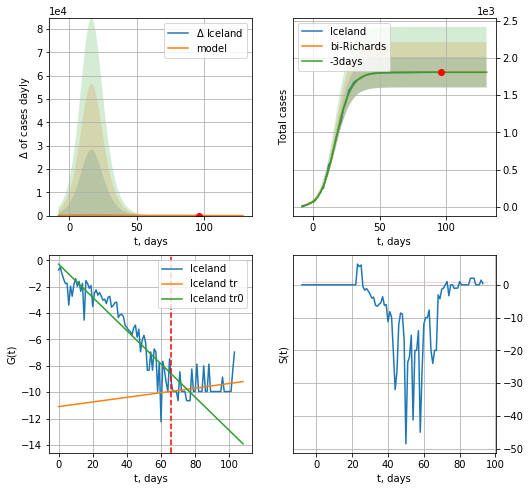

Iceland data at: 2020-06-14
+3 day model MAPE: 0.000000
model: bi-Richards
coeffs: [ 2.57433265e+00  6.72661649e-02 -3.43280189e+01  1.96312517e-02]
rational stdev: 0.112405
forecast at the end of period: +34 days
	 deltaDaycases: 0
	 total cases: 1806 ± 203
	 total death: 9 ± 3
bi-Richards approximation splitting point: 66
trend coefficient of determination: 0.839948
 intercept: -0.288067
 slope: -0.126144
trend coefficient of determination: 0.049621
 intercept: -11.089924
 slope: 0.017544


In [304]:
vL = 66
x = forecastRR("Iceland",dfIC[1:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[1:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


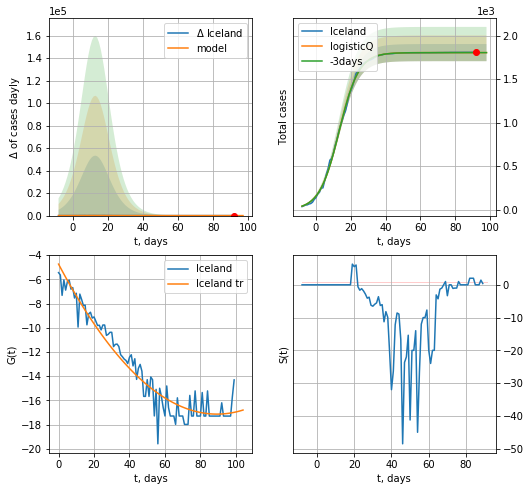

Iceland data at: 2020-06-14
+3 day model MAPE: 0.000141
model: logisticQ
coeffs: [ 1.80381226e+03  7.71890000e-06  1.33364035e+01 -2.29031701e+04]
rational stdev: 0.054556
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 1803 ± 98
	 total death: 9 ± 1
trend coefficient of determination: 0.934972
 intercept_: -4.7384714990321015
 coeffs_: [ 0.         -0.27771081  0.00155487]


In [305]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
          date  cases  active  death
93 2020-06-11  18586  7191.0  418.0
94 2020-06-12  19211  5031.0  421.0
95 2020-06-13  20059  5871.0  429.0
96 2020-06-14  20686  6483.0  437.0
97 2020-06-15  21422  7208.0  448.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


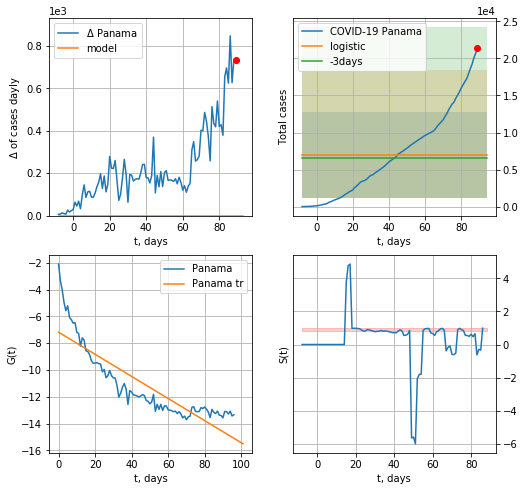

Panama data at: 2020-06-15
+3 day model MAPE: 0.06702021467927856
model: logistic
coeffs:  [ 6.93285714e+03 -5.33676552e+00  1.55875192e+02]
rational stdev:  0.8329525987909784
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  6932 ± 5774
	 total death:  144 ± 359
trend coefficient of determination: 0.757190
 intercept: -7.179322
 slope: -0.082509


In [277]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


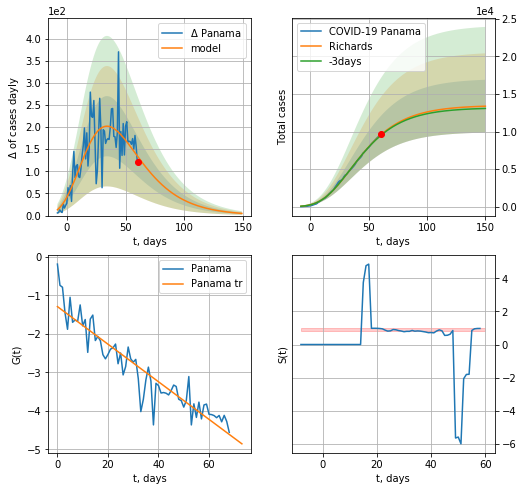

Panama data at: 2020-06-15
+3 day model MAPE: 0.008184
model: Richards
coeffs: [ 1.34885246e+04  2.34173945e+00 -6.38327516e+01  1.75366113e-02]
rational stdev: 0.263123
forecast at the end of period: +89 days
	 deltaDaycases: 4
	 total cases: 13370 ± 3518
	 total death: 279 ± 220
trend coefficient of determination: 0.871686
 intercept: -1.291480
 slope: -0.048815


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


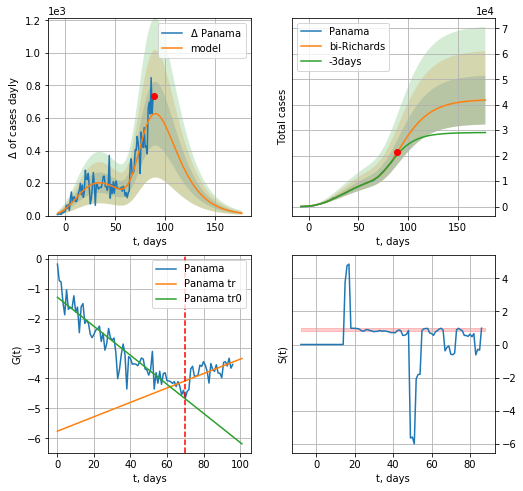

Panama data at: 2020-06-15
+3 day model MAPE: 0.048397
model: bi-Richards
coeffs: [2.86106222e+04 3.44097892e+00 1.69846158e+01 1.60729887e-02]
rational stdev: 0.229063
forecast at the end of period: +89 days
	 deltaDaycases: 15
	 total cases: 41821 ± 9579
	 total death: 874 ± 600
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874253
 intercept: -1.291313
 slope: -0.048397
trend coefficient of determination: 0.344202
 intercept: -5.757213
 slope: 0.024004


In [278]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


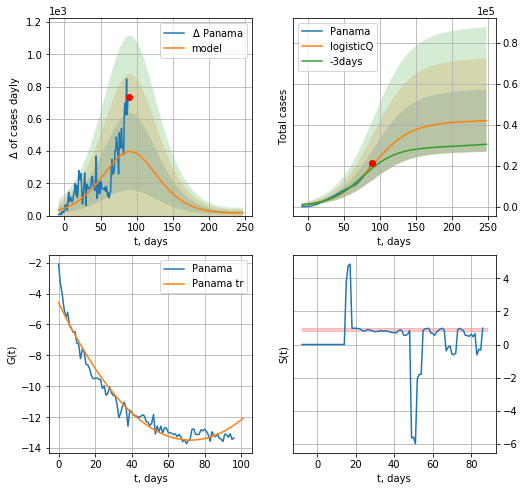

Panama data at: 2020-06-15
+3 day model MAPE: 0.074351
model: logisticQ
coeffs: [ 4.12721613e+04  6.46045822e-07  9.10286159e+01 -5.93912006e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362711
forecast at the end of period: +159 days
	 deltaDaycases: 17
	 total cases: 41957 ± 15218
	 total death: 877 ± 954
trend coefficient of determination: 0.959761
 intercept_: -4.589659728718992
 coeffs_: [ 0.         -0.24607285  0.00170383]


In [279]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

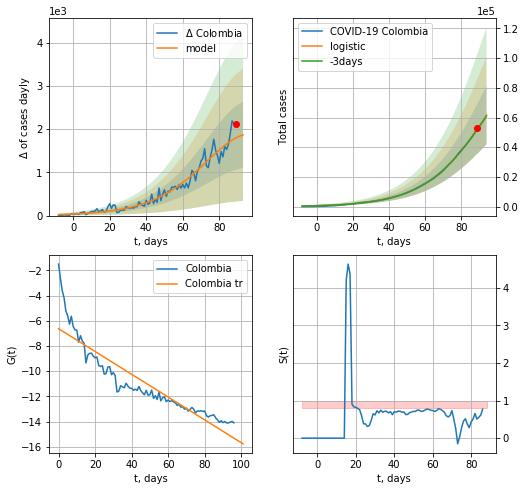

Colombia data at: 2020-06-15
+3 day model MAPE: 0.008338953646359424
model: logistic
coeffs:  [1.38486515e+05 5.47542002e-02 9.80121964e+01]
rational stdev:  0.3208804079535144
forecast at the end of period: +5 days
	 deltaDaycases:  1866
	 total cases:  61667 ± 19788
	 total death:  2005 ± 1930
trend coefficient of determination: 0.831441
 intercept: -6.625676
 slope: -0.090457


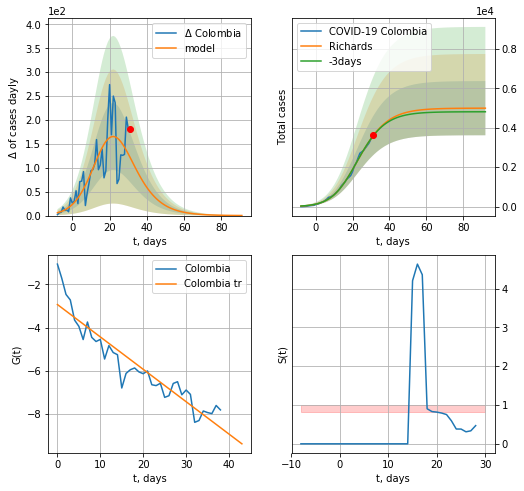

Colombia data at: 2020-06-15
+3 day model MAPE: 0.003507
model: Richards
coeffs: [4.99315067e+03 1.95979830e-01 1.78374870e+01 5.90307623e-01]
rational stdev: 0.275146
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 4991 ± 1373
	 total death: 162 ± 133
trend coefficient of determination: 0.874880
 intercept: -2.931794
 slope: -0.150492


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


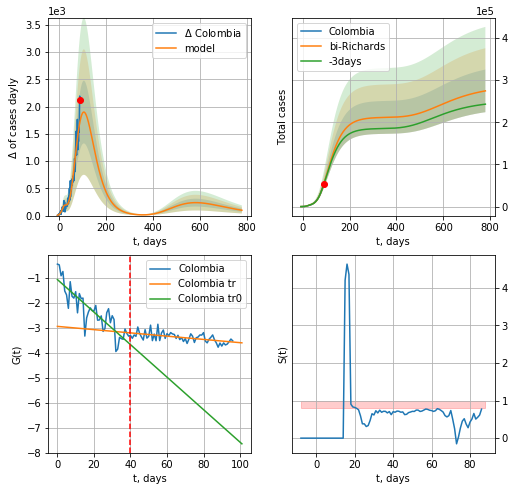

Colombia data at: 2020-06-15
+3 day model MAPE: 0.012545
model: bi-Richards
coeffs: [ 2.06978576e+05  9.37998020e-01 -3.77013921e+01  2.69605024e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.184249
forecast at the end of period: +691 days
	 deltaDaycases: 98
	 total cases: 274553 ± 50586
	 total death: 8930 ± 4936
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.752851
 intercept: -1.054984
 slope: -0.065158
trend coefficient of determination: 0.311940
 intercept: -2.930359
 slope: -0.006525


In [280]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,12*7-dT)
x = forecastRR("Colombia",dfCB[:40],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,110*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


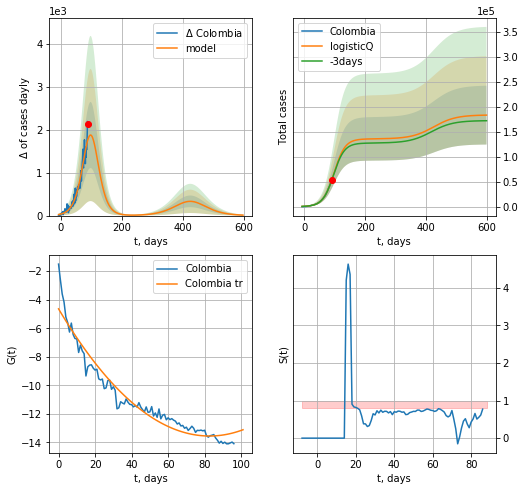

Colombia data at: 2020-06-15
+3 day model MAPE: 0.008775
model: logisticQ
coeffs: [ 1.35699333e+05  5.57600414e-06  9.73350717e+01 -9.82863660e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321345
forecast at the end of period: +509 days
	 deltaDaycases: 10
	 total cases: 183370 ± 58924
	 total death: 5964 ± 5749
trend coefficient of determination: 0.940058
 intercept_: -4.641816773876373
 coeffs_: [ 0.         -0.21575952  0.00130526]


In [281]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active  death
99  2020-06-11  10589.0  2593.0  741.0
100 2020-06-12  10698.0  2625.0  751.0
101 2020-06-13  10810.0  2630.0  760.0
102 2020-06-14  10919.0  2546.0  767.0
103 2020-06-15  11031.0  2519.0  777.0


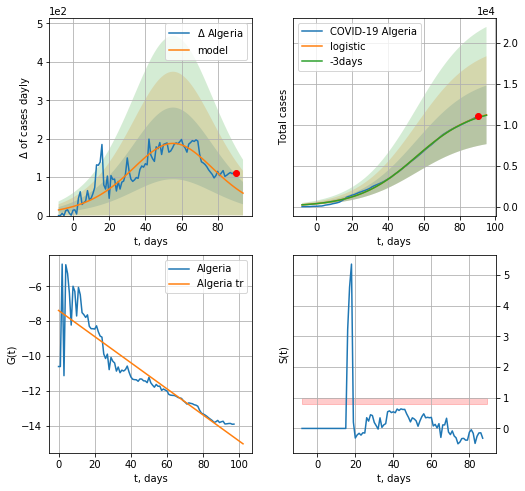

Algeria data at: 2020-06-15
+3 day model MAPE: 0.004079491419145561
model: logistic
coeffs:  [1.22365380e+04 6.14213671e-02 5.57936053e+01]
rational stdev:  0.31886479753547314
forecast at the end of period: +5 days
	 deltaDaycases:  58
	 total cases:  11226 ± 3579
	 total death:  790 ± 755
trend coefficient of determination: 0.824390
 intercept: -7.383061
 slope: -0.074943


In [282]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,12*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


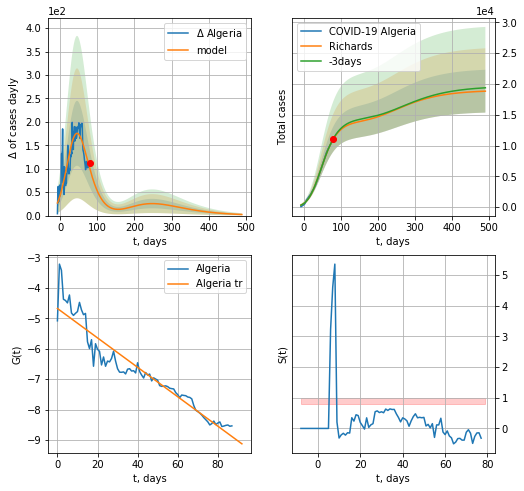

Algeria data at: 2020-06-15
+3 day model MAPE: 0.006417
model: Richards
coeffs: [1.39462458e+04 9.73952166e-02 2.46332938e+01 4.23759939e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.184699
forecast at the end of period: +411 days
	 deltaDaycases: 2
	 total cases: 18835 ± 3478
	 total death: 1326 ± 734
trend coefficient of determination: 0.906446
 intercept: -4.676805
 slope: -0.048341


In [283]:
x = forecastRR("Algeria",dfAR[15:],d1,70*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


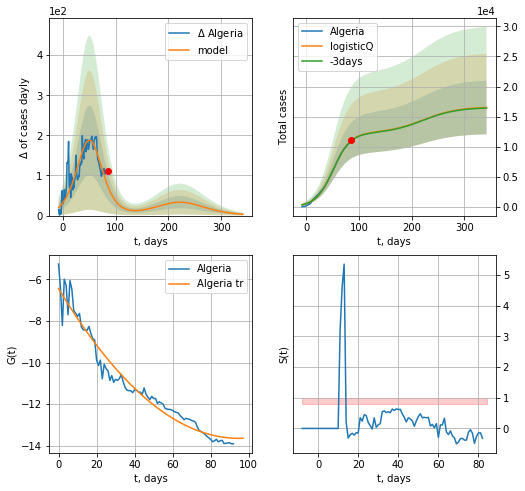

Algeria data at: 2020-06-15
+3 day model MAPE: 0.003640
model: logisticQ
coeffs: [ 1.22777181e+04  1.26588733e-06  5.09311128e+01 -4.81329973e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.270139
forecast at the end of period: +257 days
	 deltaDaycases: 3
	 total cases: 16519 ± 4462
	 total death: 1163 ± 942
trend coefficient of determination: 0.957856
 intercept_: -6.44585255290635
 coeffs_: [ 0.         -0.1519895   0.00080262]


In [284]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

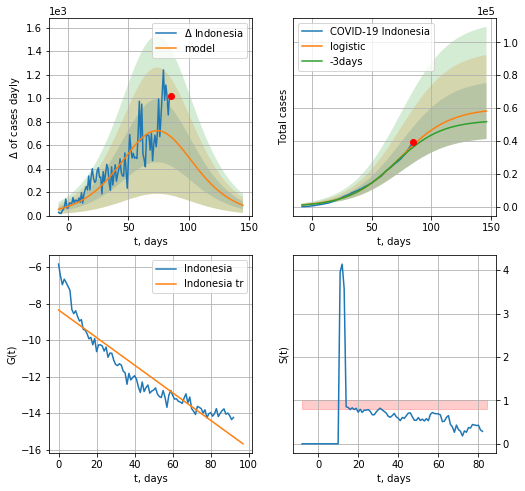

Indonesia data at: 2020-06-15
+3 day model MAPE: 0.03712930813065605
model: logistic
coeffs:  [6.00557540e+04 4.81534495e-02 7.42153099e+01]
rational stdev:  0.2928042149268234
forecast at the end of period: +61 days
	 deltaDaycases:  87
	 total cases:  58219 ± 17047
	 total death:  3256 ± 2860
trend coefficient of determination: 0.871904
 intercept: -8.344763
 slope: -0.075618


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


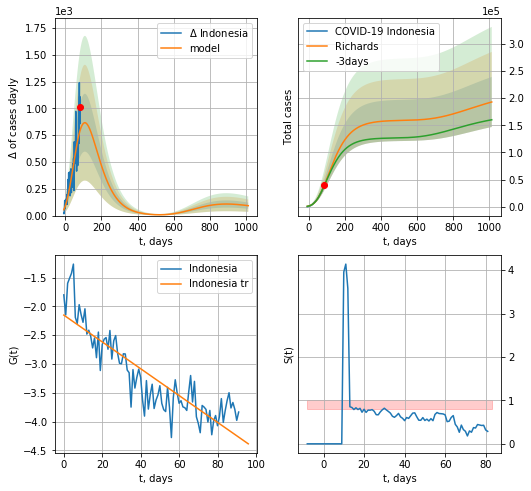

Indonesia data at: 2020-06-15
+3 day model MAPE: 0.022875
model: Richards
coeffs: [ 1.59276899e+05  8.73411586e-01 -1.64014302e+02  1.70776775e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.239028
forecast at the end of period: +929 days
	 deltaDaycases: 92
	 total cases: 192957 ± 46122
	 total death: 10793 ± 7739
trend coefficient of determination: 0.766307
 intercept: -2.150486
 slope: -0.023295


In [285]:
x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,144*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


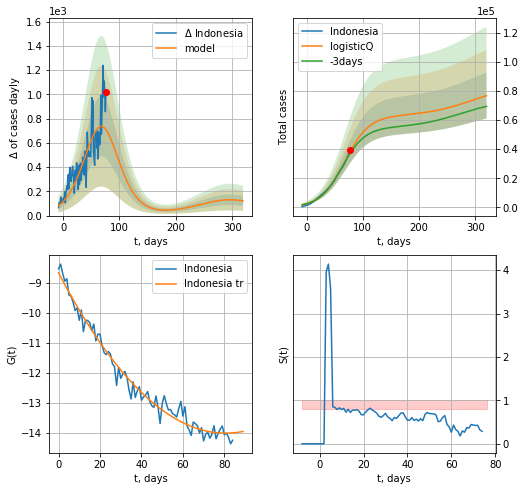

Indonesia data at: 2020-06-15
+3 day model MAPE: 0.034513
model: logisticQ
coeffs: [ 6.27329215e+04  1.20625403e-06  6.81040972e+01 -3.87606292e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.205054
forecast at the end of period: +243 days
	 deltaDaycases: 121
	 total cases: 76796 ± 15747
	 total death: 4295 ± 2642
trend coefficient of determination: 0.977549
 intercept_: -8.676565238489973
 coeffs_: [ 0.         -0.13198989  0.00081838]


In [286]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


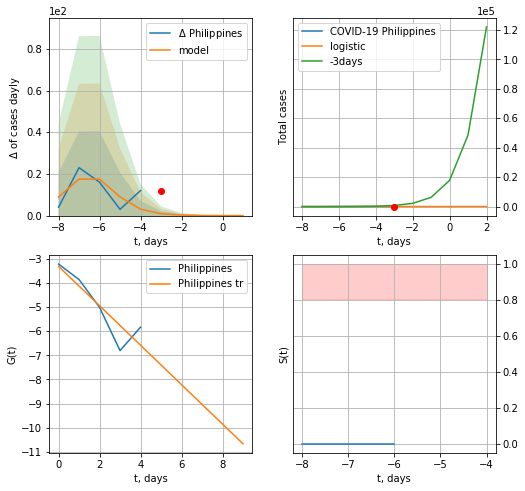

Philippines data at: 2020-06-15
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  2 ± 1
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


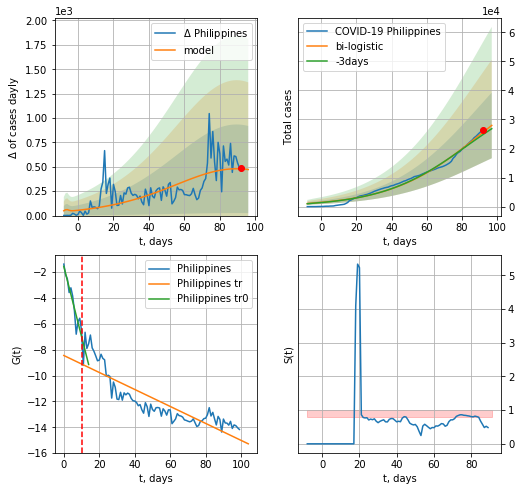

Philippines data at: 2020-06-15
+3 day model MAPE: 0.03356745559288952
model: bi-logistic
coeffs:  [4.90354879e+04 3.91528487e-02 8.99241987e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.4043608027565813
forecast at the end of period: +5 days
	 deltaDaycases:  472
	 total cases:  27953 ± 11303
	 total death:  1161 ± 1408
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.751871
 intercept: -8.451126
 slope: -0.065661


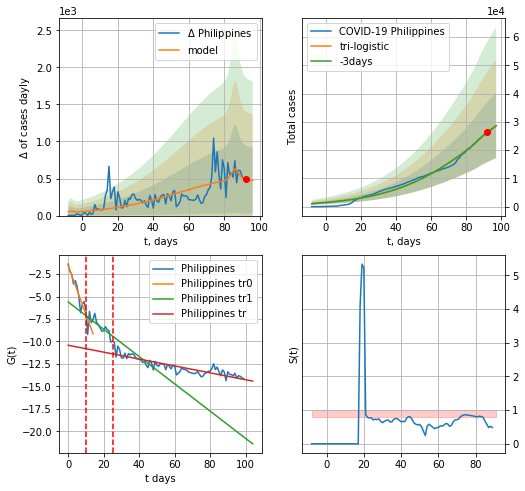

Philippines data at: 2020-06-15
+3 day model MAPE: 0.007048727224377144
model: tri-logistic
coeffs:  [8.31026467e+02 7.52155857e-01 8.66471305e+01] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  4.90354879e+04
  3.91528487e-02  8.99241987e+01]
forecast rational stdev:  0.4034744330656858
forecast at the end of period: +5 days
	 deltaDaycases:  472
	 total cases:  28784 ± 11613
	 total death:  1196 ± 1447
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.758442
 intercept: -10.419786
 slope: -0.038377


In [287]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,12*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


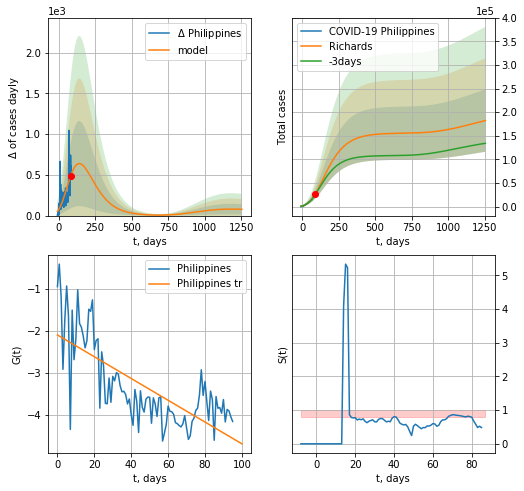

Philippines data at: 2020-06-15
+3 day model MAPE: 0.027814
model: Richards
coeffs: [ 1.55744018e+05  6.71897571e-01 -2.21940693e+02  1.67268804e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.362643
forecast at the end of period: +1167 days
	 deltaDaycases: 76
	 total cases: 182352 ± 66128
	 total death: 7578 ± 8244
trend coefficient of determination: 0.535610
 intercept: -2.102044
 slope: -0.025858


In [288]:
x = forecastRR("Philippines",dfPH[4:],d1,178*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


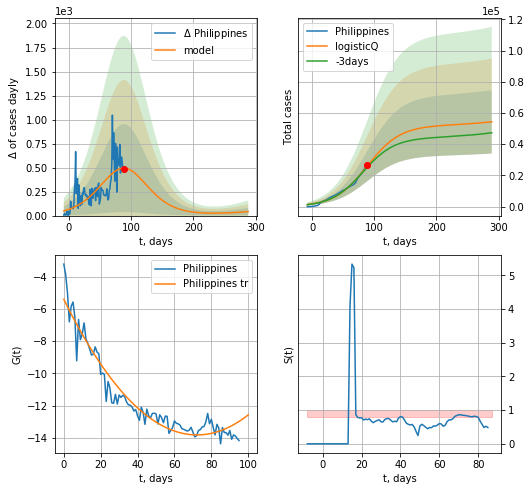

Philippines data at: 2020-06-15
+3 day model MAPE: 0.030804
model: logisticQ
coeffs: [ 5.18835225e+04  6.15866023e-07  8.85780466e+01 -6.17057782e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373083
forecast at the end of period: +201 days
	 deltaDaycases: 41
	 total cases: 54341 ± 20273
	 total death: 2258 ± 2527
trend coefficient of determination: 0.930595
 intercept_: -5.402041495808662
 coeffs_: [ 0.         -0.23304691  0.00161314]


In [289]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
103 2020-06-11  3088.0    1531  183.0
104 2020-06-12  3108.0    1551  183.0
105 2020-06-13  3112.0    1555  183.0
106 2020-06-14  3121.0    1564  183.0
107 2020-06-15  3134.0    1576  184.0


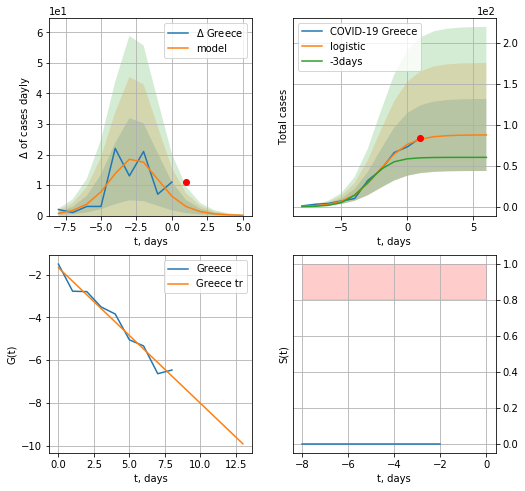

Greece data at: 2020-06-15
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  5 ± 7
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


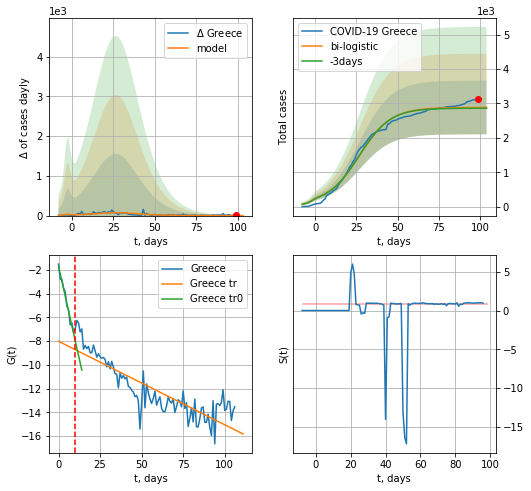

Greece data at: 2020-06-15
+3 day model MAPE: 0.007866331193532285
model: bi-logistic
coeffs:  [2.79834671e+03 1.03802168e-01 2.68747741e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.27061703543454096
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  2884 ± 780
	 total death:  169 ± 137
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.733389
 intercept: -8.015161
 slope: -0.070425


In [290]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,12*7-dT)
xx = forecast2("Greece",dfGC[:],d1,12*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


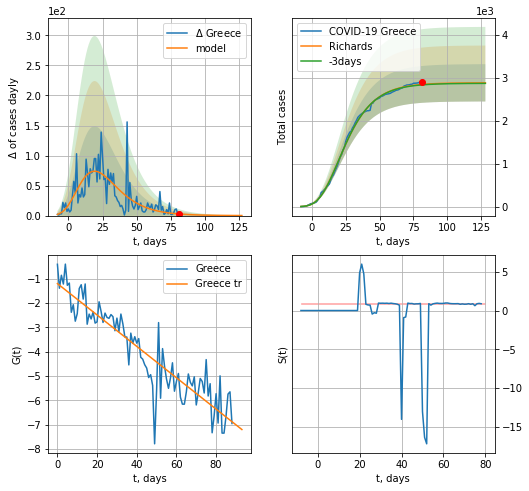

Greece data at: 2020-06-15
+3 day model MAPE: 0.003716
model: Richards
coeffs: [ 2.88621480e+03  7.21651977e+00 -4.66145013e+01  9.69412199e-03]
rational stdev: 0.150576
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 2884 ± 434
	 total death: 169 ± 76
trend coefficient of determination: 0.832984
 intercept: -1.208411
 slope: -0.064431


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


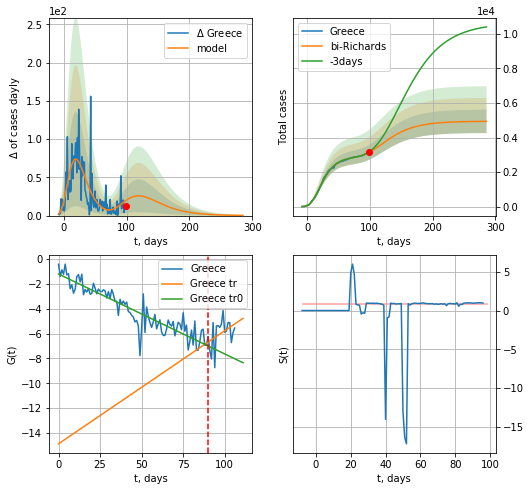

Greece data at: 2020-06-15
+3 day model MAPE: 0.010253
model: bi-Richards
coeffs: [ 2.05724309e+03  4.01641677e+00 -1.99377349e+01  8.48912889e-03]
rational stdev: 0.137374
forecast at the end of period: +187 days
	 deltaDaycases: 0
	 total cases: 4936 ± 678
	 total death: 289 ± 119
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.837454
 intercept: -1.202450
 slope: -0.064381
trend coefficient of determination: 0.154981
 intercept: -14.879632
 slope: 0.091066


In [291]:
vL = 90
x = forecastRR("Greece",dfGC[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


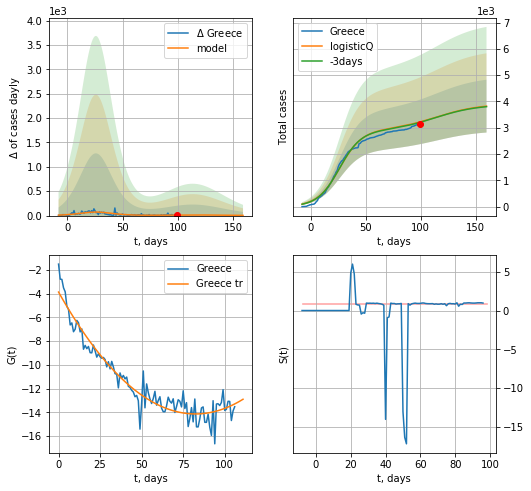

Greece data at: 2020-06-15
+3 day model MAPE: 0.004719
model: logisticQ
coeffs: [ 2.89253180e+03  2.84408884e-07  2.61875431e+01 -3.49883134e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.262700
forecast at the end of period: +61 days
	 deltaDaycases: 4
	 total cases: 3823 ± 1004
	 total death: 224 ± 176
trend coefficient of determination: 0.923686
 intercept_: -3.8626052596655835
 coeffs_: [ 0.         -0.24956994  0.00151456]


In [292]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date  cases  active  death
97  2020-06-11   4053    1051  555.0
98  2020-06-12   4064    1029  559.0
99  2020-06-13   4069    1025  562.0
100 2020-06-14   4076    1028  563.0
101 2020-06-15   4077     996  565.0


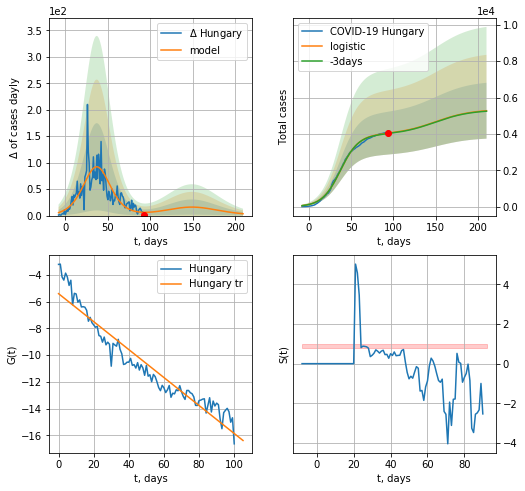

Hungary data at: 2020-06-15
+3 day model MAPE: 0.0054245720723245724
model: logistic
coeffs:  [3.96805038e+03 9.25850448e-02 3.73469483e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.2911261753492872
forecast at the end of period: +117 days
	 deltaDaycases:  3
	 total cases:  5277 ± 1536
	 total death:  731 ± 638
trend coefficient of determination: 0.921275
 intercept: -5.406275
 slope: -0.104496


In [293]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in power


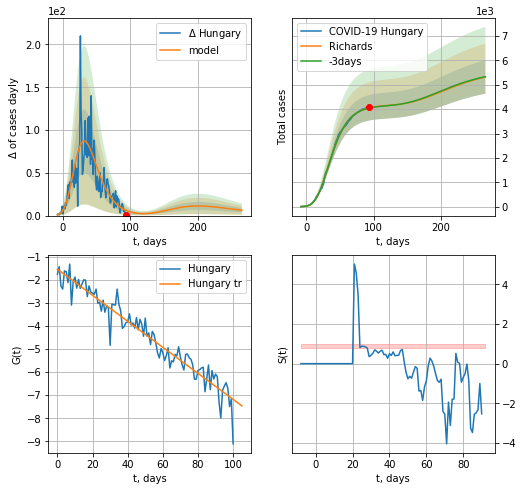

Hungary data at: 2020-06-15
+3 day model MAPE: 0.002060
model: Richards
coeffs: [ 4.15823584e+03  6.28003869e-01 -7.33716688e+00  9.51339971e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.128805
forecast at the end of period: +173 days
	 deltaDaycases: 6
	 total cases: 5317 ± 684
	 total death: 736 ± 284
trend coefficient of determination: 0.928182
 intercept: -1.548947
 slope: -0.056310


In [294]:
x = forecastRR("Hungary",dfHG[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


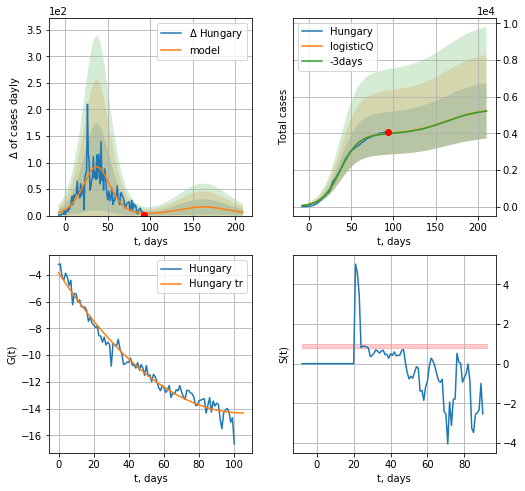

Hungary data at: 2020-06-15
+3 day model MAPE: 0.005534
model: logisticQ
coeffs: [ 3.96795135e+03  4.70968023e-07  3.73471611e+01 -1.96500116e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.291233
forecast at the end of period: +117 days
	 deltaDaycases: 5
	 total cases: 5232 ± 1524
	 total death: 725 ± 633
trend coefficient of determination: 0.972626
 intercept_: -3.845698684798249
 coeffs_: [ 0.         -0.19908147  0.00094587]


In [295]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


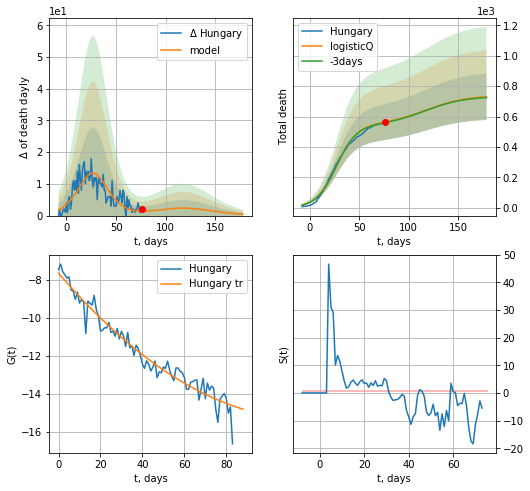

Hungary data at: 2020-06-15
+3 day model MAPE: 0.007742
model: logisticQ
coeffs: [ 5.46529987e+02  6.10289212e-07  2.70470670e+01 -1.59117288e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.209235
forecast at the end of period: +103 days
	 total death: 730 ± 152
trend coefficient of determination: 0.949106
 intercept_: -7.649831511540105
 coeffs_: [ 0.         -0.12869608  0.00053844]


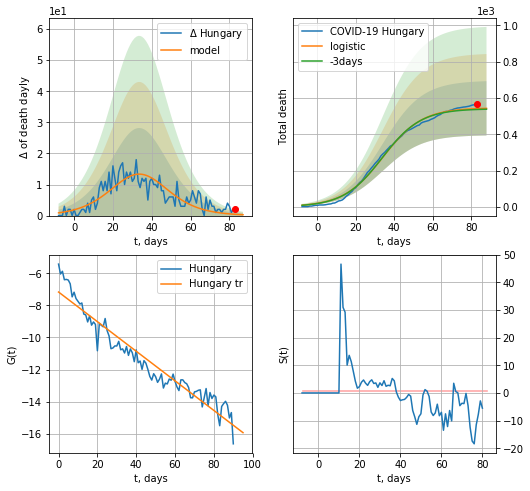

Hungary data at: 2020-06-15
+3 day model MAPE: 0.008722007603414402
model: logistic
coeffs:  [5.45855446e+02 9.78441249e-02 3.40187385e+01]
rational stdev:  0.2756659793122927
forecast at the end of period: +5 days
	 total death:  543 ± 149
trend coefficient of determination: 0.927440
 intercept: -7.165976
 slope: -0.092264


In [296]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,12*7-dT,cases='death')

MT
          date  cases  active  death
95 2020-06-11  640.0      31    9.0
96 2020-06-12  645.0      36    9.0
97 2020-06-13  646.0      36    9.0
98 2020-06-14  649.0      37    9.0
99 2020-06-15  650.0      38    9.0


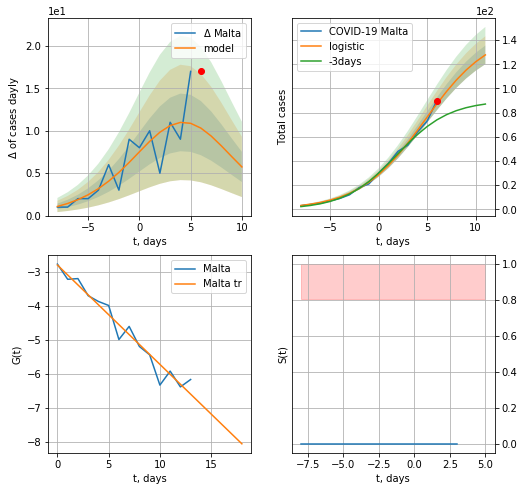

Malta data at: 2020-06-15
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +5 days
	 deltaDaycases:  5
	 total cases:  127 ± 7
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


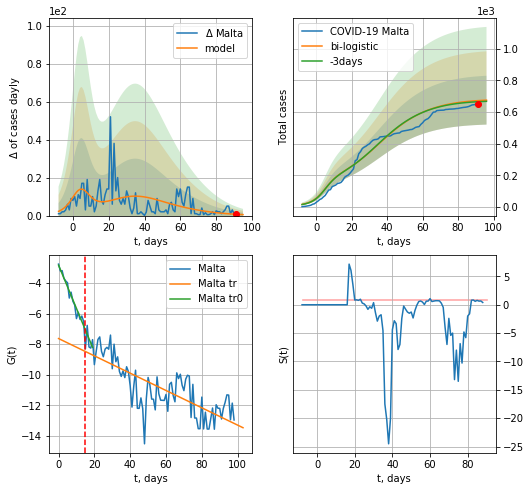

Malta data at: 2020-06-15
+3 day model MAPE: 0.010494686923340421
model: bi-logistic
coeffs:  [4.73965583e+02 8.27251973e-02 3.44282937e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.22838463386939395
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  674 ± 154
	 total death:  9 ± 6
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.602252
 intercept: -7.635099
 slope: -0.056565


In [297]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,7*12-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*12-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


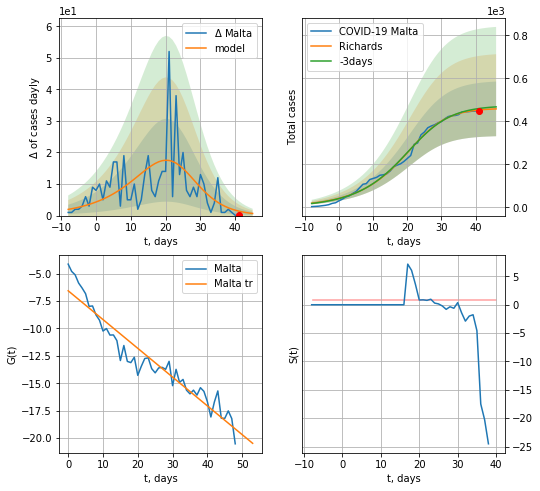

Malta data at: 2020-06-15
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 457 ± 127
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


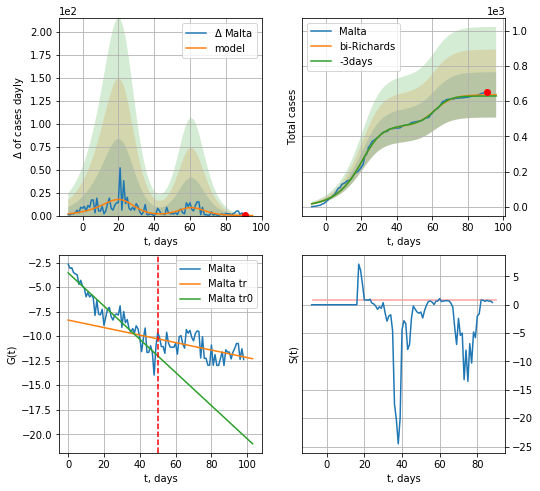

Malta data at: 2020-06-15
+3 day model MAPE: 0.010061
model: bi-Richards
coeffs: [175.04982416   0.21129004  60.74449778   0.91133658]
rational stdev: 0.201834
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 635 ± 128
	 total death: 8 ± 4
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.895856
 intercept: -3.544660
 slope: -0.169251
trend coefficient of determination: 0.241055
 intercept: -8.357616
 slope: -0.038259


In [298]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,12*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


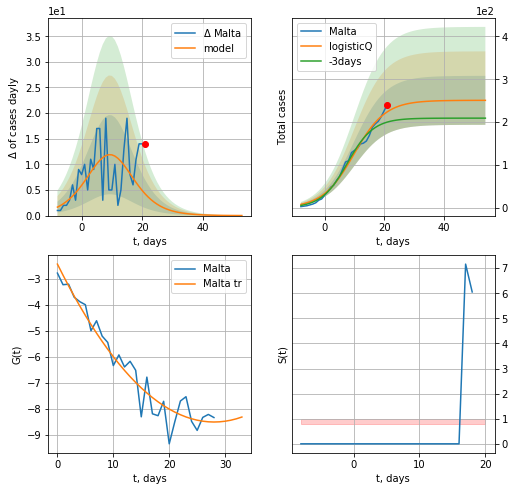

Malta data at: 2020-06-15
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 250 ± 57
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


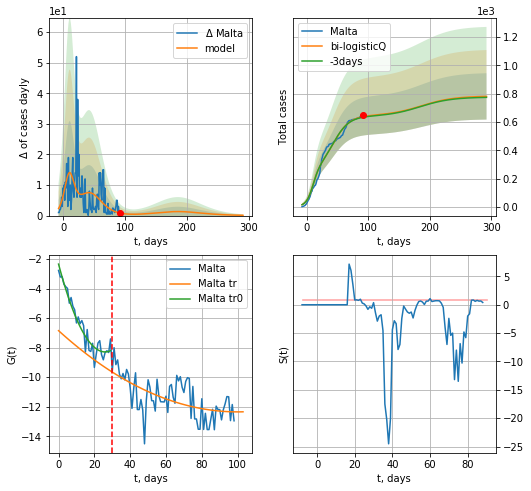

Malta data at: 2020-06-15
+3 day model MAPE: 0.006660
model: bi-logisticQ
coeffs: [ 3.93010317e+02  2.14451861e-07  4.26299536e+01 -3.50863905e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.209392
forecast at the end of period: +201 days
	 deltaDaycases: 0
	 total cases: 780 ± 163
	 total death: 10 ± 6
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.370080
 intercept_: -6.849530350893456
 coeffs_: [ 0.         -0.11003454  0.00055028]


In [299]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
          date   cases  active  death
93 2020-06-11  1541.0   104.0   28.0
94 2020-06-12  1542.0   105.0   28.0
95 2020-06-13  1545.0   107.0   28.0
96 2020-06-14  1548.0   110.0   28.0
97 2020-06-15  1552.0    98.0   28.0


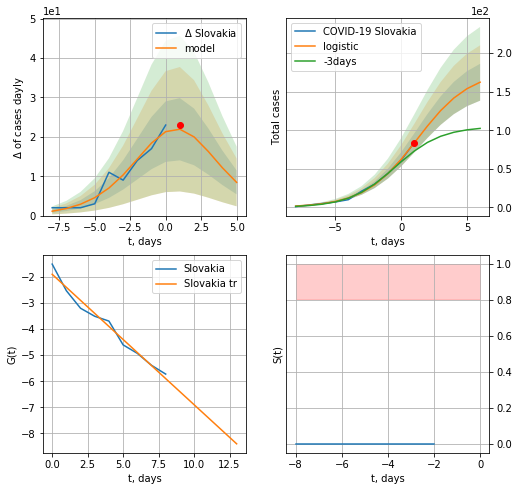

Slovakia data at: 2020-06-15
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +5 days
	 deltaDaycases:  8
	 total cases:  162 ± 23
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


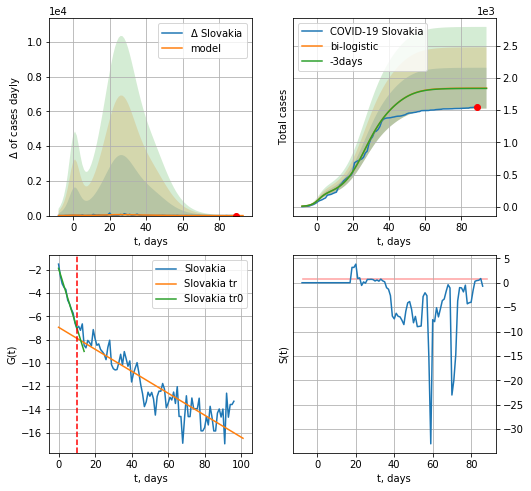

Slovakia data at: 2020-06-15
+3 day model MAPE: 0.0021170070103342653
model: bi-logistic
coeffs:  [1.33258695e+03 1.58791032e-01 2.62654362e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.17231376337719181
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1842 ± 317
	 total death:  33 ± 17
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.810696
 intercept: -6.939808
 slope: -0.094617


In [300]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,12*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


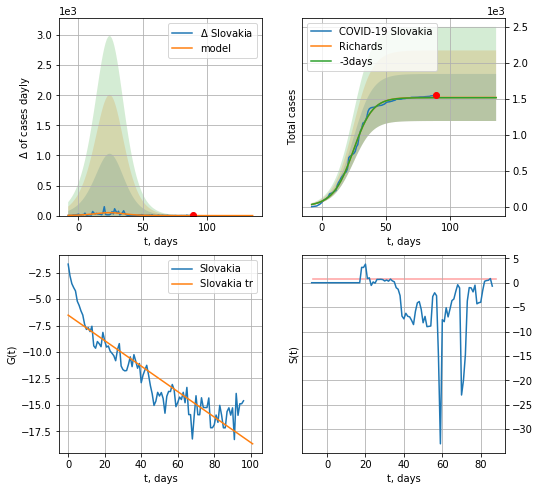

Slovakia data at: 2020-06-15
+3 day model MAPE: 0.002186
model: Richards
coeffs: [1.51864173e+03 1.15562994e-01 2.58202357e+01 1.17695040e+00]
rational stdev: 0.215386
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 1518 ± 327
	 total death: 27 ± 17
trend coefficient of determination: 0.829340
 intercept: -6.519326
 slope: -0.120330


In [301]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


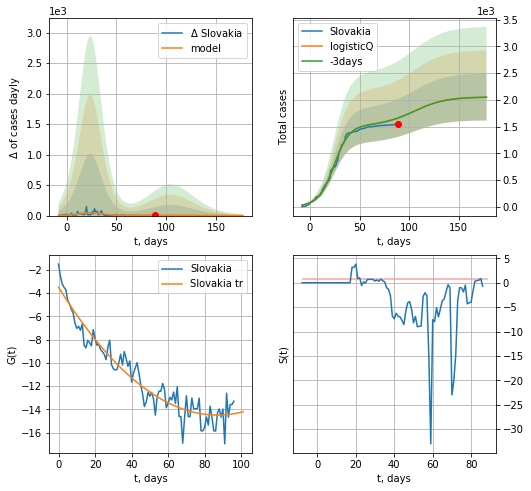

Slovakia data at: 2020-06-15
+3 day model MAPE: 0.001780
model: logisticQ
coeffs: [ 1.51989614e+03  1.19548066e-04  2.40540468e+01 -1.04623043e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.213324
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 2053 ± 437
	 total death: 37 ± 23
trend coefficient of determination: 0.920177
 intercept_: -3.4993596889678447
 coeffs_: [ 0.         -0.25298379  0.00145434]


In [302]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
98  2020-06-11  1488.5    20.0  109.0
99  2020-06-12  1490.0    22.0  109.0
100 2020-06-13  1492.0    24.0  109.0
101 2020-06-14  1495.0    27.0  109.0
102 2020-06-15  1496.0    28.0  109.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


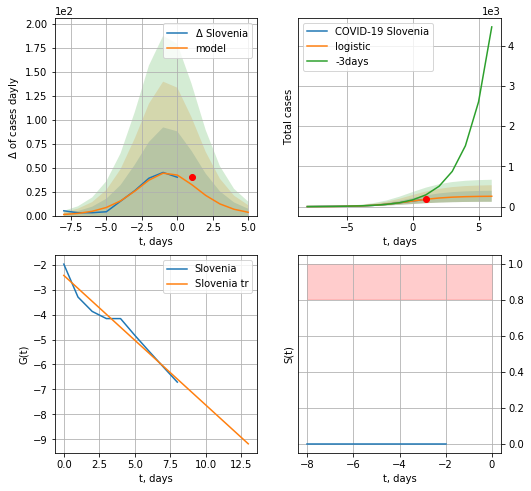

Slovenia data at: 2020-06-15
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +5 days
	 deltaDaycases:  3
	 total cases:  257 ± 136
	 total death:  18 ± 28
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


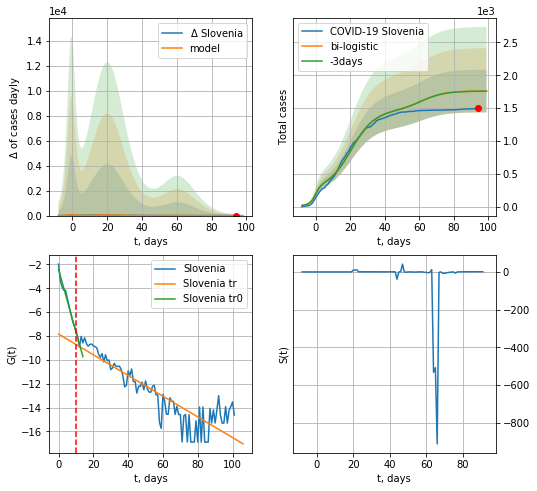

Slovenia data at: 2020-06-15
+3 day model MAPE: 0.0015631951230529973
model: bi-logistic
coeffs:  [1.19994120e+03 1.46930739e-01 2.04441408e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.18472537469355538
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  1759 ± 325
	 total death:  128 ± 70
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.788599
 intercept: -7.838699
 slope: -0.086748


In [303]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*12-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


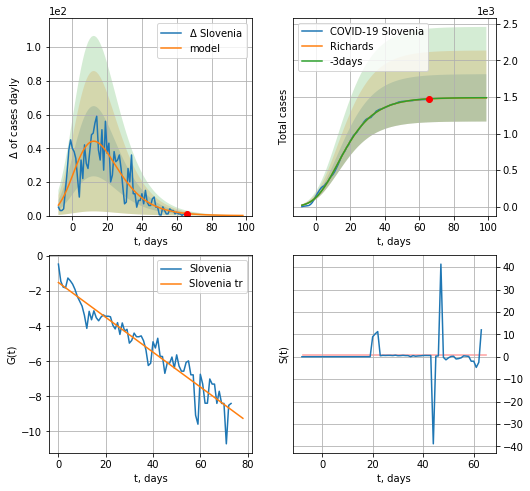

Slovenia data at: 2020-06-15
+3 day model MAPE: 0.001211
model: Richards
coeffs: [ 1.48860897e+03  5.69202399e-01 -8.90072420e+00  1.52510532e-01]
rational stdev: 0.217393
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 1487 ± 323
	 total death: 108 ± 70
trend coefficient of determination: 0.915958
 intercept: -1.505070
 slope: -0.099296


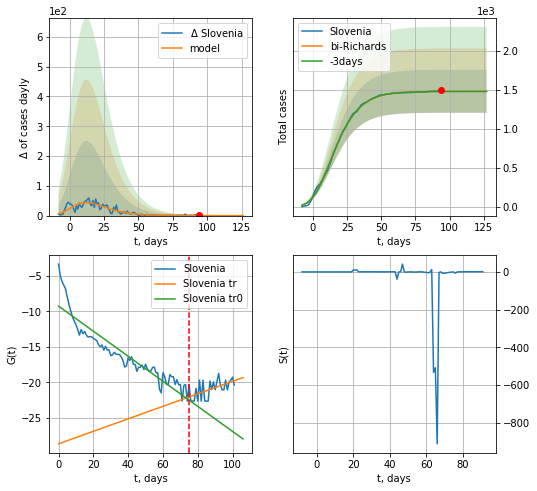

Slovenia data at: 2020-06-15
+3 day model MAPE: 0.002183
model: bi-Richards
coeffs: [-1.81688114e+03  1.06706273e-02  6.81285659e+02  1.78545449e+00]
rational stdev: 0.185919
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 1483 ± 275
	 total death: 108 ± 60
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.860170
 intercept: -9.279540
 slope: -0.175982
trend coefficient of determination: 0.299225
 intercept: -28.618000
 slope: 0.087750


In [304]:
vL = 75
x = forecastRR("Slovenia",dfSV[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


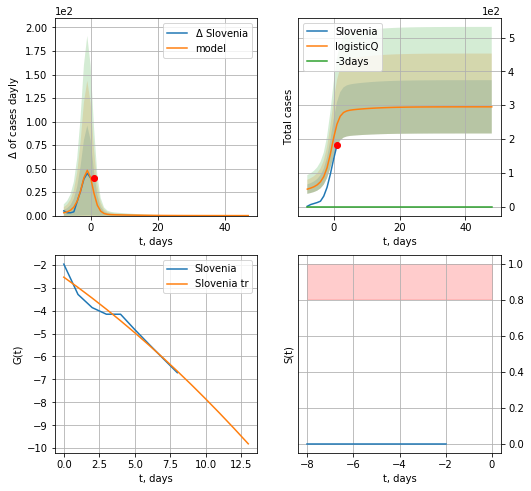

Slovenia data at: 2020-06-15
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 21 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


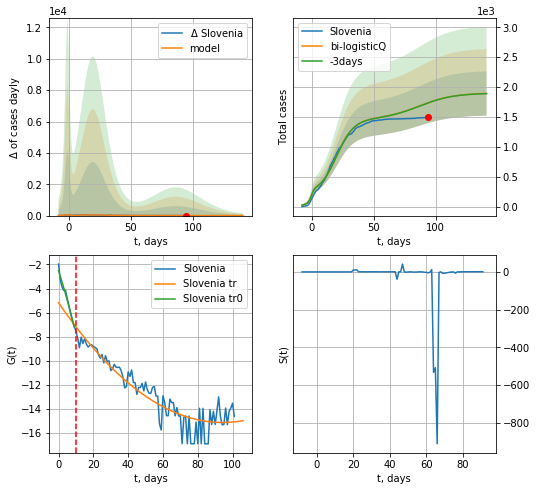

Slovenia data at: 2020-06-15
+3 day model MAPE: 0.000654
model: bi-logisticQ
coeffs: [ 1.24353810e+03  5.74542281e-07  1.98646848e+01 -2.48825248e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.196018
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 1893 ± 371
	 total death: 137 ± 80
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.862926
 intercept_: -5.177067555932862
 coeffs_: [ 0.         -0.21114895  0.00112076]


In [305]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
93 2020-06-11  12102   502.0  252.0
94 2020-06-12  12175   575.0  252.0
95 2020-06-13  12251   650.0  253.0
96 2020-06-14  12310   545.0  254.0
97 2020-06-15  12367   601.0  255.0


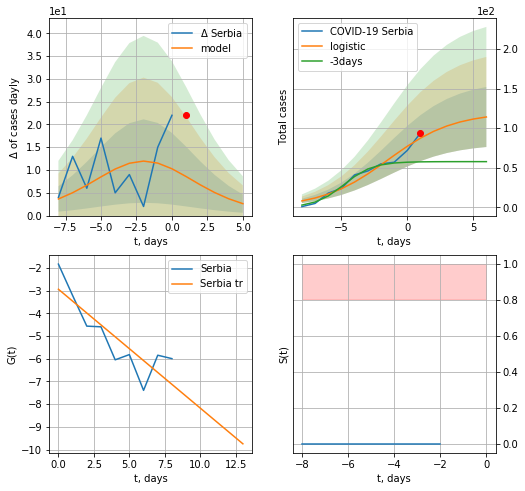

Serbia data at: 2020-06-15
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +5 days
	 deltaDaycases:  2
	 total cases:  114 ± 37
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


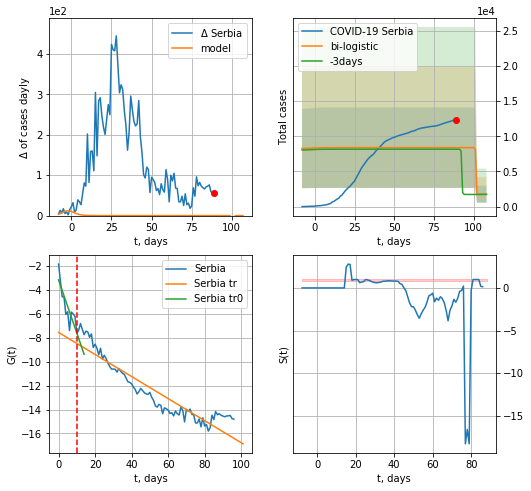

Serbia data at: 2020-06-15
+3 day model MAPE: 0.027006315800355105
model: bi-logistic
coeffs:  [6607.49603781  -12.58488293  101.27924424] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6827057555105633
forecast at the end of period: +19 days
	 deltaDaycases:  0
	 total cases:  1771 ± 1209
	 total death:  36 ± 73
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.867889
 intercept: -7.546289
 slope: -0.092277


In [306]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,12*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


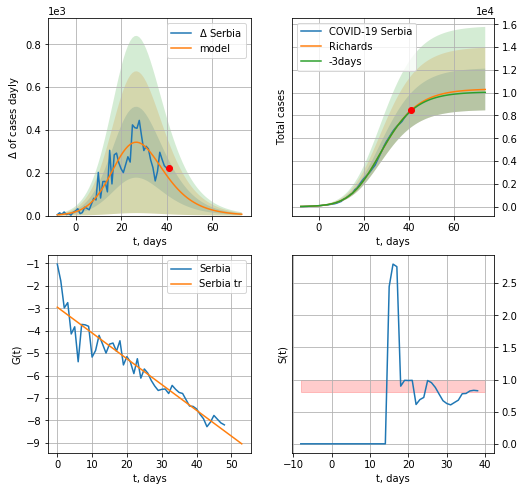

Serbia data at: 2020-06-15
+3 day model MAPE: 0.007628
model: Richards
coeffs: [1.03310156e+04 2.23147111e-01 2.10152369e+01 5.03005273e-01]
rational stdev: 0.178090
forecast at the end of period: +33 days
	 deltaDaycases: 6
	 total cases: 10277 ± 1830
	 total death: 211 ± 112
trend coefficient of determination: 0.905867
 intercept: -2.952078
 slope: -0.114857


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


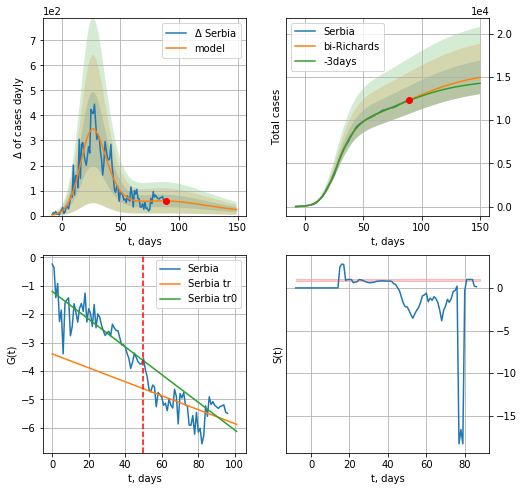

Serbia data at: 2020-06-15
+3 day model MAPE: 0.005576
model: bi-Richards
coeffs: [ 5.51652820e+03  2.47440109e+00 -6.66344803e+01  1.15341693e-02]
rational stdev: 0.130142
forecast at the end of period: +61 days
	 deltaDaycases: 23
	 total cases: 14944 ± 1944
	 total death: 308 ± 120
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.680896
 intercept: -1.203361
 slope: -0.048739
trend coefficient of determination: 0.331028
 intercept: -3.398787
 slope: -0.024523


In [307]:
vL=50
x = forecastRR("Serbia",dfSB[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


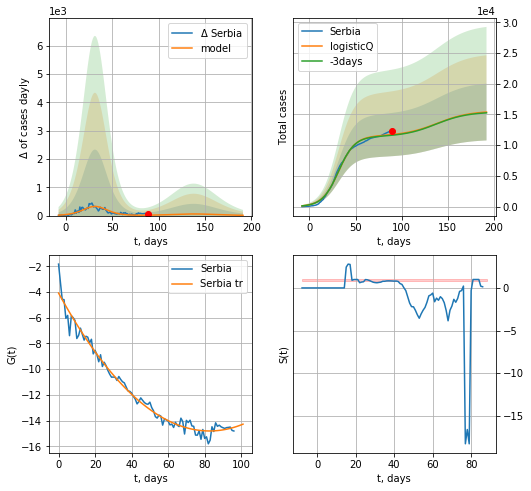

Serbia data at: 2020-06-15
+3 day model MAPE: 0.009485
model: logisticQ
coeffs: [ 1.15058333e+04  4.51746608e-07  3.17023958e+01 -2.49274395e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.300175
forecast at the end of period: +103 days
	 deltaDaycases: 10
	 total cases: 15396 ± 4621
	 total death: 317 ± 285
trend coefficient of determination: 0.979079
 intercept_: -4.080916714530373
 coeffs_: [ 0.         -0.25941653  0.00156964]


In [308]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
103 2020-06-11  2249.1    11.0  106.0
104 2020-06-12  2249.2     9.0  107.0
105 2020-06-13  2251.0    10.0  107.0
106 2020-06-14  2252.0    11.0  107.0
107 2020-06-15  2254.0     7.0  107.0


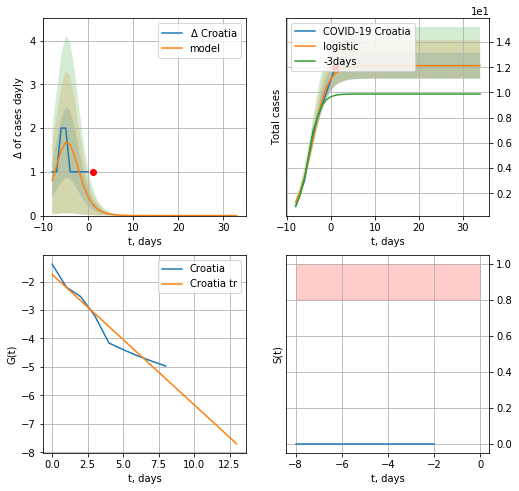

Croatia data at: 2020-06-15
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


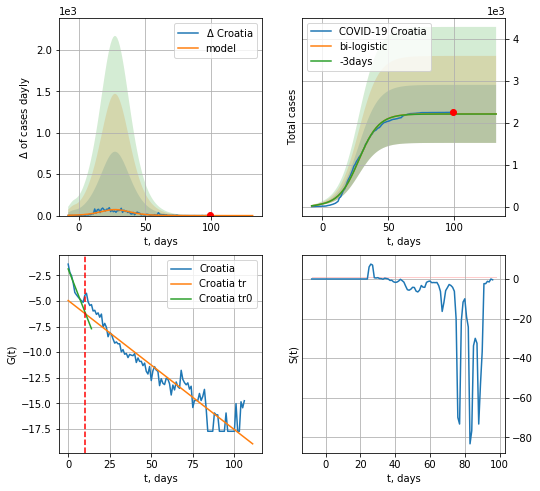

Croatia data at: 2020-06-15
+3 day model MAPE: 0.0013269320144402078
model: bi-logistic
coeffs:  [2.20198948e+03 1.31652571e-01 2.77836147e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.31264753756299335
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  2214 ± 692
	 total death:  105 ± 98
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.915274
 intercept: -4.945877
 slope: -0.126278


In [309]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


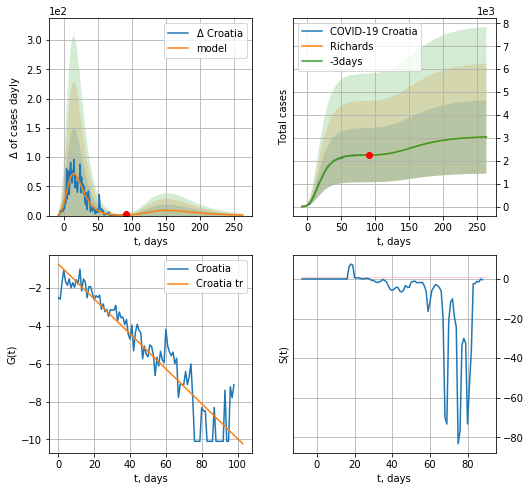

Croatia data at: 2020-06-15
+3 day model MAPE: 0.000120
model: Richards
coeffs: [ 2.25257336e+03  7.98428588e+00 -3.71367923e+01  1.08869292e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.526887
forecast at the end of period: +173 days
	 deltaDaycases: 0
	 total cases: 3040 ± 1601
	 total death: 144 ± 227
trend coefficient of determination: 0.883700
 intercept: -0.735883
 slope: -0.092224


In [310]:
x = forecastRR("Croatia",dfCT[8:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


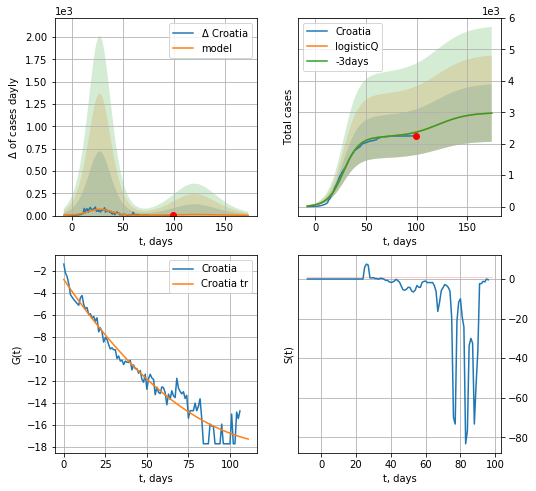

Croatia data at: 2020-06-15
+3 day model MAPE: 0.001029
model: logisticQ
coeffs: [ 2.21507368e+03  5.44884788e-07  2.76808895e+01 -2.39102860e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.306857
forecast at the end of period: +75 days
	 deltaDaycases: 1
	 total cases: 2976 ± 913
	 total death: 141 ± 129
trend coefficient of determination: 0.955946
 intercept_: -2.785802331960232
 coeffs_: [ 0.         -0.22260597  0.00082686]


In [311]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
97  2020-06-11  39726   27658  1377.0
98  2020-06-12  41303   28773  1422.0
99  2020-06-13  42980   29967  1484.0
100 2020-06-14  44598   31092  1575.0
101 2020-06-15  46289   32288  1672.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


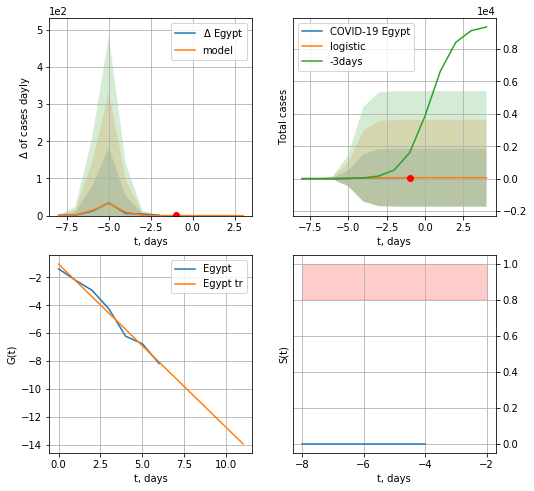

Egypt data at: 2020-06-15
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


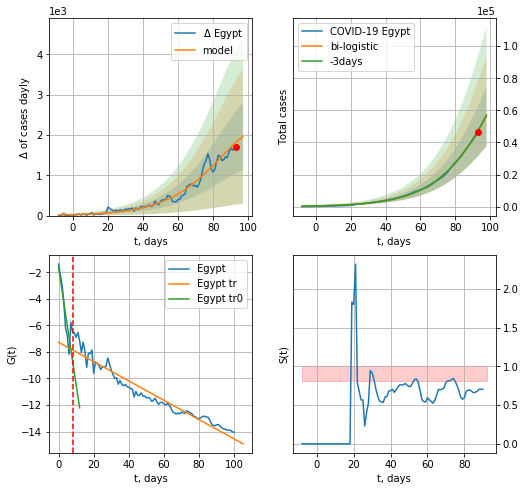

Egypt data at: 2020-06-15
+3 day model MAPE: 0.009606948636261266
model: bi-logistic
coeffs:  [1.55666678e+05 5.46267324e-02 1.08614297e+02] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.33001497125410373
forecast at the end of period: +5 days
	 deltaDaycases:  1959
	 total cases:  56278 ± 18572
	 total death:  2032 ± 2011
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.934808
 intercept: -7.270195
 slope: -0.072864


In [312]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*12-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


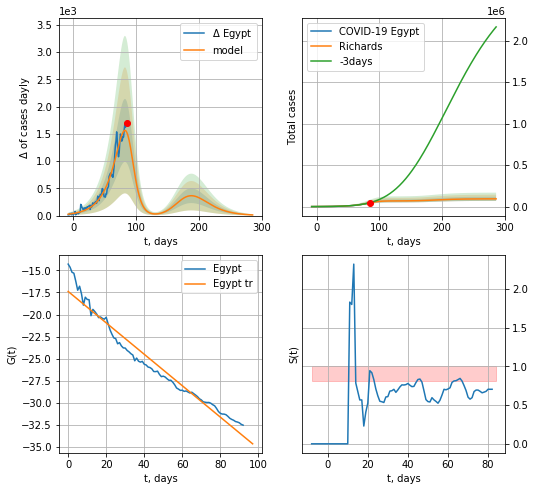

Egypt data at: 2020-06-15
+3 day model MAPE: 0.037185
model: Richards
coeffs: [6.89365310e+04 5.02868095e-02 8.99834145e+01 2.71934505e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.266082
forecast at the end of period: +201 days
	 deltaDaycases: 12
	 total cases: 93663 ± 24922
	 total death: 3383 ± 2700
trend coefficient of determination: 0.957822
 intercept: -17.387726
 slope: -0.177795


In [315]:
x = forecastRR("Egypt",dfEG[8:],d1,40*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


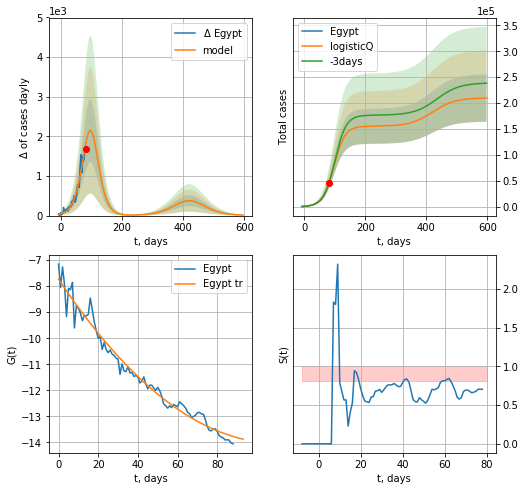

Egypt data at: 2020-06-15
+3 day model MAPE: 0.011643
model: logisticQ
coeffs: [ 1.55117484e+05  1.33468472e-05  9.63227893e+01 -4.05079955e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.218434
forecast at the end of period: +516 days
	 deltaDaycases: 11
	 total cases: 209631 ± 45790
	 total death: 7572 ± 4961
trend coefficient of determination: 0.973069
 intercept_: -7.730584139056615
 coeffs_: [ 0.         -0.11416783  0.00051745]


In [316]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date  cases   active  death
100 2020-06-11  16675   9650.0  457.0
101 2020-06-12  17770  10406.0  496.0
102 2020-06-13  18950  10886.0  549.0
103 2020-06-14  20209  11481.0  607.0
104 2020-06-15  21315  11392.0  652.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


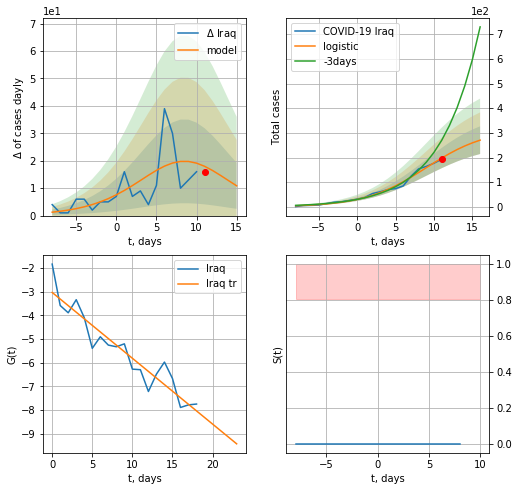

Iraq data at: 2020-06-15
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +5 days
	 deltaDaycases:  10
	 total cases:  270 ± 56
	 total death:  8 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


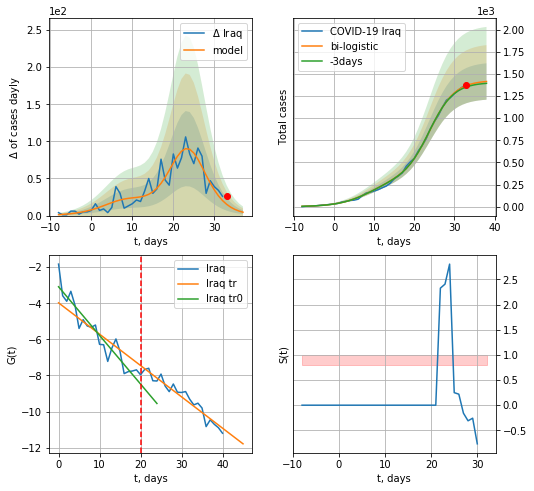

Iraq data at: 2020-06-15
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +5 days
	 deltaDaycases:  4
	 total cases:  1413 ± 205
	 total death:  43 ± 18
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


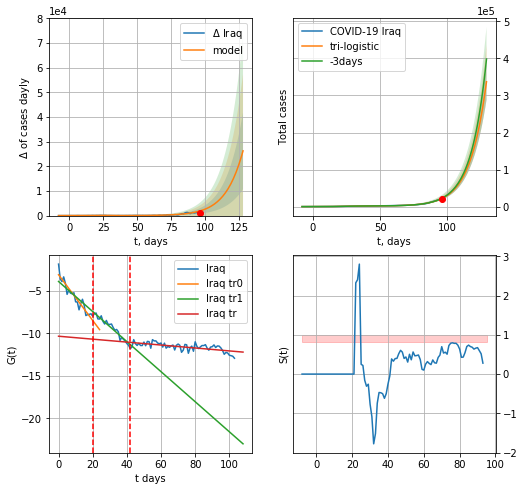

Iraq data at: 2020-06-15
+3 day model MAPE: 0.0342840557130566
model: tri-logistic
coeffs:  [5.89116146e+06 8.61689794e-02 1.61570855e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.14637335389347642
forecast at the end of period: +33 days
	 deltaDaycases:  26253
	 total cases:  337037 ± 49333
	 total death:  10309 ± 4526
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.410973
 intercept: -10.330934
 slope: -0.017322


In [317]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,12*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,12*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:62: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


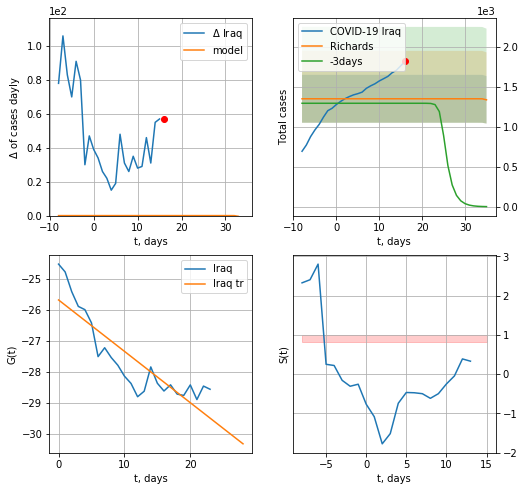

Iraq data at: 2020-06-15
+3 day model MAPE: 0.043452
model: Richards
coeffs: [ 1.35108000e+03 -1.00828093e+00  3.60107691e+01  3.34480114e+00]
rational stdev: 0.221927
forecast at the end of period: +19 days
	 deltaDaycases: -12
	 total cases: 1337 ± 296
	 total death: 40 ± 26
trend coefficient of determination: 0.758800
 intercept: -25.688358
 slope: -0.165871


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


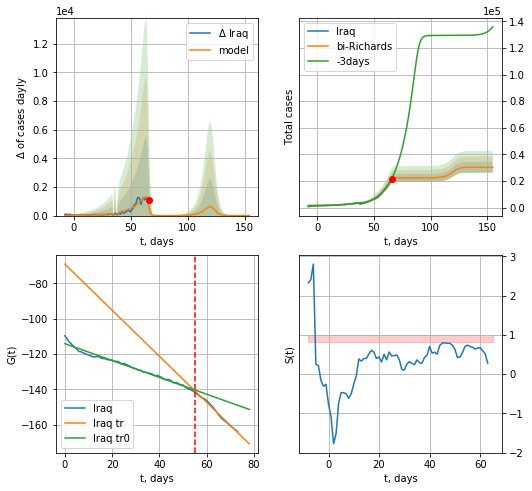

Iraq data at: 2020-06-15
+3 day model MAPE: 0.091729
model: bi-Richards
coeffs: [2.21909628e+04 7.68955724e-02 6.59603302e+01 1.61456582e+01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.134189
forecast at the end of period: +89 days
	 deltaDaycases: 0
	 total cases: 30233 ± 4057
	 total death: 924 ± 371
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.980712
 intercept: -114.156303
 slope: -0.478030
trend coefficient of determination: 0.993272
 intercept: -69.076728
 slope: -1.305928


In [321]:
vL=85#25+10
x = forecastRR("Iraq",dfIQ[30:vL-30],d1,14*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[30:],d1,24*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-30)

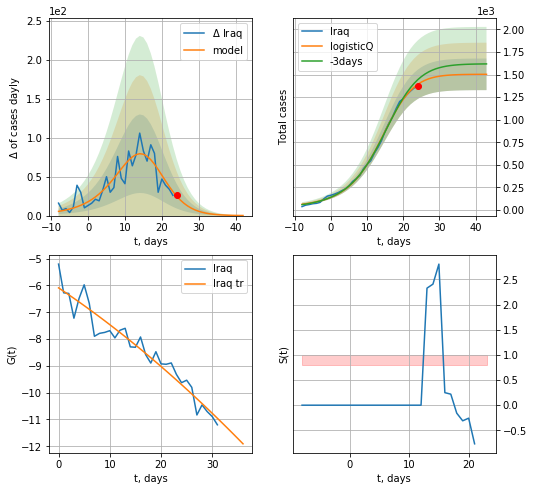

Iraq data at: 2020-06-15
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291916e+03  2.94853860e-03  1.34415511e+01 -5.72228334e+01]
rational stdev: 0.116469
forecast at the end of period: +19 days
	 deltaDaycases: 0
	 total cases: 1502 ± 175
	 total death: 45 ± 15
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


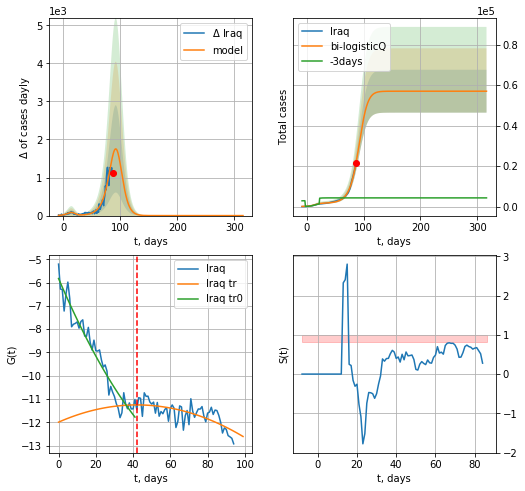

Iraq data at: 2020-06-15
+3 day model MAPE: 4.401387
model: bi-logisticQ
coeffs: [ 5.54668469e+04  6.07051998e-04  9.14282764e+01 -1.15674609e+02]
rational stdev: 0.185584
forecast at the end of period: +229 days
	 deltaDaycases: 0
	 total cases: 56969 ± 10572
	 total death: 1742 ± 969
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.485185
 intercept_: -11.995735028876467
 coeffs_: [ 0.          0.03523305 -0.00041866]


In [322]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,44*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=42)

In [323]:
#len(dfAR)

AR
           date    cases  active  death
99  2020-06-11  10589.0  2593.0  741.0
100 2020-06-12  10698.0  2625.0  751.0
101 2020-06-13  10810.0  2630.0  760.0
102 2020-06-14  10919.0  2546.0  767.0
103 2020-06-15  11031.0  2519.0  777.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


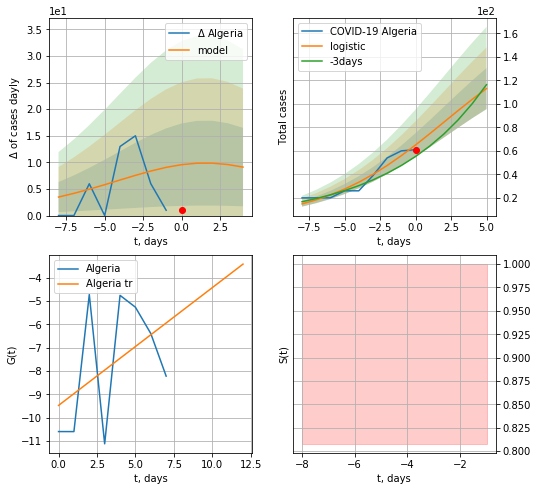

Algeria data at: 2020-06-15
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +5 days
	 deltaDaycases:  9
	 total cases:  112 ± 17
	 total death:  7 ± 3
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


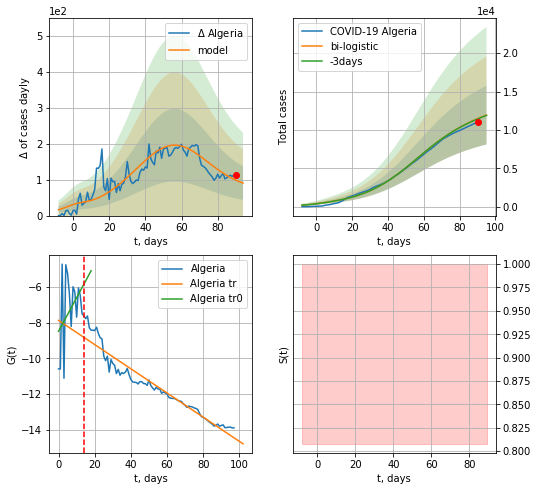

Algeria data at: 2020-06-15
+3 day model MAPE: 0.003951794352114472
model: bi-logistic
coeffs:  [1.19093279e+04 6.39807737e-02 5.58564819e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.32025551250074663
forecast at the end of period: +5 days
	 deltaDaycases:  90
	 total cases:  11940 ± 3823
	 total death:  841 ± 808
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.929044
 intercept: -7.881395
 slope: -0.067776


In [324]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*12-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*12-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


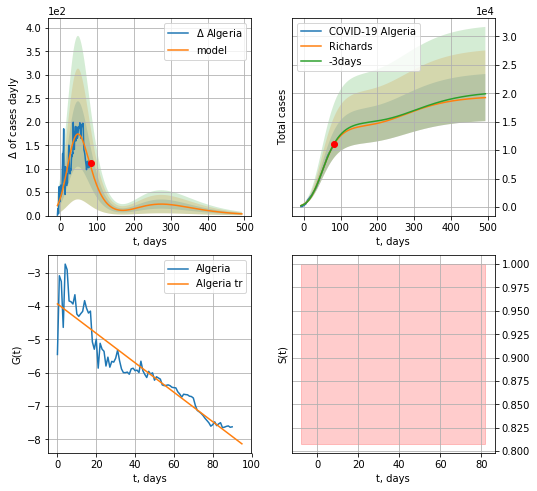

Algeria data at: 2020-06-15
+3 day model MAPE: 0.007951
model: Richards
coeffs: [1.43309862e+04 1.17372200e-01 1.89654936e+01 3.26024536e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.215446
forecast at the end of period: +411 days
	 deltaDaycases: 3
	 total cases: 19236 ± 4144
	 total death: 1354 ± 875
trend coefficient of determination: 0.886140
 intercept: -3.932030
 slope: -0.044248


In [326]:
x = forecastRR("Algeria",dfAR[12:],d1,70*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


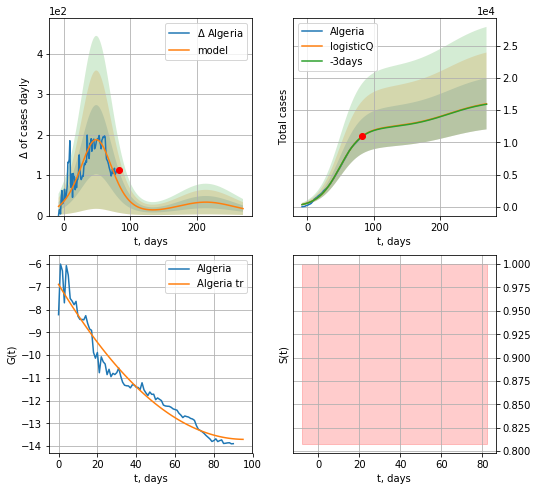

Algeria data at: 2020-06-15
+3 day model MAPE: 0.003390
model: logisticQ
coeffs: [ 1.23039849e+04  1.35431766e-06  4.90159789e+01 -4.48033364e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.248175
forecast at the end of period: +187 days
	 deltaDaycases: 17
	 total cases: 16000 ± 3970
	 total death: 1127 ± 839
trend coefficient of determination: 0.955729
 intercept_: -6.887706296141793
 coeffs_: [ 0.         -0.14237501  0.00074287]


In [327]:
x = forecastRRR("Algeria",dfAR[12:],d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
91 2020-06-11  975.0   150.0   18.0
92 2020-06-12  980.0   155.0   18.0
93 2020-06-13  980.5   155.0   18.0
94 2020-06-14  983.0   158.0   18.0
95 2020-06-15  985.0   160.0   18.0


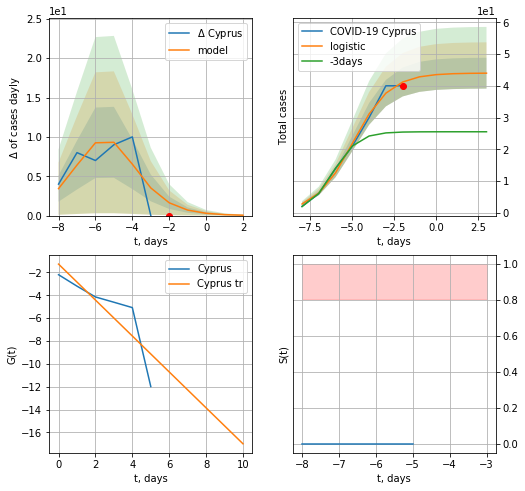

Cyprus data at: 2020-06-15
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


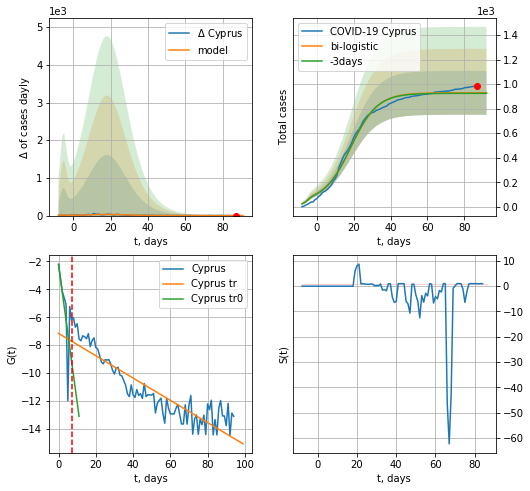

Cyprus data at: 2020-06-15
+3 day model MAPE: 0.004764409650868744
model: bi-logistic
coeffs:  [8.85197486e+02 1.37880360e-01 1.84796589e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.1925396841961504
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  929 ± 178
	 total death:  16 ± 9
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.818863
 intercept: -7.159714
 slope: -0.079824


In [329]:
dfCP = read_df(pd.DataFrame(),"CP")
dfCP = dfCP.fillna(0)
x = forecast("Cyprus",dfCP[:7],d1,7*12-dT)
xx = forecast2("Cyprus",dfCP[:],d1,12*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


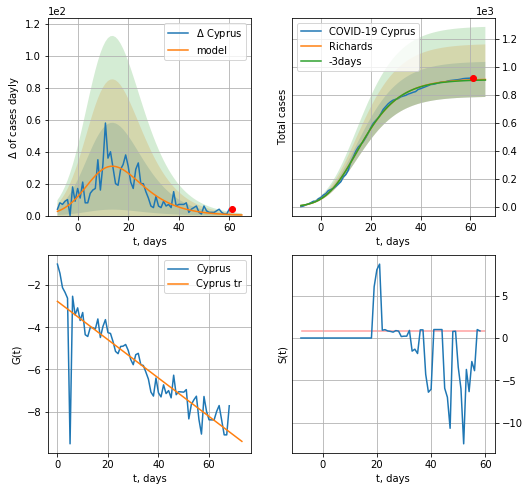

Cyprus data at: 2020-06-15
+3 day model MAPE: 0.004368
model: Richards
coeffs: [9.11933822e+02 3.20830854e-01 3.99756256e+00 3.34642778e-01]
rational stdev: 0.137523
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 908 ± 124
	 total death: 16 ± 6
trend coefficient of determination: 0.787995
 intercept: -2.772129
 slope: -0.090979


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


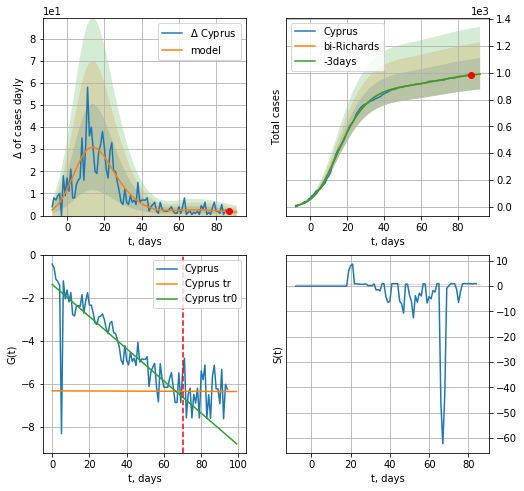

Cyprus data at: 2020-06-15
+3 day model MAPE: 0.002114
model: bi-Richards
coeffs: [ 1.09111203e+02  1.01773187e+01 -1.31846707e+01  5.88947842e-03]
rational stdev: 0.117383
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 991 ± 116
	 total death: 18 ± 6
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.728014
 intercept: -1.359580
 slope: -0.075027
trend coefficient of determination: 0.000007
 intercept: -6.319045
 slope: -0.000318


In [330]:
vL=70
x = forecastRR("Cyprus",dfCP[:vL],d1,12*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,12*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


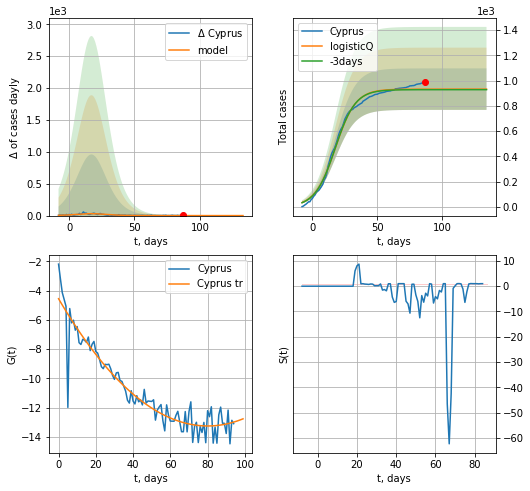

Cyprus data at: 2020-06-15
+3 day model MAPE: 0.004581
model: logisticQ
coeffs: [ 9.32181568e+02  4.52510490e-07  1.76276820e+01 -2.82700636e+05]
rational stdev: 0.176192
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 932 ± 164
	 total death: 17 ± 8
trend coefficient of determination: 0.888971
 intercept_: -4.560642100713807
 coeffs_: [ 0.         -0.21713275  0.00135634]


In [331]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases    active   death
96  2020-06-11  214788  106250.0  6109.0
97  2020-06-12  220749  107308.0  6308.0
98  2020-06-13  225132  106910.0  6498.0
99  2020-06-14  229736  107469.0  6688.0
100 2020-06-15  232992  106723.0  6860.0


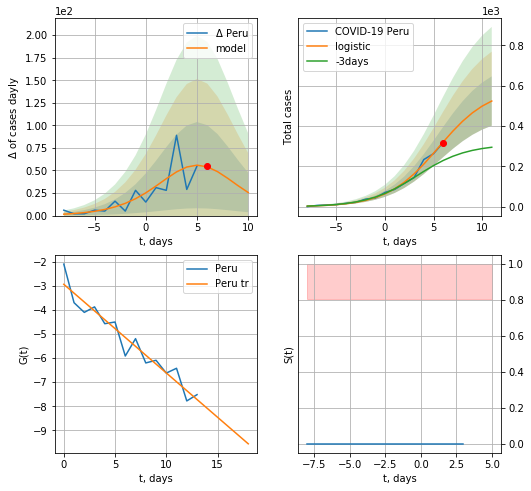

Peru data at: 2020-06-15
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +5 days
	 deltaDaycases:  25
	 total cases:  523 ± 122
	 total death:  15 ± 10
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


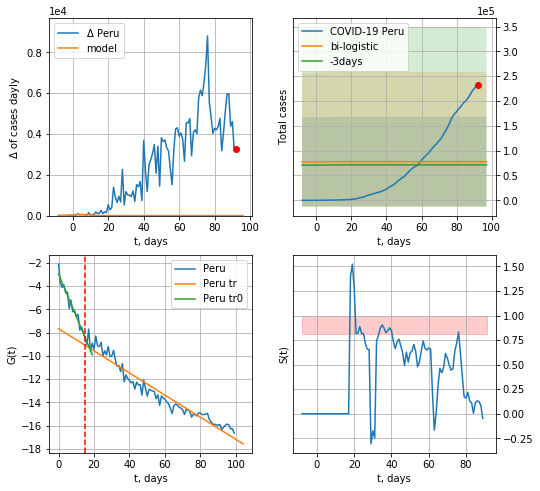

Peru data at: 2020-06-15
+3 day model MAPE: 0.08944945901059739
model: bi-logistic
coeffs:  [ 6.17674566e+04 -8.42370386e+00  2.13921270e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.1633074541405803
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  77798 ± 90503
	 total death:  2290 ± 7991
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.938930
 intercept: -7.656183
 slope: -0.095215


In [332]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*12-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


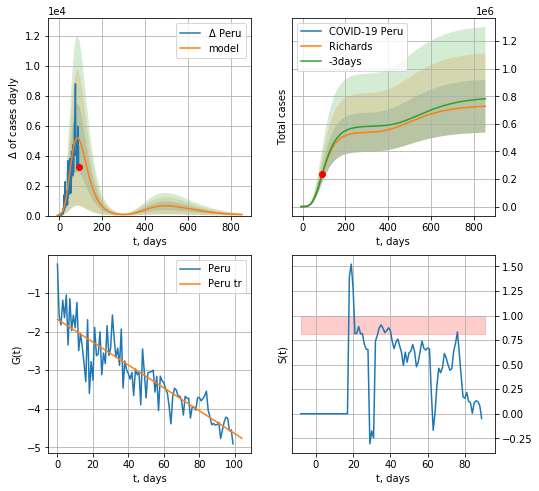

Peru data at: 2020-06-15
+3 day model MAPE: 0.009105
model: Richards
coeffs: [ 5.39381411e+05  5.24193971e-01 -2.47424878e+01  5.13216118e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.263361
forecast at the end of period: +761 days
	 deltaDaycases: 65
	 total cases: 727577 ± 191615
	 total death: 21422 ± 16925
trend coefficient of determination: 0.787319
 intercept: -1.681071
 slope: -0.029597


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


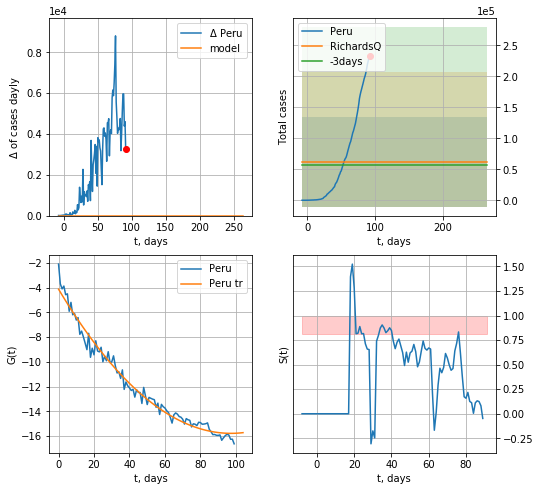

Peru data at: 2020-06-15
+3 day model MAPE: 0.089441
model: RichardsQ
coeffs: [ 6.22745243e+04  2.27764521e+01 -3.31970432e+03  2.84471217e+03
 -7.82073377e+00]
rational stdev: 1.164838
forecast at the end of period: +173 days
	 deltaDaycases: 0
	 total cases: 62274 ± 72539
	 total death: 1833 ± 6405
trend coefficient of determination: 0.977936
 intercept_: -4.1291045978558545
 coeffs_: [ 0.         -0.2396635   0.00123216]


In [333]:
x = forecastRR("Peru",dfPU[:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


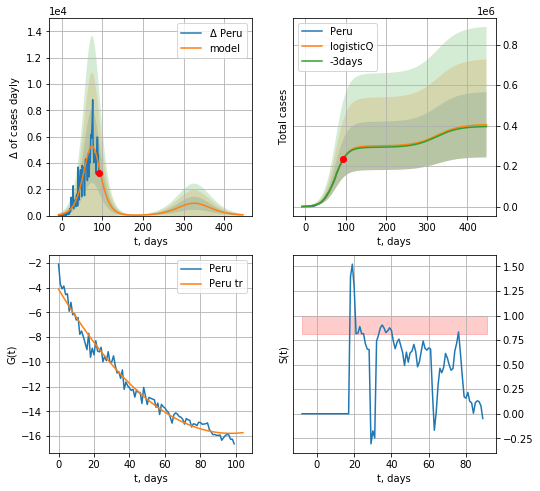

Peru data at: 2020-06-15
+3 day model MAPE: 0.009486
model: logisticQ
coeffs: [ 2.99735051e+05  1.37681466e-06  7.47900891e+01 -5.10878329e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.398420
forecast at the end of period: +355 days
	 deltaDaycases: 51
	 total cases: 404449 ± 161140
	 total death: 11908 ± 14233
trend coefficient of determination: 0.977936
 intercept_: -4.1291045978558545
 coeffs_: [ 0.         -0.2396635   0.00123216]


In [334]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date   cases    active   death
103 2020-06-11  298283  142587.0  8501.0
104 2020-06-12  309603  146383.0  8890.0
105 2020-06-13  321626  150048.0  9199.0
106 2020-06-14  333008  153799.0  9520.0
107 2020-06-15  343091  152856.0  9915.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


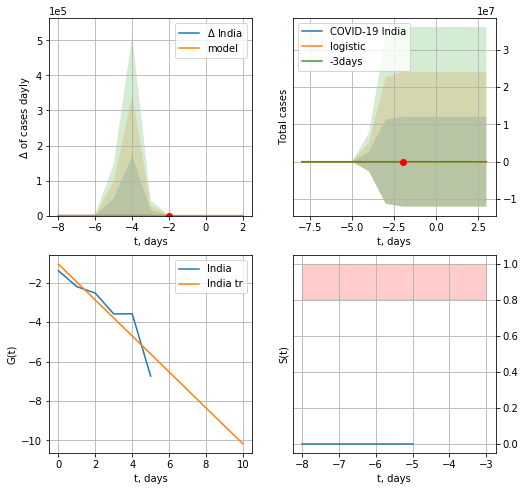

India data at: 2020-06-15
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +5 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


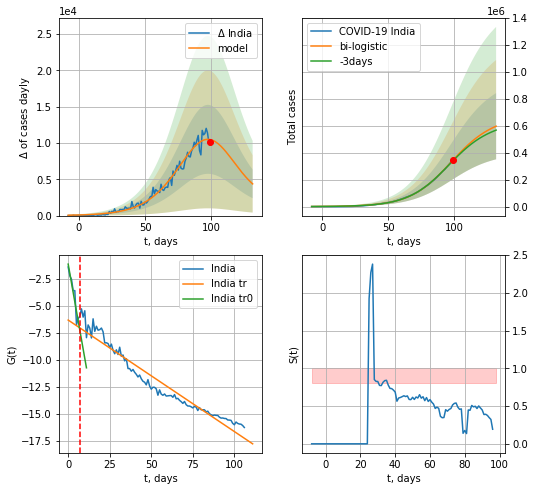

India data at: 2020-06-15
+3 day model MAPE: 0.01446243772890782
model: bi-logistic
coeffs:  [6.50939390e+05 6.41576000e-02 9.75693869e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.4114569846964982
forecast at the end of period: +33 days
	 deltaDaycases:  4369
	 total cases:  595899 ± 245186
	 total death:  17220 ± 21255
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.939219
 intercept: -6.306062
 slope: -0.103442


In [335]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*12-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


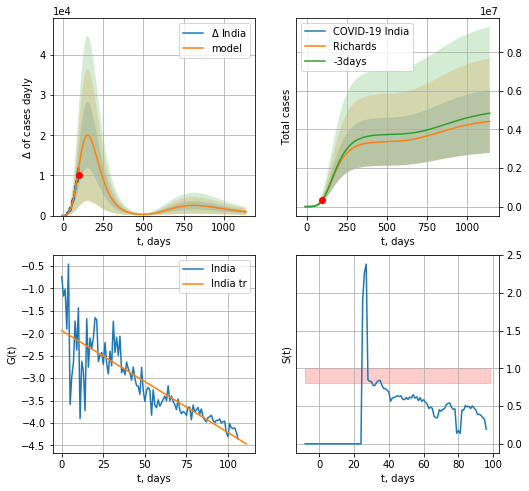

India data at: 2020-06-15
+3 day model MAPE: 0.002711
model: Richards
coeffs: [ 3.36978503e+06  2.57769432e-01 -1.08866667e+01  6.48529264e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.369645
forecast at the end of period: +1041 days
	 deltaDaycases: 921
	 total cases: 4416834 ± 1632660
	 total death: 127642 ± 141546
trend coefficient of determination: 0.708936
 intercept: -1.941500
 slope: -0.022740


In [336]:
x = forecastRR("India",dfID[:],d1,160*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


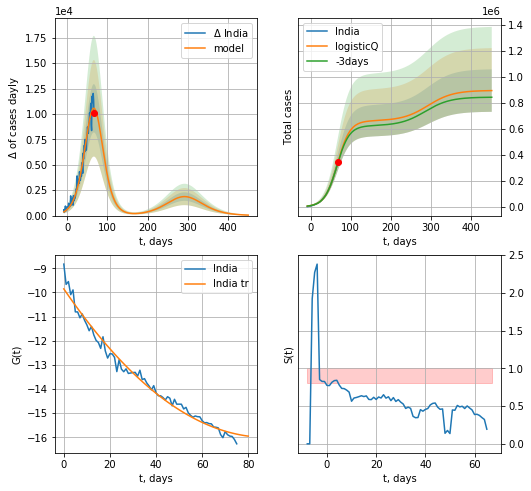

India data at: 2020-06-15
+3 day model MAPE: 0.012817
model: logisticQ
coeffs: [ 6.60908541e+05  7.06057272e-06  6.70087534e+01 -8.98210708e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.182695
forecast at the end of period: +383 days
	 deltaDaycases: 46
	 total cases: 893541 ± 163245
	 total death: 25822 ± 14152
trend coefficient of determination: 0.980419
 intercept_: -9.851421336402849
 coeffs_: [ 0.         -0.14003681  0.00079688]


In [337]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date    cases   active  death
99  2020-06-11  27373.0  18276.0  765.0
100 2020-06-12  28764.0  19236.0  785.0
101 2020-06-13  30295.0  20397.0  815.0
102 2020-06-14  31577.0  21180.0  833.0
103 2020-06-15  32785.0  22040.0  854.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


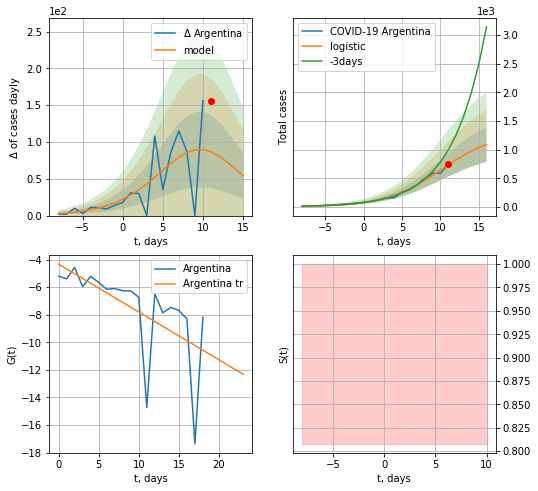

Argentina data at: 2020-06-15
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +5 days
	 deltaDaycases:  54
	 total cases:  1090 ± 302
	 total death:  28 ± 23
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


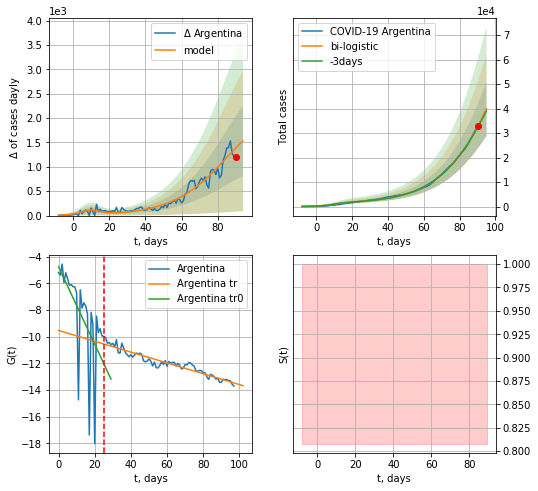

Argentina data at: 2020-06-15
+3 day model MAPE: 0.015831989161206962
model: bi-logistic
coeffs:  [1.17875035e+05 5.93760426e-02 1.07073967e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2777844160637587
forecast at the end of period: +5 days
	 deltaDaycases:  1528
	 total cases:  40002 ± 11112
	 total death:  1042 ± 868
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.907363
 intercept: -9.533798
 slope: -0.040541


In [338]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*12-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,12*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


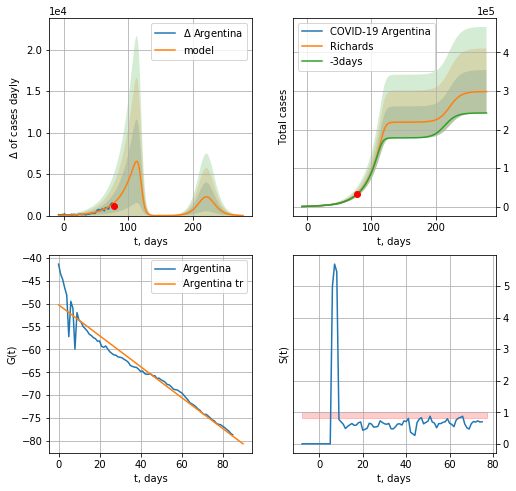

Argentina data at: 2020-06-15
+3 day model MAPE: 0.003434
model: Richards
coeffs: [2.19069933e+05 4.55242973e-02 1.19681253e+02 7.25138341e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.187379
forecast at the end of period: +201 days
	 deltaDaycases: 14
	 total cases: 298343 ± 55903
	 total death: 7771 ± 4368
trend coefficient of determination: 0.944170
 intercept: -50.268623
 slope: -0.337306


In [341]:
x = forecastRR('Argentina',dfAG[17:].fillna(0),d1,40*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


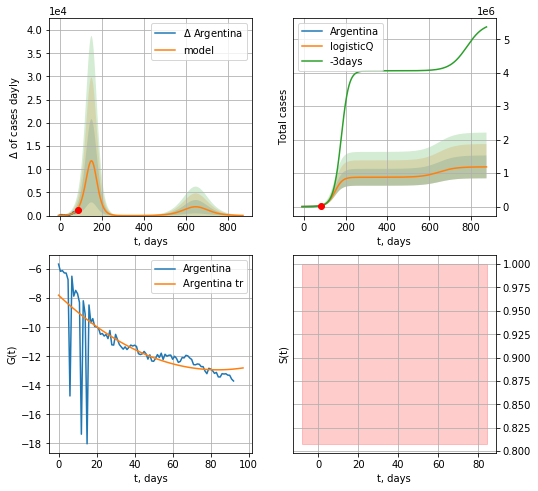

Argentina data at: 2020-06-15
+3 day model MAPE: 0.004504
model: logisticQ
coeffs: [ 8.77142176e+05  4.41185045e-05  1.48420534e+02 -1.07300453e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.287822
forecast at the end of period: +789 days
	 deltaDaycases: 27
	 total cases: 1186696 ± 341557
	 total death: 30911 ± 26690
trend coefficient of determination: 0.503277
 intercept_: -7.793304955673303
 coeffs_: [ 0.         -0.12270425  0.00073295]


In [343]:
x = forecastRRR('Argentina',dfAG[10:],d1,124*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


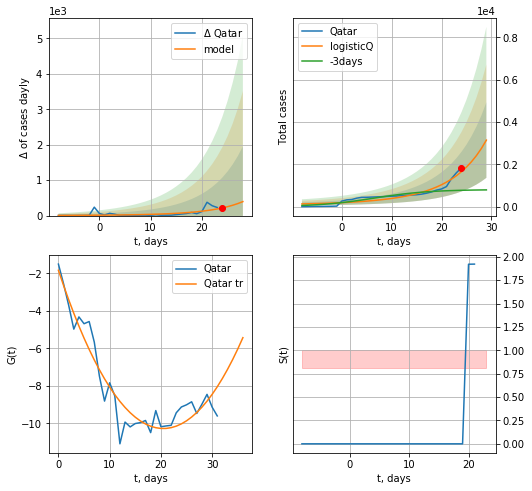

Qatar data at: 2020-06-15
+3 day model MAPE: 1.403655
model: logisticQ
coeffs: [ 4.67633524e+06  1.32940266e-03  6.79779167e+01 -1.11960120e+02]
rational stdev: 0.567221
forecast at the end of period: +5 days
	 deltaDaycases: 394
	 total cases: 3143 ± 1783
	 total death: 2 ± 3
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp


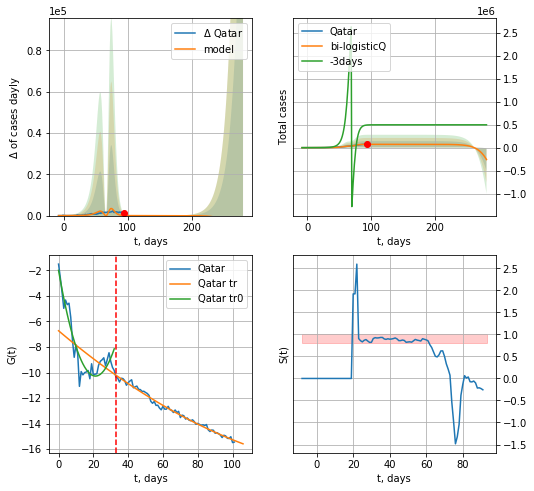

Qatar data at: 2020-06-15
+3 day model MAPE: 0.853811
model: bi-logisticQ
coeffs: [-4.60410201e+06  1.20777924e-03  6.79722507e+01 -1.33004450e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.959179
forecast at the end of period: +187 days
	 deltaDaycases: -22885
	 total cases: -258523 ± -247969
	 total death: -242 ± -696
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.986939
 intercept_: -6.725678490952397
 coeffs_: [ 0.         -0.11559064  0.00030188]


In [344]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*12-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


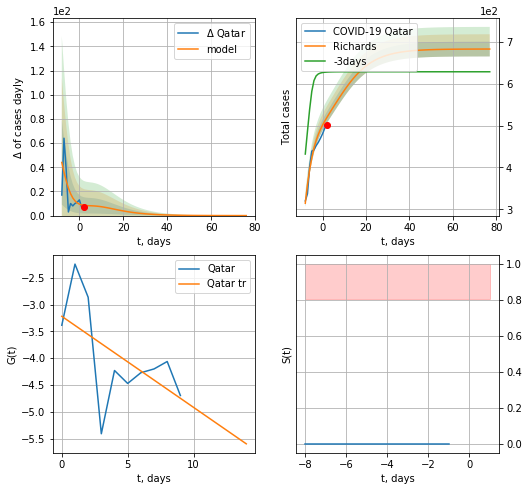

Qatar data at: 2020-06-15
+3 day model MAPE: 0.158936
model: Richards
coeffs: [ 5.01317281e+02  4.80174609e+00 -1.84019810e+01  6.85383715e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.025817
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 682 ± 17
	 total death: 0 ± 0
trend coefficient of determination: 0.312842
 intercept: -3.219590
 slope: -0.169880


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


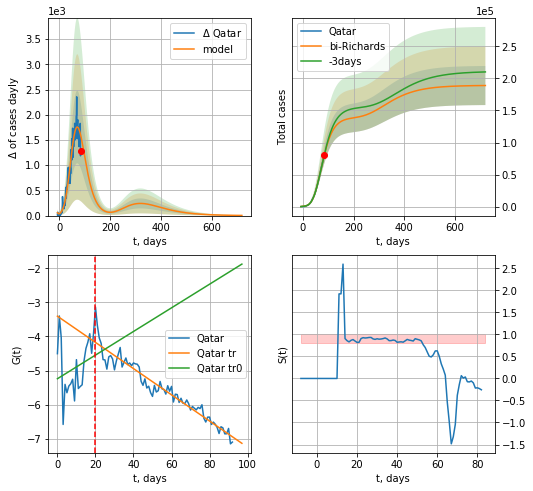

Qatar data at: 2020-06-15
+3 day model MAPE: 0.010652
model: bi-Richards
coeffs: [1.38459572e+05 1.49187453e-01 3.61534412e+01 2.60839991e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.161083
forecast at the end of period: +635 days
	 deltaDaycases: 3
	 total cases: 188896 ± 30428
	 total death: 177 ± 85
bi-Richards approximation splitting point: 20
trend coefficient of determination: 0.064060
 intercept: -5.240181
 slope: 0.034670
trend coefficient of determination: 0.926343
 intercept: -3.404479
 slope: -0.038463


In [345]:
vL = 29
x = forecastRR('Qatar',dfQR[9:vL-9].fillna(0),d1,22*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[9:].fillna(0),d1,102*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-9)

In [346]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
117 2020-06-11  40986.0   15466  286.0
118 2020-06-12  41499.0   15266  287.0
119 2020-06-13  41990.0   14941  288.0
120 2020-06-14  42294.0   14543  289.0
121 2020-06-15  42636.0   14216  291.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


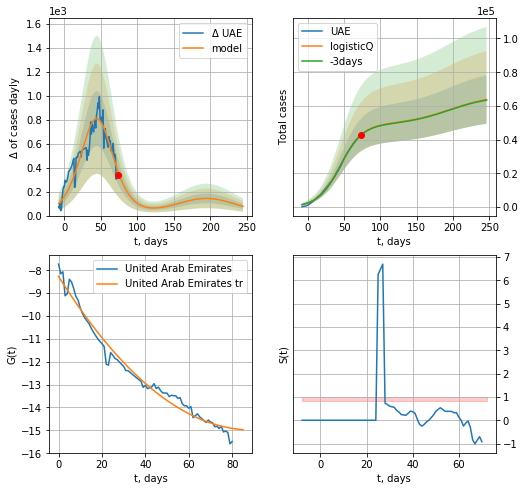

UAE data at: 2020-06-15
+3 day model MAPE: 0.003286
model: logisticQ
coeffs: [ 4.91259634e+04  1.22707378e-06  4.47695261e+01 -5.34045721e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.225145
forecast at the end of period: +173 days
	 deltaDaycases: 76
	 total cases: 63785 ± 14361
	 total death: 435 ± 293
trend coefficient of determination: 0.977299
 intercept_: -8.26752830795911
 coeffs_: [ 0.         -0.15093981  0.0008485 ]


In [347]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


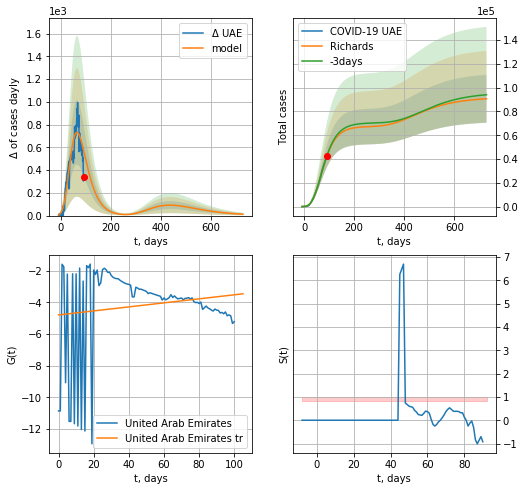

UAE data at: 2020-06-15
+3 day model MAPE: 0.009549
model: Richards
coeffs: [ 6.73969622e+04  8.07956384e-01 -4.37213169e+01  3.72041408e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.222151
forecast at the end of period: +635 days
	 deltaDaycases: 11
	 total cases: 90630 ± 20133
	 total death: 618 ± 411
trend coefficient of determination: 0.020453
 intercept: -4.791680
 slope: 0.012712


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


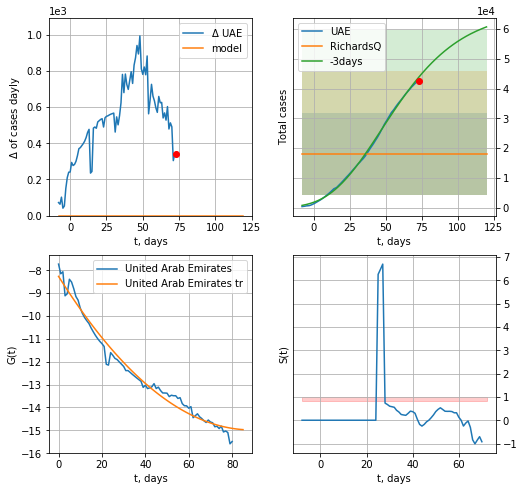

UAE data at: 2020-06-15
+3 day model MAPE: 0.591857
model: RichardsQ
coeffs: [ 1.81227195e+04 -1.66498184e+00 -8.45653695e+01 -2.47334826e+01
 -7.30564186e-02]
rational stdev: 0.763293
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 18122 ± 13832
	 total death: 123 ± 281
trend coefficient of determination: 0.977299
 intercept_: -8.26752830795911
 coeffs_: [ 0.         -0.15093981  0.0008485 ]


In [348]:
vL = 40
x = forecastRR('UAE',dfUAE[20:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('UAE',dfUAE[:],d1,102*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [349]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
100 2020-06-11  116021.0   35145   857.0
101 2020-06-12  119942.0   38020   893.0
102 2020-06-13  123308.0   39828   932.0
103 2020-06-14  127541.0   41849   972.0
104 2020-06-15  132048.0   43147  1011.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


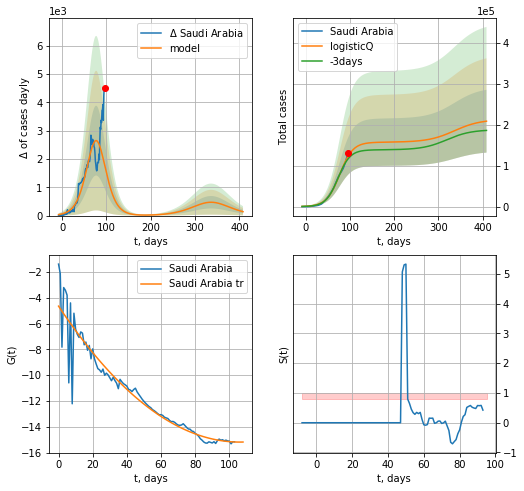

Saudi Arabia data at: 2020-06-15
+3 day model MAPE: 0.056822
model: logisticQ
coeffs: [ 1.57252294e+05  7.76720706e-07  7.71712376e+01 -8.66749385e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.367932
forecast at the end of period: +313 days
	 deltaDaycases: 138
	 total cases: 208567 ± 76738
	 total death: 1596 ± 1761
trend coefficient of determination: 0.904742
 intercept_: -4.6461769802691535
 coeffs_: [ 0.         -0.19878496  0.00093707]


In [350]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,56*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


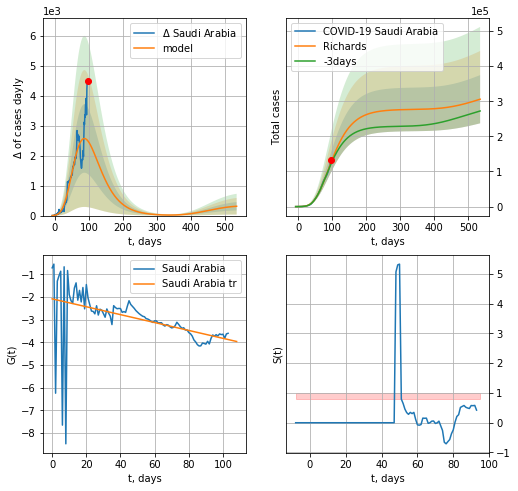

Saudi Arabia data at: 2020-06-15
+3 day model MAPE: 0.034099
model: Richards
coeffs: [ 2.77193022e+05  1.35633183e+00 -6.88125245e+01  1.87938616e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.224371
forecast at the end of period: +439 days
	 deltaDaycases: 312
	 total cases: 305921 ± 68639
	 total death: 2342 ± 1576
trend coefficient of determination: 0.209437
 intercept: -2.076643
 slope: -0.017449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


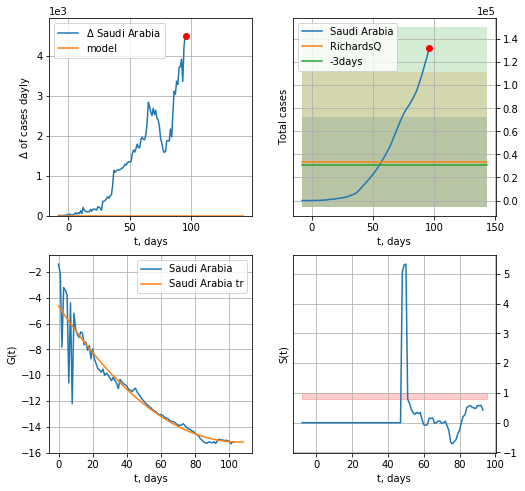

Saudi Arabia data at: 2020-06-15
+3 day model MAPE: 0.089365
model: RichardsQ
coeffs: [ 3.36835717e+04  1.24408060e+01 -1.73915740e+03  1.50081707e+03
 -4.11544996e+00]
rational stdev: 1.155910
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 33683 ± 38935
	 total death: 257 ± 891
trend coefficient of determination: 0.904742
 intercept_: -4.6461769802691535
 coeffs_: [ 0.         -0.19878496  0.00093707]


In [351]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,74*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
          date   cases  active  death
93 2020-06-11  1877.0     716   11.0
94 2020-06-12  1880.0     673   11.0
95 2020-06-13  1884.0     621   11.0
96 2020-06-14  1889.0     591   11.0
97 2020-06-15  1905.0     552   11.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


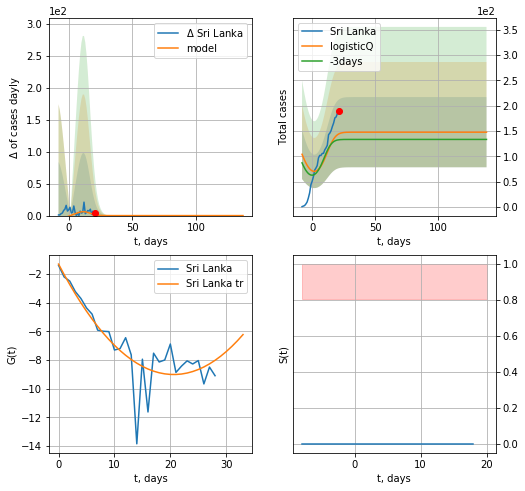

Sri Lanka data at: 2020-06-15
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +117 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


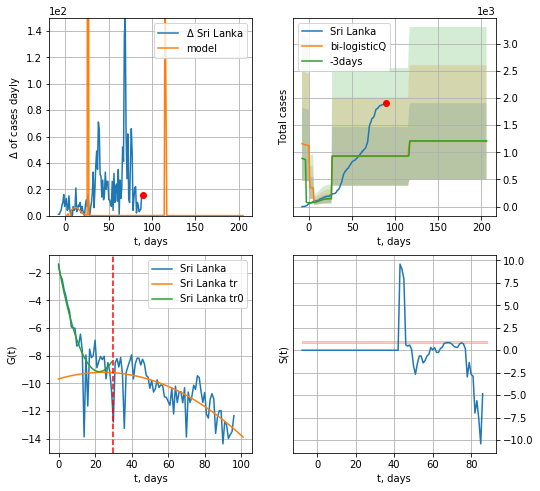

Sri Lanka data at: 2020-06-15
+3 day model MAPE: 0.006191
model: bi-logisticQ
coeffs: [7.78753766e+02 3.18610750e+00 2.65963269e+01 2.85126320e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.583744
forecast at the end of period: +117 days
	 deltaDaycases: 0
	 total cases: 1202 ± 701
	 total death: 6 ± 10
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.538656
 intercept_: -9.676985400005343
 coeffs_: [ 0.          0.03877236 -0.00079547]


In [352]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

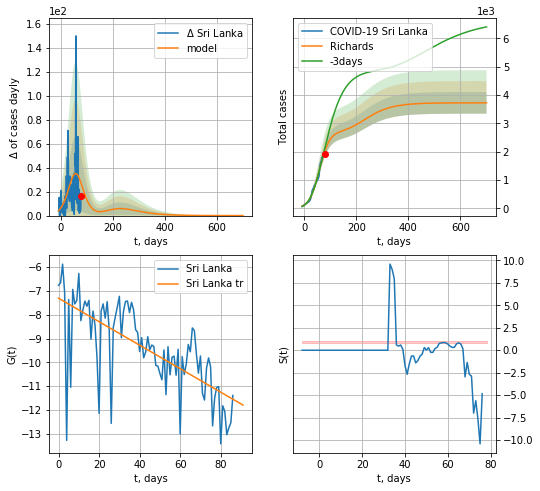

Sri Lanka data at: 2020-06-15
+3 day model MAPE: 0.053554
model: Richards
coeffs: [2.73354828e+03 5.64797907e-02 5.53095966e+01 8.75619605e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.102854
forecast at the end of period: +621 days
	 deltaDaycases: 0
	 total cases: 3723 ± 383
	 total death: 21 ± 6
trend coefficient of determination: 0.473675
 intercept: -7.305918
 slope: -0.049360


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


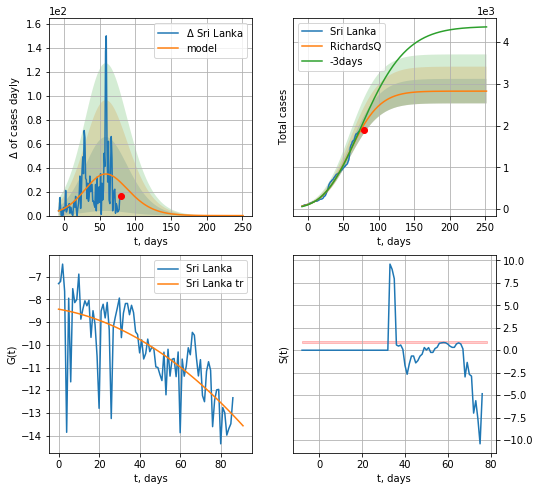

Sri Lanka data at: 2020-06-15
+3 day model MAPE: 0.049561
model: RichardsQ
coeffs: [ 2.82349392e+03  5.95030177e-04  1.29433041e-02 -1.80519635e+02
  2.12807938e-01]
rational stdev: 0.103762
forecast at the end of period: +173 days
	 deltaDaycases: 0
	 total cases: 2823 ± 292
	 total death: 16 ± 4
trend coefficient of determination: 0.540787
 intercept_: -8.427727158526766
 coeffs_: [ 0.         -0.01535457 -0.00045193]


In [353]:
vL=52
x = forecastRR('Sri Lanka',dfSri[10:],d1,100*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Sri Lanka',dfSri[10:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
105 2020-06-11  125933.0   83223  2463.0
106 2020-06-12  132405.0   79798  2551.0
107 2020-06-13  139230.0   84863  2632.0
108 2020-06-14  144472.0   88022  2729.0
109 2020-06-15  148921.0   89692  2839.0


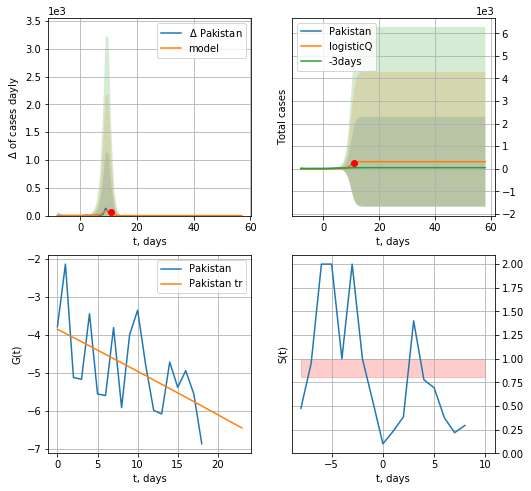

Pakistan data at: 2020-06-15
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +47 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 5 ± 96
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


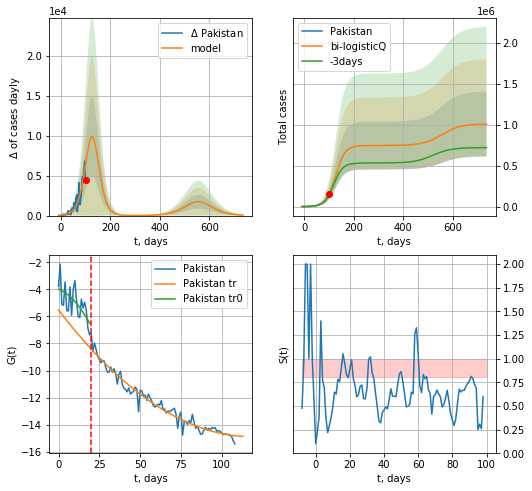

Pakistan data at: 2020-06-15
+3 day model MAPE: 0.027474
model: bi-logisticQ
coeffs: [ 7.46270104e+05  5.67249303e-06  1.27415232e+02 -9.20443081e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392232
forecast at the end of period: +635 days
	 deltaDaycases: 59
	 total cases: 1008653 ± 395626
	 total death: 19228 ± 22625
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.961881
 intercept_: -5.522116739235674
 coeffs_: [ 0.         -0.1577331   0.00066341]


In [354]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,102*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


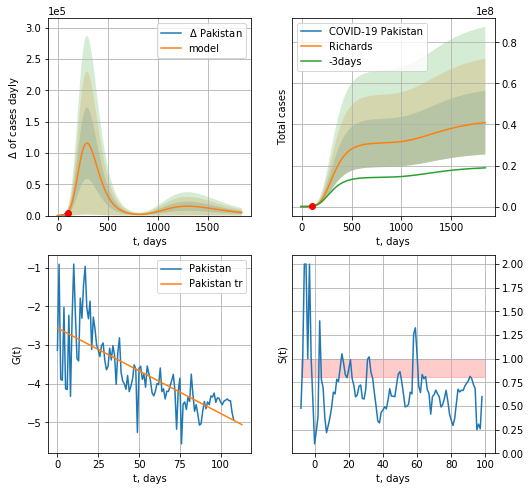

Pakistan data at: 2020-06-15
+3 day model MAPE: 0.024315
model: Richards
coeffs: [3.10609477e+07 8.93770954e-02 9.13026750e+01 1.20154860e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.379596
forecast at the end of period: +1741 days
	 deltaDaycases: 4874
	 total cases: 40895423 ± 15523742
	 total death: 779622 ± 887824
trend coefficient of determination: 0.551393
 intercept: -2.559603
 slope: -0.022087


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


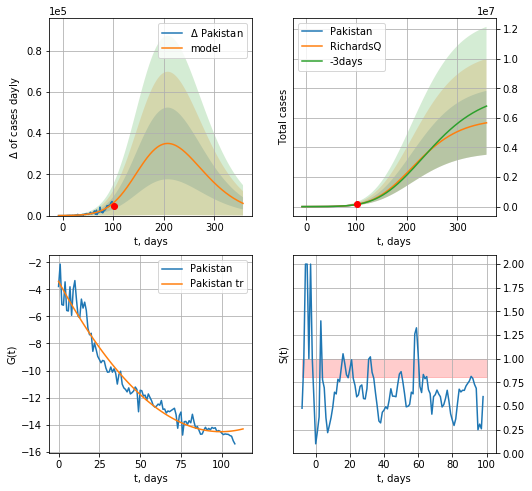

Pakistan data at: 2020-06-15
+3 day model MAPE: 0.022610
model: RichardsQ
coeffs: [ 5.93845371e+06  2.37871182e-04 -1.11937212e+00 -5.15280597e+02
  7.56192953e-02]
rational stdev: 0.381496
forecast at the end of period: +257 days
	 deltaDaycases: 5931
	 total cases: 5666671 ± 2161811
	 total death: 108028 ± 123636
trend coefficient of determination: 0.961931
 intercept_: -3.409823756069313
 coeffs_: [ 0.         -0.22342008  0.00112277]


In [356]:
x = forecastRR('Pakistan',dfPS[:],d1,260*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
          date    cases  active   death
95 2020-06-11  78052.0   60256  1049.0
96 2020-06-12  81523.0   63179  1095.0
97 2020-06-13  84379.0   65412  1139.0
98 2020-06-14  87520.0   67619  1171.0
99 2020-06-15  90619.0   55383  1209.0


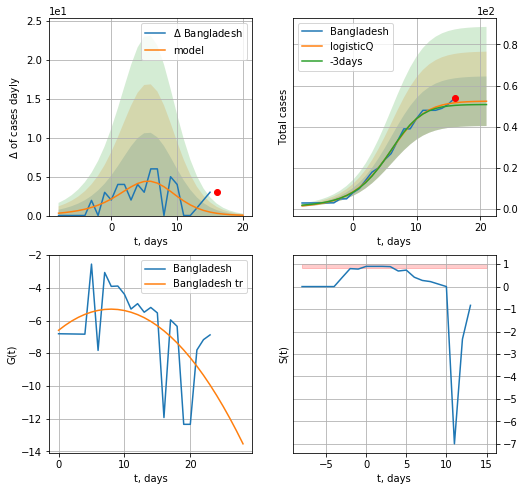

Bangladesh data at: 2020-06-15
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +5 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


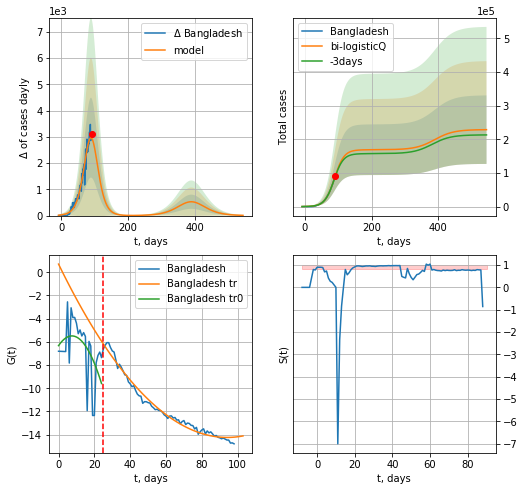

Bangladesh data at: 2020-06-15
+3 day model MAPE: 0.016412
model: bi-logisticQ
coeffs: [ 1.69023212e+05  3.01990074e-06  8.92267889e+01 -2.31631452e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.445275
forecast at the end of period: +453 days
	 deltaDaycases: 9
	 total cases: 228686 ± 101828
	 total death: 3051 ± 4075
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.981842
 intercept_: 0.7030799295963277
 coeffs_: [ 0.         -0.31731247  0.00168448]


In [357]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,12*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


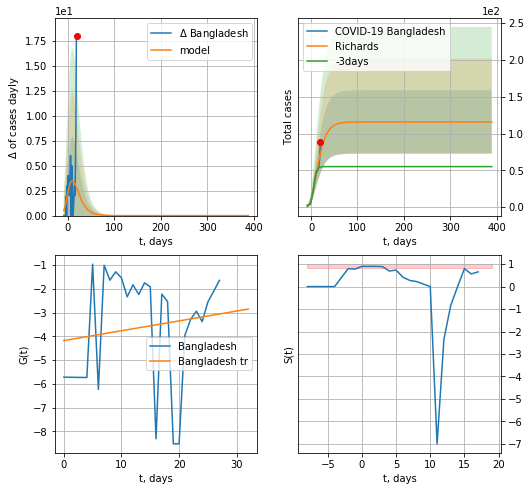

Bangladesh data at: 2020-06-15
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +369 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


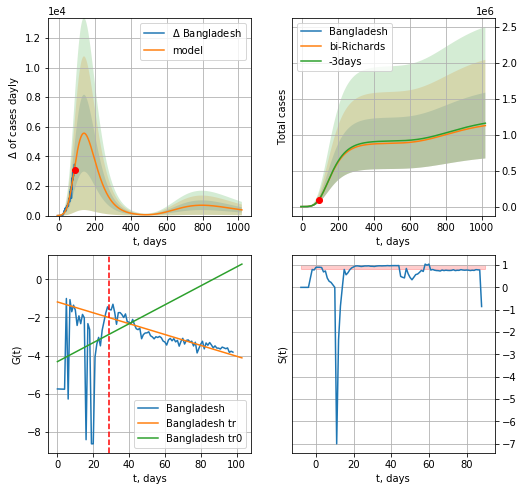

Bangladesh data at: 2020-06-15
+3 day model MAPE: 0.001097
model: bi-Richards
coeffs: [ 8.80775592e+05  4.48430600e-01 -4.46259662e+01  3.90787446e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.405823
forecast at the end of period: +929 days
	 deltaDaycases: 385
	 total cases: 1126544 ± 457177
	 total death: 15029 ± 18297
bi-Richards approximation splitting point: 29
trend coefficient of determination: 0.032228
 intercept: -4.316950
 slope: 0.049653
trend coefficient of determination: 0.820255
 intercept: -1.186530
 slope: -0.028476


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


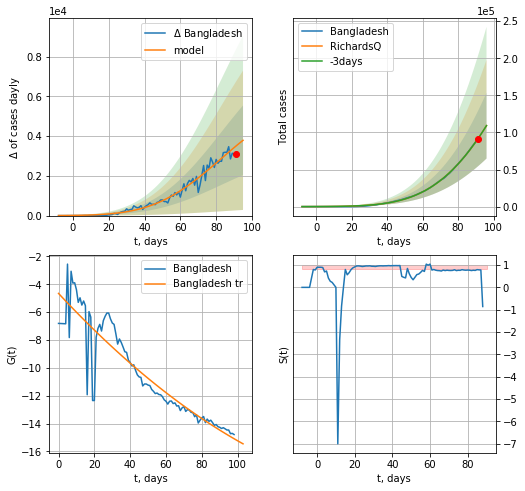

Bangladesh data at: 2020-06-15
+3 day model MAPE: 0.000564
model: RichardsQ
coeffs: [ 6.95306411e+05  2.70083091e-03 -3.38517393e+02 -3.51244129e+02
  8.00925174e-03]
rational stdev: 0.406401
forecast at the end of period: +5 days
	 deltaDaycases: 3791
	 total cases: 109174 ± 44368
	 total death: 1456 ± 1775
trend coefficient of determination: 0.842746
 intercept_: -4.656045288178324
 coeffs_: [ 0.         -0.13814092  0.00032315]


In [358]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:],d1,144*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Bangladesh',dfBN[:],d1,12*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
108 2020-06-11  34432.0   10016  279.0
109 2020-06-12  34952.0    9619  285.0
110 2020-06-13  35466.0    9295  289.0
111 2020-06-14  35920.0    8865  296.0
112 2020-06-15  36431.0    8602  298.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


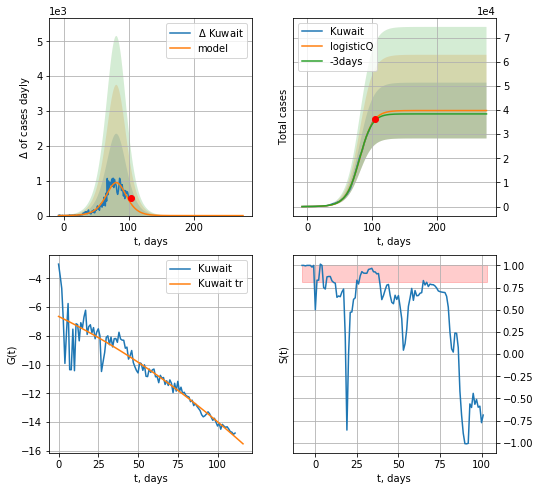

Kuwait data at: 2020-06-15
+3 day model MAPE: 0.015458
model: logisticQ
coeffs: [ 3.97928523e+04  7.52537120e-05  8.10123238e+01 -1.18355714e+03]
rational stdev: 0.290179
forecast at the end of period: +173 days
	 deltaDaycases: 0
	 total cases: 39792 ± 11547
	 total death: 325 ± 282
trend coefficient of determination: 0.877661
 intercept_: -6.6479024588706155
 coeffs_: [ 0.         -0.05410165 -0.00019288]


In [359]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


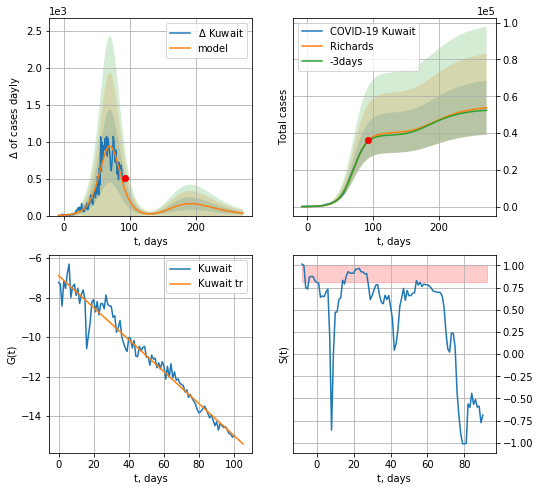

Kuwait data at: 2020-06-15
+3 day model MAPE: 0.013856
model: Richards
coeffs: [4.02303188e+04 9.23088378e-02 7.05358177e+01 1.02017388e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.272299
forecast at the end of period: +180 days
	 deltaDaycases: 32
	 total cases: 53761 ± 14639
	 total death: 439 ± 358
trend coefficient of determination: 0.958598
 intercept: -6.887828
 slope: -0.081124


In [360]:
iL= 11
vL = 24 + iL
x = forecastRR('Kuwait',dfKW[iL:],d1,37*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Kuwait',dfKW[iL:],d1,37*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active  death
102 2020-06-11  21437.0    8335  561.0
103 2020-06-12  22008.0    8686  568.0
104 2020-06-13  22572.0    8911  577.0
105 2020-06-14  22962.0    9050  592.0
106 2020-06-15  23271.0    8641  605.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


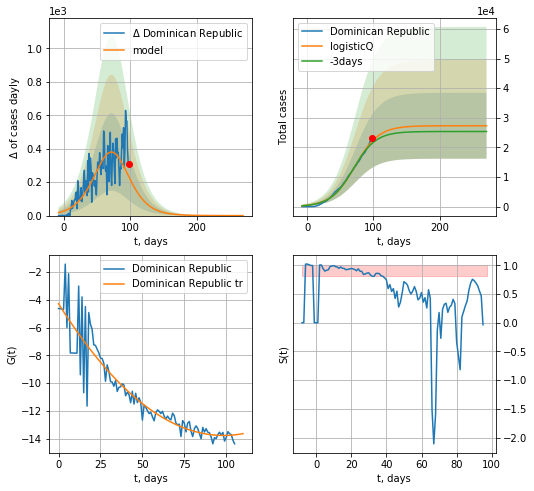

Dominican Republic data at: 2020-06-15
+3 day model MAPE: 0.034312
model: logisticQ
coeffs: [ 2.73044061e+04  5.00350382e-07  7.21806146e+01 -1.11250212e+05]
rational stdev: 0.407300
forecast at the end of period: +173 days
	 deltaDaycases: 0
	 total cases: 27303 ± 11120
	 total death: 709 ± 866
trend coefficient of determination: 0.864065
 intercept_: -4.279536090437835
 coeffs_: [ 0.         -0.19301216  0.00098092]


In [361]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


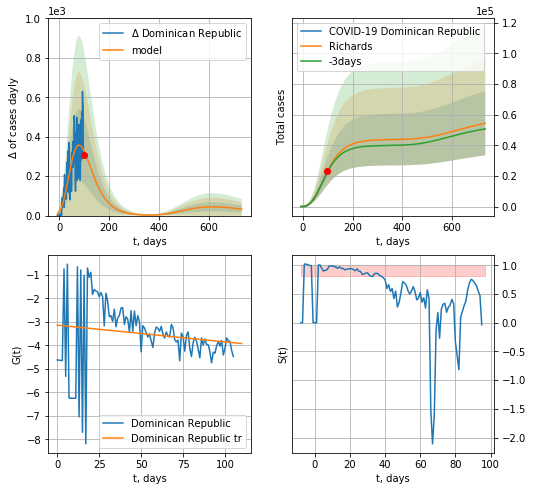

Dominican Republic data at: 2020-06-15
+3 day model MAPE: 0.019076
model: Richards
coeffs: [ 4.37695461e+04  1.49222540e+00 -1.08391818e+02  1.49670627e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.385542
forecast at the end of period: +635 days
	 deltaDaycases: 32
	 total cases: 54336 ± 20949
	 total death: 1412 ± 1633
trend coefficient of determination: 0.024296
 intercept: -3.135269
 slope: -0.007123


In [362]:
x = forecastRR('Dominican Republic',dfDM[:],d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

MD
           date    cases  active  death
96  2020-06-11  10727.0    4280  375.0
97  2020-06-12  11093.0    4479  385.0
98  2020-06-12  11459.0    4640  398.0
99  2020-06-14  11740.0    4711  406.0
100 2020-06-15  11879.0    4561  417.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


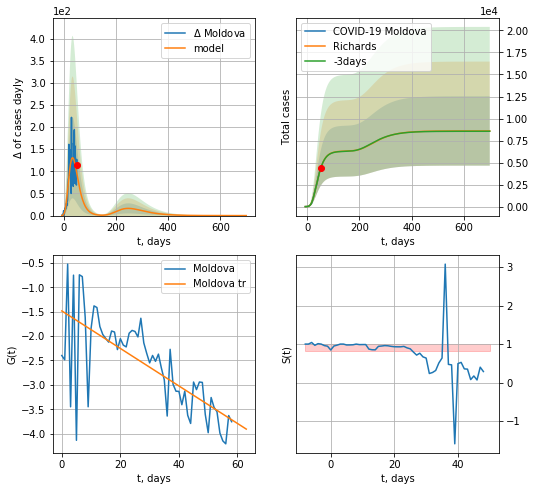

Moldova data at: 2020-06-15
+3 day model MAPE: 0.000788
model: Richards
coeffs: [ 6.30547574e+03  3.98849226e+00 -4.11476415e+01  1.42380272e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.458349
forecast at the end of period: +649 days
	 deltaDaycases: 0
	 total cases: 8590 ± 3937
	 total death: 301 ± 413
trend coefficient of determination: 0.512179
 intercept: -1.485671
 slope: -0.038427


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


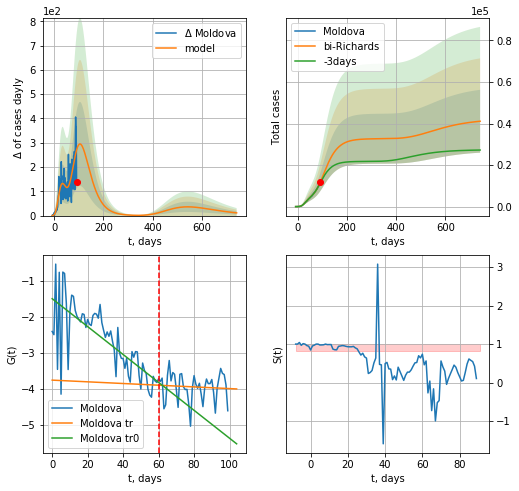

Moldova data at: 2020-06-15
+3 day model MAPE: 0.032269
model: bi-Richards
coeffs: [ 2.64000293e+04  1.84987603e+00 -3.08015097e+01  1.62244043e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.368299
forecast at the end of period: +649 days
	 deltaDaycases: 11
	 total cases: 41107 ± 15139
	 total death: 1443 ± 1594
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.529450
 intercept: -1.488850
 slope: -0.038750
trend coefficient of determination: 0.005025
 intercept: -3.750308
 slope: -0.002350


In [363]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,104*7-dT,addpred=True,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,104*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [ ]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [5]:
df.head(10)
#df.columns[18]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,NewRecovered,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,\n,,,"1,264,194",North America,\nNorth America\n,,"+4,310",469,"+5,059",,"19,458",,"2,512,341","146,219","1,101,928",,
1,,\n,,,"608,989",South America,\nSouth America\n,,614,21,"+11,523",,"12,091",,"1,463,160","61,562","792,609",,
2,,\n,,,"859,934",Europe,\nEurope\n,,"+8,919",212,"+10,741",,"6,568",,"2,229,009","183,427","1,185,648",,
3,,\n,,,"582,018",Asia,\nAsia\n,,"+5,880",127,"+18,397",,"15,931",,"1,659,999","41,285","1,036,696",,
4,,\n,,,"130,709",Africa,\nAfrica\n,,87,3,66,,515,,"254,301","6,796","116,796",,
5,,\n,,,394,Australia/Oceania,\nOceania\n,,14,,3,,4,,"8,960",124,"8,442",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"3,446,293",All,World,56.4,"+19,824",832,"+45,789",,"54,571",,"8,128,491","439,428","4,242,770",,"1,043"
8,1,152,"2,798",13,"1,174,801",North America,USA,357,,,,"330,922,877","16,716","76,329","2,182,950","118,283","889,866","25,259,077","6,597"
9,2,238,"4,817",130,"382,664",South America,Brazil,208,,,"+11,206","212,496,348","8,318","7,664","891,556","44,118","464,774","1,628,482","4,196"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,264,194",North America,\nNorth America\n,,"+4,310",469,"+5,059",,"19,458",,"2,512,341","146,219","1,101,928",,
1,,\n,,,"608,989",South America,\nSouth America\n,,614,21,"+11,523",,"12,091",,"1,463,160","61,562","792,609",,
2,,\n,,,"859,934",Europe,\nEurope\n,,"+8,919",212,"+10,741",,"6,568",,"2,229,009","183,427","1,185,648",,
3,,\n,,,"582,018",Asia,\nAsia\n,,"+5,880",127,"+18,397",,"15,931",,"1,659,999","41,285","1,036,696",,
4,,\n,,,"130,709",Africa,\nAfrica\n,,87,3,66,,515,,"254,301","6,796","116,796",,


In [7]:
df[df["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
110,103,"1,536","35,835",7,268,Europe,Lithuania,28,,,,"2,723,477",17,"134,070","1,773",76,"1,429","365,136",651
343,104,"1,536","35,835",7,268,Europe,Lithuania,28,5,1,2,"2,723,477",17,"134,070","1,773",76,"1,429","365,136",651
575,104,"1,540","36,313",7,266,Europe,Lithuania,28,5,,11,"2,723,477",17,"133,479","1,768",75,"1,427","363,528",649


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [9]:
df.head(35)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,264,194",North America,\nNorth America\n,,"+4,310",469,"+5,059",,"19,458",,"2,512,341","146,219","1,101,928",,
1,,\n,,,"608,989",South America,\nSouth America\n,,614,21,"+11,523",,"12,091",,"1,463,160","61,562","792,609",,
2,,\n,,,"859,934",Europe,\nEurope\n,,"+8,919",212,"+10,741",,"6,568",,"2,229,009","183,427","1,185,648",,
3,,\n,,,"582,018",Asia,\nAsia\n,,"+5,880",127,"+18,397",,"15,931",,"1,659,999","41,285","1,036,696",,
4,,\n,,,"130,709",Africa,\nAfrica\n,,87,3,66,,515,,"254,301","6,796","116,796",,
5,,\n,,,394,Australia/Oceania,\nOceania\n,,14,,3,,4,,"8,960",124,"8,442",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"3,446,293",All,World,56.4,"+19,824",832,"+45,789",,"54,571",,"8,128,491","439,428","4,242,770",,"1,043"
8,1,152,"2,798",13,"1,174,801",North America,USA,357,,,,"330,922,877","16,716","76,329","2,182,950","118,283","889,866","25,259,077","6,597"
9,2,238,"4,817",130,"382,664",South America,Brazil,208,,,"+11,206","212,496,348","8,318","7,664","891,556","44,118","464,774","1,628,482","4,196"


In [10]:
df.at[13, 'TotalRecovered'] = 0
df.at[12, 'TotalRecovered'] = 0
df.at[31, 'TotalRecovered'] = 0
df.at[32, 'TotalRecovered'] = 0
df.at[13,"ActiveCases"] = 0
df.at[12,"ActiveCases"] = 0
df.at[31,"ActiveCases"] = 0
df.at[32,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1264194,North America,\nNorth America\n,NaN,4310.0,469.0,"+5,059",,19458.0,NaN,2512341,146219.0,1101928.0,NaN,NaN
1,,\n,,,608989,South America,\nSouth America\n,NaN,614.0,21.0,"+11,523",,12091.0,NaN,1463160,61562.0,792609.0,NaN,NaN
2,,\n,,,859934,Europe,\nEurope\n,NaN,8919.0,212.0,"+10,741",,6568.0,NaN,2229009,183427.0,1185648.0,NaN,NaN
3,,\n,,,582018,Asia,\nAsia\n,NaN,5880.0,127.0,"+18,397",,15931.0,NaN,1659999,41285.0,1036696.0,NaN,NaN
4,,\n,,,130709,Africa,\nAfrica\n,NaN,87.0,3.0,66,,515.0,NaN,254301,6796.0,116796.0,NaN,NaN
5,,\n,,,394,Australia/Oceania,\nOceania\n,NaN,14.0,NaN,3,,4.0,NaN,8960,124.0,8442.0,NaN,NaN
6,,\n,,,55,,\n\n,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,\n,,,3446293,All,World,56.4,19824.0,832.0,"+45,789",,54571.0,NaN,8128491,439428.0,4242770.0,NaN,1043.0
8,1,152,"2,798",13,1174801,North America,USA,357.0,NaN,NaN,,"330,922,877",16716.0,76329.0,2182950,118283.0,889866.0,25259077.0,6597.0
9,2,238,"4,817",130,382664,South America,Brazil,208.0,NaN,NaN,"+11,206","212,496,348",8318.0,7664.0,891556,44118.0,464774.0,1628482.0,4196.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,,,,582018,Asia,Total:,NaN,5880.0,127.0,"+18,397",,15931.0,NaN,1659999,41285.0,1036696.0,NaN,NaN
227,,,,,130709,Africa,Total:,NaN,87.0,3.0,66,,515.0,NaN,254301,6796.0,116796.0,NaN,NaN
228,,,,,394,Australia/Oceania,Total:,NaN,14.0,NaN,,,4.0,NaN,8960,124.0,8442.0,NaN,NaN
229,,,,,55,,Total:,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,NaN,NaN,NaN,162234,Europe,European Union,291.442673,5.0,2.0,NaN,NaN,3001.0,54881.338104,1222569,129765.0,576142.0,24435944.0,2745.800311


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1264194,North America,North America,NaN,4310.0,469.0,"+5,059",,19458.0,NaN,2512341,146219.0,1101928.0,NaN,NaN
1,,\n,,,608989,South America,South America,NaN,614.0,21.0,"+11,523",,12091.0,NaN,1463160,61562.0,792609.0,NaN,NaN
2,,\n,,,859934,Europe,Europe,NaN,8919.0,212.0,"+10,741",,6568.0,NaN,2229009,183427.0,1185648.0,NaN,NaN
3,,\n,,,582018,Asia,Asia,NaN,5880.0,127.0,"+18,397",,15931.0,NaN,1659999,41285.0,1036696.0,NaN,NaN
4,,\n,,,130709,Africa,Africa,NaN,87.0,3.0,66,,515.0,NaN,254301,6796.0,116796.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [16]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1264194,North America,North America,NaN,4310.0,469.0,"+5,059",,19458.0,NaN,2512341,146219.0,1101928.0,NaN,NaN
1,,\n,,,608989,South America,South America,NaN,614.0,21.0,"+11,523",,12091.0,NaN,1463160,61562.0,792609.0,NaN,NaN
2,,\n,,,859934,Europe,Europe,NaN,8919.0,212.0,"+10,741",,6568.0,NaN,2229009,183427.0,1185648.0,NaN,NaN
3,,\n,,,582018,Asia,Asia,NaN,5880.0,127.0,"+18,397",,15931.0,NaN,1659999,41285.0,1036696.0,NaN,NaN
4,,\n,,,130709,Africa,Africa,NaN,87.0,3.0,66,,515.0,NaN,254301,6796.0,116796.0,NaN,NaN
5,,\n,,,394,Australia/Oceania,Oceania,NaN,14.0,NaN,3,,4.0,NaN,8960,124.0,8442.0,NaN,NaN
7,,\n,,,3446293,All,World,56.4,19824.0,832.0,"+45,789",,54571.0,NaN,8128491,439428.0,4242770.0,NaN,1043.0
8,1,152,"2,798",13,1174801,North America,USA,357.0,NaN,NaN,,"330,922,877",16716.0,76329.0,2182950,118283.0,889866.0,25259077.0,6597.0
9,2,238,"4,817",130,382664,South America,Brazil,208.0,NaN,NaN,"+11,206","212,496,348",8318.0,7664.0,891556,44118.0,464774.0,1628482.0,4196.0
10,3,268,"20,035",10,243868,Europe,Russia,50.0,8248.0,193.0,"+9,767","145,932,063",2300.0,104843.0,545458,7284.0,294306.0,15300000.0,3738.0


In [17]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [18]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Turkey TR
Croatia CT
Ukraine Ukr
France FR
Australia AS
Qatar QR
Austria AT
Egypt EG
Finland FI
Peru PU
S. Korea KR
Sri Lanka Sri
Denmark DK
Iraq IQ
Bulgaria BL
Japan JP
World World
New Zealand ZL
Philippines PH
Chile CL
Netherlands NL
Spain SP
Slovenia SV
Belgium BG
India ID
Estonia ES
China CN
Czechia CH
Latvia LV
Sweden SW
Colombia CB
Serbia SB
Singapore SG
Panama PM
Bangladesh BN
Malaysia ML
European Union EU
Canada CA
Brazil BZ
Cyprus CP
Romania RM
Kuwait KW
Indonesia IE
Luxembourg LX
Switzerland SZ
Argentina AG
Portugal PT
Hungary HG
Morocco MR
Pakistan PS
USA US
Israel IS
UAE UAE
Slovakia SL
Algeria AR
Ecuador ED
Poland PL
Malta MT
Lithuania LT
Iceland IC
Ireland IR
Mexico MX
Russia RS
Thailand TH
Moldova MD
Italy IT
Germany GR
Dominican Republic DM
Norway NG
Greece GC
Saudi Arabia SA
Iran IN
UK GB
Belarus BR


In [19]:
len(countryDic)

74

In [20]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-06-15,2512341,1264194,146219.0
South America
South America 2020-06-15,1463160,608989,61562.0
Europe
Europe 2020-06-15,2229009,859934,183427.0
Asia
Asia 2020-06-15,1659999,582018,41285.0
Africa
Africa 2020-06-15,254301,130709,6796.0
Oceania
Oceania 2020-06-15,8960,394,124.0
World
World 2020-06-15,8128491,3446293,439428.0
USA
USA 2020-06-15,2182950,1174801,118283.0
Brazil
Brazil 2020-06-15,891556,382664,44118.0
Russia
Russia 2020-06-15,545458,243868,7284.0
India
India 2020-06-15,343091,152856,9915.0
UK
UK 2020-06-15,296857,0,41736.0
Spain
Spain 2020-06-15,291189,0,27136.0
Italy
Italy 2020-06-15,237290,25909,34371.0
Peru
Peru 2020-06-15,232992,106723,6860.0
Iran
Iran 2020-06-15,189876,30336,8950.0
Germany
Germany 2020-06-15,188044,6059,8885.0
Turkey
Turkey 2020-06-15,179831,22642,4825.0
Chile
Chile 2020-06-15,179436,27282,3362.0
France
France 2020-06-15,157372,54892,29436.0
Mexico
Mexico 2020-06-15,150264,19678,17580.0
Pakistan
Pakistan 2020-06-15,148921,8

In [21]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [22]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaTR.csv 2020-06-15,179831,22642,4825.0

append data/coronaCT.csv 2020-06-15,2254,7,107.0

append data/coronaUkr.csv 2020-06-15,32476,17036,912.0

append data/coronaFR.csv 2020-06-15,157372,54892,29436.0

append data/coronaAS.csv 2020-06-15,7347,392,102.0

append data/coronaQR.csv 2020-06-15,80876,22119,76.0

append data/coronaAT.csv 2020-06-15,17135,391,678.0

append data/coronaEG.csv 2020-06-15,46289,32288,1672.0

append data/coronaFI.csv 2020-06-15,7108,582,326.0

append data/coronaPU.csv 2020-06-15,232992,106723,6860.0

append data/coronaKR.csv 2020-06-15,12155,1117,278.0

append data/coronaSri.csv 2020-06-15,1905,552,11.0

append data/coronaDK.csv 2020-06-15,12217,529,598.0

append data/coronaIQ.csv 2020-06-15,21315,11392,652.0

append data/coronaBL.csv 2020-06-15,3341,1381,176.0

append data/coronaJP.csv 2020-06-15,17502,891,925.0

append data/coronaWorld.csv 2020-06-15,8128491,3446293,439428.0

append data/coronaZL.csv 2020-06-15,1506,2,22.0

append data/coronaPH

In [21]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [ ]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [122]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

87759686.0 11283.646111911128


In [123]:
TT/7.7776e3

11283.646111911128

In [124]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

46659.02305954441

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [397]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

53138.63826331259

In [398]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [399]:
#dfAll

In [400]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

14872.243140359802

In [394]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait","Dominican Republic",
"Moldova"         
]

In [395]:
len(CList)

70

In [396]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

4078403521

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400